### Import libraries

In [4]:
import sys
sys.path.append("..")
import os
from model import old_model_1D, experimental_model, experimental2d_model, grapher
from data import batch_creator, loader, data_generation
from helpers import helpers, plotter, metrics
import tensorflow as tf
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [5]:
# options: rbf, periodic
print('Kernel? rbf/rbf_noise/periodic/rbf_const_2D/rbf_rbf_2D')
kernel = input()
print('How many observations? (deafult 150000)')
dataset_size = input()
print('Do you want to overwrite data? True/False')
rewrite = input()
d = True if kernel.split('_')[-1] == '2D' else False
save_dir = os.path.expanduser('~/Downloads/GPT_' + kernel)

Kernel? rbf/rbf_noise/periodic/rbf_const_2D/rbf_rbf_2D

How many observations? (deafult 150000)

Do you want to overwrite data? True/False


KeyboardInterrupt: 

In [25]:
data = loader.load_data(kernel, size = dataset_size, rewrite = rewrite.capitalize(), diff_x= True, noise = False, d = d, ordered = True, p=0.5)

['em_te.npy' 'em_te_2.npy' 'em_tr.npy' 'em_tr_2.npy' 'em_y_te.npy'
 'em_y_tr.npy' 'pad_pos_te.npy' 'pad_pos_tr.npy' 'pad_y_fren_te.npy'
 'pad_y_fren_tr.npy' 'x_te.npy' 'x_tr.npy' 'y_te.npy' 'y_tr.npy']


In [20]:
data[-1].shape

(120000, 200)

In [21]:
d = False

In [6]:
if d:
    plotter.plot_2d_examples(data[-3], data[-1], data[3])
else:
    plotter.plot_examples(data[-3], data[-1])

NameError: name 'd' is not defined

In [32]:
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import ExpSineSquared, WhiteKernel, RBF

In [33]:
import sklearn.gaussian_process as gp

In [63]:

# rng = np.random.default_rng(seed=16181)

N = 10000
T = 100
k  = RBF()+ 0.05*gp.kernels.WhiteKernel()
Y = gp.GaussianProcessRegressor(kernel=k)
k  = RBF(0.4)#+ 0.05*gp.kernels.WhiteKernel()
e = gp.GaussianProcessRegressor(kernel=k)
t = np.concatenate([np.linspace(5,15,T//2), np.linspace(5,15,T-T//2)])
k = np.concatenate([np.zeros(T//2, dtype=int), np.ones(T-T//2, dtype=int)])

y = Y.sample_y(t[:,None], n_samples=N, random_state=1618) + k[:,None]*e.sample_y(t[:,None], n_samples=N)
y = y.T


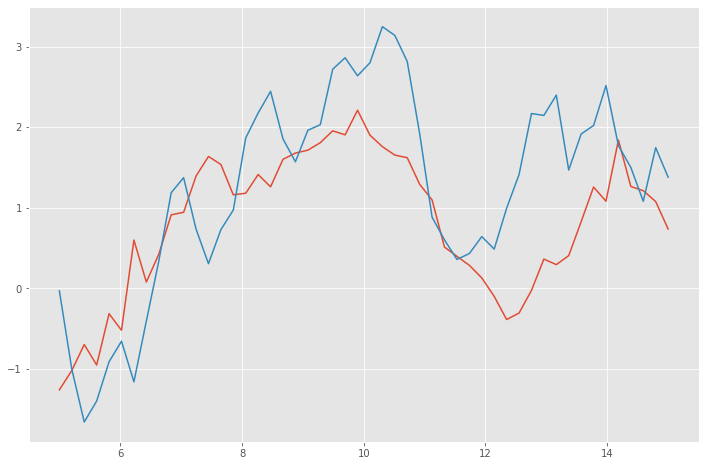

In [64]:
plt.figure(figsize=(12, 8))
plt.plot(t[ :50], y[20, :50])
plt.plot(t[50:], y[20, 50:])
plt.show()

In [65]:
t.shape

(100,)

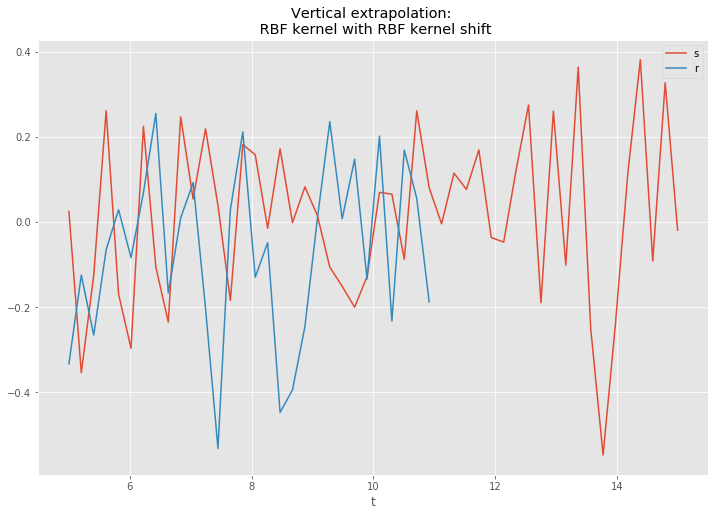

In [31]:
cmap = plt.get_cmap('Paired', 2)

fig,ax = plt.subplots(figsize = (12, 8))
ax.plot(t[:50], y[10, :50], label = 's')
ax.plot(t[50:80], y[10, 50:80], label = 'r')
plt.xlabel('t')
plt.title('Vertical extrapolation: \n RBF kernel with RBF kernel shift')
plt.legend()
plt.show()

In [30]:
def embed_position(t, d, TΔmin, Tmax):  # return.shape=(T,B,d)
    # t.shape=(T,B)   T=sequence_length, B=batch_size
    """A position-embedder, similar to the Attention paper, but tweaked to account for
    floating point positions, rather than integer.
    """
    R = Tmax / TΔmin * 100
    drange_even = TΔmin * R**(np.arange(0,d,2)/d)
    drange_odd = TΔmin * R**((np.arange(1,d,2) - 1)/d)
    x = np.concatenate([np.sin(t[:,:,None] / drange_even), np.cos(t[:,:,None] / drange_odd)], 2)
    return x

In [31]:
x1 = embed_position(t[:,None], d=94, TΔmin= 0.2, Tmax=30)

In [32]:
k = np.concatenate([np.zeros(50, dtype=int), np.ones(50, dtype=int)])
x2 = tf.one_hot(k, 2)[:, None, :]
x = np.concatenate((x1, x2), axis =-1).squeeze()[None, :, :]

In [33]:
batch_x = np.repeat(x.squeeze()[None, :, :], 32, axis =0)

In [34]:
train_step, test_step, train_loss, test_loss, m_tr, m_te = grapher.build_graph()

In [35]:
# b_data = batch_creator.create_batch(em_x = data[1], em_y=data[3], x = data[5], y = data[-1], batch_s=20, d=d, chnge_context=False)
# b_data_te = b_data

In [66]:
# Uncomment the two lines below for one batch to overfit on
# np.random.seed(443)
# b_data, c = batch_creator.create_batch_2d(data[2], data[-3], data[-1], batch_s=20, em_2 = data[3])

In [67]:
d = True

In [68]:
batch_x.shape

(32, 100, 96)

### Training

Does not exist
New folder /Users/omernivron/Downloads/GPT_rbf_rbf_2D/ckpt/check_run_7
Initializing from scratch.


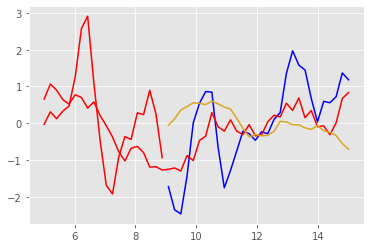

Epoch 0 batch 0 train Loss 0.7196 test Loss 0.6806 with training MSE metric 2.4335 and testing MSE metric 2.1941
learning rate is 0.0003000000142492354


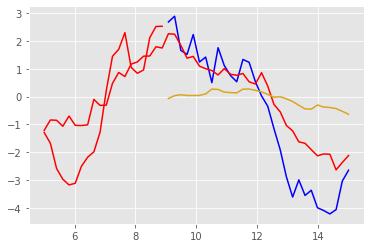

Epoch 0 batch 50 train Loss 0.5968 test Loss 0.5582 with training MSE metric 1.9572 and testing MSE metric 1.6919
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.67573595046997 secs



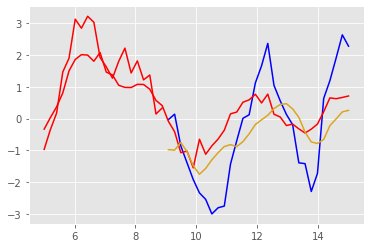

Epoch 1 batch 0 train Loss 0.4165 test Loss 0.4187 with training MSE metric 0.9621 and testing MSE metric 0.9955
learning rate is 0.0003000000142492354


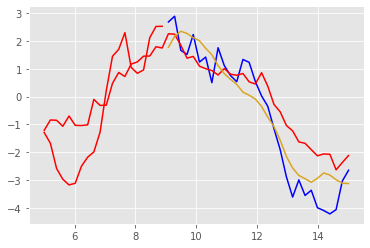

Epoch 1 batch 50 train Loss 0.3591 test Loss 0.3439 with training MSE metric 0.7765 and testing MSE metric 0.7203
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 7.906612873077393 secs



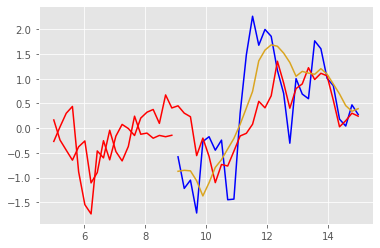

Epoch 2 batch 0 train Loss 0.3446 test Loss 0.3263 with training MSE metric 0.7319 and testing MSE metric 0.6795
learning rate is 0.0003000000142492354


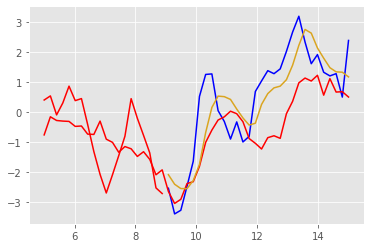

Epoch 2 batch 50 train Loss 0.3218 test Loss 0.2891 with training MSE metric 0.6500 and testing MSE metric 0.5829
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 7.604472637176514 secs



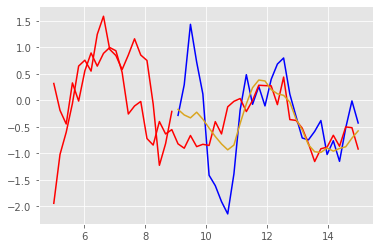

Epoch 3 batch 0 train Loss 0.2944 test Loss 0.2980 with training MSE metric 0.5974 and testing MSE metric 0.6165
learning rate is 0.0003000000142492354


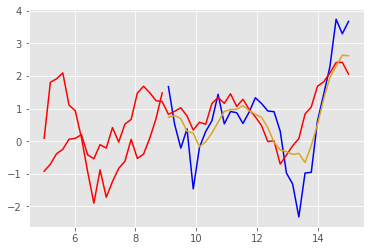

Epoch 3 batch 50 train Loss 0.2714 test Loss 0.2884 with training MSE metric 0.5456 and testing MSE metric 0.5851
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 7.538820266723633 secs



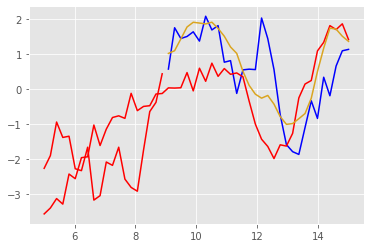

Epoch 4 batch 0 train Loss 0.2482 test Loss 0.2468 with training MSE metric 0.4932 and testing MSE metric 0.4998
learning rate is 0.0003000000142492354


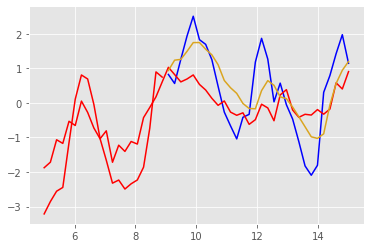

Epoch 4 batch 50 train Loss 0.2551 test Loss 0.2508 with training MSE metric 0.5039 and testing MSE metric 0.5034
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 7.661895751953125 secs



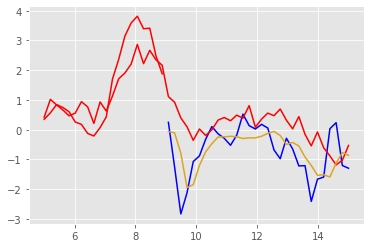

Epoch 5 batch 0 train Loss 0.2402 test Loss 0.2222 with training MSE metric 0.4777 and testing MSE metric 0.4489
learning rate is 0.0003000000142492354


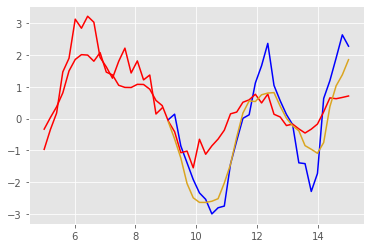

Epoch 5 batch 50 train Loss 0.2470 test Loss 0.2194 with training MSE metric 0.4901 and testing MSE metric 0.4431
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.248674869537354 secs



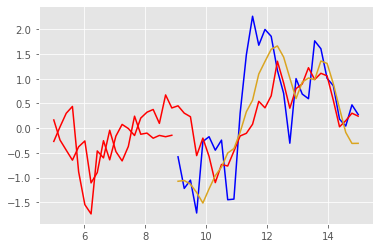

Epoch 6 batch 0 train Loss 0.2674 test Loss 0.2115 with training MSE metric 0.5403 and testing MSE metric 0.4236
learning rate is 0.0003000000142492354


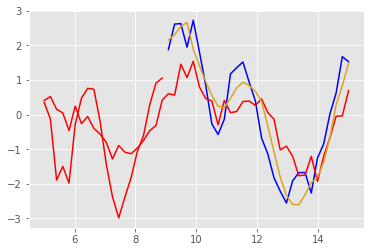

Epoch 6 batch 50 train Loss 0.2367 test Loss 0.2096 with training MSE metric 0.4698 and testing MSE metric 0.4279
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.198968172073364 secs



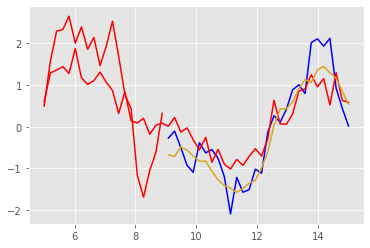

Epoch 7 batch 0 train Loss 0.2610 test Loss 0.2122 with training MSE metric 0.5269 and testing MSE metric 0.4276
learning rate is 0.0003000000142492354


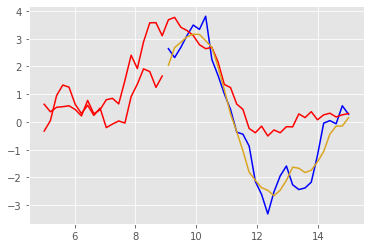

Epoch 7 batch 50 train Loss 0.2166 test Loss 0.2402 with training MSE metric 0.4445 and testing MSE metric 0.4858
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.242727994918823 secs



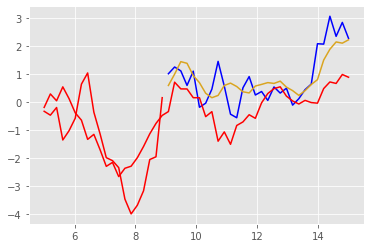

Epoch 8 batch 0 train Loss 0.2332 test Loss 0.2101 with training MSE metric 0.4717 and testing MSE metric 0.4268
learning rate is 0.0003000000142492354


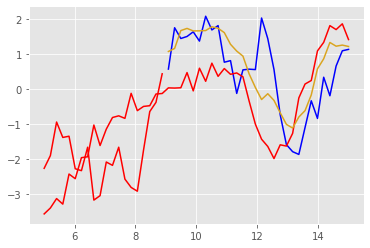

Epoch 8 batch 50 train Loss 0.2371 test Loss 0.2099 with training MSE metric 0.4774 and testing MSE metric 0.4255
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.355862140655518 secs



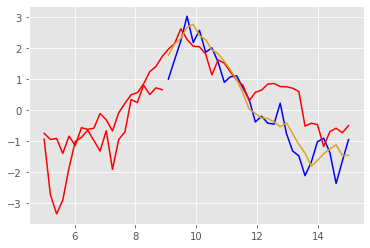

Epoch 9 batch 0 train Loss 0.2415 test Loss 0.2192 with training MSE metric 0.4872 and testing MSE metric 0.4438
learning rate is 0.0003000000142492354


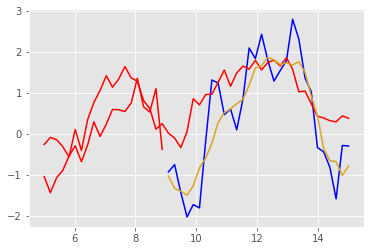

Epoch 9 batch 50 train Loss 0.2125 test Loss 0.1877 with training MSE metric 0.4433 and testing MSE metric 0.3887
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.494038105010986 secs



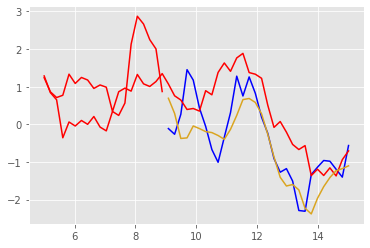

Epoch 10 batch 0 train Loss 0.2164 test Loss 0.1923 with training MSE metric 0.4415 and testing MSE metric 0.3942
learning rate is 0.0003000000142492354


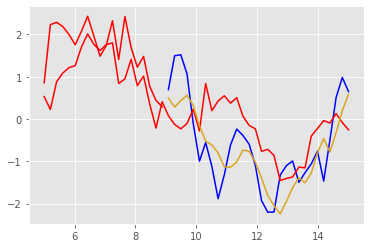

Epoch 10 batch 50 train Loss 0.2135 test Loss 0.2091 with training MSE metric 0.4339 and testing MSE metric 0.4236
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.920645236968994 secs



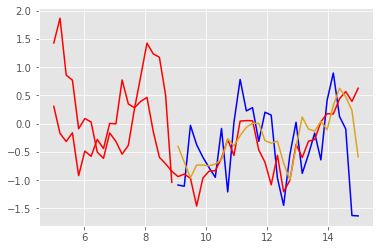

Epoch 11 batch 0 train Loss 0.2019 test Loss 0.1972 with training MSE metric 0.4166 and testing MSE metric 0.4063
learning rate is 0.0003000000142492354


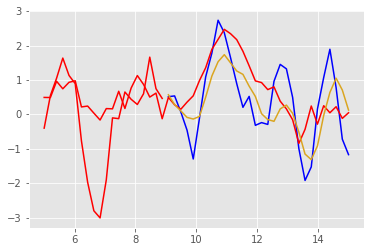

Epoch 11 batch 50 train Loss 0.1928 test Loss 0.1936 with training MSE metric 0.3995 and testing MSE metric 0.4025
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.927082061767578 secs



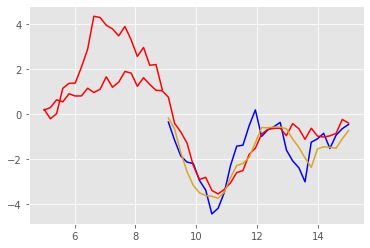

Epoch 12 batch 0 train Loss 0.1906 test Loss 0.1821 with training MSE metric 0.3922 and testing MSE metric 0.3830
learning rate is 0.0003000000142492354


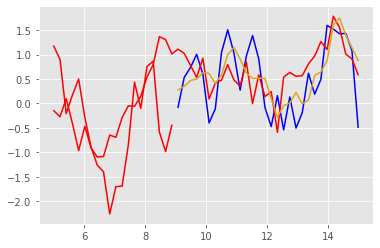

Epoch 12 batch 50 train Loss 0.1956 test Loss 0.1925 with training MSE metric 0.4052 and testing MSE metric 0.3988
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.994107246398926 secs



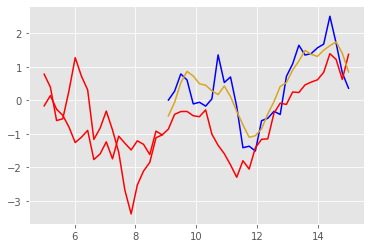

Epoch 13 batch 0 train Loss 0.2078 test Loss 0.1662 with training MSE metric 0.4271 and testing MSE metric 0.3577
learning rate is 0.0003000000142492354


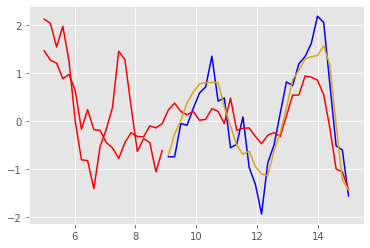

Epoch 13 batch 50 train Loss 0.2069 test Loss 0.1891 with training MSE metric 0.4206 and testing MSE metric 0.3915
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.608722925186157 secs



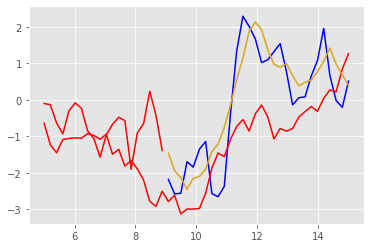

Epoch 14 batch 0 train Loss 0.2368 test Loss 0.2161 with training MSE metric 0.4795 and testing MSE metric 0.4344
learning rate is 0.0003000000142492354


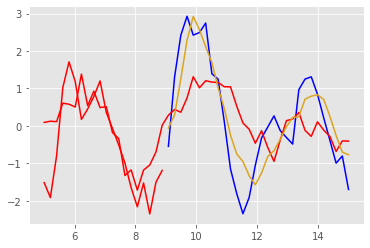

Epoch 14 batch 50 train Loss 0.2350 test Loss 0.2221 with training MSE metric 0.4619 and testing MSE metric 0.4450
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.574362754821777 secs



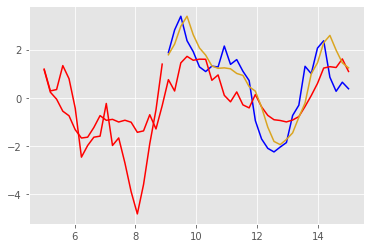

Epoch 15 batch 0 train Loss 0.1926 test Loss 0.1888 with training MSE metric 0.4018 and testing MSE metric 0.3954
learning rate is 0.0003000000142492354


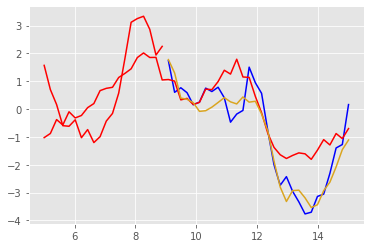

Epoch 15 batch 50 train Loss 0.1921 test Loss 0.1885 with training MSE metric 0.3960 and testing MSE metric 0.3892
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.570507049560547 secs



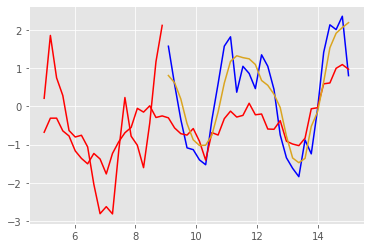

Epoch 16 batch 0 train Loss 0.1868 test Loss 0.1579 with training MSE metric 0.3917 and testing MSE metric 0.3413
learning rate is 0.0003000000142492354


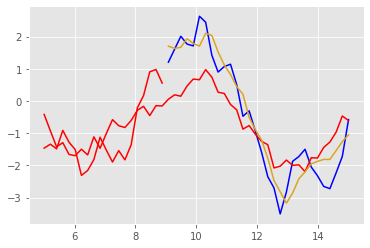

Epoch 16 batch 50 train Loss 0.1655 test Loss 0.1989 with training MSE metric 0.3536 and testing MSE metric 0.4050
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.398229122161865 secs



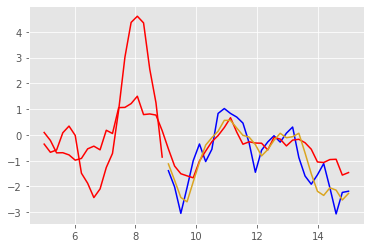

Epoch 17 batch 0 train Loss 0.1768 test Loss 0.1642 with training MSE metric 0.3747 and testing MSE metric 0.3579
learning rate is 0.0003000000142492354


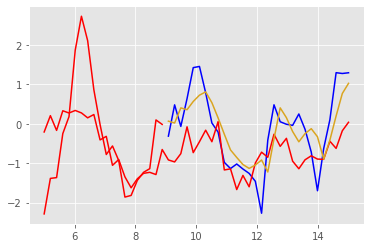

Epoch 17 batch 50 train Loss 0.1795 test Loss 0.1764 with training MSE metric 0.3761 and testing MSE metric 0.3742
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.52649974822998 secs



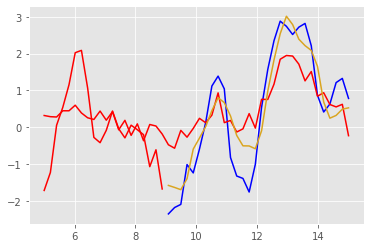

Epoch 18 batch 0 train Loss 0.2054 test Loss 0.1840 with training MSE metric 0.4224 and testing MSE metric 0.3888
learning rate is 0.0003000000142492354


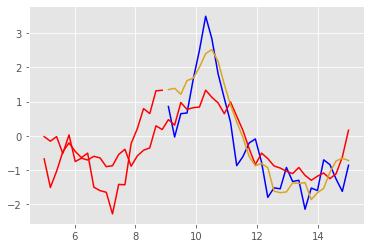

Epoch 18 batch 50 train Loss 0.2197 test Loss 0.1651 with training MSE metric 0.4411 and testing MSE metric 0.3497
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.516685962677002 secs



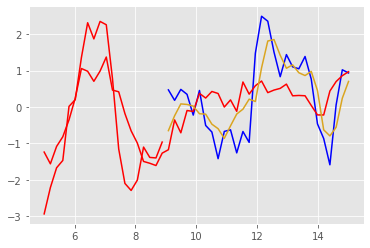

Epoch 19 batch 0 train Loss 0.1979 test Loss 0.1606 with training MSE metric 0.4080 and testing MSE metric 0.3452
learning rate is 0.0003000000142492354


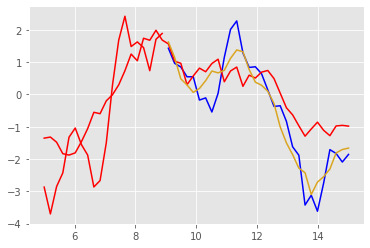

Epoch 19 batch 50 train Loss 0.1853 test Loss 0.1562 with training MSE metric 0.3943 and testing MSE metric 0.3420
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 8.370053052902222 secs



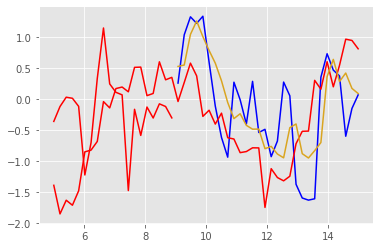

Epoch 20 batch 0 train Loss 0.1921 test Loss 0.1737 with training MSE metric 0.3972 and testing MSE metric 0.3703
learning rate is 0.0003000000142492354


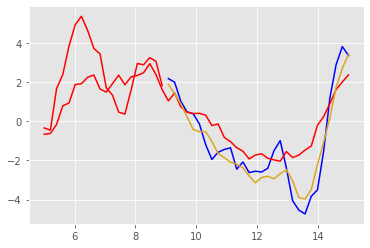

Epoch 20 batch 50 train Loss 0.1685 test Loss 0.1700 with training MSE metric 0.3582 and testing MSE metric 0.3635
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.139472007751465 secs



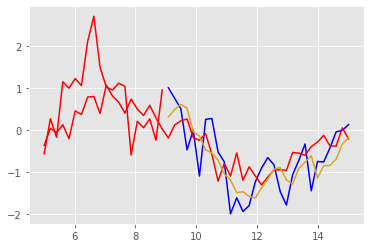

Epoch 21 batch 0 train Loss 0.1628 test Loss 0.1619 with training MSE metric 0.3490 and testing MSE metric 0.3513
learning rate is 0.0003000000142492354


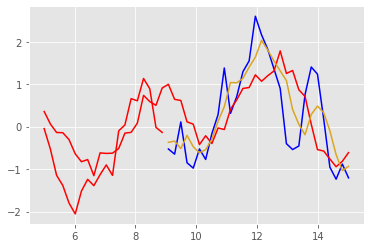

Epoch 21 batch 50 train Loss 0.1882 test Loss 0.1468 with training MSE metric 0.3939 and testing MSE metric 0.3323
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.515453100204468 secs



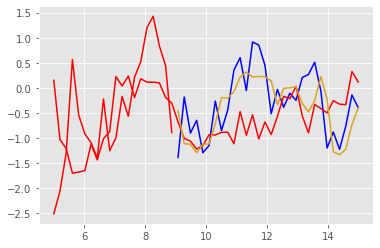

Epoch 22 batch 0 train Loss 0.1451 test Loss 0.1848 with training MSE metric 0.3337 and testing MSE metric 0.3810
learning rate is 0.0003000000142492354


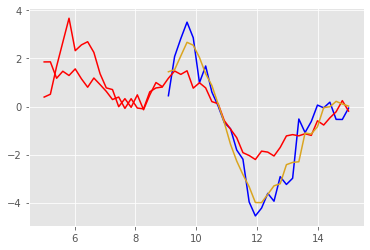

Epoch 22 batch 50 train Loss 0.2040 test Loss 0.1723 with training MSE metric 0.4119 and testing MSE metric 0.3696
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.926961898803711 secs



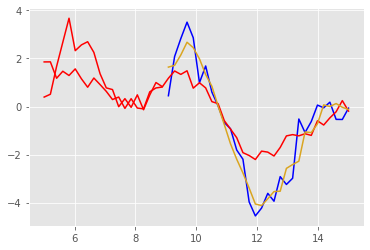

Epoch 23 batch 0 train Loss 0.1828 test Loss 0.1635 with training MSE metric 0.3809 and testing MSE metric 0.3538
learning rate is 0.0003000000142492354


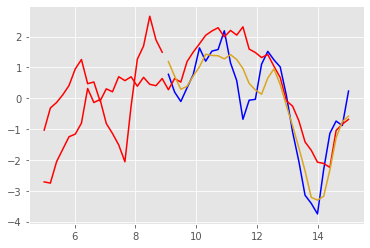

Epoch 23 batch 50 train Loss 0.1678 test Loss 0.1459 with training MSE metric 0.3639 and testing MSE metric 0.3285
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.09619402885437 secs



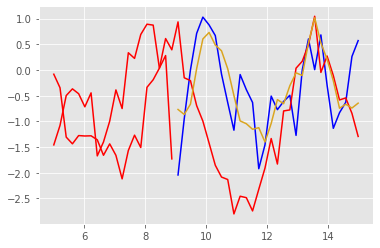

Epoch 24 batch 0 train Loss 0.1815 test Loss 0.1464 with training MSE metric 0.3832 and testing MSE metric 0.3305
learning rate is 0.0003000000142492354


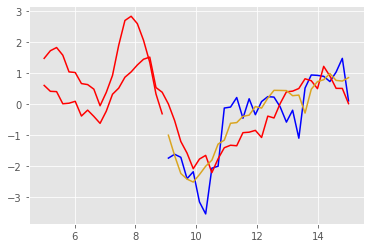

Epoch 24 batch 50 train Loss 0.1445 test Loss 0.1403 with training MSE metric 0.3267 and testing MSE metric 0.3215
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.087609052658081 secs



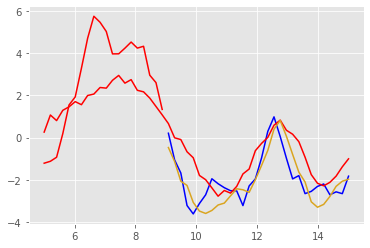

Epoch 25 batch 0 train Loss 0.1361 test Loss 0.1700 with training MSE metric 0.3178 and testing MSE metric 0.3596
learning rate is 0.0003000000142492354


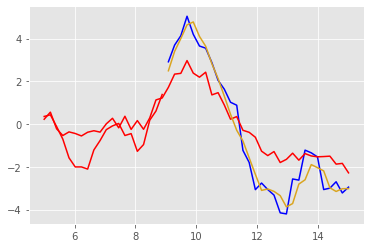

Epoch 25 batch 50 train Loss 0.1715 test Loss 0.1893 with training MSE metric 0.3652 and testing MSE metric 0.3953
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.65954303741455 secs



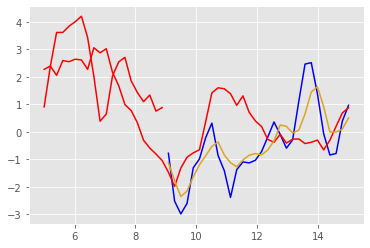

Epoch 26 batch 0 train Loss 0.1809 test Loss 0.1680 with training MSE metric 0.3828 and testing MSE metric 0.3576
learning rate is 0.0003000000142492354


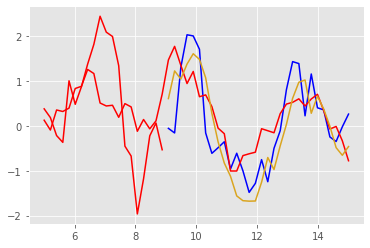

Epoch 26 batch 50 train Loss 0.1826 test Loss 0.1426 with training MSE metric 0.3837 and testing MSE metric 0.3272
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.294893980026245 secs



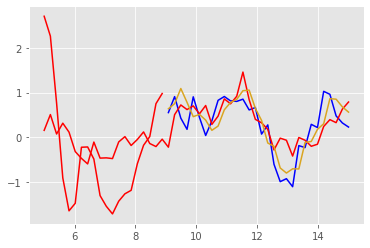

Epoch 27 batch 0 train Loss 0.1793 test Loss 0.1610 with training MSE metric 0.3758 and testing MSE metric 0.3524
learning rate is 0.0003000000142492354


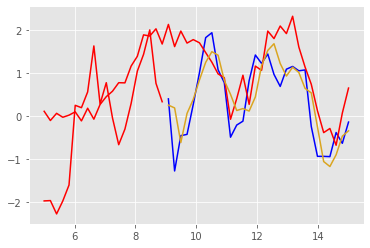

Epoch 27 batch 50 train Loss 0.1621 test Loss 0.1444 with training MSE metric 0.3566 and testing MSE metric 0.3298
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.357075929641724 secs



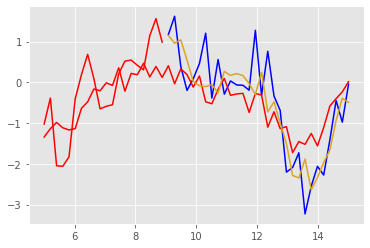

Epoch 28 batch 0 train Loss 0.1619 test Loss 0.1569 with training MSE metric 0.3538 and testing MSE metric 0.3441
learning rate is 0.0003000000142492354


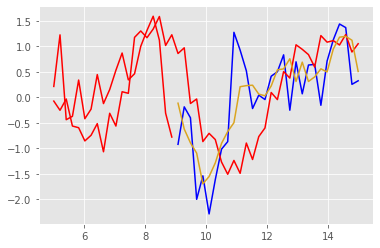

Epoch 28 batch 50 train Loss 0.1917 test Loss 0.1651 with training MSE metric 0.3985 and testing MSE metric 0.3548
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.330843687057495 secs



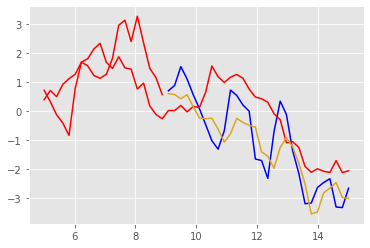

Epoch 29 batch 0 train Loss 0.1811 test Loss 0.1651 with training MSE metric 0.3821 and testing MSE metric 0.3582
learning rate is 0.0003000000142492354


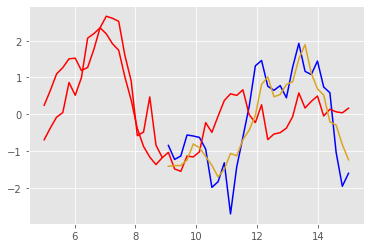

Epoch 29 batch 50 train Loss 0.1476 test Loss 0.1701 with training MSE metric 0.3320 and testing MSE metric 0.3659
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.350584983825684 secs



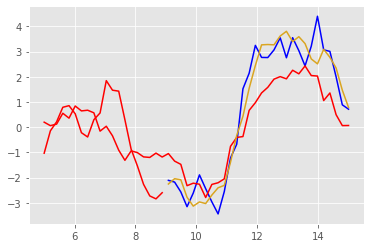

Epoch 30 batch 0 train Loss 0.1519 test Loss 0.1776 with training MSE metric 0.3388 and testing MSE metric 0.3756
learning rate is 0.0003000000142492354


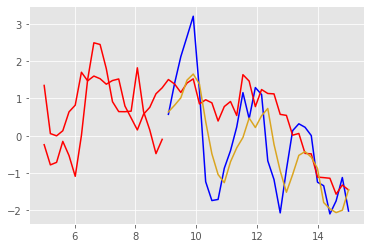

Epoch 30 batch 50 train Loss 0.1810 test Loss 0.1742 with training MSE metric 0.3862 and testing MSE metric 0.3721
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.34508490562439 secs



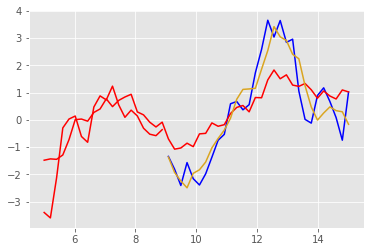

Epoch 31 batch 0 train Loss 0.1919 test Loss 0.1530 with training MSE metric 0.4003 and testing MSE metric 0.3444
learning rate is 0.0003000000142492354


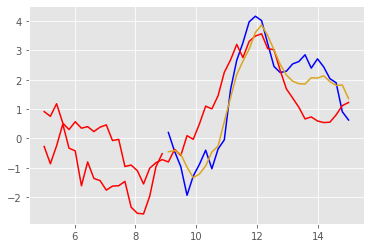

Epoch 31 batch 50 train Loss 0.1807 test Loss 0.1494 with training MSE metric 0.3814 and testing MSE metric 0.3350
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.37054705619812 secs



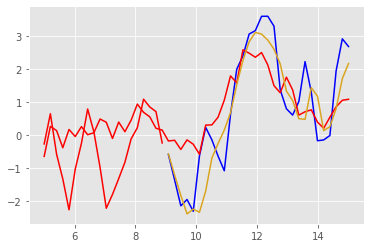

Epoch 32 batch 0 train Loss 0.1580 test Loss 0.1409 with training MSE metric 0.3464 and testing MSE metric 0.3202
learning rate is 0.0003000000142492354


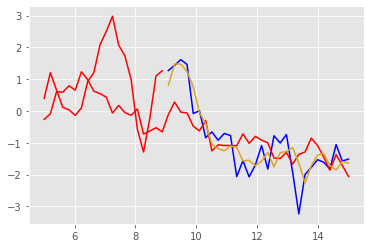

Epoch 32 batch 50 train Loss 0.1866 test Loss 0.1578 with training MSE metric 0.3901 and testing MSE metric 0.3457
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.556428909301758 secs



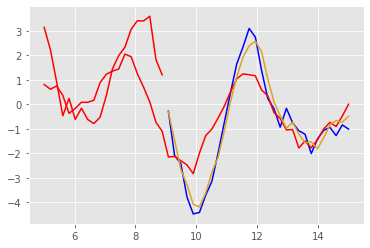

Epoch 33 batch 0 train Loss 0.1580 test Loss 0.1632 with training MSE metric 0.3470 and testing MSE metric 0.3577
learning rate is 0.0003000000142492354


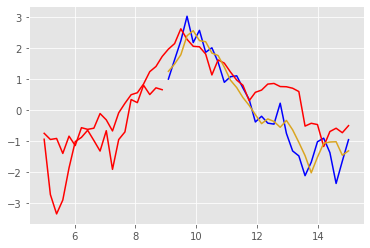

Epoch 33 batch 50 train Loss 0.1784 test Loss 0.1368 with training MSE metric 0.3773 and testing MSE metric 0.3156
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.70590090751648 secs



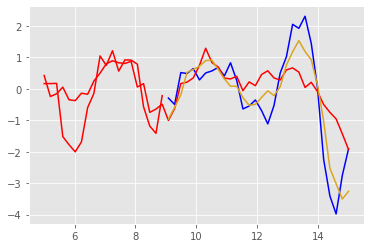

Epoch 34 batch 0 train Loss 0.1779 test Loss 0.1551 with training MSE metric 0.3809 and testing MSE metric 0.3445
learning rate is 0.0003000000142492354


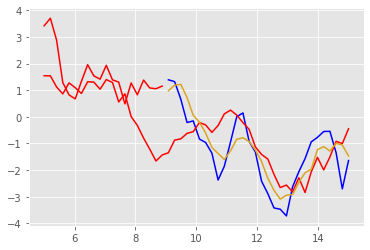

Epoch 34 batch 50 train Loss 0.1577 test Loss 0.1494 with training MSE metric 0.3462 and testing MSE metric 0.3361
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.718461036682129 secs



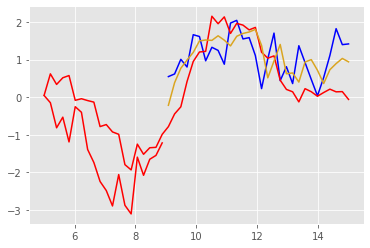

Epoch 35 batch 0 train Loss 0.1519 test Loss 0.1352 with training MSE metric 0.3397 and testing MSE metric 0.3159
learning rate is 0.0003000000142492354


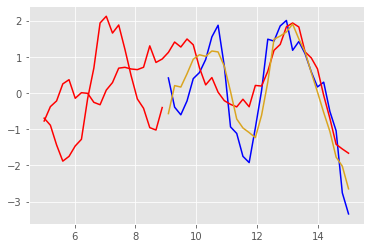

Epoch 35 batch 50 train Loss 0.1774 test Loss 0.1600 with training MSE metric 0.3758 and testing MSE metric 0.3496
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.701864957809448 secs



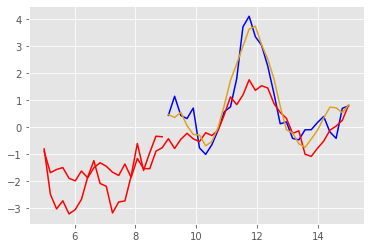

Epoch 36 batch 0 train Loss 0.1794 test Loss 0.1631 with training MSE metric 0.3808 and testing MSE metric 0.3590
learning rate is 0.0003000000142492354


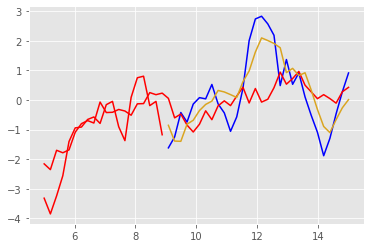

Epoch 36 batch 50 train Loss 0.1597 test Loss 0.1459 with training MSE metric 0.3480 and testing MSE metric 0.3313
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.732189893722534 secs



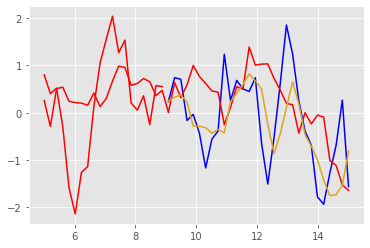

Epoch 37 batch 0 train Loss 0.1647 test Loss 0.1296 with training MSE metric 0.3572 and testing MSE metric 0.3070
learning rate is 0.0003000000142492354


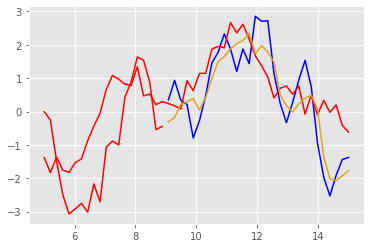

Epoch 37 batch 50 train Loss 0.1794 test Loss 0.1489 with training MSE metric 0.3776 and testing MSE metric 0.3351
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.00652003288269 secs



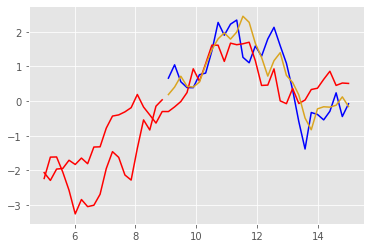

Epoch 38 batch 0 train Loss 0.1418 test Loss 0.1507 with training MSE metric 0.3267 and testing MSE metric 0.3324
learning rate is 0.0003000000142492354


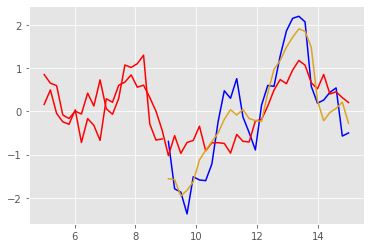

Epoch 38 batch 50 train Loss 0.1504 test Loss 0.1575 with training MSE metric 0.3402 and testing MSE metric 0.3448
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.101593732833862 secs



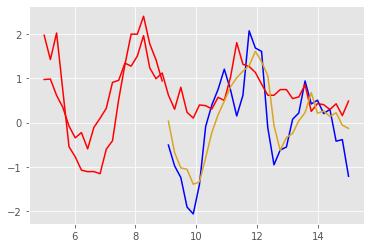

Epoch 39 batch 0 train Loss 0.1548 test Loss 0.1425 with training MSE metric 0.3459 and testing MSE metric 0.3259
learning rate is 0.0003000000142492354


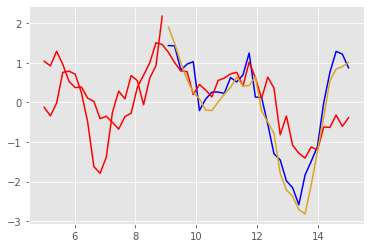

Epoch 39 batch 50 train Loss 0.1518 test Loss 0.1298 with training MSE metric 0.3417 and testing MSE metric 0.3064
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.072223901748657 secs



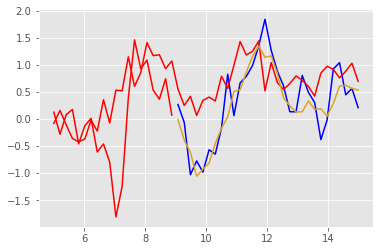

Epoch 40 batch 0 train Loss 0.1457 test Loss 0.1311 with training MSE metric 0.3305 and testing MSE metric 0.3062
learning rate is 0.0003000000142492354


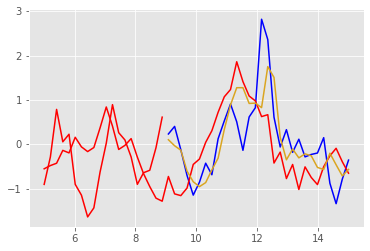

Epoch 40 batch 50 train Loss 0.1558 test Loss 0.1648 with training MSE metric 0.3446 and testing MSE metric 0.3546
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.229024171829224 secs



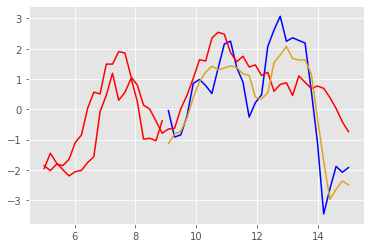

Epoch 41 batch 0 train Loss 0.1415 test Loss 0.1493 with training MSE metric 0.3252 and testing MSE metric 0.3367
learning rate is 0.0003000000142492354


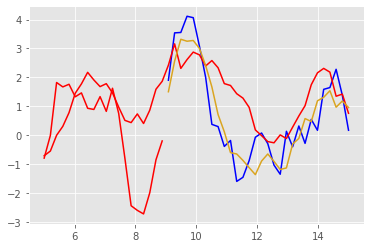

Epoch 41 batch 50 train Loss 0.1513 test Loss 0.1705 with training MSE metric 0.3390 and testing MSE metric 0.3649
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.100548028945923 secs



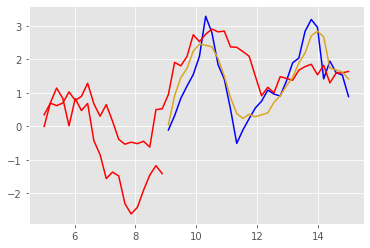

Epoch 42 batch 0 train Loss 0.1608 test Loss 0.1398 with training MSE metric 0.3512 and testing MSE metric 0.3255
learning rate is 0.0003000000142492354


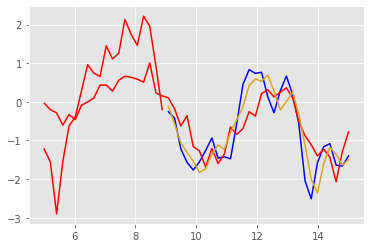

Epoch 42 batch 50 train Loss 0.1649 test Loss 0.1699 with training MSE metric 0.3570 and testing MSE metric 0.3627
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.095398902893066 secs



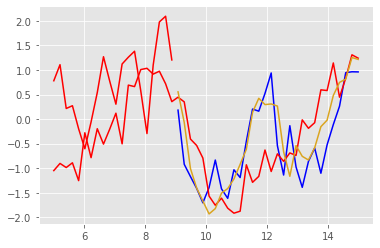

Epoch 43 batch 0 train Loss 0.1658 test Loss 0.1535 with training MSE metric 0.3562 and testing MSE metric 0.3380
learning rate is 0.0003000000142492354


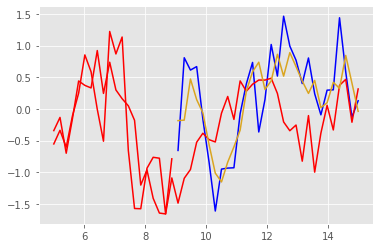

Epoch 43 batch 50 train Loss 0.1531 test Loss 0.1323 with training MSE metric 0.3484 and testing MSE metric 0.3129
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.09479808807373 secs



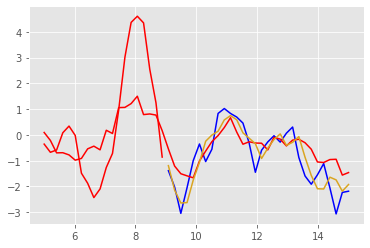

Epoch 44 batch 0 train Loss 0.1614 test Loss 0.1851 with training MSE metric 0.3569 and testing MSE metric 0.3832
learning rate is 0.0003000000142492354


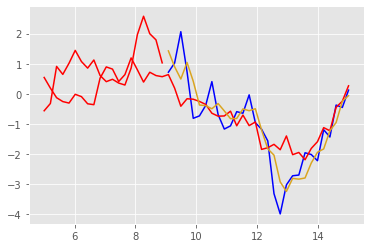

Epoch 44 batch 50 train Loss 0.1413 test Loss 0.1551 with training MSE metric 0.3247 and testing MSE metric 0.3448
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.10895299911499 secs



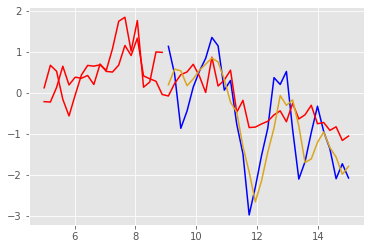

Epoch 45 batch 0 train Loss 0.1615 test Loss 0.1101 with training MSE metric 0.3549 and testing MSE metric 0.2811
learning rate is 0.0003000000142492354


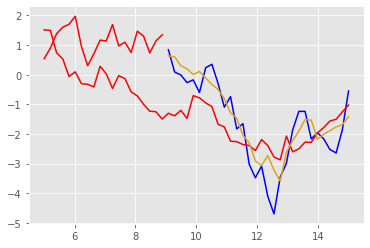

Epoch 45 batch 50 train Loss 0.1535 test Loss 0.1314 with training MSE metric 0.3423 and testing MSE metric 0.3113
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.06715703010559 secs



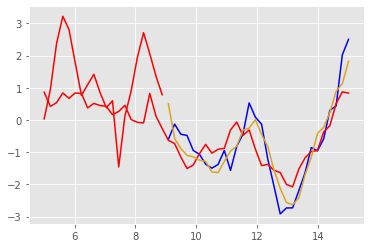

Epoch 46 batch 0 train Loss 0.1647 test Loss 0.1607 with training MSE metric 0.3570 and testing MSE metric 0.3508
learning rate is 0.0003000000142492354


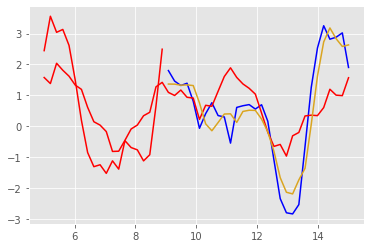

Epoch 46 batch 50 train Loss 0.1363 test Loss 0.1473 with training MSE metric 0.3192 and testing MSE metric 0.3319
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.04403281211853 secs



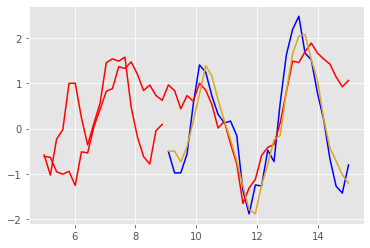

Epoch 47 batch 0 train Loss 0.1496 test Loss 0.1602 with training MSE metric 0.3368 and testing MSE metric 0.3507
learning rate is 0.0003000000142492354


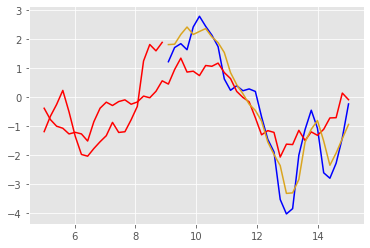

Epoch 47 batch 50 train Loss 0.1428 test Loss 0.1414 with training MSE metric 0.3256 and testing MSE metric 0.3255
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.707634925842285 secs



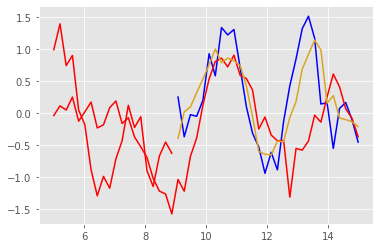

Epoch 48 batch 0 train Loss 0.1183 test Loss 0.1032 with training MSE metric 0.2946 and testing MSE metric 0.2747
learning rate is 0.0003000000142492354


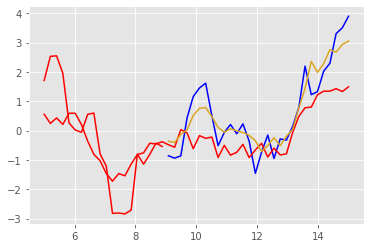

Epoch 48 batch 50 train Loss 0.1642 test Loss 0.1375 with training MSE metric 0.3511 and testing MSE metric 0.3189
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.897441625595093 secs



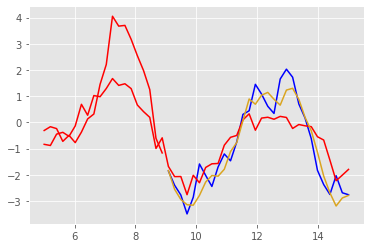

Epoch 49 batch 0 train Loss 0.1525 test Loss 0.1343 with training MSE metric 0.3440 and testing MSE metric 0.3186
learning rate is 0.0003000000142492354


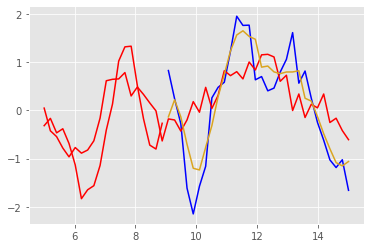

Epoch 49 batch 50 train Loss 0.1393 test Loss 0.1444 with training MSE metric 0.3273 and testing MSE metric 0.3263
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.466671705245972 secs



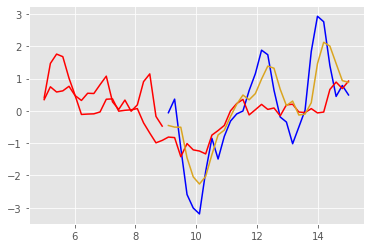

Epoch 50 batch 0 train Loss 0.1600 test Loss 0.1270 with training MSE metric 0.3486 and testing MSE metric 0.3061
learning rate is 0.0003000000142492354


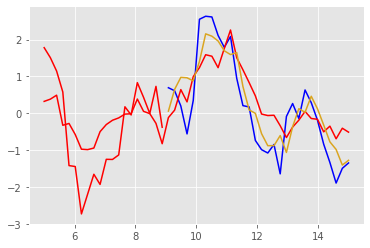

Epoch 50 batch 50 train Loss 0.1338 test Loss 0.1435 with training MSE metric 0.3172 and testing MSE metric 0.3314
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.436838150024414 secs



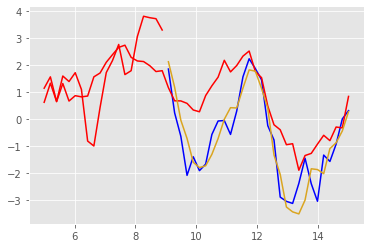

Epoch 51 batch 0 train Loss 0.1817 test Loss 0.1419 with training MSE metric 0.3771 and testing MSE metric 0.3269
learning rate is 0.0003000000142492354


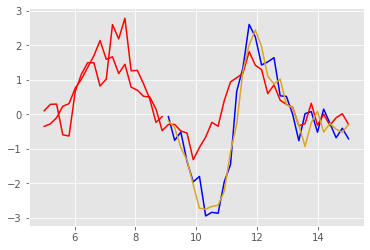

Epoch 51 batch 50 train Loss 0.1792 test Loss 0.1097 with training MSE metric 0.3744 and testing MSE metric 0.2800
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.416155099868774 secs



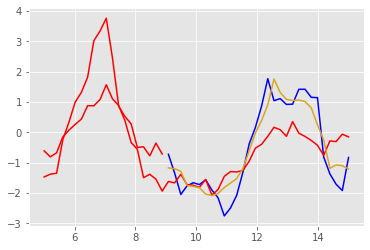

Epoch 52 batch 0 train Loss 0.1740 test Loss 0.1100 with training MSE metric 0.3712 and testing MSE metric 0.2784
learning rate is 0.0003000000142492354


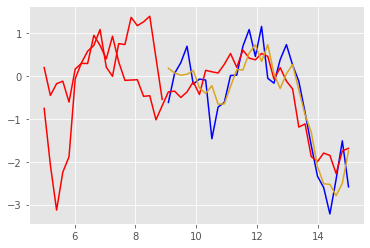

Epoch 52 batch 50 train Loss 0.1553 test Loss 0.1565 with training MSE metric 0.3449 and testing MSE metric 0.3475
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.34075117111206 secs



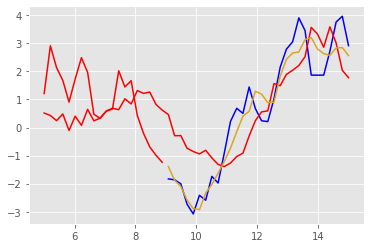

Epoch 53 batch 0 train Loss 0.1679 test Loss 0.1356 with training MSE metric 0.3629 and testing MSE metric 0.3211
learning rate is 0.0003000000142492354


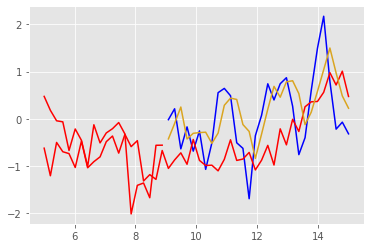

Epoch 53 batch 50 train Loss 0.1663 test Loss 0.1530 with training MSE metric 0.3592 and testing MSE metric 0.3408
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.493746757507324 secs



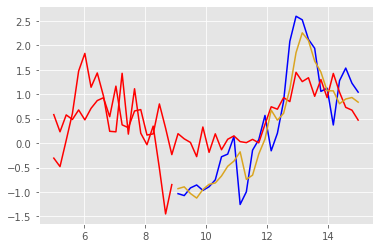

Epoch 54 batch 0 train Loss 0.1440 test Loss 0.1568 with training MSE metric 0.3287 and testing MSE metric 0.3435
learning rate is 0.0003000000142492354


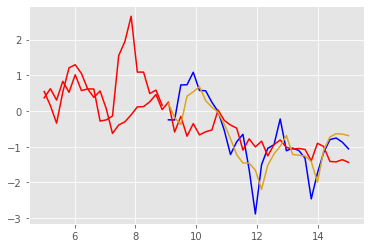

Epoch 54 batch 50 train Loss 0.1355 test Loss 0.1354 with training MSE metric 0.3149 and testing MSE metric 0.3169
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.418588161468506 secs



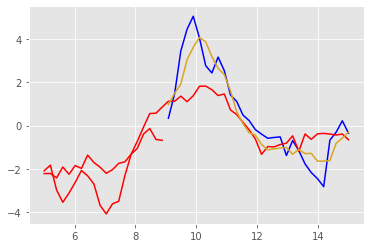

Epoch 55 batch 0 train Loss 0.1521 test Loss 0.1167 with training MSE metric 0.3383 and testing MSE metric 0.2881
learning rate is 0.0003000000142492354


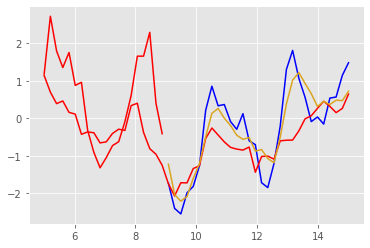

Epoch 55 batch 50 train Loss 0.1432 test Loss 0.1368 with training MSE metric 0.3315 and testing MSE metric 0.3188
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.628713846206665 secs



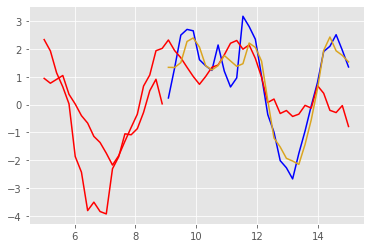

Epoch 56 batch 0 train Loss 0.1630 test Loss 0.1463 with training MSE metric 0.3548 and testing MSE metric 0.3298
learning rate is 0.0003000000142492354


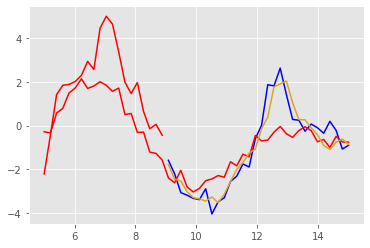

Epoch 56 batch 50 train Loss 0.1625 test Loss 0.1439 with training MSE metric 0.3480 and testing MSE metric 0.3301
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.432801723480225 secs



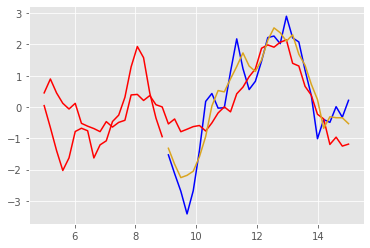

Epoch 57 batch 0 train Loss 0.1435 test Loss 0.1293 with training MSE metric 0.3245 and testing MSE metric 0.3055
learning rate is 0.0003000000142492354


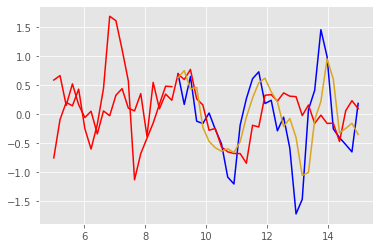

Epoch 57 batch 50 train Loss 0.1457 test Loss 0.1284 with training MSE metric 0.3310 and testing MSE metric 0.3069
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.624531984329224 secs



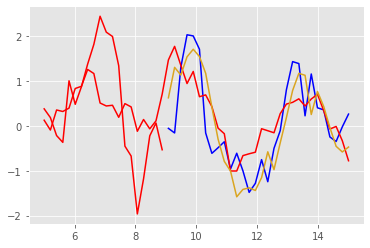

Epoch 58 batch 0 train Loss 0.1600 test Loss 0.1500 with training MSE metric 0.3504 and testing MSE metric 0.3390
learning rate is 0.0003000000142492354


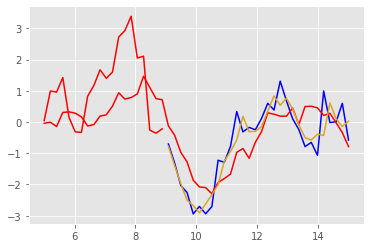

Epoch 58 batch 50 train Loss 0.1580 test Loss 0.1471 with training MSE metric 0.3486 and testing MSE metric 0.3342
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.03515911102295 secs



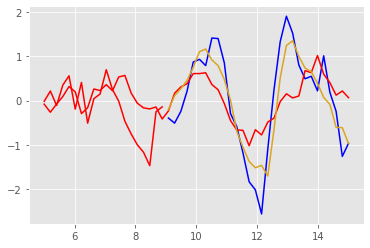

Epoch 59 batch 0 train Loss 0.1536 test Loss 0.1393 with training MSE metric 0.3408 and testing MSE metric 0.3202
learning rate is 0.0003000000142492354


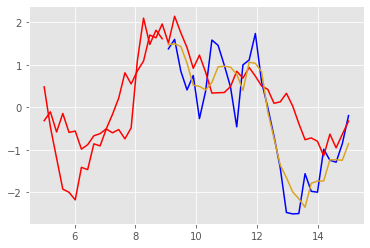

Epoch 59 batch 50 train Loss 0.1810 test Loss 0.1222 with training MSE metric 0.3757 and testing MSE metric 0.3013
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.059235095977783 secs



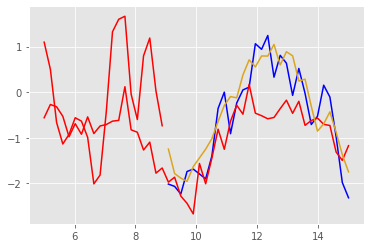

Epoch 60 batch 0 train Loss 0.1719 test Loss 0.1324 with training MSE metric 0.3648 and testing MSE metric 0.3115
learning rate is 0.0003000000142492354


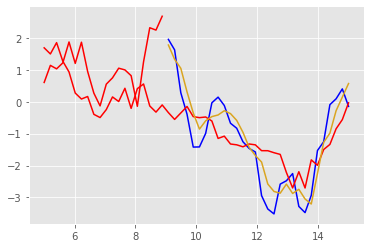

Epoch 60 batch 50 train Loss 0.1358 test Loss 0.1572 with training MSE metric 0.3228 and testing MSE metric 0.3433
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.076192378997803 secs



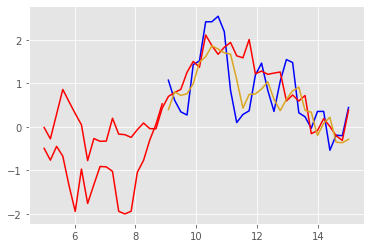

Epoch 61 batch 0 train Loss 0.1235 test Loss 0.1344 with training MSE metric 0.3023 and testing MSE metric 0.3153
learning rate is 0.0003000000142492354


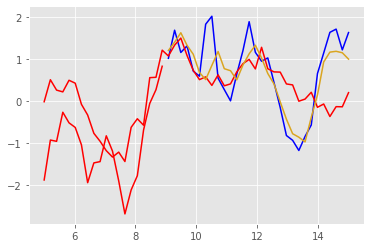

Epoch 61 batch 50 train Loss 0.1545 test Loss 0.1177 with training MSE metric 0.3457 and testing MSE metric 0.2938
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.063107013702393 secs



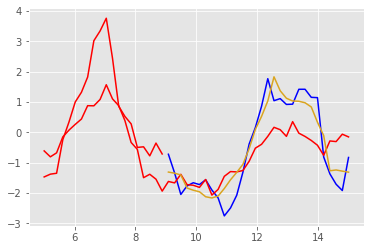

Epoch 62 batch 0 train Loss 0.1448 test Loss 0.1493 with training MSE metric 0.3314 and testing MSE metric 0.3387
learning rate is 0.0003000000142492354


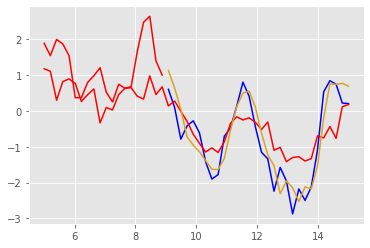

Epoch 62 batch 50 train Loss 0.1489 test Loss 0.1188 with training MSE metric 0.3369 and testing MSE metric 0.2982
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.395979881286621 secs



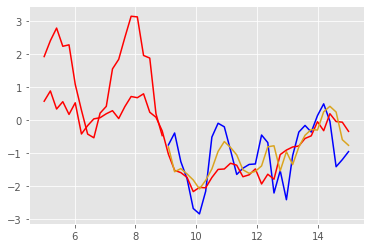

Epoch 63 batch 0 train Loss 0.1330 test Loss 0.1400 with training MSE metric 0.3154 and testing MSE metric 0.3247
learning rate is 0.0003000000142492354


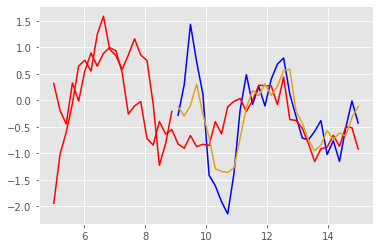

Epoch 63 batch 50 train Loss 0.1412 test Loss 0.1508 with training MSE metric 0.3274 and testing MSE metric 0.3385
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.530781030654907 secs



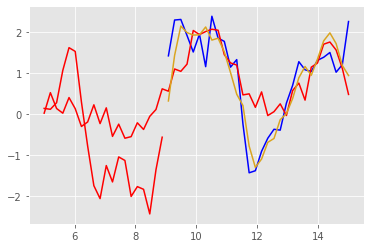

Epoch 64 batch 0 train Loss 0.1596 test Loss 0.1254 with training MSE metric 0.3585 and testing MSE metric 0.3055
learning rate is 0.0003000000142492354


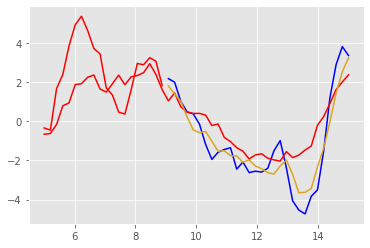

Epoch 64 batch 50 train Loss 0.1334 test Loss 0.1467 with training MSE metric 0.3133 and testing MSE metric 0.3322
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.560118913650513 secs



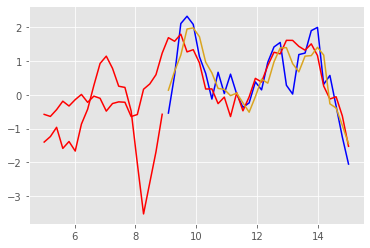

Epoch 65 batch 0 train Loss 0.1401 test Loss 0.1197 with training MSE metric 0.3254 and testing MSE metric 0.3004
learning rate is 0.0003000000142492354


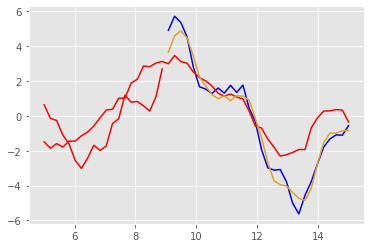

Epoch 65 batch 50 train Loss 0.1425 test Loss 0.1415 with training MSE metric 0.3257 and testing MSE metric 0.3263
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.582182884216309 secs



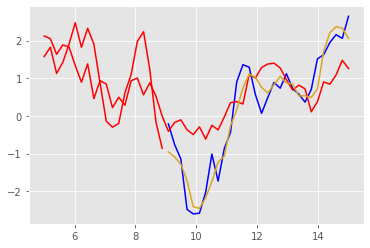

Epoch 66 batch 0 train Loss 0.1684 test Loss 0.1183 with training MSE metric 0.3635 and testing MSE metric 0.2926
learning rate is 0.0003000000142492354


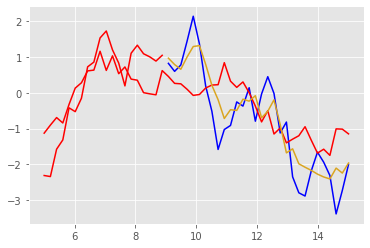

Epoch 66 batch 50 train Loss 0.1575 test Loss 0.1371 with training MSE metric 0.3493 and testing MSE metric 0.3157
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.544803142547607 secs



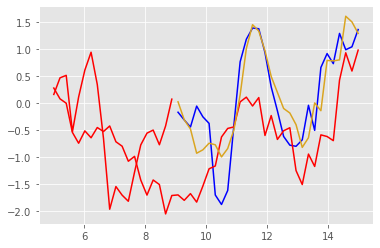

Epoch 67 batch 0 train Loss 0.1516 test Loss 0.1197 with training MSE metric 0.3378 and testing MSE metric 0.2974
learning rate is 0.0003000000142492354


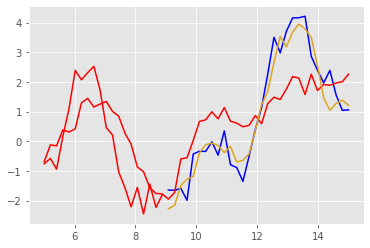

Epoch 67 batch 50 train Loss 0.1351 test Loss 0.1303 with training MSE metric 0.3159 and testing MSE metric 0.3117
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.55958604812622 secs



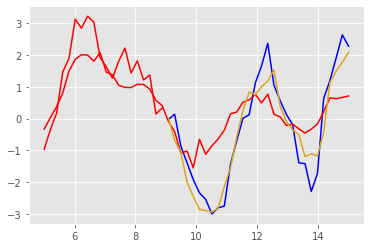

Epoch 68 batch 0 train Loss 0.1365 test Loss 0.1350 with training MSE metric 0.3230 and testing MSE metric 0.3180
learning rate is 0.0003000000142492354


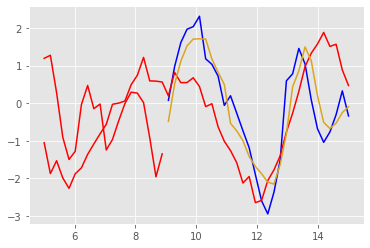

Epoch 68 batch 50 train Loss 0.1415 test Loss 0.1460 with training MSE metric 0.3247 and testing MSE metric 0.3306
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.502012968063354 secs



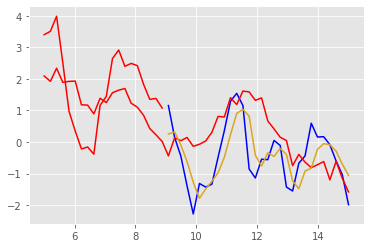

Epoch 69 batch 0 train Loss 0.1178 test Loss 0.1541 with training MSE metric 0.2941 and testing MSE metric 0.3421
learning rate is 0.0003000000142492354


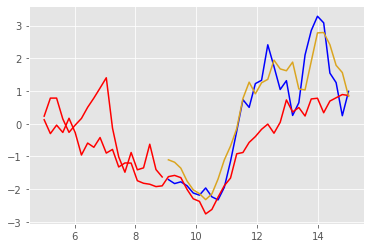

Epoch 69 batch 50 train Loss 0.1586 test Loss 0.1129 with training MSE metric 0.3493 and testing MSE metric 0.2880
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.518961191177368 secs



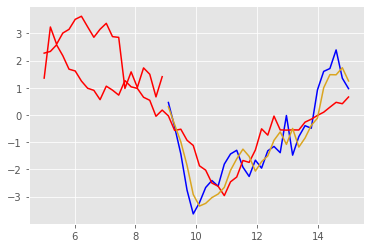

Epoch 70 batch 0 train Loss 0.1636 test Loss 0.1292 with training MSE metric 0.3551 and testing MSE metric 0.3104
learning rate is 0.0003000000142492354


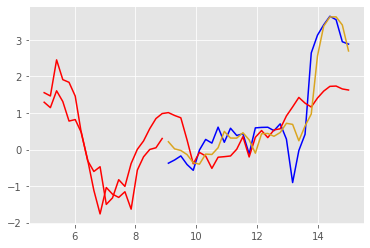

Epoch 70 batch 50 train Loss 0.1358 test Loss 0.1351 with training MSE metric 0.3194 and testing MSE metric 0.3176
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.479215860366821 secs



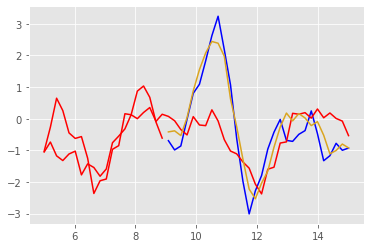

Epoch 71 batch 0 train Loss 0.1702 test Loss 0.1216 with training MSE metric 0.3646 and testing MSE metric 0.2987
learning rate is 0.0003000000142492354


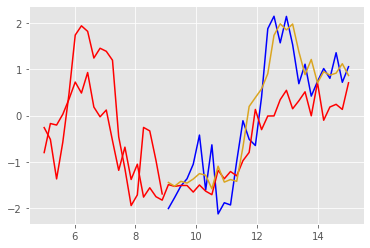

Epoch 71 batch 50 train Loss 0.1521 test Loss 0.1255 with training MSE metric 0.3405 and testing MSE metric 0.3018
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.542722225189209 secs



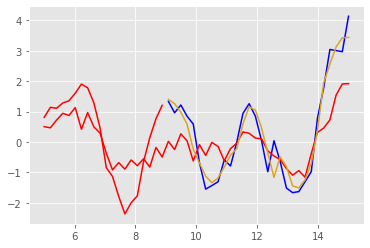

Epoch 72 batch 0 train Loss 0.1307 test Loss 0.1206 with training MSE metric 0.3110 and testing MSE metric 0.3002
learning rate is 0.0003000000142492354


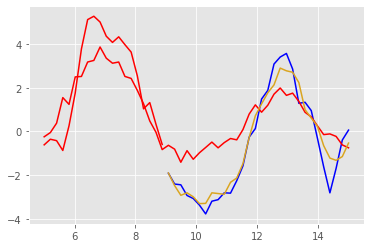

Epoch 72 batch 50 train Loss 0.1436 test Loss 0.1437 with training MSE metric 0.3303 and testing MSE metric 0.3291
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.516894340515137 secs



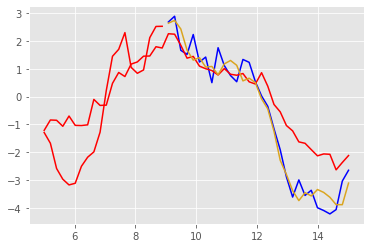

Epoch 73 batch 0 train Loss 0.1607 test Loss 0.1288 with training MSE metric 0.3498 and testing MSE metric 0.3088
learning rate is 0.0003000000142492354


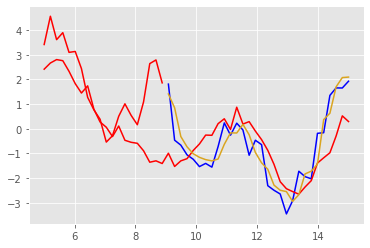

Epoch 73 batch 50 train Loss 0.1117 test Loss 0.1458 with training MSE metric 0.2882 and testing MSE metric 0.3289
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.580030918121338 secs



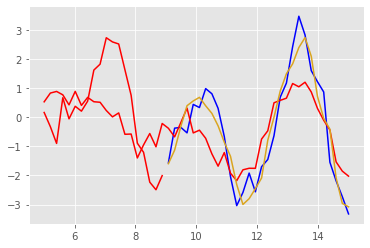

Epoch 74 batch 0 train Loss 0.1671 test Loss 0.1189 with training MSE metric 0.3580 and testing MSE metric 0.2930
learning rate is 0.0003000000142492354


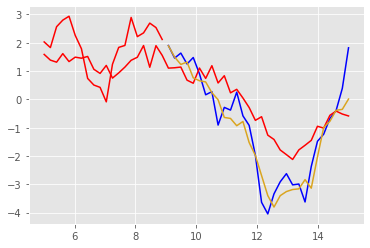

Epoch 74 batch 50 train Loss 0.1284 test Loss 0.1193 with training MSE metric 0.3050 and testing MSE metric 0.2980
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.937415361404419 secs



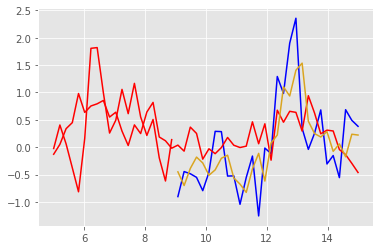

Epoch 75 batch 0 train Loss 0.1418 test Loss 0.1297 with training MSE metric 0.3281 and testing MSE metric 0.3110
learning rate is 0.0003000000142492354


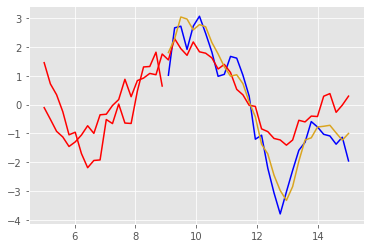

Epoch 75 batch 50 train Loss 0.1315 test Loss 0.1466 with training MSE metric 0.3131 and testing MSE metric 0.3288
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.058269023895264 secs



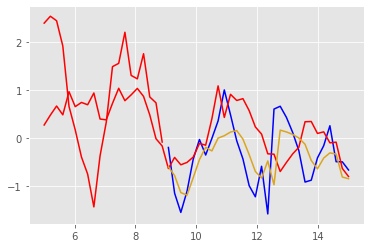

Epoch 76 batch 0 train Loss 0.1456 test Loss 0.1177 with training MSE metric 0.3309 and testing MSE metric 0.2953
learning rate is 0.0003000000142492354


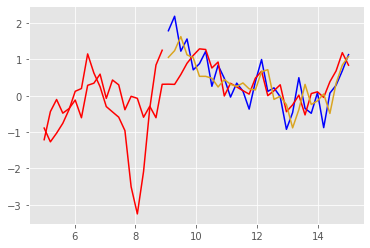

Epoch 76 batch 50 train Loss 0.1328 test Loss 0.1389 with training MSE metric 0.3147 and testing MSE metric 0.3218
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.024452209472656 secs



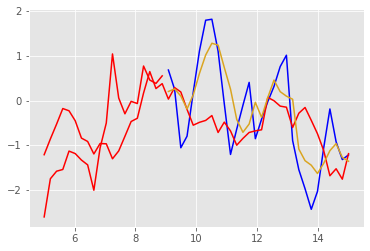

Epoch 77 batch 0 train Loss 0.1372 test Loss 0.1227 with training MSE metric 0.3189 and testing MSE metric 0.3012
learning rate is 0.0003000000142492354


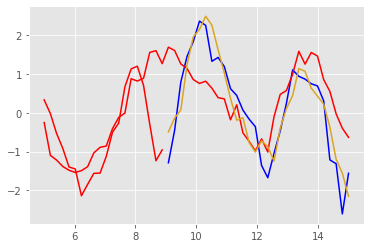

Epoch 77 batch 50 train Loss 0.1322 test Loss 0.1421 with training MSE metric 0.3143 and testing MSE metric 0.3249
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.784233093261719 secs



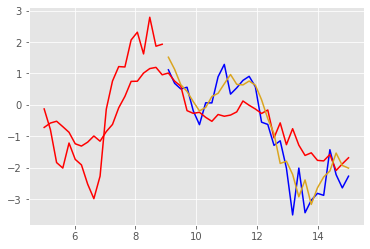

Epoch 78 batch 0 train Loss 0.1512 test Loss 0.1348 with training MSE metric 0.3358 and testing MSE metric 0.3166
learning rate is 0.0003000000142492354


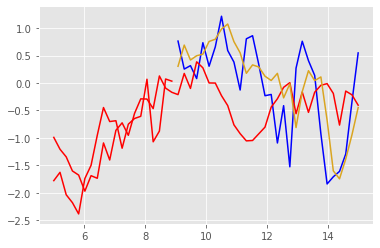

Epoch 78 batch 50 train Loss 0.1407 test Loss 0.1322 with training MSE metric 0.3237 and testing MSE metric 0.3149
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.700082063674927 secs



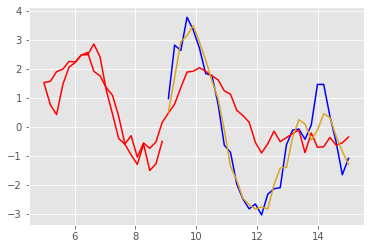

Epoch 79 batch 0 train Loss 0.1363 test Loss 0.1209 with training MSE metric 0.3187 and testing MSE metric 0.2980
learning rate is 0.0003000000142492354


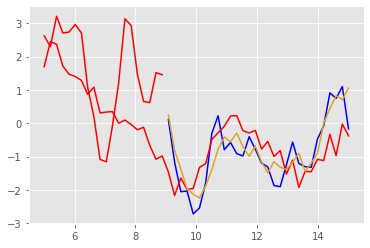

Epoch 79 batch 50 train Loss 0.1326 test Loss 0.1505 with training MSE metric 0.3151 and testing MSE metric 0.3384
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.572234869003296 secs



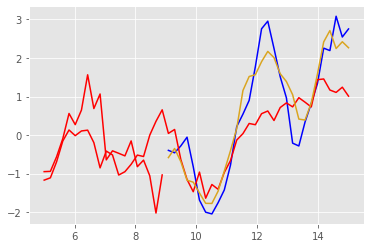

Epoch 80 batch 0 train Loss 0.1807 test Loss 0.1203 with training MSE metric 0.3798 and testing MSE metric 0.3004
learning rate is 0.0003000000142492354


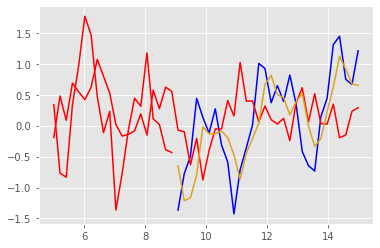

Epoch 80 batch 50 train Loss 0.1376 test Loss 0.1212 with training MSE metric 0.3201 and testing MSE metric 0.2977
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.54229998588562 secs



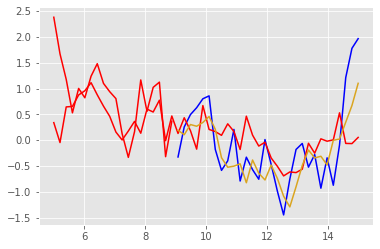

Epoch 81 batch 0 train Loss 0.1333 test Loss 0.1171 with training MSE metric 0.3154 and testing MSE metric 0.2930
learning rate is 0.0003000000142492354


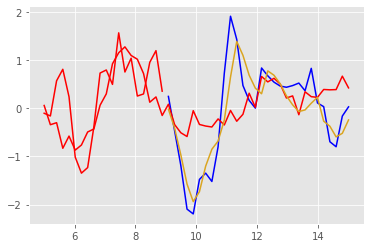

Epoch 81 batch 50 train Loss 0.1489 test Loss 0.1270 with training MSE metric 0.3372 and testing MSE metric 0.3096
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.55499792098999 secs



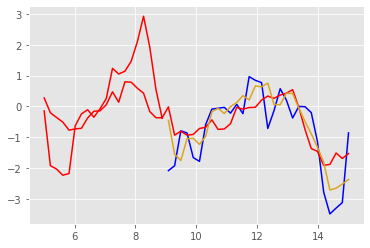

Epoch 82 batch 0 train Loss 0.1423 test Loss 0.1270 with training MSE metric 0.3263 and testing MSE metric 0.3100
learning rate is 0.0003000000142492354


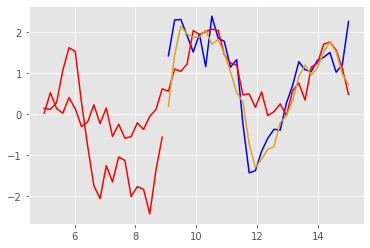

Epoch 82 batch 50 train Loss 0.1386 test Loss 0.1405 with training MSE metric 0.3217 and testing MSE metric 0.3263
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.627568006515503 secs



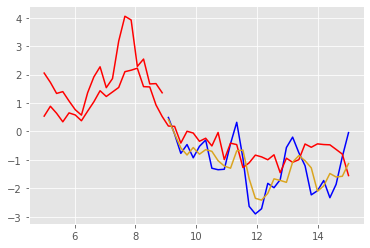

Epoch 83 batch 0 train Loss 0.1440 test Loss 0.1666 with training MSE metric 0.3269 and testing MSE metric 0.3552
learning rate is 0.0003000000142492354


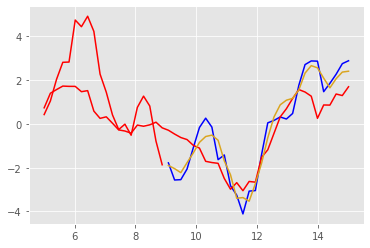

Epoch 83 batch 50 train Loss 0.1227 test Loss 0.1259 with training MSE metric 0.3024 and testing MSE metric 0.3051
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.049827098846436 secs



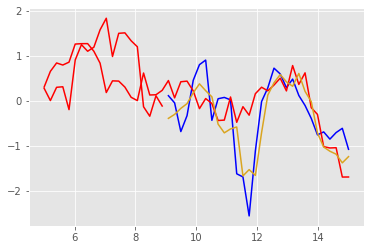

Epoch 84 batch 0 train Loss 0.1353 test Loss 0.1314 with training MSE metric 0.3157 and testing MSE metric 0.3123
learning rate is 0.0003000000142492354


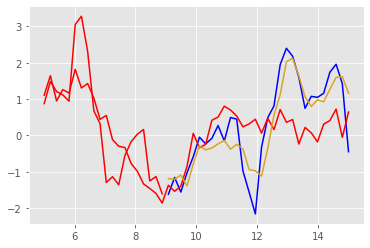

Epoch 84 batch 50 train Loss 0.1288 test Loss 0.1456 with training MSE metric 0.3098 and testing MSE metric 0.3299
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.002118110656738 secs



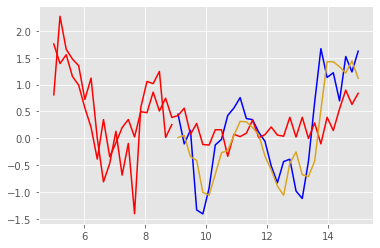

Epoch 85 batch 0 train Loss 0.1308 test Loss 0.1233 with training MSE metric 0.3131 and testing MSE metric 0.3016
learning rate is 0.0003000000142492354


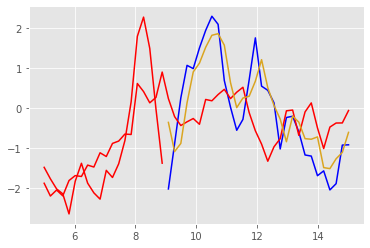

Epoch 85 batch 50 train Loss 0.1337 test Loss 0.1203 with training MSE metric 0.3155 and testing MSE metric 0.2976
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.046839237213135 secs



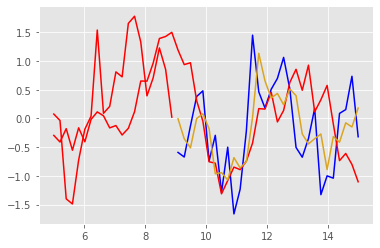

Epoch 86 batch 0 train Loss 0.1395 test Loss 0.1526 with training MSE metric 0.3229 and testing MSE metric 0.3411
learning rate is 0.0003000000142492354


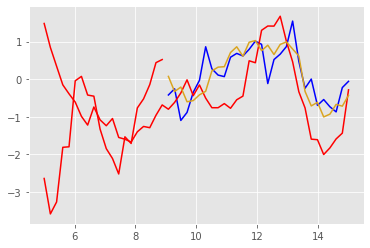

Epoch 86 batch 50 train Loss 0.1638 test Loss 0.1345 with training MSE metric 0.3516 and testing MSE metric 0.3145
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.011214017868042 secs



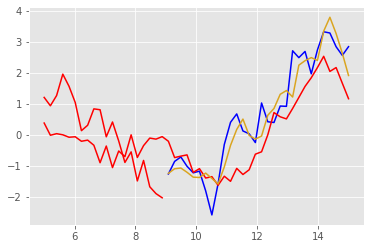

Epoch 87 batch 0 train Loss 0.1186 test Loss 0.1518 with training MSE metric 0.2973 and testing MSE metric 0.3398
learning rate is 0.0003000000142492354


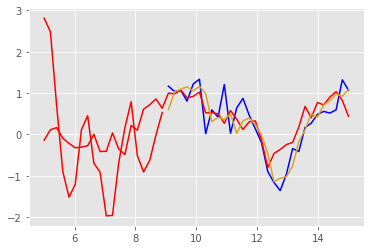

Epoch 87 batch 50 train Loss 0.1615 test Loss 0.1187 with training MSE metric 0.3508 and testing MSE metric 0.2984
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.927081823348999 secs



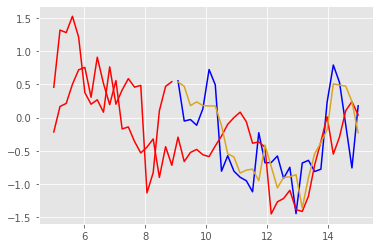

Epoch 88 batch 0 train Loss 0.1470 test Loss 0.1220 with training MSE metric 0.3358 and testing MSE metric 0.3007
learning rate is 0.0003000000142492354


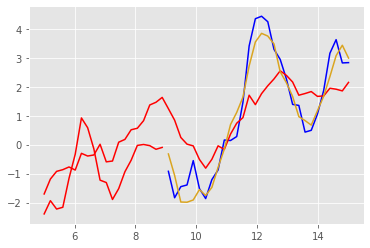

Epoch 88 batch 50 train Loss 0.1372 test Loss 0.1206 with training MSE metric 0.3190 and testing MSE metric 0.2988
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.582136869430542 secs



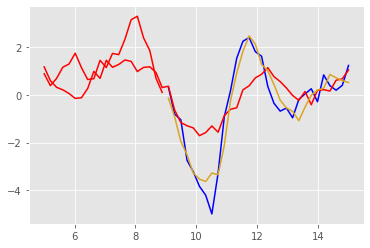

Epoch 89 batch 0 train Loss 0.1267 test Loss 0.1430 with training MSE metric 0.3063 and testing MSE metric 0.3277
learning rate is 0.0003000000142492354


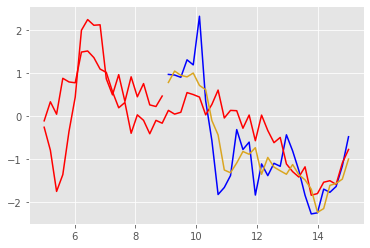

Epoch 89 batch 50 train Loss 0.1236 test Loss 0.1005 with training MSE metric 0.3007 and testing MSE metric 0.2759
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.583789825439453 secs



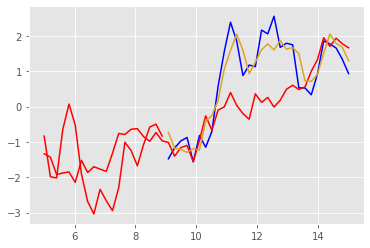

Epoch 90 batch 0 train Loss 0.1488 test Loss 0.1247 with training MSE metric 0.3341 and testing MSE metric 0.3061
learning rate is 0.0003000000142492354


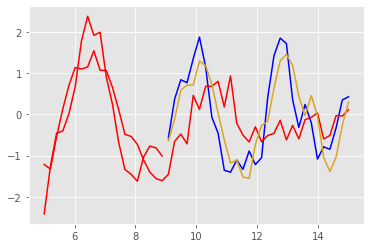

Epoch 90 batch 50 train Loss 0.1329 test Loss 0.1295 with training MSE metric 0.3123 and testing MSE metric 0.3108
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.57300090789795 secs



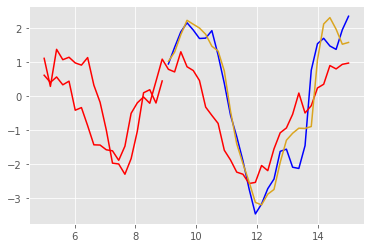

Epoch 91 batch 0 train Loss 0.1219 test Loss 0.1400 with training MSE metric 0.3002 and testing MSE metric 0.3225
learning rate is 0.0003000000142492354


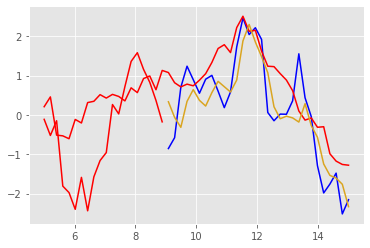

Epoch 91 batch 50 train Loss 0.1320 test Loss 0.1544 with training MSE metric 0.3139 and testing MSE metric 0.3438
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.722764015197754 secs



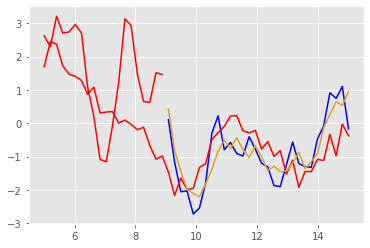

Epoch 92 batch 0 train Loss 0.1503 test Loss 0.1191 with training MSE metric 0.3358 and testing MSE metric 0.3009
learning rate is 0.0003000000142492354


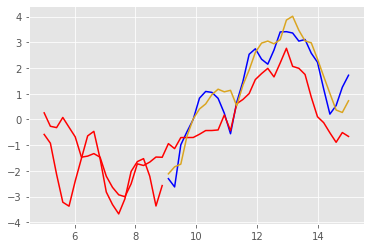

Epoch 92 batch 50 train Loss 0.1440 test Loss 0.1138 with training MSE metric 0.3264 and testing MSE metric 0.2890
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.983965158462524 secs



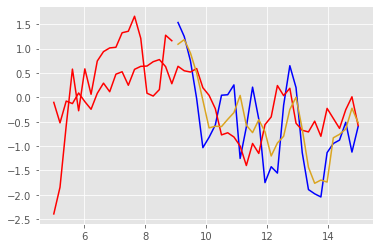

Epoch 93 batch 0 train Loss 0.1054 test Loss 0.1385 with training MSE metric 0.2826 and testing MSE metric 0.3222
learning rate is 0.0003000000142492354


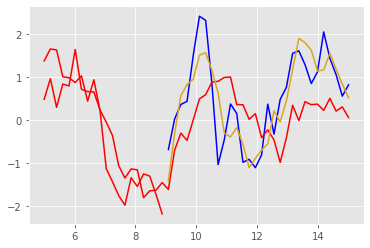

Epoch 93 batch 50 train Loss 0.1479 test Loss 0.1294 with training MSE metric 0.3345 and testing MSE metric 0.3097
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.0262451171875 secs



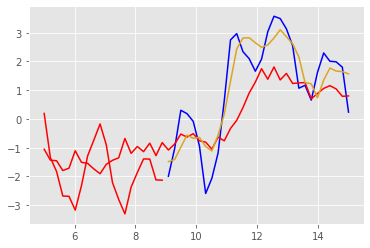

Epoch 94 batch 0 train Loss 0.1352 test Loss 0.1624 with training MSE metric 0.3181 and testing MSE metric 0.3517
learning rate is 0.0003000000142492354


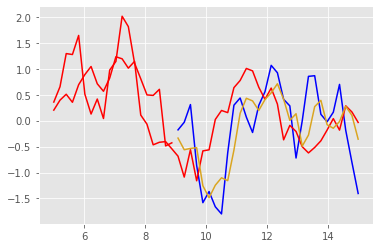

Epoch 94 batch 50 train Loss 0.1296 test Loss 0.1137 with training MSE metric 0.3114 and testing MSE metric 0.2900
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.109547138214111 secs



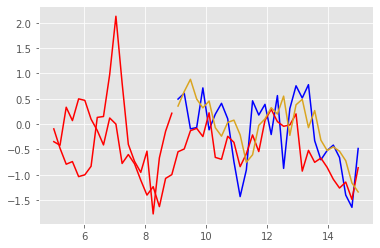

Epoch 95 batch 0 train Loss 0.1248 test Loss 0.1212 with training MSE metric 0.3056 and testing MSE metric 0.2992
learning rate is 0.0003000000142492354


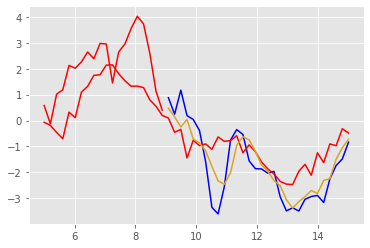

Epoch 95 batch 50 train Loss 0.1385 test Loss 0.1231 with training MSE metric 0.3241 and testing MSE metric 0.3032
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.029064178466797 secs



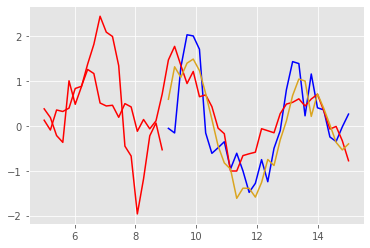

Epoch 96 batch 0 train Loss 0.1596 test Loss 0.1287 with training MSE metric 0.3521 and testing MSE metric 0.3084
learning rate is 0.0003000000142492354


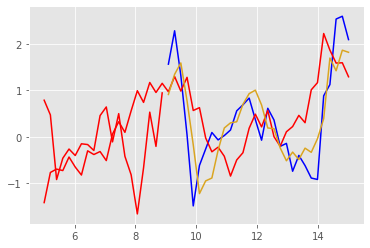

Epoch 96 batch 50 train Loss 0.1198 test Loss 0.1163 with training MSE metric 0.2965 and testing MSE metric 0.2926
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.024593830108643 secs



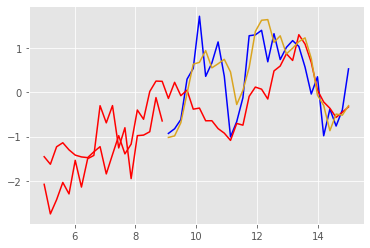

Epoch 97 batch 0 train Loss 0.1046 test Loss 0.1300 with training MSE metric 0.2792 and testing MSE metric 0.3093
learning rate is 0.0003000000142492354


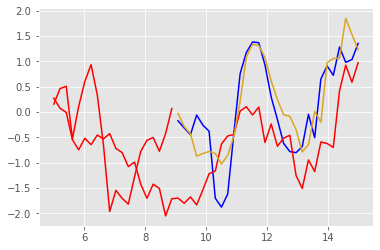

Epoch 97 batch 50 train Loss 0.1344 test Loss 0.1162 with training MSE metric 0.3169 and testing MSE metric 0.2955
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.04486894607544 secs



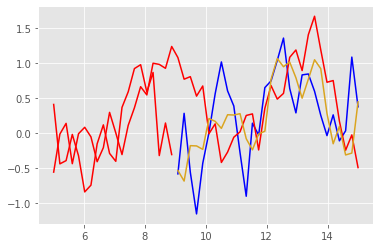

Epoch 98 batch 0 train Loss 0.1584 test Loss 0.1370 with training MSE metric 0.3495 and testing MSE metric 0.3227
learning rate is 0.0003000000142492354


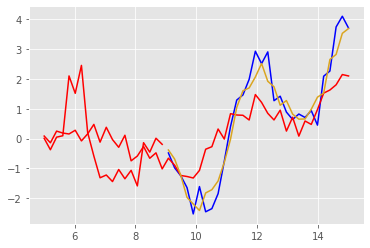

Epoch 98 batch 50 train Loss 0.1533 test Loss 0.1214 with training MSE metric 0.3383 and testing MSE metric 0.2989
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.024998903274536 secs



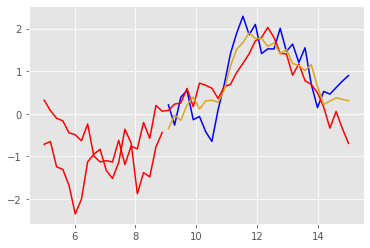

Epoch 99 batch 0 train Loss 0.1488 test Loss 0.1297 with training MSE metric 0.3342 and testing MSE metric 0.3104
learning rate is 0.0003000000142492354


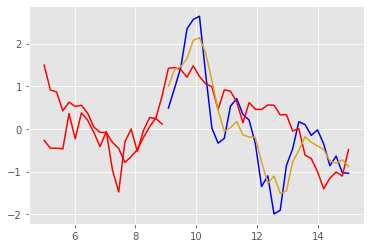

Epoch 99 batch 50 train Loss 0.1230 test Loss 0.1197 with training MSE metric 0.2998 and testing MSE metric 0.2976
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.991909265518188 secs



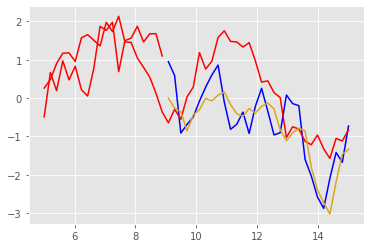

Epoch 100 batch 0 train Loss 0.1271 test Loss 0.1829 with training MSE metric 0.3061 and testing MSE metric 0.3832
learning rate is 0.0003000000142492354


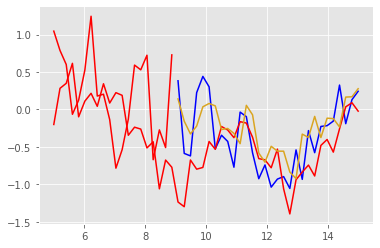

Epoch 100 batch 50 train Loss 0.1335 test Loss 0.1236 with training MSE metric 0.3168 and testing MSE metric 0.3046
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.797996759414673 secs



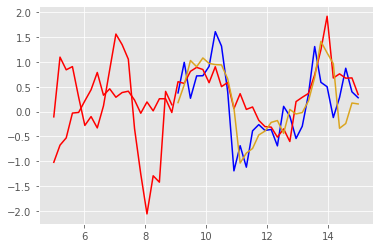

Epoch 101 batch 0 train Loss 0.1406 test Loss 0.1154 with training MSE metric 0.3241 and testing MSE metric 0.2922
learning rate is 0.0003000000142492354


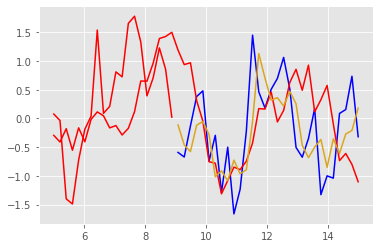

Epoch 101 batch 50 train Loss 0.1249 test Loss 0.1207 with training MSE metric 0.3083 and testing MSE metric 0.3003
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.630691051483154 secs



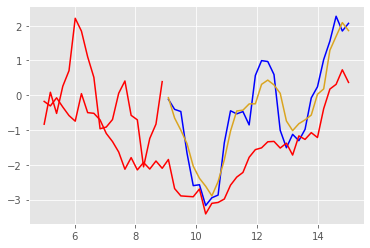

Epoch 102 batch 0 train Loss 0.1385 test Loss 0.1234 with training MSE metric 0.3235 and testing MSE metric 0.2992
learning rate is 0.0003000000142492354


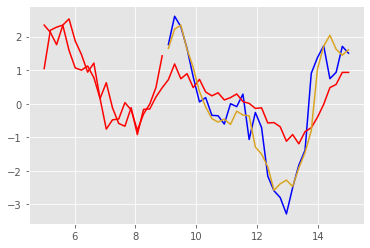

Epoch 102 batch 50 train Loss 0.1470 test Loss 0.1412 with training MSE metric 0.3371 and testing MSE metric 0.3255
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.565145015716553 secs



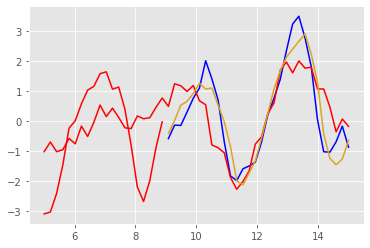

Epoch 103 batch 0 train Loss 0.1408 test Loss 0.1232 with training MSE metric 0.3240 and testing MSE metric 0.3026
learning rate is 0.0003000000142492354


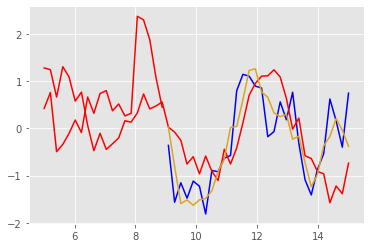

Epoch 103 batch 50 train Loss 0.1411 test Loss 0.1352 with training MSE metric 0.3272 and testing MSE metric 0.3207
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.615758895874023 secs



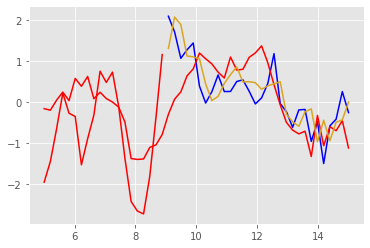

Epoch 104 batch 0 train Loss 0.1570 test Loss 0.1335 with training MSE metric 0.3486 and testing MSE metric 0.3154
learning rate is 0.0003000000142492354


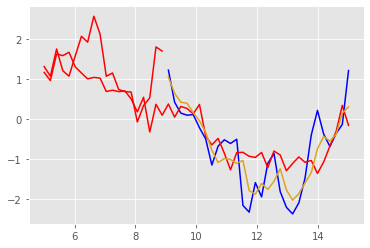

Epoch 104 batch 50 train Loss 0.1337 test Loss 0.1326 with training MSE metric 0.3167 and testing MSE metric 0.3179
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.896668910980225 secs



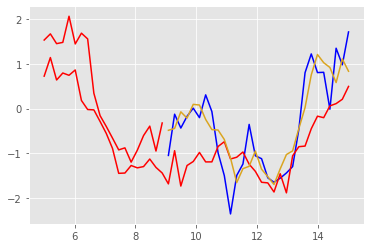

Epoch 105 batch 0 train Loss 0.1183 test Loss 0.0970 with training MSE metric 0.2931 and testing MSE metric 0.2671
learning rate is 0.0003000000142492354


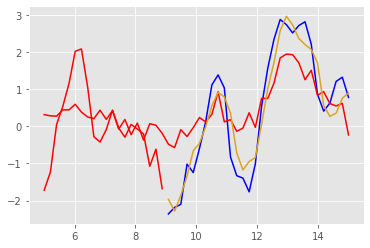

Epoch 105 batch 50 train Loss 0.1430 test Loss 0.1219 with training MSE metric 0.3262 and testing MSE metric 0.3000
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.053448915481567 secs



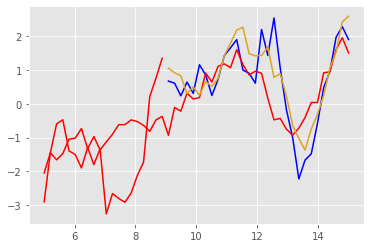

Epoch 106 batch 0 train Loss 0.1356 test Loss 0.1376 with training MSE metric 0.3178 and testing MSE metric 0.3194
learning rate is 0.0003000000142492354


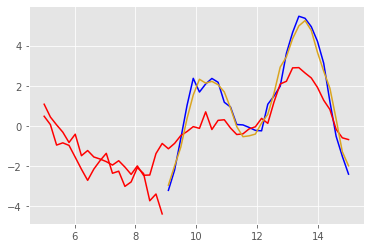

Epoch 106 batch 50 train Loss 0.1377 test Loss 0.1094 with training MSE metric 0.3197 and testing MSE metric 0.2882
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.051270008087158 secs



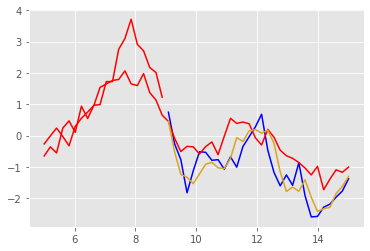

Epoch 107 batch 0 train Loss 0.1527 test Loss 0.1302 with training MSE metric 0.3398 and testing MSE metric 0.3111
learning rate is 0.0003000000142492354


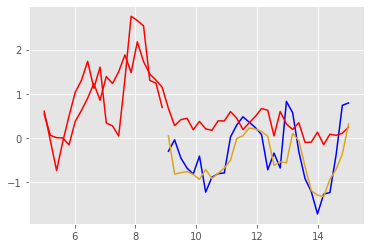

Epoch 107 batch 50 train Loss 0.1410 test Loss 0.1418 with training MSE metric 0.3264 and testing MSE metric 0.3265
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.03578805923462 secs



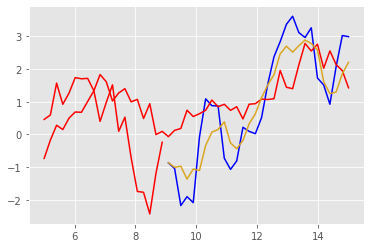

Epoch 108 batch 0 train Loss 0.1221 test Loss 0.1466 with training MSE metric 0.3037 and testing MSE metric 0.3328
learning rate is 0.0003000000142492354


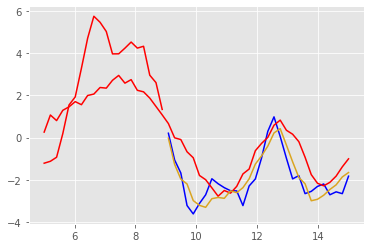

Epoch 108 batch 50 train Loss 0.1841 test Loss 0.1077 with training MSE metric 0.3796 and testing MSE metric 0.2800
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.18042802810669 secs



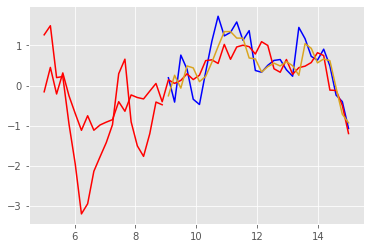

Epoch 109 batch 0 train Loss 0.1224 test Loss 0.1092 with training MSE metric 0.3052 and testing MSE metric 0.2852
learning rate is 0.0003000000142492354


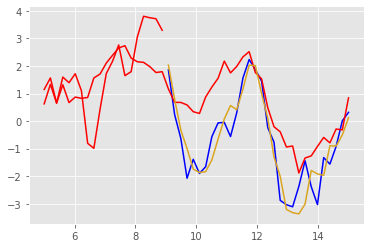

Epoch 109 batch 50 train Loss 0.1293 test Loss 0.1151 with training MSE metric 0.3111 and testing MSE metric 0.2928
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.001245021820068 secs



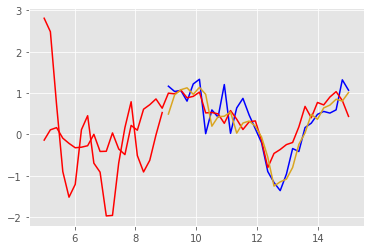

Epoch 110 batch 0 train Loss 0.1450 test Loss 0.1307 with training MSE metric 0.3321 and testing MSE metric 0.3125
learning rate is 0.0003000000142492354


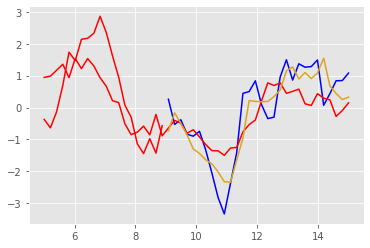

Epoch 110 batch 50 train Loss 0.1146 test Loss 0.1412 with training MSE metric 0.2928 and testing MSE metric 0.3216
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.794827938079834 secs



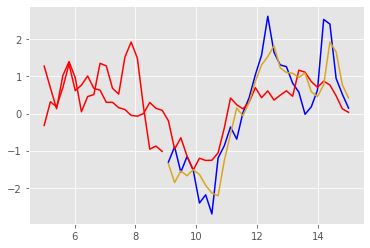

Epoch 111 batch 0 train Loss 0.1378 test Loss 0.1239 with training MSE metric 0.3210 and testing MSE metric 0.3008
learning rate is 0.0003000000142492354


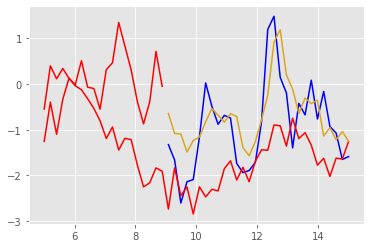

Epoch 111 batch 50 train Loss 0.1499 test Loss 0.1249 with training MSE metric 0.3388 and testing MSE metric 0.3079
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.509106874465942 secs



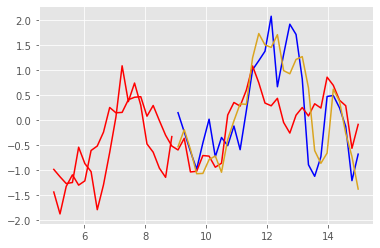

Epoch 112 batch 0 train Loss 0.1152 test Loss 0.1348 with training MSE metric 0.2919 and testing MSE metric 0.3187
learning rate is 0.0003000000142492354


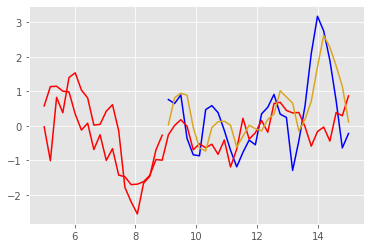

Epoch 112 batch 50 train Loss 0.1262 test Loss 0.1272 with training MSE metric 0.3079 and testing MSE metric 0.3084
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.565796136856079 secs



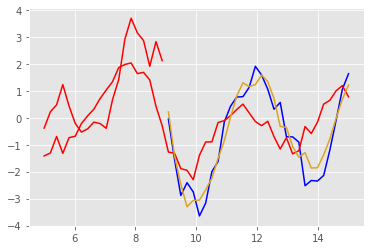

Epoch 113 batch 0 train Loss 0.1418 test Loss 0.1391 with training MSE metric 0.3275 and testing MSE metric 0.3232
learning rate is 0.0003000000142492354


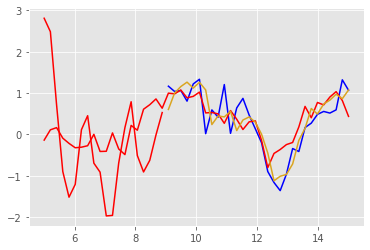

Epoch 113 batch 50 train Loss 0.1219 test Loss 0.1023 with training MSE metric 0.3009 and testing MSE metric 0.2732
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.718424081802368 secs



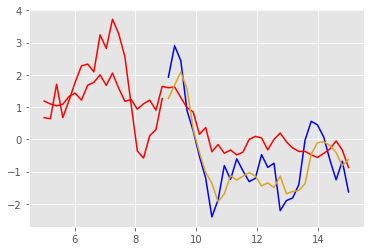

Epoch 114 batch 0 train Loss 0.1178 test Loss 0.1371 with training MSE metric 0.2969 and testing MSE metric 0.3236
learning rate is 0.0003000000142492354


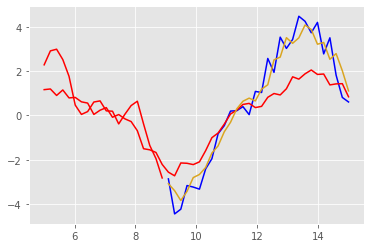

Epoch 114 batch 50 train Loss 0.1201 test Loss 0.1352 with training MSE metric 0.2977 and testing MSE metric 0.3168
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.542166948318481 secs



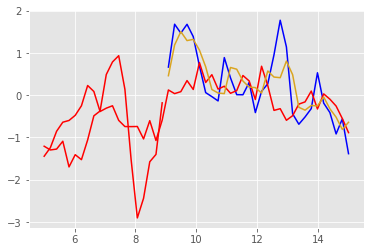

Epoch 115 batch 0 train Loss 0.1296 test Loss 0.1166 with training MSE metric 0.3124 and testing MSE metric 0.2938
learning rate is 0.0003000000142492354


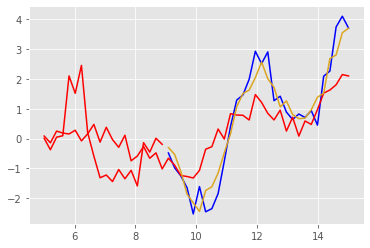

Epoch 115 batch 50 train Loss 0.1383 test Loss 0.1270 with training MSE metric 0.3214 and testing MSE metric 0.3078
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.594329118728638 secs



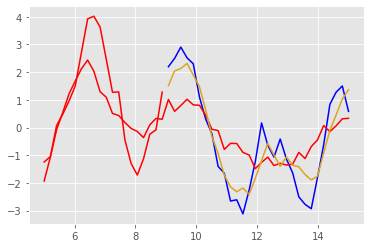

Epoch 116 batch 0 train Loss 0.1232 test Loss 0.1233 with training MSE metric 0.3027 and testing MSE metric 0.3027
learning rate is 0.0003000000142492354


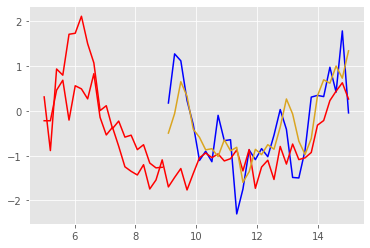

Epoch 116 batch 50 train Loss 0.1222 test Loss 0.1140 with training MSE metric 0.3004 and testing MSE metric 0.2919
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.184463739395142 secs



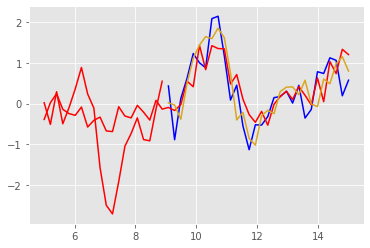

Epoch 117 batch 0 train Loss 0.1234 test Loss 0.1126 with training MSE metric 0.3018 and testing MSE metric 0.2886
learning rate is 0.0003000000142492354


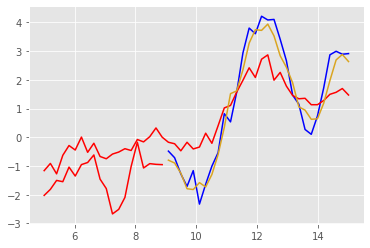

Epoch 117 batch 50 train Loss 0.1605 test Loss 0.1125 with training MSE metric 0.3477 and testing MSE metric 0.2872
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.008062839508057 secs



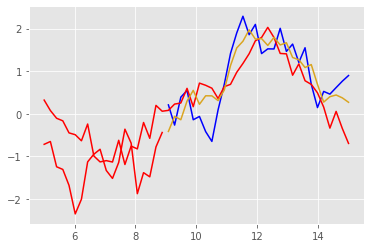

Epoch 118 batch 0 train Loss 0.1344 test Loss 0.1274 with training MSE metric 0.3185 and testing MSE metric 0.3114
learning rate is 0.0003000000142492354


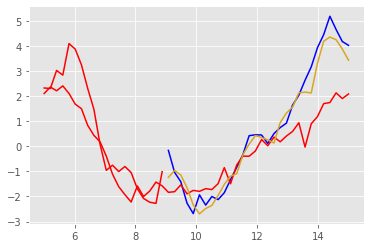

Epoch 118 batch 50 train Loss 0.1071 test Loss 0.1143 with training MSE metric 0.2825 and testing MSE metric 0.2936
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.192126035690308 secs



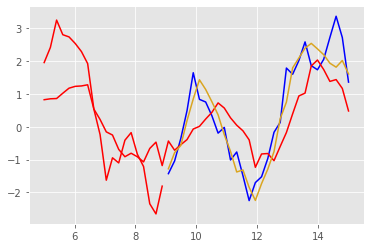

Epoch 119 batch 0 train Loss 0.1358 test Loss 0.1332 with training MSE metric 0.3184 and testing MSE metric 0.3181
learning rate is 0.0003000000142492354


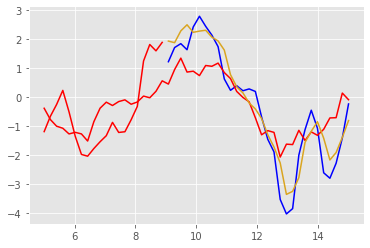

Epoch 119 batch 50 train Loss 0.1475 test Loss 0.1200 with training MSE metric 0.3348 and testing MSE metric 0.2973
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.291260004043579 secs



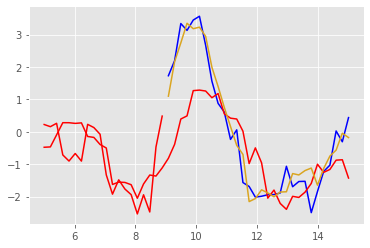

Epoch 120 batch 0 train Loss 0.1354 test Loss 0.1153 with training MSE metric 0.3179 and testing MSE metric 0.2926
learning rate is 0.0003000000142492354


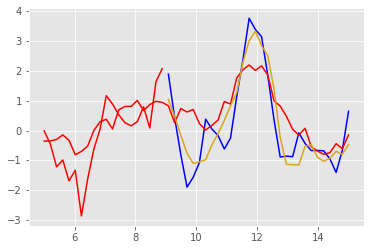

Epoch 120 batch 50 train Loss 0.1060 test Loss 0.1232 with training MSE metric 0.2798 and testing MSE metric 0.3022
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.798861026763916 secs



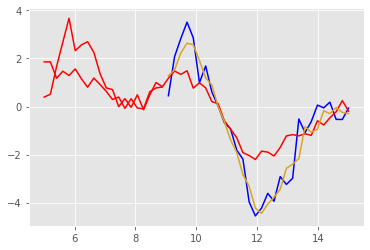

Epoch 121 batch 0 train Loss 0.1275 test Loss 0.1243 with training MSE metric 0.3097 and testing MSE metric 0.3019
learning rate is 0.0003000000142492354


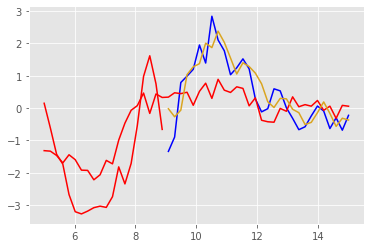

Epoch 121 batch 50 train Loss 0.1342 test Loss 0.1317 with training MSE metric 0.3167 and testing MSE metric 0.3118
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.583207130432129 secs



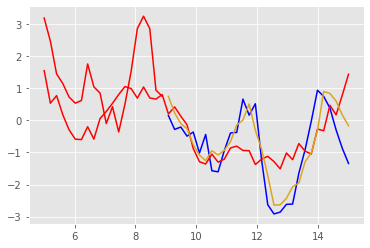

Epoch 122 batch 0 train Loss 0.1152 test Loss 0.1420 with training MSE metric 0.2902 and testing MSE metric 0.3256
learning rate is 0.0003000000142492354


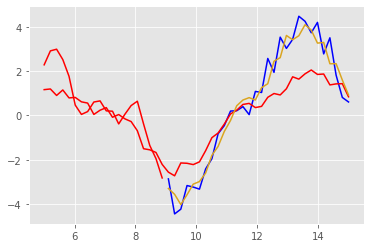

Epoch 122 batch 50 train Loss 0.1317 test Loss 0.1058 with training MSE metric 0.3146 and testing MSE metric 0.2803
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.589231252670288 secs



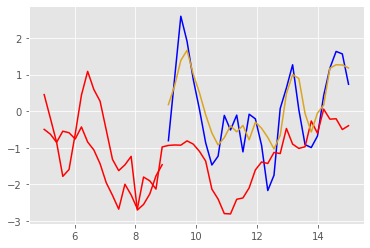

Epoch 123 batch 0 train Loss 0.1386 test Loss 0.1411 with training MSE metric 0.3238 and testing MSE metric 0.3235
learning rate is 0.0003000000142492354


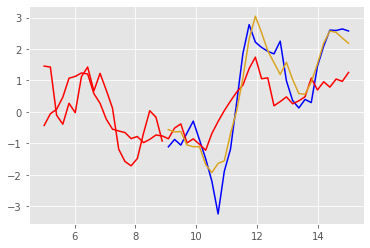

Epoch 123 batch 50 train Loss 0.1241 test Loss 0.1329 with training MSE metric 0.3025 and testing MSE metric 0.3106
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.64338493347168 secs



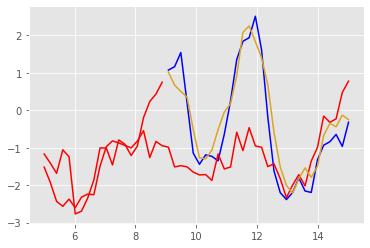

Epoch 124 batch 0 train Loss 0.1611 test Loss 0.1343 with training MSE metric 0.3537 and testing MSE metric 0.3160
learning rate is 0.0003000000142492354


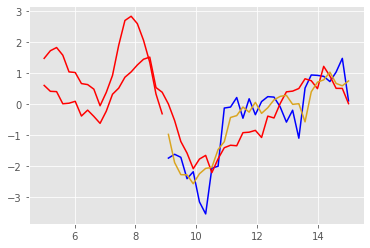

Epoch 124 batch 50 train Loss 0.1605 test Loss 0.1182 with training MSE metric 0.3492 and testing MSE metric 0.2956
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.604306936264038 secs



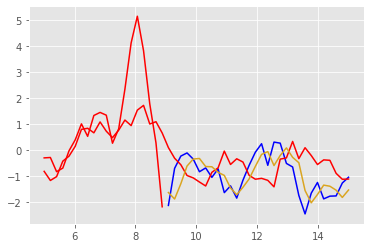

Epoch 125 batch 0 train Loss 0.1476 test Loss 0.1103 with training MSE metric 0.3328 and testing MSE metric 0.2831
learning rate is 0.0003000000142492354


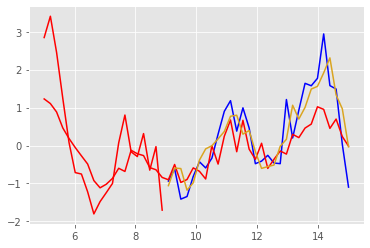

Epoch 125 batch 50 train Loss 0.1487 test Loss 0.1346 with training MSE metric 0.3329 and testing MSE metric 0.3181
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.664476871490479 secs



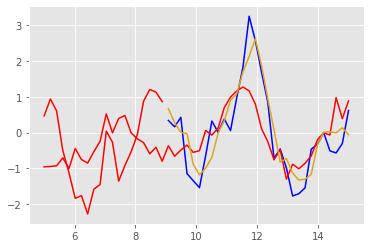

Epoch 126 batch 0 train Loss 0.1016 test Loss 0.1205 with training MSE metric 0.2758 and testing MSE metric 0.3003
learning rate is 0.0003000000142492354


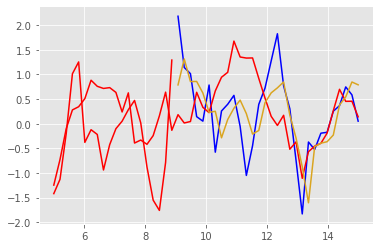

Epoch 126 batch 50 train Loss 0.1437 test Loss 0.1309 with training MSE metric 0.3279 and testing MSE metric 0.3106
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.631470203399658 secs



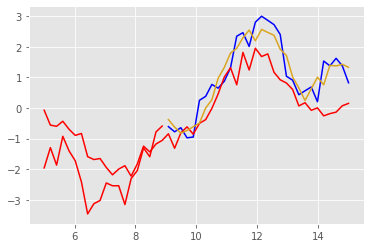

Epoch 127 batch 0 train Loss 0.1102 test Loss 0.1129 with training MSE metric 0.2857 and testing MSE metric 0.2911
learning rate is 0.0003000000142492354


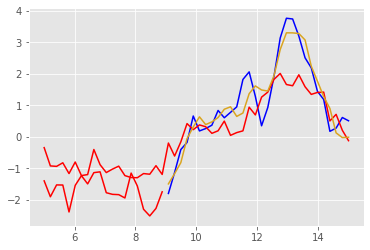

Epoch 127 batch 50 train Loss 0.1461 test Loss 0.0939 with training MSE metric 0.3324 and testing MSE metric 0.2669
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.557505130767822 secs



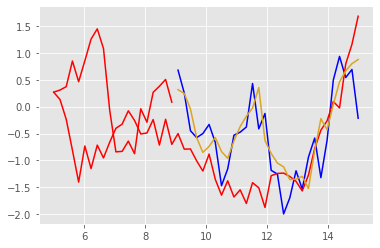

Epoch 128 batch 0 train Loss 0.1382 test Loss 0.1328 with training MSE metric 0.3219 and testing MSE metric 0.3176
learning rate is 0.0003000000142492354


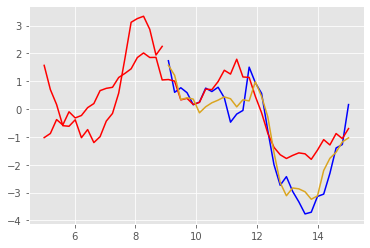

Epoch 128 batch 50 train Loss 0.1220 test Loss 0.1059 with training MSE metric 0.2996 and testing MSE metric 0.2805
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.594009160995483 secs



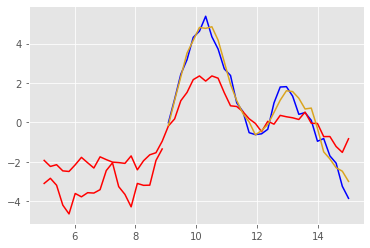

Epoch 129 batch 0 train Loss 0.1470 test Loss 0.1180 with training MSE metric 0.3349 and testing MSE metric 0.2944
learning rate is 0.0003000000142492354


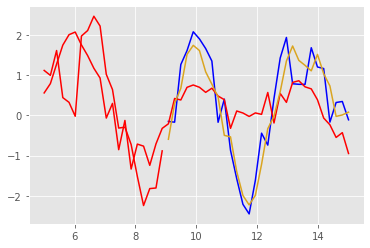

Epoch 129 batch 50 train Loss 0.1142 test Loss 0.0882 with training MSE metric 0.2896 and testing MSE metric 0.2614
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.55584716796875 secs



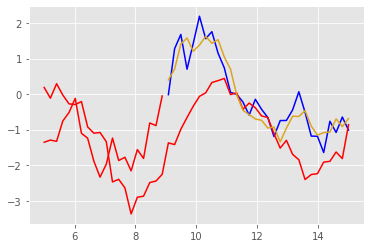

Epoch 130 batch 0 train Loss 0.1357 test Loss 0.1287 with training MSE metric 0.3165 and testing MSE metric 0.3071
learning rate is 0.0003000000142492354


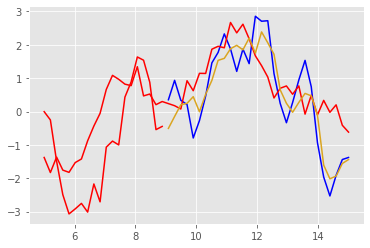

Epoch 130 batch 50 train Loss 0.1490 test Loss 0.1025 with training MSE metric 0.3368 and testing MSE metric 0.2761
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.530683279037476 secs



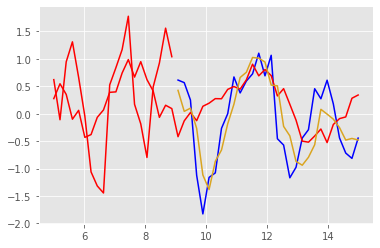

Epoch 131 batch 0 train Loss 0.1261 test Loss 0.1289 with training MSE metric 0.3069 and testing MSE metric 0.3127
learning rate is 0.0003000000142492354


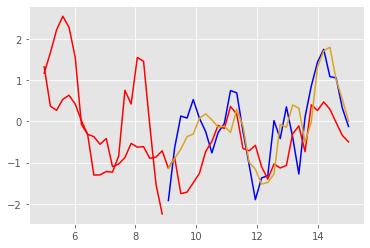

Epoch 131 batch 50 train Loss 0.1128 test Loss 0.1117 with training MSE metric 0.2925 and testing MSE metric 0.2900
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.8128080368042 secs



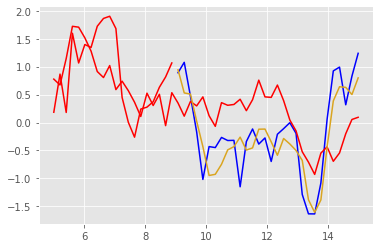

Epoch 132 batch 0 train Loss 0.1169 test Loss 0.0804 with training MSE metric 0.2962 and testing MSE metric 0.2495
learning rate is 0.0003000000142492354


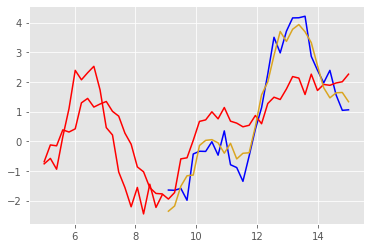

Epoch 132 batch 50 train Loss 0.1227 test Loss 0.1094 with training MSE metric 0.3010 and testing MSE metric 0.2830
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.096494913101196 secs



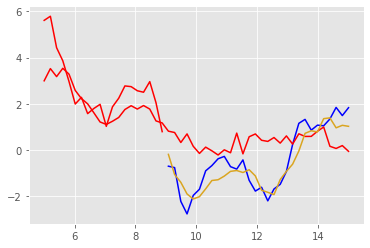

Epoch 133 batch 0 train Loss 0.1283 test Loss 0.1241 with training MSE metric 0.3078 and testing MSE metric 0.3029
learning rate is 0.0003000000142492354


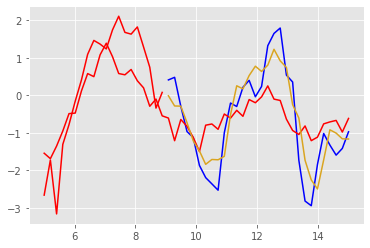

Epoch 133 batch 50 train Loss 0.1436 test Loss 0.1199 with training MSE metric 0.3292 and testing MSE metric 0.2977
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.039523839950562 secs



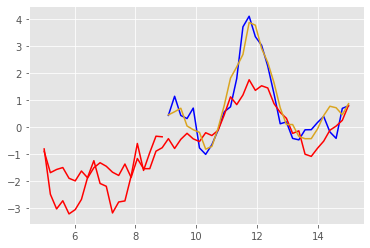

Epoch 134 batch 0 train Loss 0.1482 test Loss 0.1160 with training MSE metric 0.3338 and testing MSE metric 0.2935
learning rate is 0.0003000000142492354


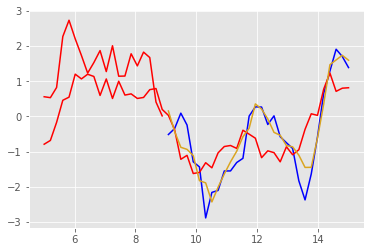

Epoch 134 batch 50 train Loss 0.1003 test Loss 0.1186 with training MSE metric 0.2730 and testing MSE metric 0.2945
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.794211149215698 secs



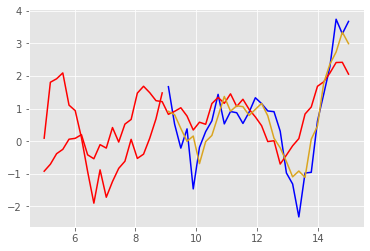

Epoch 135 batch 0 train Loss 0.1301 test Loss 0.1163 with training MSE metric 0.3131 and testing MSE metric 0.2955
learning rate is 0.0003000000142492354


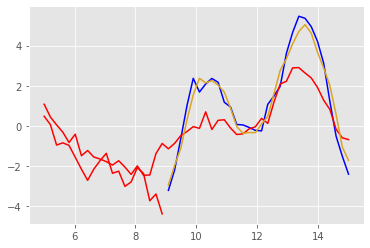

Epoch 135 batch 50 train Loss 0.1450 test Loss 0.1054 with training MSE metric 0.3320 and testing MSE metric 0.2798
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.616367101669312 secs



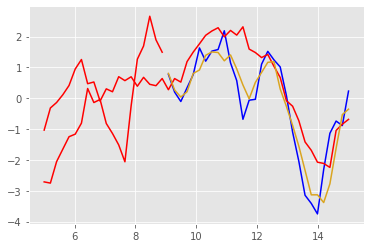

Epoch 136 batch 0 train Loss 0.1388 test Loss 0.1257 with training MSE metric 0.3265 and testing MSE metric 0.3080
learning rate is 0.0003000000142492354


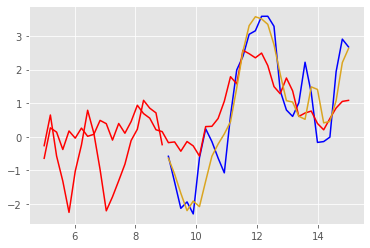

Epoch 136 batch 50 train Loss 0.1359 test Loss 0.1276 with training MSE metric 0.3193 and testing MSE metric 0.3080
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.529242277145386 secs



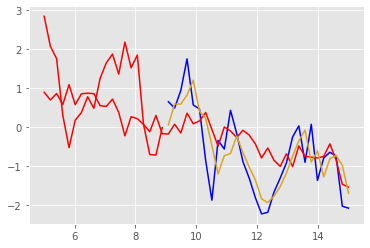

Epoch 137 batch 0 train Loss 0.1328 test Loss 0.1283 with training MSE metric 0.3143 and testing MSE metric 0.3109
learning rate is 0.0003000000142492354


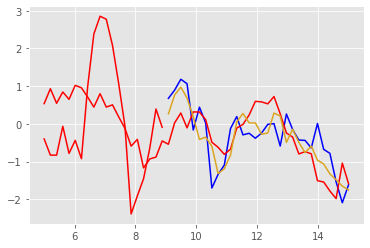

Epoch 137 batch 50 train Loss 0.1023 test Loss 0.1223 with training MSE metric 0.2787 and testing MSE metric 0.3017
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.55905795097351 secs



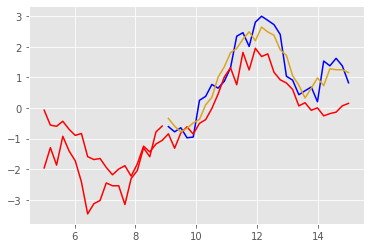

Epoch 138 batch 0 train Loss 0.1377 test Loss 0.1114 with training MSE metric 0.3237 and testing MSE metric 0.2911
learning rate is 0.0003000000142492354


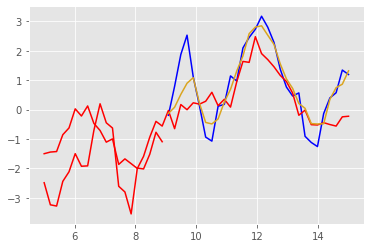

Epoch 138 batch 50 train Loss 0.1442 test Loss 0.1178 with training MSE metric 0.3293 and testing MSE metric 0.2925
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.554105997085571 secs



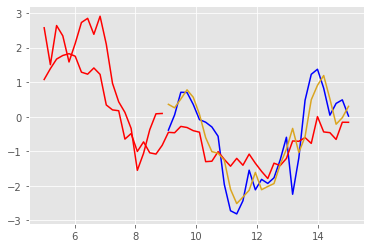

Epoch 139 batch 0 train Loss 0.1240 test Loss 0.0943 with training MSE metric 0.3024 and testing MSE metric 0.2664
learning rate is 0.0003000000142492354


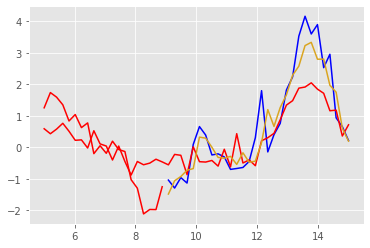

Epoch 139 batch 50 train Loss 0.1276 test Loss 0.1413 with training MSE metric 0.3088 and testing MSE metric 0.3275
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.58156681060791 secs



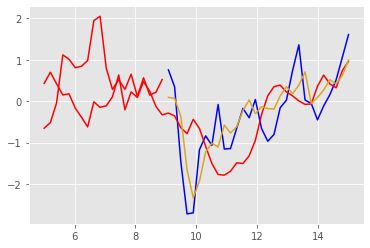

Epoch 140 batch 0 train Loss 0.1057 test Loss 0.1105 with training MSE metric 0.2821 and testing MSE metric 0.2867
learning rate is 0.0003000000142492354


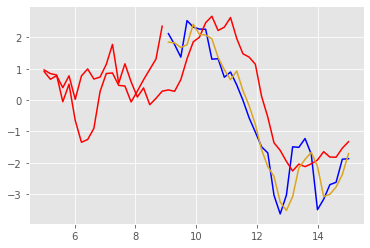

Epoch 140 batch 50 train Loss 0.1142 test Loss 0.1019 with training MSE metric 0.2928 and testing MSE metric 0.2746
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.579059839248657 secs



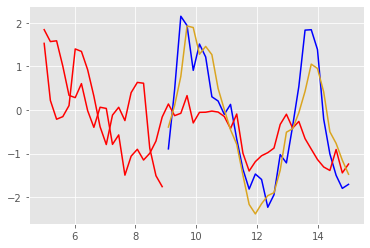

Epoch 141 batch 0 train Loss 0.1199 test Loss 0.0983 with training MSE metric 0.3014 and testing MSE metric 0.2727
learning rate is 0.0003000000142492354


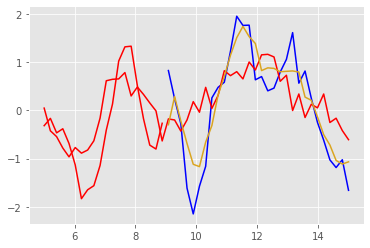

Epoch 141 batch 50 train Loss 0.1683 test Loss 0.0794 with training MSE metric 0.3644 and testing MSE metric 0.2466
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.563383102416992 secs



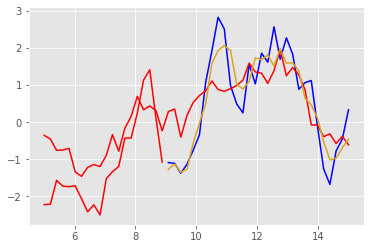

Epoch 142 batch 0 train Loss 0.1246 test Loss 0.1357 with training MSE metric 0.3057 and testing MSE metric 0.3172
learning rate is 0.0003000000142492354


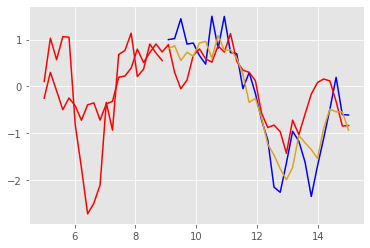

Epoch 142 batch 50 train Loss 0.1212 test Loss 0.1129 with training MSE metric 0.3026 and testing MSE metric 0.2901
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.704469919204712 secs



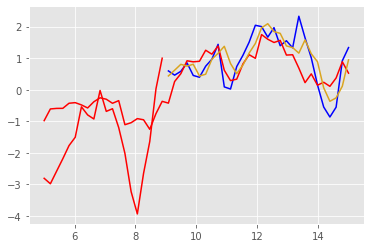

Epoch 143 batch 0 train Loss 0.1270 test Loss 0.1107 with training MSE metric 0.3113 and testing MSE metric 0.2880
learning rate is 0.0003000000142492354


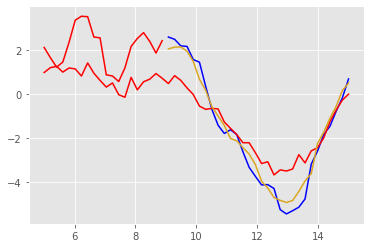

Epoch 143 batch 50 train Loss 0.1199 test Loss 0.1290 with training MSE metric 0.2989 and testing MSE metric 0.3094
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.521130084991455 secs



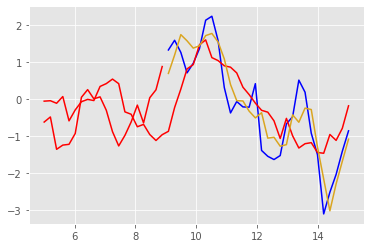

Epoch 144 batch 0 train Loss 0.1327 test Loss 0.1270 with training MSE metric 0.3154 and testing MSE metric 0.3075
learning rate is 0.0003000000142492354


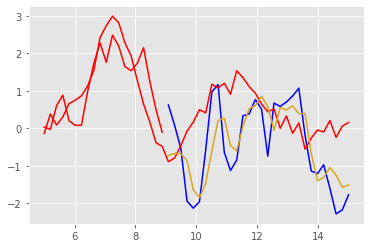

Epoch 144 batch 50 train Loss 0.1518 test Loss 0.1186 with training MSE metric 0.3367 and testing MSE metric 0.2963
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.674934148788452 secs



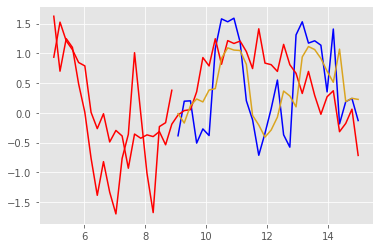

Epoch 145 batch 0 train Loss 0.1216 test Loss 0.1234 with training MSE metric 0.3004 and testing MSE metric 0.3052
learning rate is 0.0003000000142492354


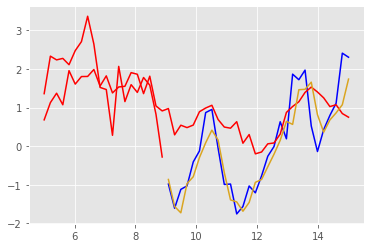

Epoch 145 batch 50 train Loss 0.1661 test Loss 0.1208 with training MSE metric 0.3571 and testing MSE metric 0.2992
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.603739261627197 secs



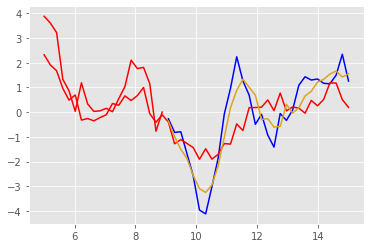

Epoch 146 batch 0 train Loss 0.1359 test Loss 0.1237 with training MSE metric 0.3176 and testing MSE metric 0.3005
learning rate is 0.0003000000142492354


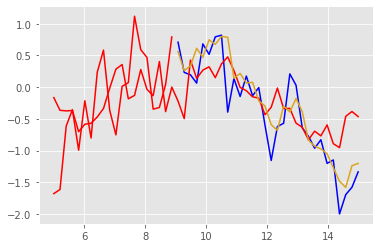

Epoch 146 batch 50 train Loss 0.1083 test Loss 0.1109 with training MSE metric 0.2865 and testing MSE metric 0.2888
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.585527896881104 secs



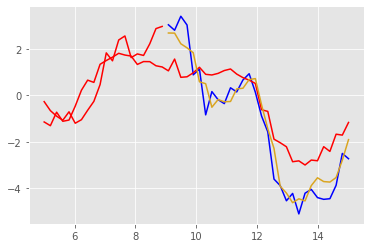

Epoch 147 batch 0 train Loss 0.1336 test Loss 0.1359 with training MSE metric 0.3167 and testing MSE metric 0.3170
learning rate is 0.0003000000142492354


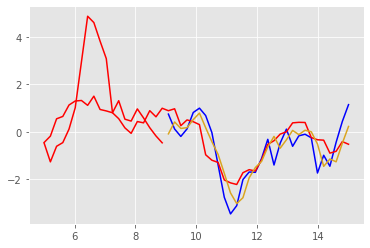

Epoch 147 batch 50 train Loss 0.1213 test Loss 0.1329 with training MSE metric 0.2993 and testing MSE metric 0.3136
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.556782722473145 secs



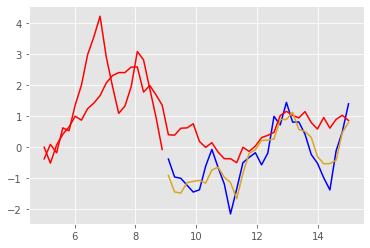

Epoch 148 batch 0 train Loss 0.1376 test Loss 0.1331 with training MSE metric 0.3244 and testing MSE metric 0.3140
learning rate is 0.0003000000142492354


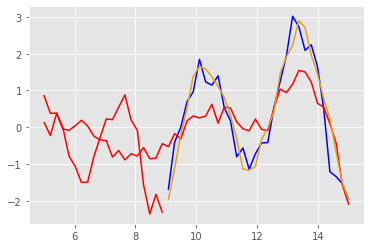

Epoch 148 batch 50 train Loss 0.1259 test Loss 0.1371 with training MSE metric 0.3077 and testing MSE metric 0.3162
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.604899168014526 secs



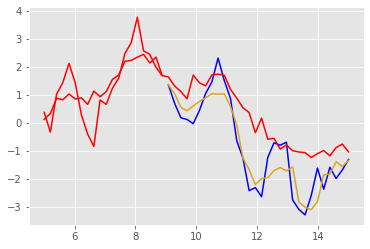

Epoch 149 batch 0 train Loss 0.1031 test Loss 0.1032 with training MSE metric 0.2831 and testing MSE metric 0.2802
learning rate is 0.0003000000142492354


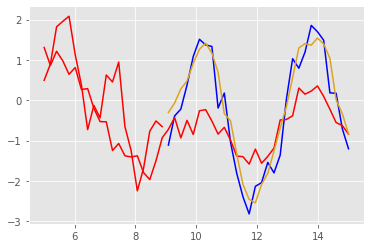

Epoch 149 batch 50 train Loss 0.1220 test Loss 0.1277 with training MSE metric 0.3030 and testing MSE metric 0.3064
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.599511623382568 secs



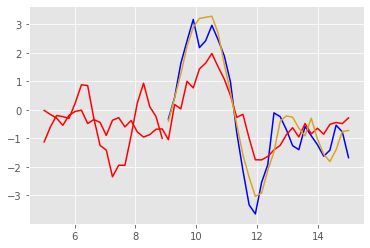

Epoch 150 batch 0 train Loss 0.1109 test Loss 0.0991 with training MSE metric 0.2859 and testing MSE metric 0.2705
learning rate is 0.0003000000142492354


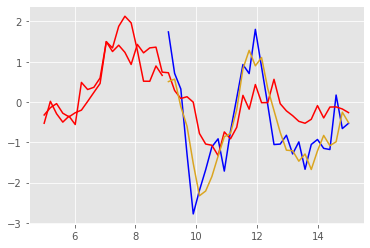

Epoch 150 batch 50 train Loss 0.1138 test Loss 0.1274 with training MSE metric 0.2919 and testing MSE metric 0.3059
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.787070989608765 secs



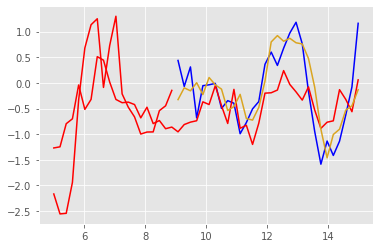

Epoch 151 batch 0 train Loss 0.1243 test Loss 0.0922 with training MSE metric 0.3067 and testing MSE metric 0.2683
learning rate is 0.0003000000142492354


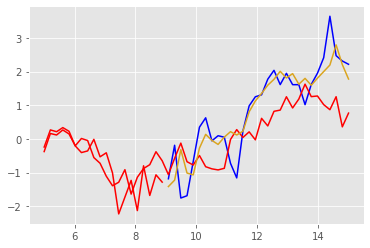

Epoch 151 batch 50 train Loss 0.1261 test Loss 0.1116 with training MSE metric 0.3086 and testing MSE metric 0.2895
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.044244289398193 secs



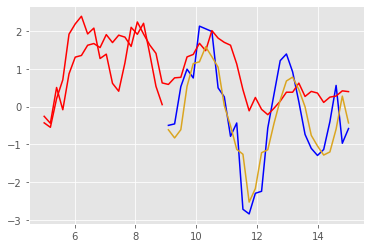

Epoch 152 batch 0 train Loss 0.1312 test Loss 0.1054 with training MSE metric 0.3149 and testing MSE metric 0.2841
learning rate is 0.0003000000142492354


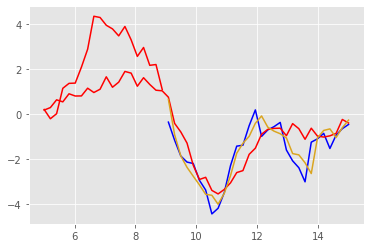

Epoch 152 batch 50 train Loss 0.1235 test Loss 0.1281 with training MSE metric 0.3049 and testing MSE metric 0.3081
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.103410005569458 secs



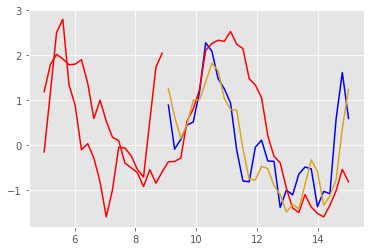

Epoch 153 batch 0 train Loss 0.1363 test Loss 0.1046 with training MSE metric 0.3196 and testing MSE metric 0.2790
learning rate is 0.0003000000142492354


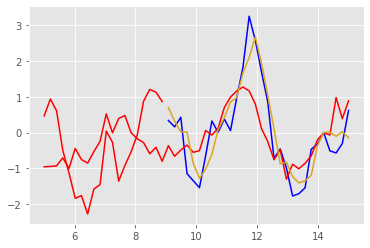

Epoch 153 batch 50 train Loss 0.1417 test Loss 0.1208 with training MSE metric 0.3268 and testing MSE metric 0.3001
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.18978500366211 secs



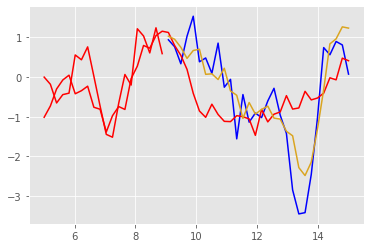

Epoch 154 batch 0 train Loss 0.1085 test Loss 0.1298 with training MSE metric 0.2834 and testing MSE metric 0.3120
learning rate is 0.0003000000142492354


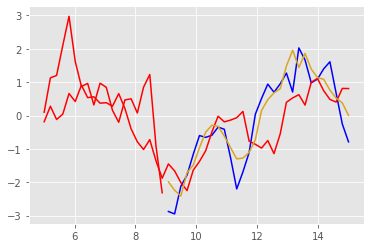

Epoch 154 batch 50 train Loss 0.1034 test Loss 0.1157 with training MSE metric 0.2774 and testing MSE metric 0.2941
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.805535078048706 secs



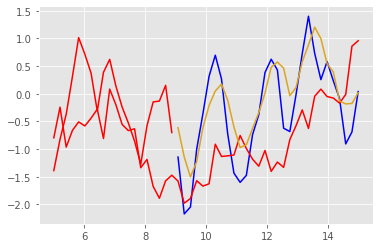

Epoch 155 batch 0 train Loss 0.1117 test Loss 0.1177 with training MSE metric 0.2882 and testing MSE metric 0.2962
learning rate is 0.0003000000142492354


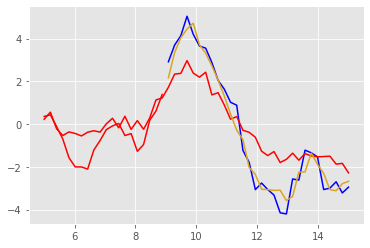

Epoch 155 batch 50 train Loss 0.1056 test Loss 0.1389 with training MSE metric 0.2828 and testing MSE metric 0.3245
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.816203117370605 secs



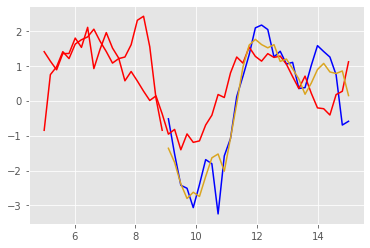

Epoch 156 batch 0 train Loss 0.1205 test Loss 0.1436 with training MSE metric 0.2981 and testing MSE metric 0.3260
learning rate is 0.0003000000142492354


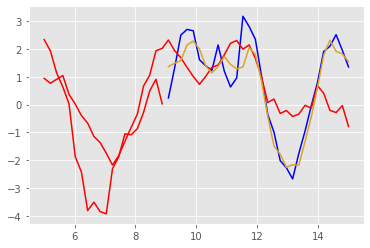

Epoch 156 batch 50 train Loss 0.1227 test Loss 0.1227 with training MSE metric 0.3011 and testing MSE metric 0.2995
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.828847169876099 secs



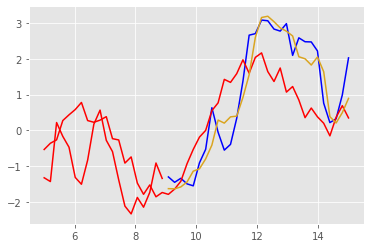

Epoch 157 batch 0 train Loss 0.1235 test Loss 0.1229 with training MSE metric 0.3014 and testing MSE metric 0.3029
learning rate is 0.0003000000142492354


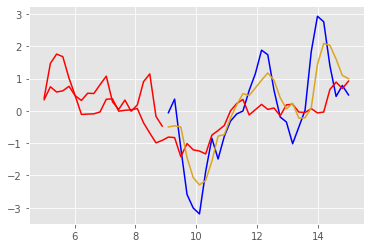

Epoch 157 batch 50 train Loss 0.1363 test Loss 0.1277 with training MSE metric 0.3177 and testing MSE metric 0.3087
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.817188024520874 secs



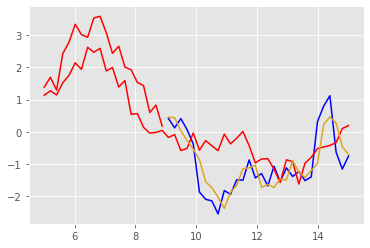

Epoch 158 batch 0 train Loss 0.1188 test Loss 0.1229 with training MSE metric 0.2991 and testing MSE metric 0.2991
learning rate is 0.0003000000142492354


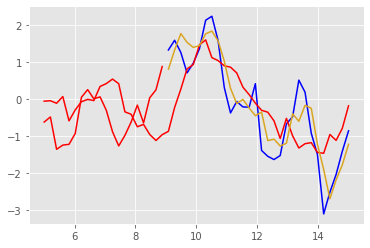

Epoch 158 batch 50 train Loss 0.1071 test Loss 0.1329 with training MSE metric 0.2820 and testing MSE metric 0.3160
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.800749063491821 secs



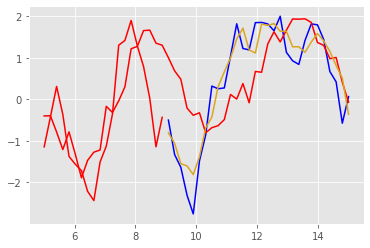

Epoch 159 batch 0 train Loss 0.1543 test Loss 0.1106 with training MSE metric 0.3406 and testing MSE metric 0.2868
learning rate is 0.0003000000142492354


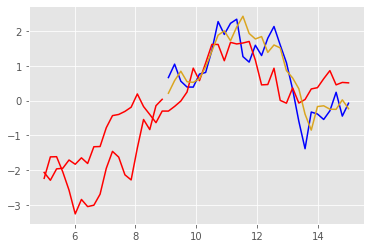

Epoch 159 batch 50 train Loss 0.1506 test Loss 0.0988 with training MSE metric 0.3388 and testing MSE metric 0.2742
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.757710933685303 secs



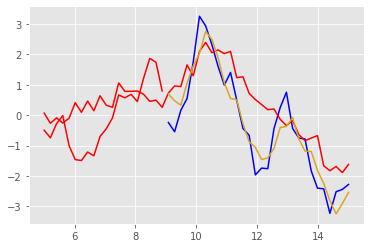

Epoch 160 batch 0 train Loss 0.1292 test Loss 0.1408 with training MSE metric 0.3100 and testing MSE metric 0.3194
learning rate is 0.0003000000142492354


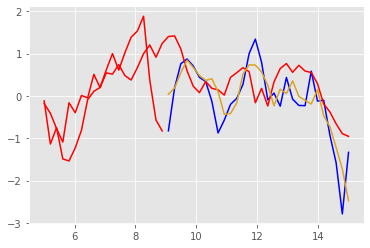

Epoch 160 batch 50 train Loss 0.1190 test Loss 0.1260 with training MSE metric 0.3005 and testing MSE metric 0.3109
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.407198905944824 secs



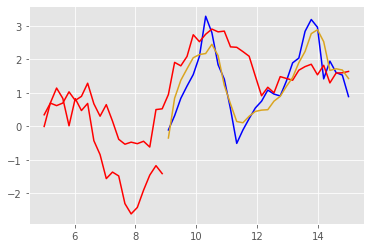

Epoch 161 batch 0 train Loss 0.1346 test Loss 0.1237 with training MSE metric 0.3159 and testing MSE metric 0.3004
learning rate is 0.0003000000142492354


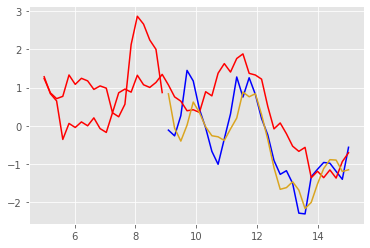

Epoch 161 batch 50 train Loss 0.1352 test Loss 0.1033 with training MSE metric 0.3225 and testing MSE metric 0.2753
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.477813005447388 secs



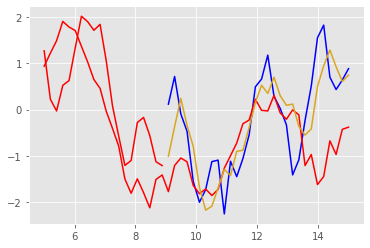

Epoch 162 batch 0 train Loss 0.1522 test Loss 0.1267 with training MSE metric 0.3374 and testing MSE metric 0.3099
learning rate is 0.0003000000142492354


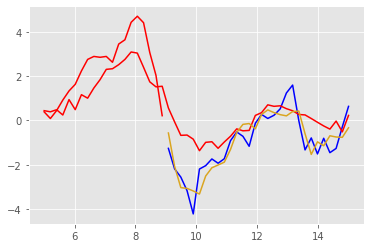

Epoch 162 batch 50 train Loss 0.1164 test Loss 0.1303 with training MSE metric 0.2965 and testing MSE metric 0.3142
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.75791311264038 secs



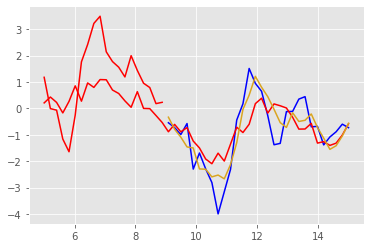

Epoch 163 batch 0 train Loss 0.1168 test Loss 0.1200 with training MSE metric 0.2979 and testing MSE metric 0.2980
learning rate is 0.0003000000142492354


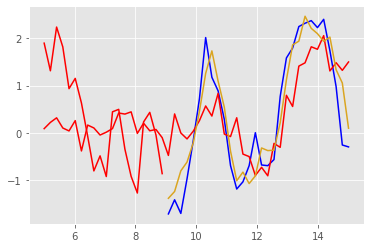

Epoch 163 batch 50 train Loss 0.1493 test Loss 0.1252 with training MSE metric 0.3383 and testing MSE metric 0.3058
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.272334814071655 secs



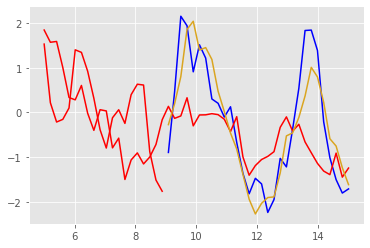

Epoch 164 batch 0 train Loss 0.1474 test Loss 0.1189 with training MSE metric 0.3354 and testing MSE metric 0.2993
learning rate is 0.0003000000142492354


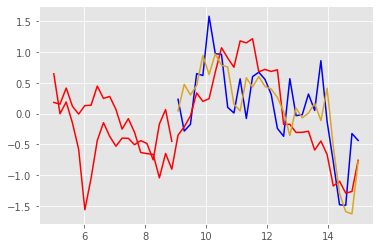

Epoch 164 batch 50 train Loss 0.1180 test Loss 0.1466 with training MSE metric 0.2975 and testing MSE metric 0.3305
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.259861946105957 secs



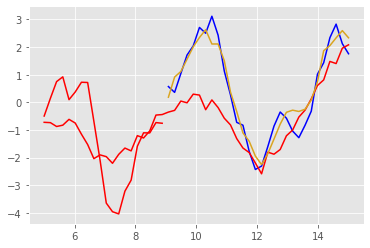

Epoch 165 batch 0 train Loss 0.1223 test Loss 0.1258 with training MSE metric 0.3042 and testing MSE metric 0.3078
learning rate is 0.0003000000142492354


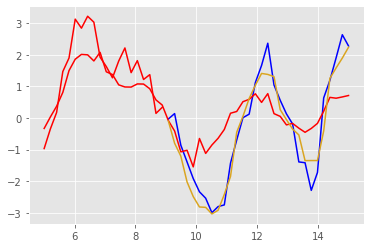

Epoch 165 batch 50 train Loss 0.1184 test Loss 0.1190 with training MSE metric 0.2991 and testing MSE metric 0.2970
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.178050994873047 secs



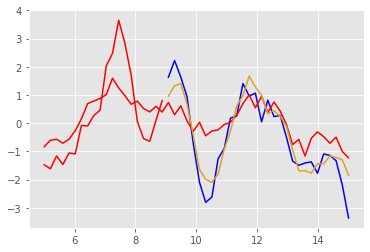

Epoch 166 batch 0 train Loss 0.1268 test Loss 0.1120 with training MSE metric 0.3097 and testing MSE metric 0.2892
learning rate is 0.0003000000142492354


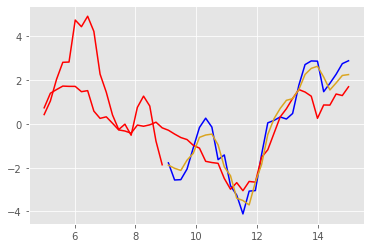

Epoch 166 batch 50 train Loss 0.1308 test Loss 0.1090 with training MSE metric 0.3091 and testing MSE metric 0.2858
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.779679775238037 secs



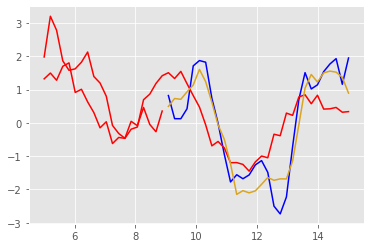

Epoch 167 batch 0 train Loss 0.1379 test Loss 0.1224 with training MSE metric 0.3191 and testing MSE metric 0.3019
learning rate is 0.0003000000142492354


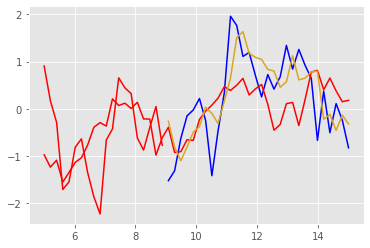

Epoch 167 batch 50 train Loss 0.1354 test Loss 0.1172 with training MSE metric 0.3175 and testing MSE metric 0.2939
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.86101508140564 secs



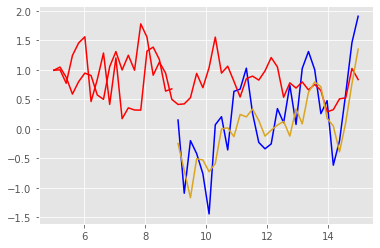

Epoch 168 batch 0 train Loss 0.1110 test Loss 0.1113 with training MSE metric 0.2890 and testing MSE metric 0.2890
learning rate is 0.0003000000142492354


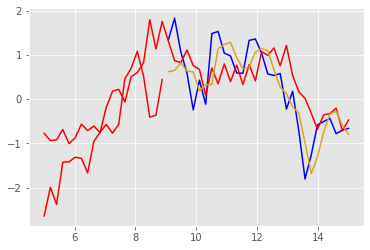

Epoch 168 batch 50 train Loss 0.1272 test Loss 0.1218 with training MSE metric 0.3088 and testing MSE metric 0.3008
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.923469066619873 secs



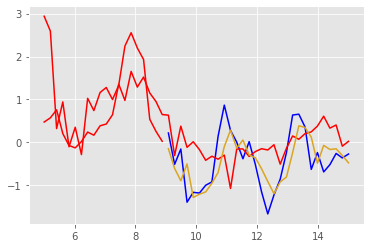

Epoch 169 batch 0 train Loss 0.1375 test Loss 0.1347 with training MSE metric 0.3203 and testing MSE metric 0.3188
learning rate is 0.0003000000142492354


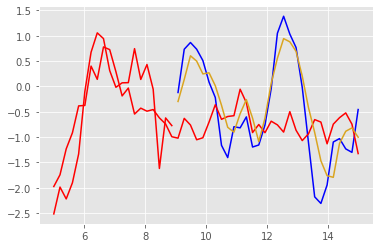

Epoch 169 batch 50 train Loss 0.1290 test Loss 0.1217 with training MSE metric 0.3093 and testing MSE metric 0.3023
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.919716835021973 secs



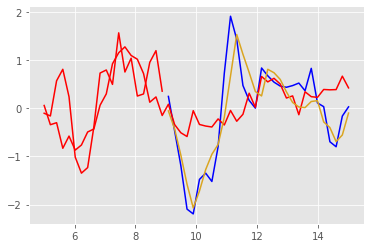

Epoch 170 batch 0 train Loss 0.1223 test Loss 0.1293 with training MSE metric 0.3037 and testing MSE metric 0.3090
learning rate is 0.0003000000142492354


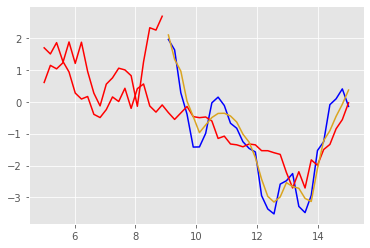

Epoch 170 batch 50 train Loss 0.1468 test Loss 0.0949 with training MSE metric 0.3349 and testing MSE metric 0.2705
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.782068014144897 secs



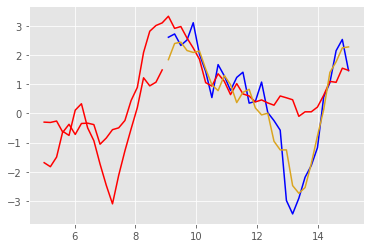

Epoch 171 batch 0 train Loss 0.1189 test Loss 0.1202 with training MSE metric 0.3042 and testing MSE metric 0.2997
learning rate is 0.0003000000142492354


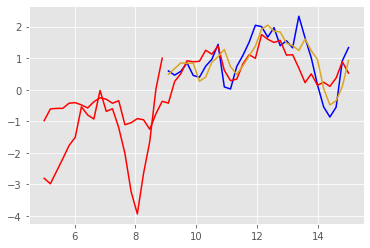

Epoch 171 batch 50 train Loss 0.1332 test Loss 0.1223 with training MSE metric 0.3151 and testing MSE metric 0.3002
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.902366161346436 secs



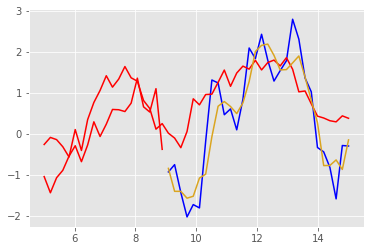

Epoch 172 batch 0 train Loss 0.1176 test Loss 0.1053 with training MSE metric 0.2966 and testing MSE metric 0.2802
learning rate is 0.0003000000142492354


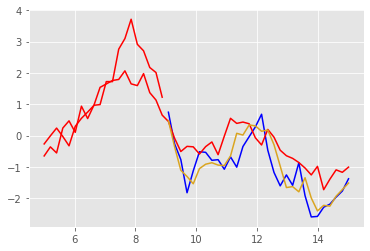

Epoch 172 batch 50 train Loss 0.1420 test Loss 0.1389 with training MSE metric 0.3264 and testing MSE metric 0.3183
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.911655902862549 secs



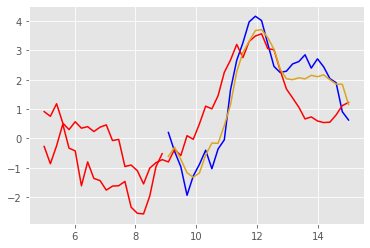

Epoch 173 batch 0 train Loss 0.1493 test Loss 0.1288 with training MSE metric 0.3352 and testing MSE metric 0.3087
learning rate is 0.0003000000142492354


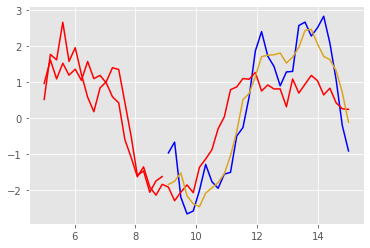

Epoch 173 batch 50 train Loss 0.1098 test Loss 0.0881 with training MSE metric 0.2867 and testing MSE metric 0.2591
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.952713966369629 secs



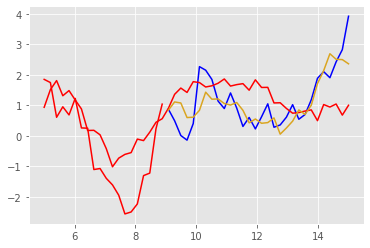

Epoch 174 batch 0 train Loss 0.1114 test Loss 0.1310 with training MSE metric 0.2905 and testing MSE metric 0.3103
learning rate is 0.0003000000142492354


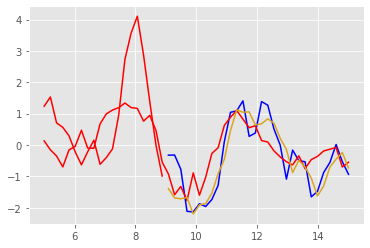

Epoch 174 batch 50 train Loss 0.1362 test Loss 0.1289 with training MSE metric 0.3201 and testing MSE metric 0.3108
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.890219688415527 secs



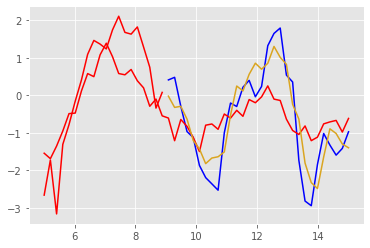

Epoch 175 batch 0 train Loss 0.1050 test Loss 0.1154 with training MSE metric 0.2767 and testing MSE metric 0.2931
learning rate is 0.0003000000142492354


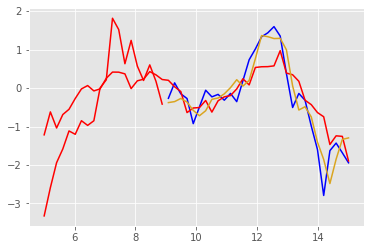

Epoch 175 batch 50 train Loss 0.1253 test Loss 0.1192 with training MSE metric 0.3049 and testing MSE metric 0.2968
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.052436113357544 secs



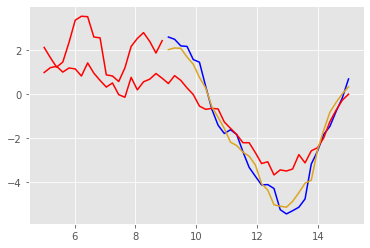

Epoch 176 batch 0 train Loss 0.1317 test Loss 0.1170 with training MSE metric 0.3143 and testing MSE metric 0.2960
learning rate is 0.0003000000142492354


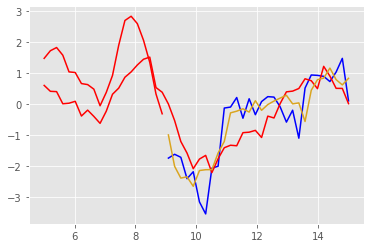

Epoch 176 batch 50 train Loss 0.1269 test Loss 0.1075 with training MSE metric 0.3069 and testing MSE metric 0.2806
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.490554094314575 secs



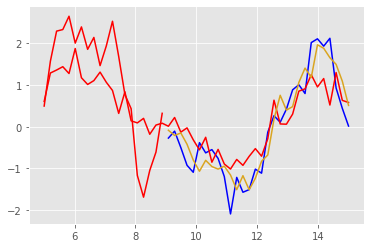

Epoch 177 batch 0 train Loss 0.1139 test Loss 0.1165 with training MSE metric 0.2946 and testing MSE metric 0.2931
learning rate is 0.0003000000142492354


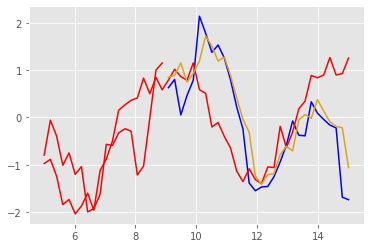

Epoch 177 batch 50 train Loss 0.1449 test Loss 0.1170 with training MSE metric 0.3294 and testing MSE metric 0.2974
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.194938898086548 secs



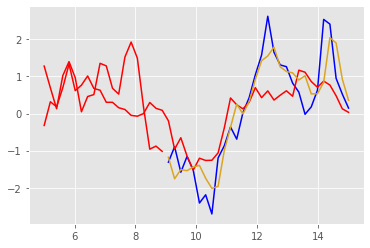

Epoch 178 batch 0 train Loss 0.1363 test Loss 0.1199 with training MSE metric 0.3182 and testing MSE metric 0.2956
learning rate is 0.0003000000142492354


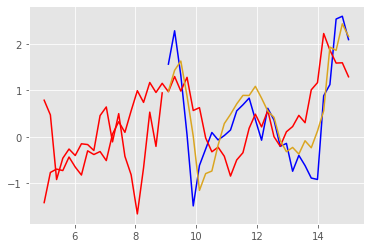

Epoch 178 batch 50 train Loss 0.1243 test Loss 0.1289 with training MSE metric 0.3039 and testing MSE metric 0.3110
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.889164924621582 secs



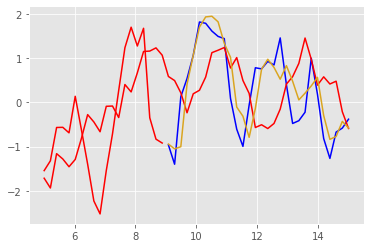

Epoch 179 batch 0 train Loss 0.1118 test Loss 0.0862 with training MSE metric 0.2895 and testing MSE metric 0.2553
learning rate is 0.0003000000142492354


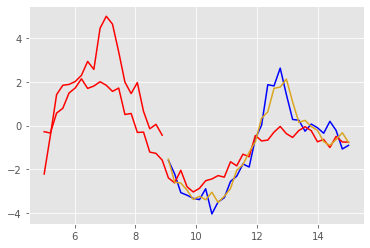

Epoch 179 batch 50 train Loss 0.1134 test Loss 0.1007 with training MSE metric 0.2940 and testing MSE metric 0.2761
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.930273056030273 secs



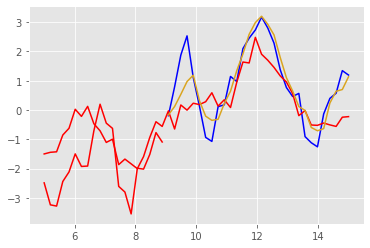

Epoch 180 batch 0 train Loss 0.1304 test Loss 0.1171 with training MSE metric 0.3122 and testing MSE metric 0.2950
learning rate is 0.0003000000142492354


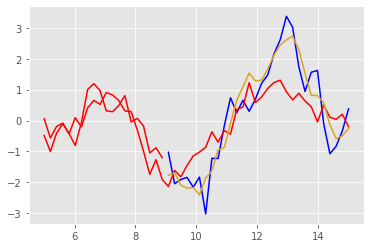

Epoch 180 batch 50 train Loss 0.1301 test Loss 0.1215 with training MSE metric 0.3101 and testing MSE metric 0.3024
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.161622762680054 secs



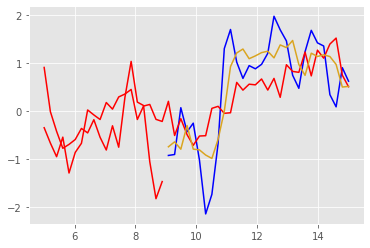

Epoch 181 batch 0 train Loss 0.1317 test Loss 0.1276 with training MSE metric 0.3142 and testing MSE metric 0.3109
learning rate is 0.0003000000142492354


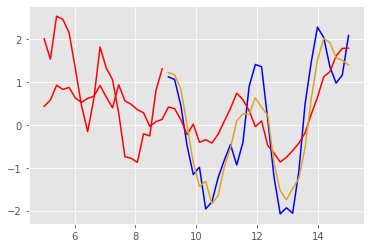

Epoch 181 batch 50 train Loss 0.1317 test Loss 0.1013 with training MSE metric 0.3135 and testing MSE metric 0.2751
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.369492053985596 secs



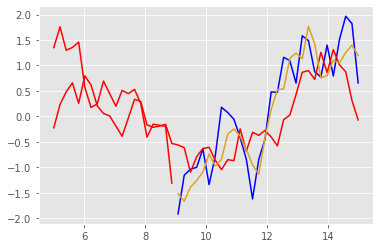

Epoch 182 batch 0 train Loss 0.1106 test Loss 0.1052 with training MSE metric 0.2883 and testing MSE metric 0.2808
learning rate is 0.0003000000142492354


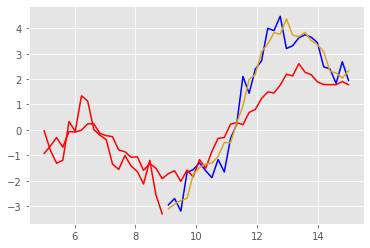

Epoch 182 batch 50 train Loss 0.1394 test Loss 0.0902 with training MSE metric 0.3232 and testing MSE metric 0.2631
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.426001071929932 secs



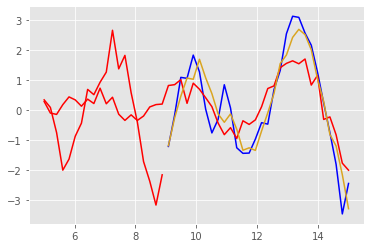

Epoch 183 batch 0 train Loss 0.0884 test Loss 0.1183 with training MSE metric 0.2625 and testing MSE metric 0.2940
learning rate is 0.0003000000142492354


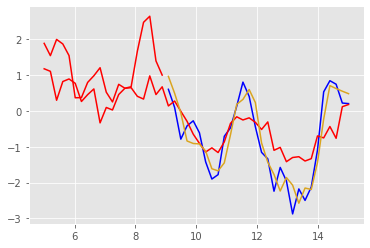

Epoch 183 batch 50 train Loss 0.1140 test Loss 0.1071 with training MSE metric 0.2899 and testing MSE metric 0.2824
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.473823308944702 secs



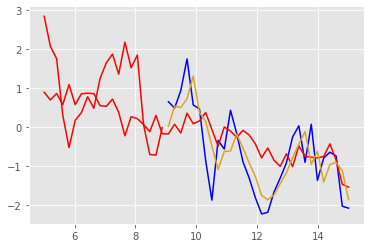

Epoch 184 batch 0 train Loss 0.1083 test Loss 0.1035 with training MSE metric 0.2866 and testing MSE metric 0.2780
learning rate is 0.0003000000142492354


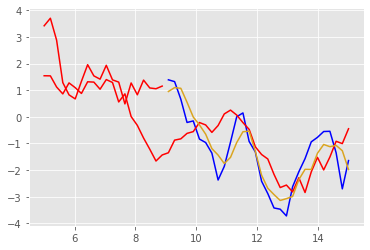

Epoch 184 batch 50 train Loss 0.1119 test Loss 0.1143 with training MSE metric 0.2905 and testing MSE metric 0.2925
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.09358811378479 secs



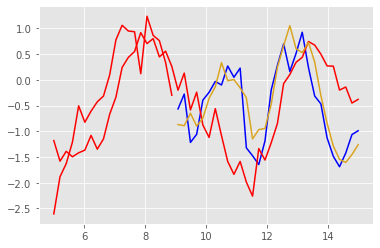

Epoch 185 batch 0 train Loss 0.1479 test Loss 0.1263 with training MSE metric 0.3317 and testing MSE metric 0.3072
learning rate is 0.0003000000142492354


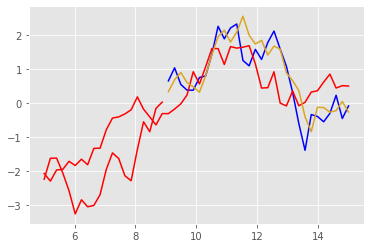

Epoch 185 batch 50 train Loss 0.1256 test Loss 0.1177 with training MSE metric 0.3097 and testing MSE metric 0.2963
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.939801216125488 secs



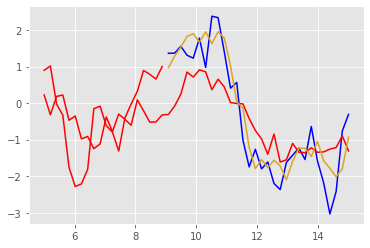

Epoch 186 batch 0 train Loss 0.1200 test Loss 0.1217 with training MSE metric 0.3027 and testing MSE metric 0.2995
learning rate is 0.0003000000142492354


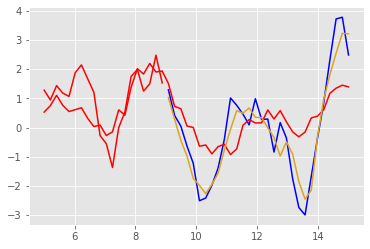

Epoch 186 batch 50 train Loss 0.1028 test Loss 0.1286 with training MSE metric 0.2802 and testing MSE metric 0.3079
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.801204919815063 secs



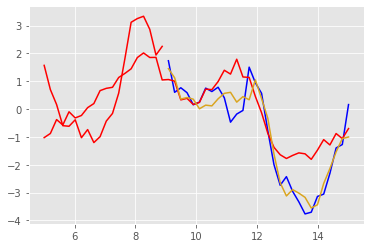

Epoch 187 batch 0 train Loss 0.1242 test Loss 0.1042 with training MSE metric 0.3032 and testing MSE metric 0.2796
learning rate is 0.0003000000142492354


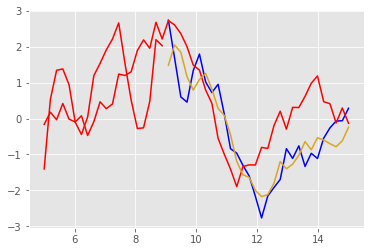

Epoch 187 batch 50 train Loss 0.1292 test Loss 0.1196 with training MSE metric 0.3108 and testing MSE metric 0.2982
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.908824682235718 secs



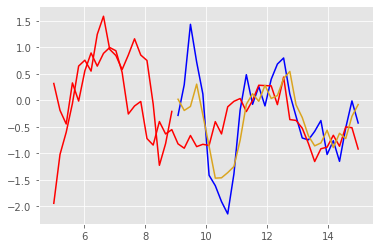

Epoch 188 batch 0 train Loss 0.1125 test Loss 0.1023 with training MSE metric 0.2884 and testing MSE metric 0.2766
learning rate is 0.0003000000142492354


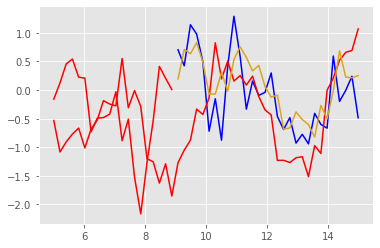

Epoch 188 batch 50 train Loss 0.1019 test Loss 0.1342 with training MSE metric 0.2823 and testing MSE metric 0.3153
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.926658153533936 secs



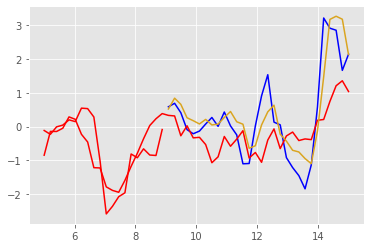

Epoch 189 batch 0 train Loss 0.1127 test Loss 0.1130 with training MSE metric 0.2887 and testing MSE metric 0.2911
learning rate is 0.0003000000142492354


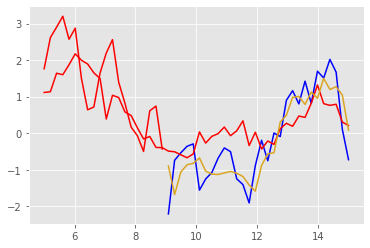

Epoch 189 batch 50 train Loss 0.1096 test Loss 0.1038 with training MSE metric 0.2879 and testing MSE metric 0.2775
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.822809934616089 secs



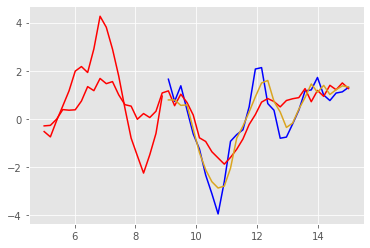

Epoch 190 batch 0 train Loss 0.1197 test Loss 0.1118 with training MSE metric 0.2983 and testing MSE metric 0.2859
learning rate is 0.0003000000142492354


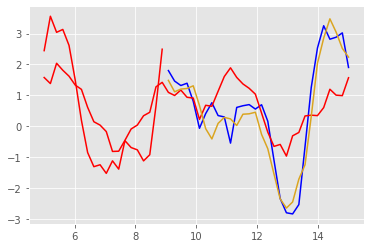

Epoch 190 batch 50 train Loss 0.1142 test Loss 0.1274 with training MSE metric 0.2976 and testing MSE metric 0.3100
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.88525915145874 secs



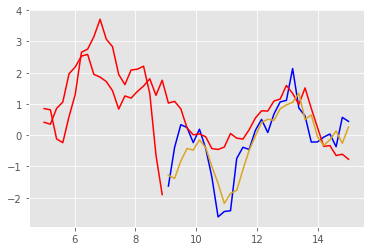

Epoch 191 batch 0 train Loss 0.1384 test Loss 0.1283 with training MSE metric 0.3228 and testing MSE metric 0.3090
learning rate is 0.0003000000142492354


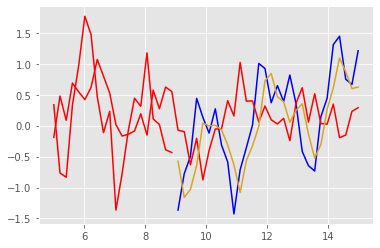

Epoch 191 batch 50 train Loss 0.1442 test Loss 0.1121 with training MSE metric 0.3267 and testing MSE metric 0.2891
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.96347713470459 secs



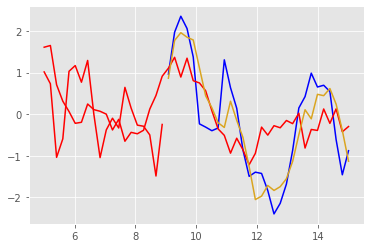

Epoch 192 batch 0 train Loss 0.1408 test Loss 0.1311 with training MSE metric 0.3241 and testing MSE metric 0.3114
learning rate is 0.0003000000142492354


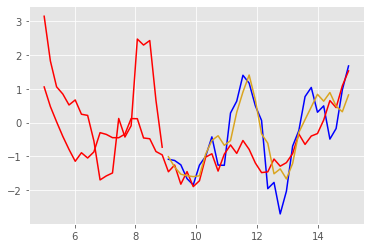

Epoch 192 batch 50 train Loss 0.1073 test Loss 0.0989 with training MSE metric 0.2843 and testing MSE metric 0.2739
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.412960052490234 secs



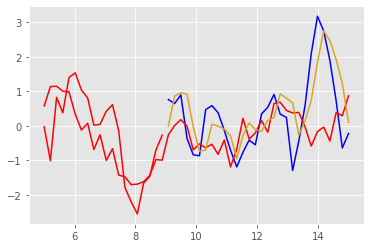

Epoch 193 batch 0 train Loss 0.1218 test Loss 0.1172 with training MSE metric 0.3034 and testing MSE metric 0.2964
learning rate is 0.0003000000142492354


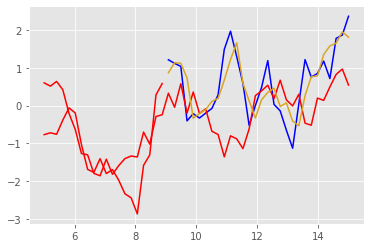

Epoch 193 batch 50 train Loss 0.1320 test Loss 0.1106 with training MSE metric 0.3149 and testing MSE metric 0.2832
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.442861080169678 secs



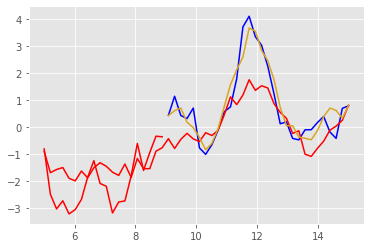

Epoch 194 batch 0 train Loss 0.1170 test Loss 0.1138 with training MSE metric 0.2952 and testing MSE metric 0.2900
learning rate is 0.0003000000142492354


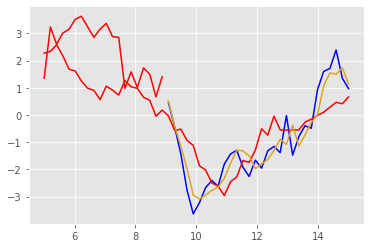

Epoch 194 batch 50 train Loss 0.1187 test Loss 0.1309 with training MSE metric 0.3012 and testing MSE metric 0.3141
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.034296989440918 secs



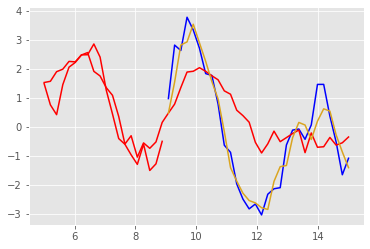

Epoch 195 batch 0 train Loss 0.1224 test Loss 0.1180 with training MSE metric 0.3037 and testing MSE metric 0.2965
learning rate is 0.0003000000142492354


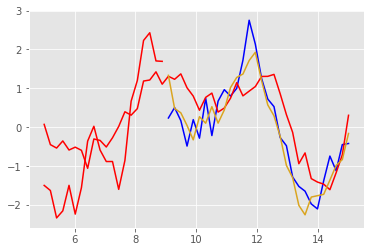

Epoch 195 batch 50 train Loss 0.1225 test Loss 0.1438 with training MSE metric 0.3056 and testing MSE metric 0.3291
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.843226909637451 secs



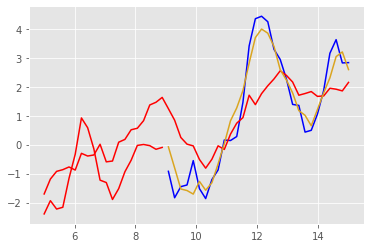

Epoch 196 batch 0 train Loss 0.1315 test Loss 0.1172 with training MSE metric 0.3139 and testing MSE metric 0.2971
learning rate is 0.0003000000142492354


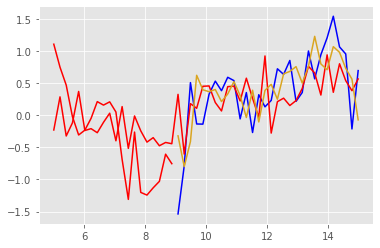

Epoch 196 batch 50 train Loss 0.1359 test Loss 0.0939 with training MSE metric 0.3200 and testing MSE metric 0.2676
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.992310762405396 secs



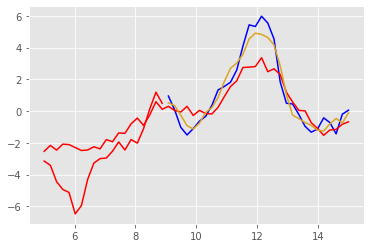

Epoch 197 batch 0 train Loss 0.1250 test Loss 0.1320 with training MSE metric 0.3036 and testing MSE metric 0.3159
learning rate is 0.0003000000142492354


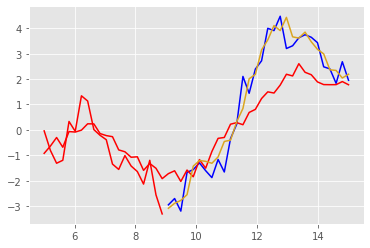

Epoch 197 batch 50 train Loss 0.1362 test Loss 0.1004 with training MSE metric 0.3192 and testing MSE metric 0.2743
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.75979495048523 secs



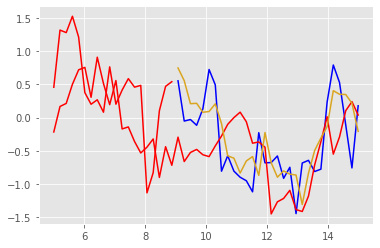

Epoch 198 batch 0 train Loss 0.1312 test Loss 0.1225 with training MSE metric 0.3142 and testing MSE metric 0.3023
learning rate is 0.0003000000142492354


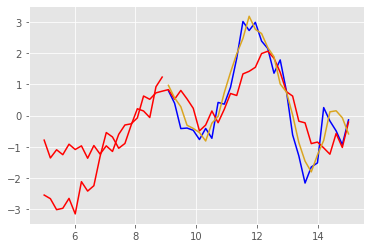

Epoch 198 batch 50 train Loss 0.1283 test Loss 0.1185 with training MSE metric 0.3085 and testing MSE metric 0.2969
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.707845687866211 secs



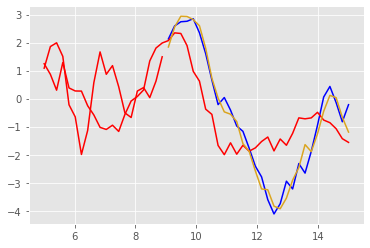

Epoch 199 batch 0 train Loss 0.1161 test Loss 0.1202 with training MSE metric 0.2942 and testing MSE metric 0.2986
learning rate is 0.0003000000142492354


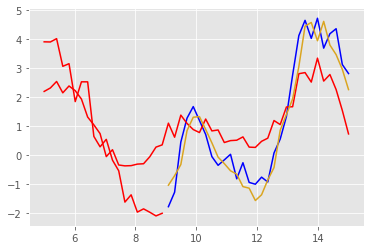

Epoch 199 batch 50 train Loss 0.1401 test Loss 0.1277 with training MSE metric 0.3238 and testing MSE metric 0.3084
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.915328025817871 secs



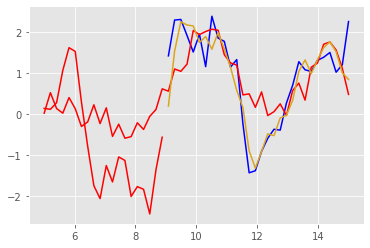

Epoch 200 batch 0 train Loss 0.1271 test Loss 0.1040 with training MSE metric 0.3099 and testing MSE metric 0.2804
learning rate is 0.0003000000142492354


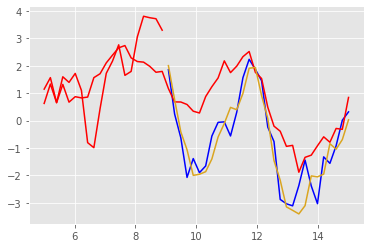

Epoch 200 batch 50 train Loss 0.1051 test Loss 0.1225 with training MSE metric 0.2830 and testing MSE metric 0.3016
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.369770050048828 secs



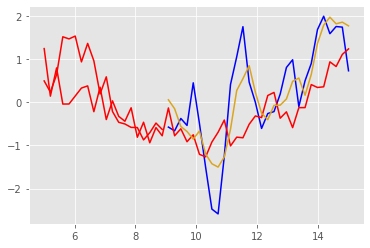

Epoch 201 batch 0 train Loss 0.1260 test Loss 0.1193 with training MSE metric 0.3068 and testing MSE metric 0.2995
learning rate is 0.0003000000142492354


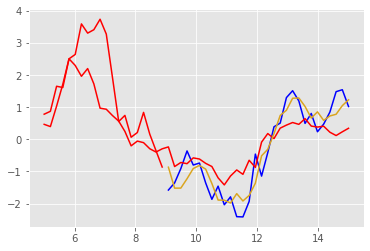

Epoch 201 batch 50 train Loss 0.1121 test Loss 0.1107 with training MSE metric 0.2915 and testing MSE metric 0.2857
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.420835018157959 secs



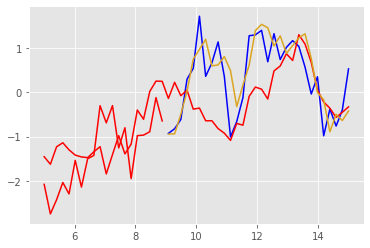

Epoch 202 batch 0 train Loss 0.1368 test Loss 0.1014 with training MSE metric 0.3205 and testing MSE metric 0.2746
learning rate is 0.0003000000142492354


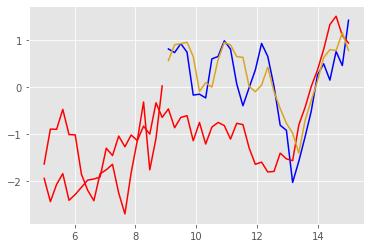

Epoch 202 batch 50 train Loss 0.1325 test Loss 0.1093 with training MSE metric 0.3142 and testing MSE metric 0.2838
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.679973125457764 secs



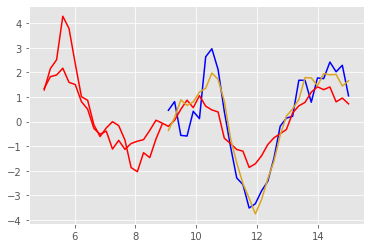

Epoch 203 batch 0 train Loss 0.1219 test Loss 0.1088 with training MSE metric 0.3020 and testing MSE metric 0.2865
learning rate is 0.0003000000142492354


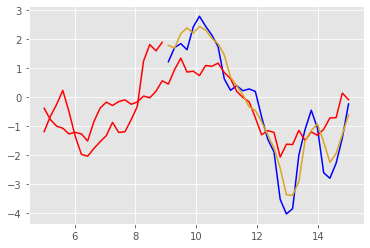

Epoch 203 batch 50 train Loss 0.1260 test Loss 0.1065 with training MSE metric 0.3072 and testing MSE metric 0.2806
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.826717853546143 secs



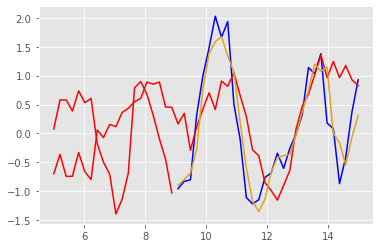

Epoch 204 batch 0 train Loss 0.1578 test Loss 0.1043 with training MSE metric 0.3464 and testing MSE metric 0.2783
learning rate is 0.0003000000142492354


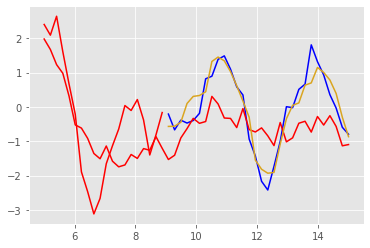

Epoch 204 batch 50 train Loss 0.1133 test Loss 0.1338 with training MSE metric 0.2942 and testing MSE metric 0.3165
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.853251695632935 secs



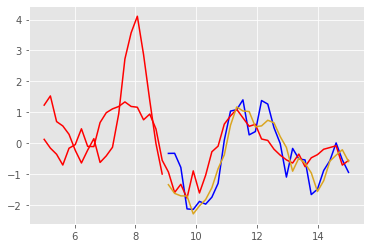

Epoch 205 batch 0 train Loss 0.1271 test Loss 0.1380 with training MSE metric 0.3077 and testing MSE metric 0.3208
learning rate is 0.0003000000142492354


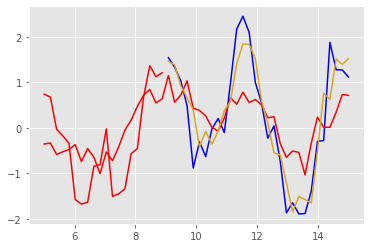

Epoch 205 batch 50 train Loss 0.1146 test Loss 0.1184 with training MSE metric 0.2963 and testing MSE metric 0.2954
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.888976097106934 secs



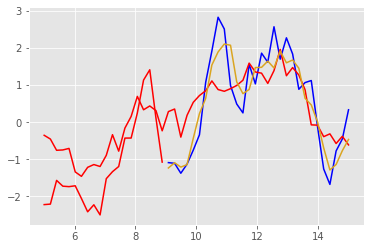

Epoch 206 batch 0 train Loss 0.1447 test Loss 0.0981 with training MSE metric 0.3282 and testing MSE metric 0.2748
learning rate is 0.0003000000142492354


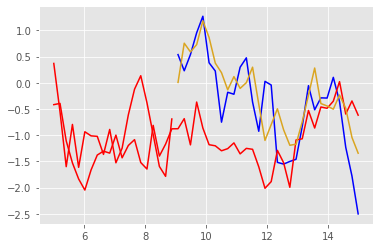

Epoch 206 batch 50 train Loss 0.1310 test Loss 0.1086 with training MSE metric 0.3159 and testing MSE metric 0.2850
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.851250886917114 secs



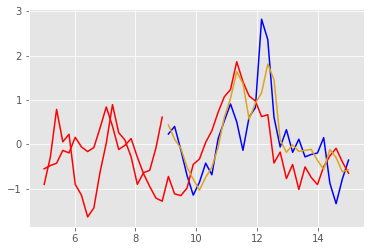

Epoch 207 batch 0 train Loss 0.1346 test Loss 0.1209 with training MSE metric 0.3166 and testing MSE metric 0.3007
learning rate is 0.0003000000142492354


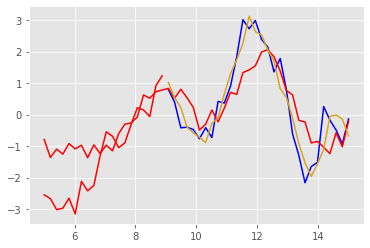

Epoch 207 batch 50 train Loss 0.1356 test Loss 0.1186 with training MSE metric 0.3197 and testing MSE metric 0.2953
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.901957750320435 secs



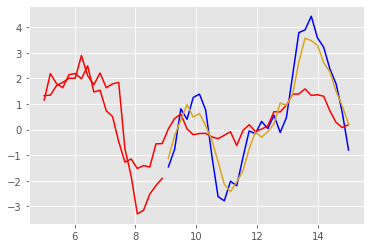

Epoch 208 batch 0 train Loss 0.1279 test Loss 0.1084 with training MSE metric 0.3101 and testing MSE metric 0.2874
learning rate is 0.0003000000142492354


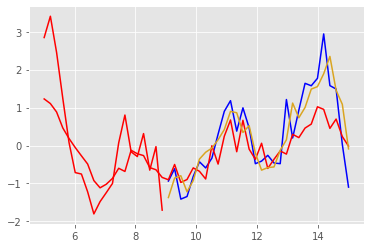

Epoch 208 batch 50 train Loss 0.1181 test Loss 0.1215 with training MSE metric 0.2977 and testing MSE metric 0.3053
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.872724056243896 secs



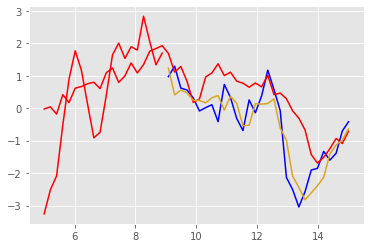

Epoch 209 batch 0 train Loss 0.1407 test Loss 0.1043 with training MSE metric 0.3273 and testing MSE metric 0.2799
learning rate is 0.0003000000142492354


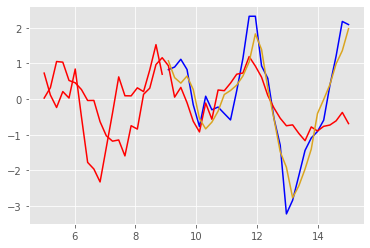

Epoch 209 batch 50 train Loss 0.1067 test Loss 0.1075 with training MSE metric 0.2850 and testing MSE metric 0.2824
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.86280107498169 secs



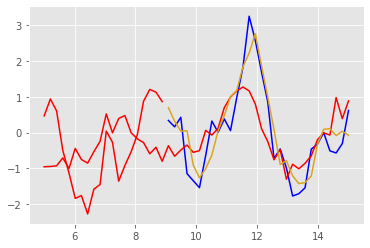

Epoch 210 batch 0 train Loss 0.1640 test Loss 0.0816 with training MSE metric 0.3500 and testing MSE metric 0.2557
learning rate is 0.0003000000142492354


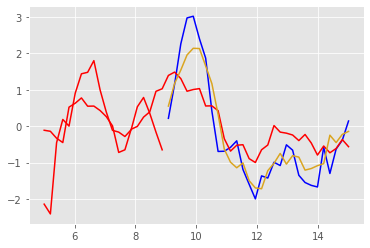

Epoch 210 batch 50 train Loss 0.1233 test Loss 0.0963 with training MSE metric 0.3034 and testing MSE metric 0.2684
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.10022783279419 secs



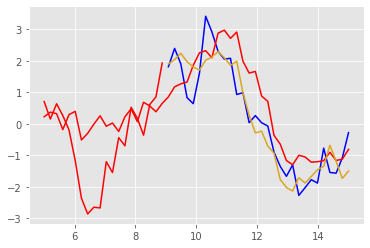

Epoch 211 batch 0 train Loss 0.1288 test Loss 0.1204 with training MSE metric 0.3122 and testing MSE metric 0.3048
learning rate is 0.0003000000142492354


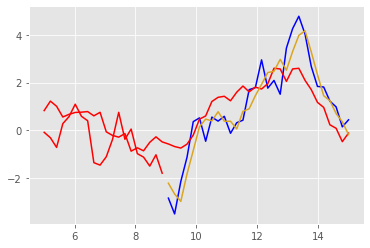

Epoch 211 batch 50 train Loss 0.1242 test Loss 0.1360 with training MSE metric 0.3043 and testing MSE metric 0.3161
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.866544246673584 secs



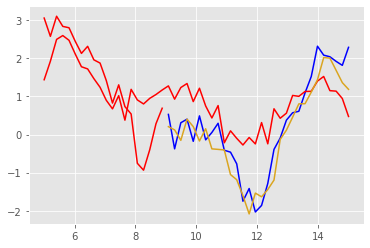

Epoch 212 batch 0 train Loss 0.1468 test Loss 0.1297 with training MSE metric 0.3336 and testing MSE metric 0.3093
learning rate is 0.0003000000142492354


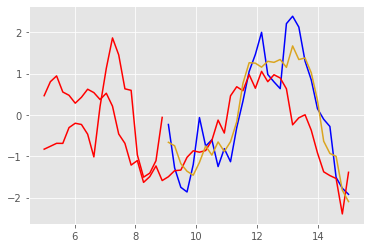

Epoch 212 batch 50 train Loss 0.1277 test Loss 0.0969 with training MSE metric 0.3140 and testing MSE metric 0.2717
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.374465942382812 secs



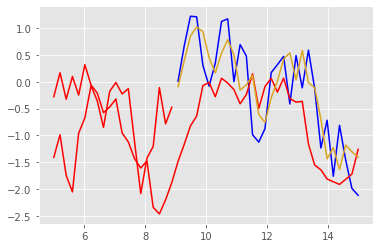

Epoch 213 batch 0 train Loss 0.1099 test Loss 0.1044 with training MSE metric 0.2880 and testing MSE metric 0.2814
learning rate is 0.0003000000142492354


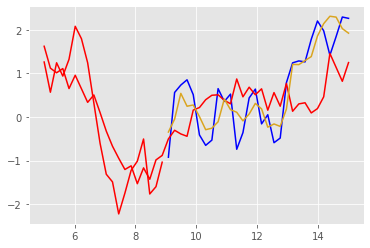

Epoch 213 batch 50 train Loss 0.1152 test Loss 0.1132 with training MSE metric 0.2915 and testing MSE metric 0.2903
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.606882095336914 secs



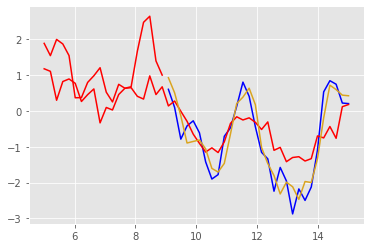

Epoch 214 batch 0 train Loss 0.1108 test Loss 0.1136 with training MSE metric 0.2902 and testing MSE metric 0.2915
learning rate is 0.0003000000142492354


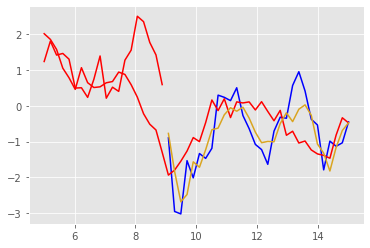

Epoch 214 batch 50 train Loss 0.1568 test Loss 0.1207 with training MSE metric 0.3439 and testing MSE metric 0.3001
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.398158073425293 secs



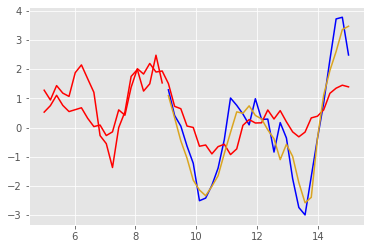

Epoch 215 batch 0 train Loss 0.1249 test Loss 0.1194 with training MSE metric 0.3073 and testing MSE metric 0.3014
learning rate is 0.0003000000142492354


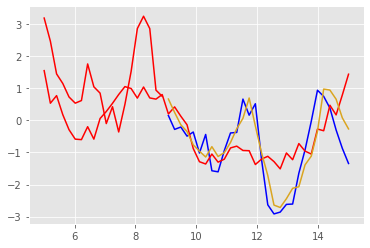

Epoch 215 batch 50 train Loss 0.1246 test Loss 0.0992 with training MSE metric 0.3032 and testing MSE metric 0.2756
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.593907833099365 secs



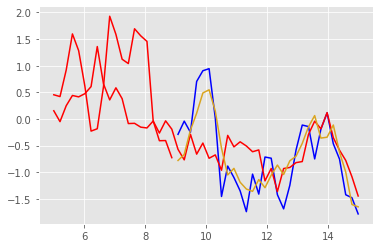

Epoch 216 batch 0 train Loss 0.1270 test Loss 0.1181 with training MSE metric 0.3087 and testing MSE metric 0.2946
learning rate is 0.0003000000142492354


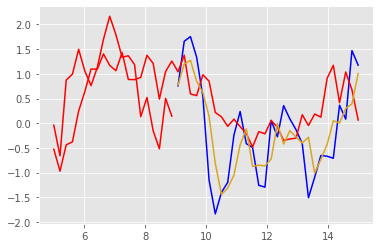

Epoch 216 batch 50 train Loss 0.1181 test Loss 0.0878 with training MSE metric 0.2990 and testing MSE metric 0.2576
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.906167030334473 secs



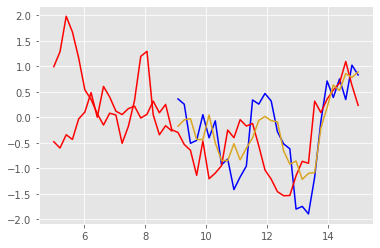

Epoch 217 batch 0 train Loss 0.1251 test Loss 0.0950 with training MSE metric 0.3047 and testing MSE metric 0.2691
learning rate is 0.0003000000142492354


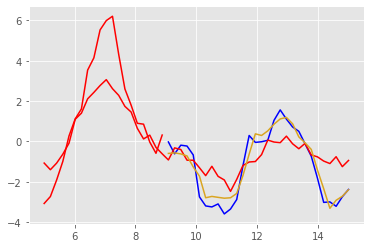

Epoch 217 batch 50 train Loss 0.1125 test Loss 0.0956 with training MSE metric 0.2909 and testing MSE metric 0.2702
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.238673210144043 secs



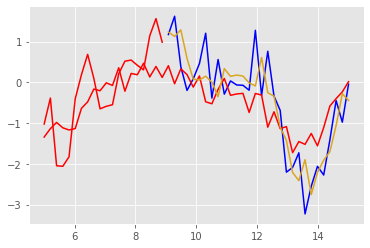

Epoch 218 batch 0 train Loss 0.1446 test Loss 0.1235 with training MSE metric 0.3285 and testing MSE metric 0.3048
learning rate is 0.0003000000142492354


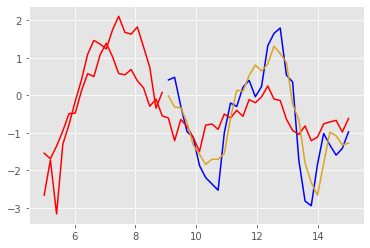

Epoch 218 batch 50 train Loss 0.1287 test Loss 0.1067 with training MSE metric 0.3077 and testing MSE metric 0.2823
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.064852952957153 secs



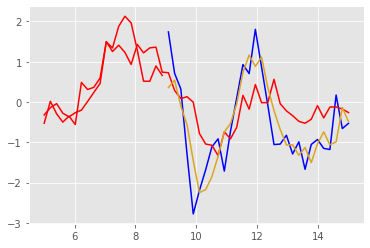

Epoch 219 batch 0 train Loss 0.1131 test Loss 0.0886 with training MSE metric 0.2939 and testing MSE metric 0.2640
learning rate is 0.0003000000142492354


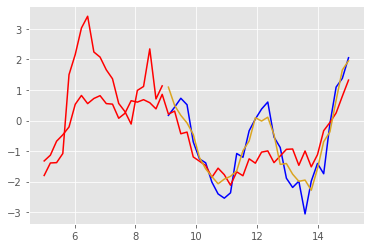

Epoch 219 batch 50 train Loss 0.1401 test Loss 0.1157 with training MSE metric 0.3268 and testing MSE metric 0.2922
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.855309009552002 secs



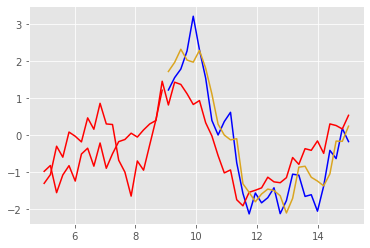

Epoch 220 batch 0 train Loss 0.1047 test Loss 0.1058 with training MSE metric 0.2812 and testing MSE metric 0.2822
learning rate is 0.0003000000142492354


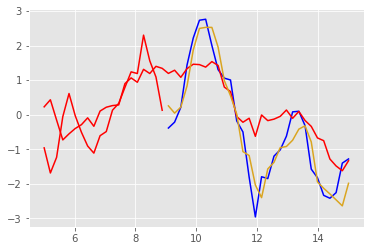

Epoch 220 batch 50 train Loss 0.1107 test Loss 0.1175 with training MSE metric 0.2901 and testing MSE metric 0.2973
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.28068733215332 secs



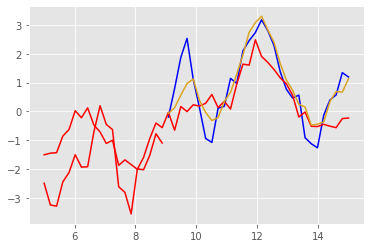

Epoch 221 batch 0 train Loss 0.1422 test Loss 0.1325 with training MSE metric 0.3260 and testing MSE metric 0.3118
learning rate is 0.0003000000142492354


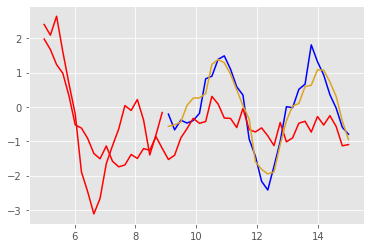

Epoch 221 batch 50 train Loss 0.1160 test Loss 0.1228 with training MSE metric 0.2952 and testing MSE metric 0.3055
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.21402907371521 secs



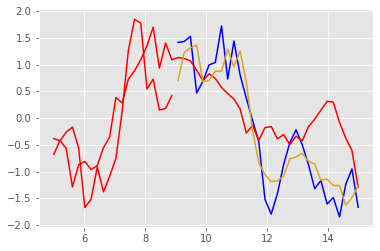

Epoch 222 batch 0 train Loss 0.1265 test Loss 0.1183 with training MSE metric 0.3075 and testing MSE metric 0.2952
learning rate is 0.0003000000142492354


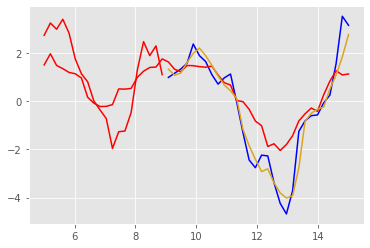

Epoch 222 batch 50 train Loss 0.1049 test Loss 0.1400 with training MSE metric 0.2834 and testing MSE metric 0.3207
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.263383865356445 secs



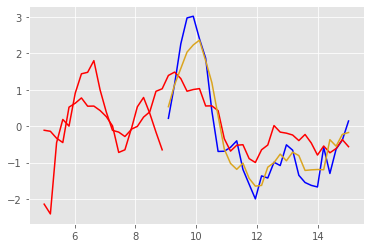

Epoch 223 batch 0 train Loss 0.1230 test Loss 0.1226 with training MSE metric 0.3006 and testing MSE metric 0.3020
learning rate is 0.0003000000142492354


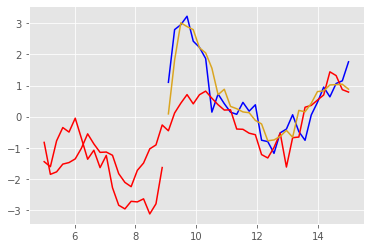

Epoch 223 batch 50 train Loss 0.1137 test Loss 0.1026 with training MSE metric 0.2900 and testing MSE metric 0.2789
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.262075901031494 secs



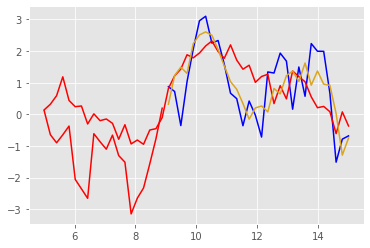

Epoch 224 batch 0 train Loss 0.1318 test Loss 0.1395 with training MSE metric 0.3116 and testing MSE metric 0.3202
learning rate is 0.0003000000142492354


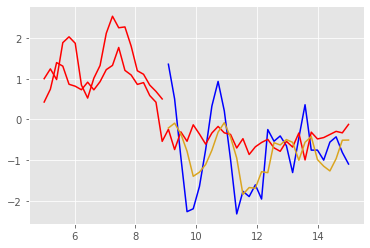

Epoch 224 batch 50 train Loss 0.0959 test Loss 0.1142 with training MSE metric 0.2704 and testing MSE metric 0.2901
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.288769006729126 secs



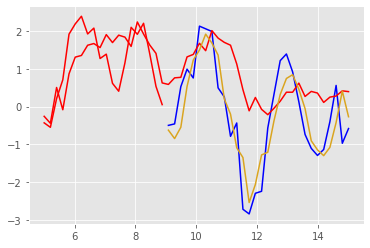

Epoch 225 batch 0 train Loss 0.0988 test Loss 0.1024 with training MSE metric 0.2764 and testing MSE metric 0.2762
learning rate is 0.0003000000142492354


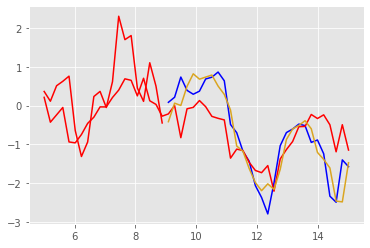

Epoch 225 batch 50 train Loss 0.1059 test Loss 0.1214 with training MSE metric 0.2853 and testing MSE metric 0.3003
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.331845998764038 secs



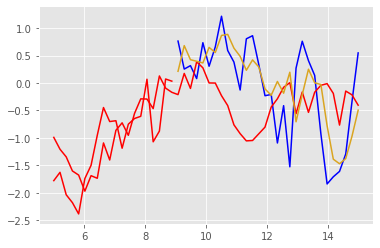

Epoch 226 batch 0 train Loss 0.1136 test Loss 0.1272 with training MSE metric 0.2939 and testing MSE metric 0.3074
learning rate is 0.0003000000142492354


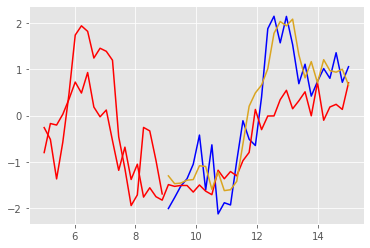

Epoch 226 batch 50 train Loss 0.1243 test Loss 0.1161 with training MSE metric 0.3052 and testing MSE metric 0.2924
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.312235116958618 secs



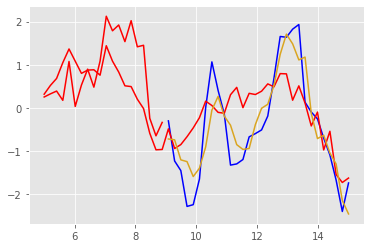

Epoch 227 batch 0 train Loss 0.1014 test Loss 0.1263 with training MSE metric 0.2787 and testing MSE metric 0.3061
learning rate is 0.0003000000142492354


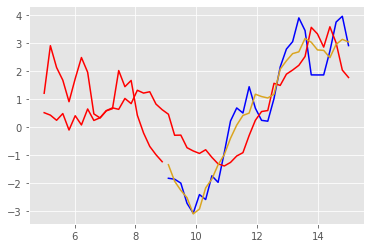

Epoch 227 batch 50 train Loss 0.0957 test Loss 0.1280 with training MSE metric 0.2700 and testing MSE metric 0.3073
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.573862075805664 secs



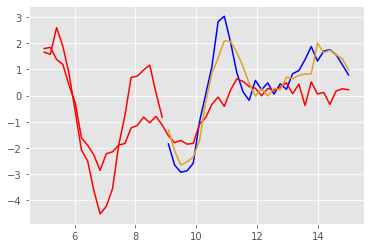

Epoch 228 batch 0 train Loss 0.0991 test Loss 0.1276 with training MSE metric 0.2773 and testing MSE metric 0.3127
learning rate is 0.0003000000142492354


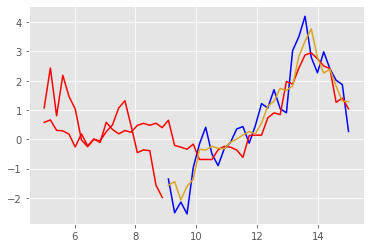

Epoch 228 batch 50 train Loss 0.1101 test Loss 0.1212 with training MSE metric 0.2870 and testing MSE metric 0.2990
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.334191083908081 secs



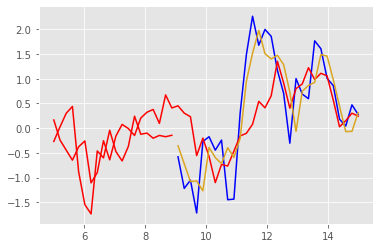

Epoch 229 batch 0 train Loss 0.1216 test Loss 0.0974 with training MSE metric 0.3049 and testing MSE metric 0.2733
learning rate is 0.0003000000142492354


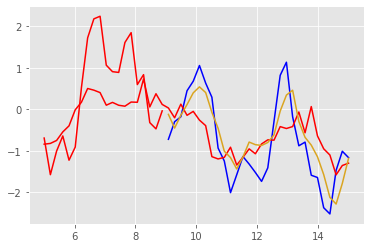

Epoch 229 batch 50 train Loss 0.1151 test Loss 0.1368 with training MSE metric 0.2921 and testing MSE metric 0.3176
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.345194101333618 secs



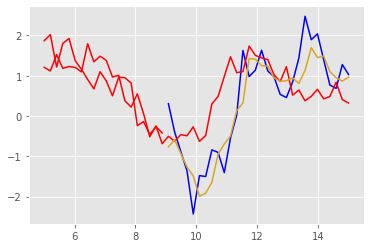

Epoch 230 batch 0 train Loss 0.1557 test Loss 0.0980 with training MSE metric 0.3440 and testing MSE metric 0.2709
learning rate is 0.0003000000142492354


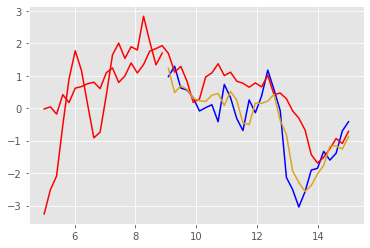

Epoch 230 batch 50 train Loss 0.1238 test Loss 0.1101 with training MSE metric 0.3081 and testing MSE metric 0.2869
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.241172075271606 secs



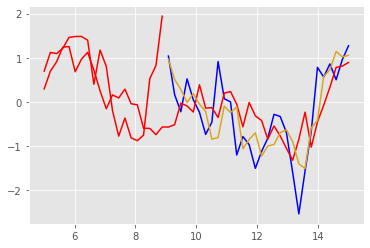

Epoch 231 batch 0 train Loss 0.1086 test Loss 0.1127 with training MSE metric 0.2873 and testing MSE metric 0.2900
learning rate is 0.0003000000142492354


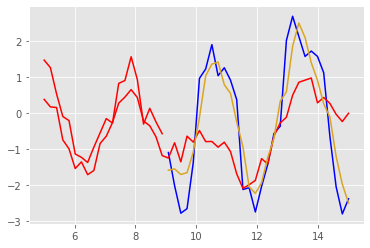

Epoch 231 batch 50 train Loss 0.1020 test Loss 0.0964 with training MSE metric 0.2754 and testing MSE metric 0.2725
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.277364015579224 secs



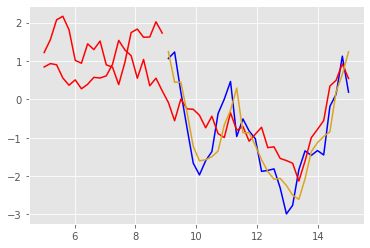

Epoch 232 batch 0 train Loss 0.1150 test Loss 0.1214 with training MSE metric 0.2957 and testing MSE metric 0.2992
learning rate is 0.0003000000142492354


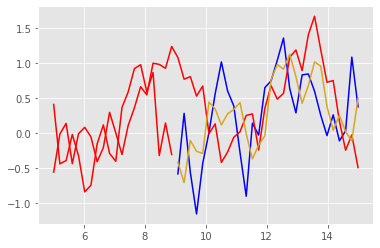

Epoch 232 batch 50 train Loss 0.1010 test Loss 0.1090 with training MSE metric 0.2797 and testing MSE metric 0.2847
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.331615924835205 secs



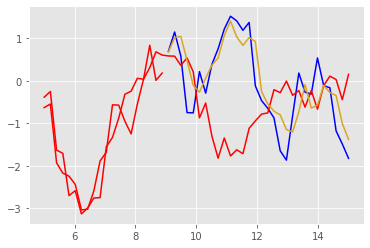

Epoch 233 batch 0 train Loss 0.1063 test Loss 0.1191 with training MSE metric 0.2831 and testing MSE metric 0.3021
learning rate is 0.0003000000142492354


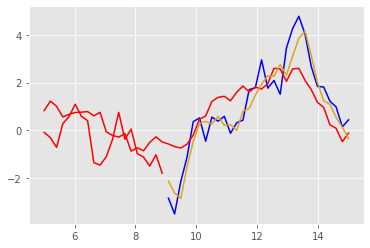

Epoch 233 batch 50 train Loss 0.0912 test Loss 0.1128 with training MSE metric 0.2641 and testing MSE metric 0.2895
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.31056022644043 secs



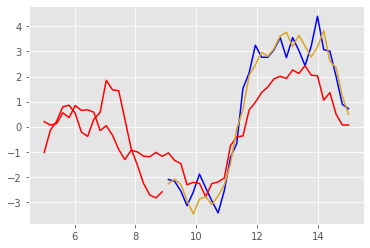

Epoch 234 batch 0 train Loss 0.1140 test Loss 0.1158 with training MSE metric 0.2924 and testing MSE metric 0.2923
learning rate is 0.0003000000142492354


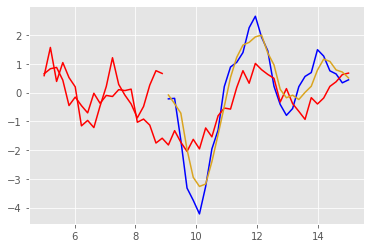

Epoch 234 batch 50 train Loss 0.1104 test Loss 0.0938 with training MSE metric 0.2891 and testing MSE metric 0.2669
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.356748104095459 secs



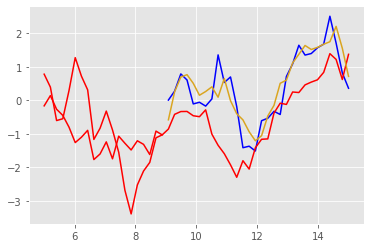

Epoch 235 batch 0 train Loss 0.1344 test Loss 0.1176 with training MSE metric 0.3158 and testing MSE metric 0.2956
learning rate is 0.0003000000142492354


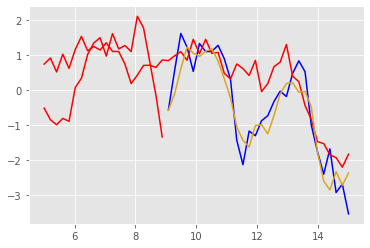

Epoch 235 batch 50 train Loss 0.1474 test Loss 0.1181 with training MSE metric 0.3362 and testing MSE metric 0.2990
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.307184934616089 secs



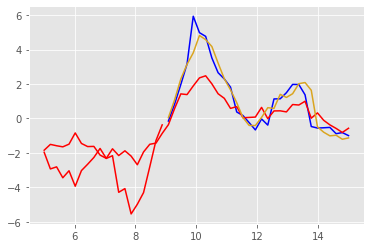

Epoch 236 batch 0 train Loss 0.1319 test Loss 0.1471 with training MSE metric 0.3141 and testing MSE metric 0.3309
learning rate is 0.0003000000142492354


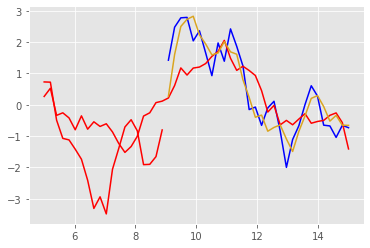

Epoch 236 batch 50 train Loss 0.1460 test Loss 0.0989 with training MSE metric 0.3328 and testing MSE metric 0.2736
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.347003936767578 secs



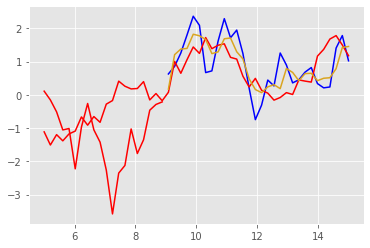

Epoch 237 batch 0 train Loss 0.1080 test Loss 0.1155 with training MSE metric 0.2836 and testing MSE metric 0.2918
learning rate is 0.0003000000142492354


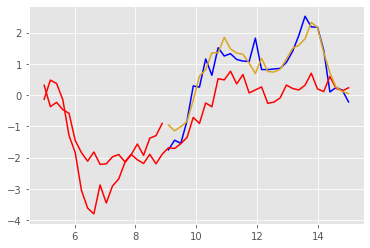

Epoch 237 batch 50 train Loss 0.1316 test Loss 0.1055 with training MSE metric 0.3122 and testing MSE metric 0.2805
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.777729034423828 secs



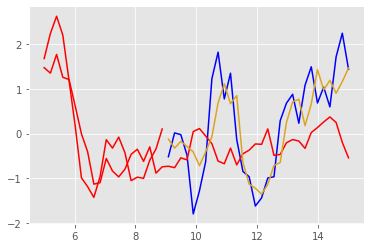

Epoch 238 batch 0 train Loss 0.1182 test Loss 0.0805 with training MSE metric 0.2971 and testing MSE metric 0.2522
learning rate is 0.0003000000142492354


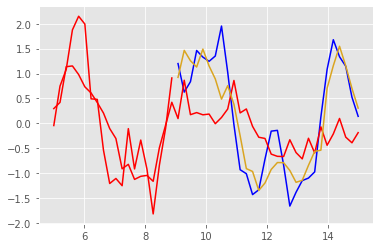

Epoch 238 batch 50 train Loss 0.1149 test Loss 0.1199 with training MSE metric 0.2931 and testing MSE metric 0.2980
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.776087045669556 secs



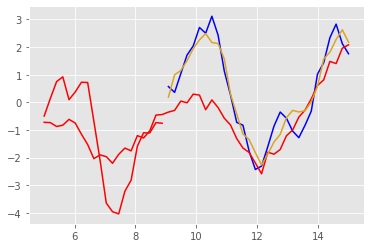

Epoch 239 batch 0 train Loss 0.1365 test Loss 0.0893 with training MSE metric 0.3172 and testing MSE metric 0.2645
learning rate is 0.0003000000142492354


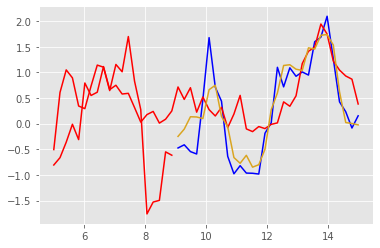

Epoch 239 batch 50 train Loss 0.1281 test Loss 0.0910 with training MSE metric 0.3082 and testing MSE metric 0.2637
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.437270164489746 secs



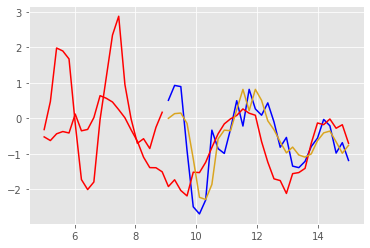

Epoch 240 batch 0 train Loss 0.1316 test Loss 0.1202 with training MSE metric 0.3151 and testing MSE metric 0.3002
learning rate is 0.0003000000142492354


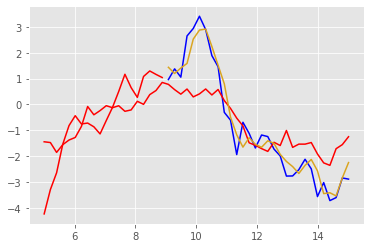

Epoch 240 batch 50 train Loss 0.1170 test Loss 0.1367 with training MSE metric 0.2942 and testing MSE metric 0.3182
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.31927227973938 secs



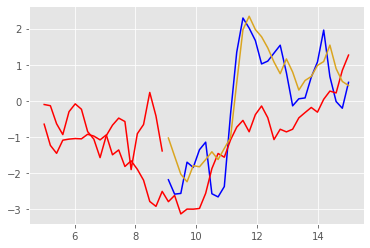

Epoch 241 batch 0 train Loss 0.0799 test Loss 0.1077 with training MSE metric 0.2518 and testing MSE metric 0.2872
learning rate is 0.0003000000142492354


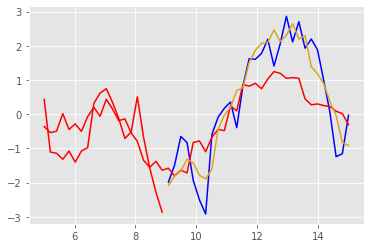

Epoch 241 batch 50 train Loss 0.1263 test Loss 0.1025 with training MSE metric 0.3042 and testing MSE metric 0.2759
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.320632219314575 secs



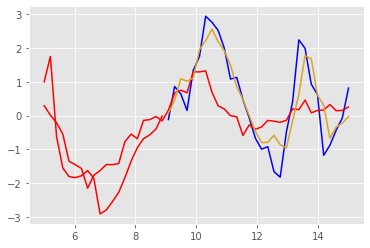

Epoch 242 batch 0 train Loss 0.1214 test Loss 0.1263 with training MSE metric 0.3017 and testing MSE metric 0.3079
learning rate is 0.0003000000142492354


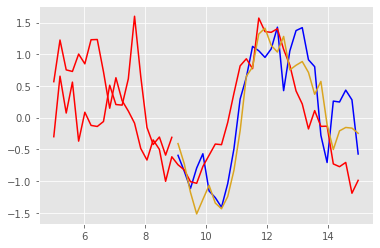

Epoch 242 batch 50 train Loss 0.1256 test Loss 0.0906 with training MSE metric 0.3049 and testing MSE metric 0.2641
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.381540060043335 secs



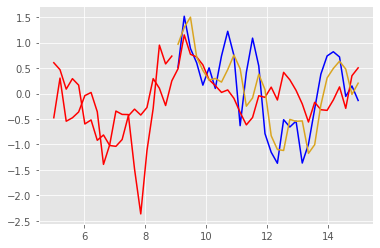

Epoch 243 batch 0 train Loss 0.1097 test Loss 0.1169 with training MSE metric 0.2888 and testing MSE metric 0.2927
learning rate is 0.0003000000142492354


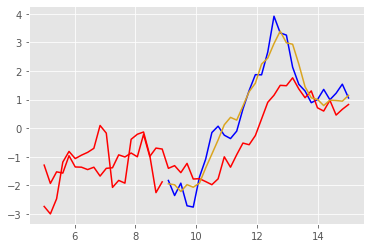

Epoch 243 batch 50 train Loss 0.1367 test Loss 0.1048 with training MSE metric 0.3201 and testing MSE metric 0.2817
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.398339748382568 secs



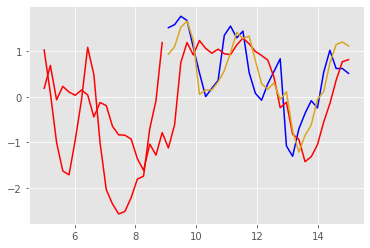

Epoch 244 batch 0 train Loss 0.1127 test Loss 0.1027 with training MSE metric 0.2928 and testing MSE metric 0.2805
learning rate is 0.0003000000142492354


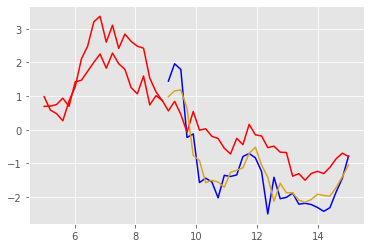

Epoch 244 batch 50 train Loss 0.1167 test Loss 0.1187 with training MSE metric 0.2954 and testing MSE metric 0.3003
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.279926061630249 secs



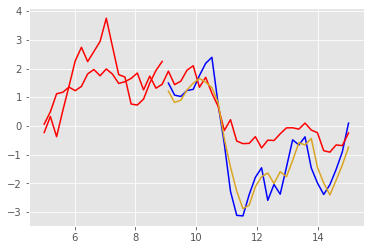

Epoch 245 batch 0 train Loss 0.1010 test Loss 0.1255 with training MSE metric 0.2792 and testing MSE metric 0.3066
learning rate is 0.0003000000142492354


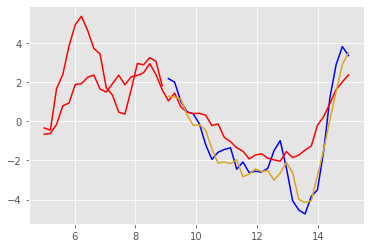

Epoch 245 batch 50 train Loss 0.1204 test Loss 0.1136 with training MSE metric 0.2997 and testing MSE metric 0.2923
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.955569982528687 secs



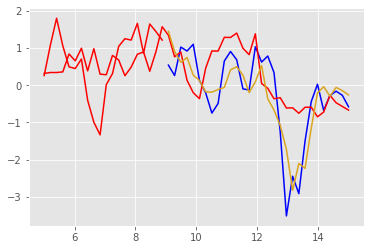

Epoch 246 batch 0 train Loss 0.1121 test Loss 0.1285 with training MSE metric 0.2897 and testing MSE metric 0.3089
learning rate is 0.0003000000142492354


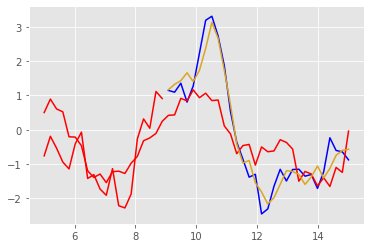

Epoch 246 batch 50 train Loss 0.1188 test Loss 0.1059 with training MSE metric 0.2952 and testing MSE metric 0.2860
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.164291143417358 secs



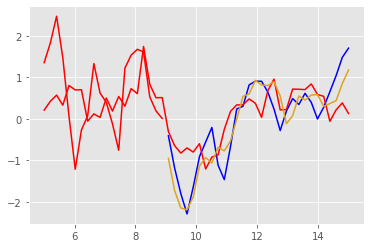

Epoch 247 batch 0 train Loss 0.1065 test Loss 0.0882 with training MSE metric 0.2836 and testing MSE metric 0.2597
learning rate is 0.0003000000142492354


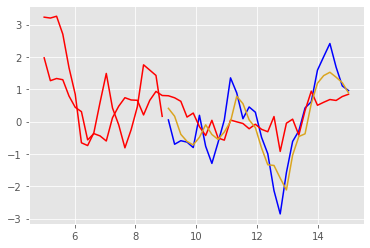

Epoch 247 batch 50 train Loss 0.1384 test Loss 0.1102 with training MSE metric 0.3228 and testing MSE metric 0.2880
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.331339120864868 secs



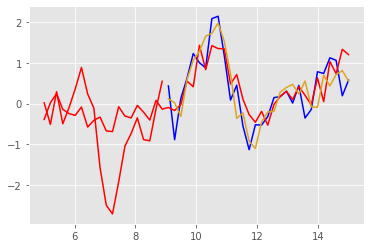

Epoch 248 batch 0 train Loss 0.1318 test Loss 0.1079 with training MSE metric 0.3144 and testing MSE metric 0.2844
learning rate is 0.0003000000142492354


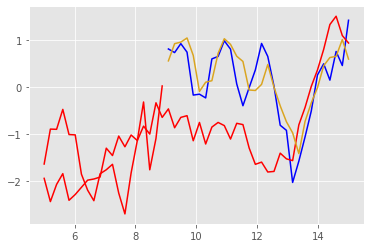

Epoch 248 batch 50 train Loss 0.1261 test Loss 0.1175 with training MSE metric 0.3066 and testing MSE metric 0.2941
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.312688112258911 secs



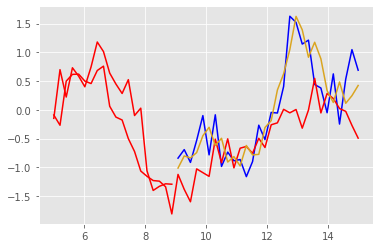

Epoch 249 batch 0 train Loss 0.1200 test Loss 0.1106 with training MSE metric 0.2988 and testing MSE metric 0.2886
learning rate is 0.0003000000142492354


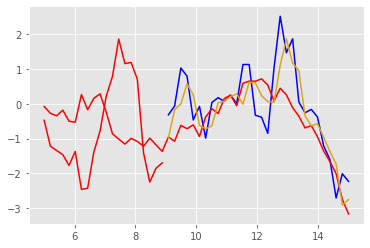

Epoch 249 batch 50 train Loss 0.1085 test Loss 0.1014 with training MSE metric 0.2885 and testing MSE metric 0.2764
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.314939975738525 secs



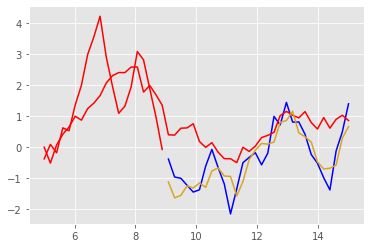

Epoch 250 batch 0 train Loss 0.1136 test Loss 0.1216 with training MSE metric 0.2928 and testing MSE metric 0.3018
learning rate is 0.0003000000142492354


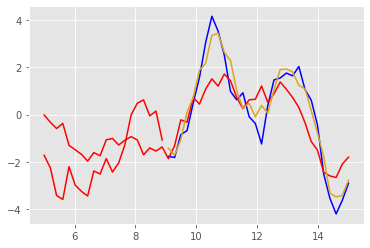

Epoch 250 batch 50 train Loss 0.1184 test Loss 0.1114 with training MSE metric 0.3027 and testing MSE metric 0.2868
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.29363203048706 secs



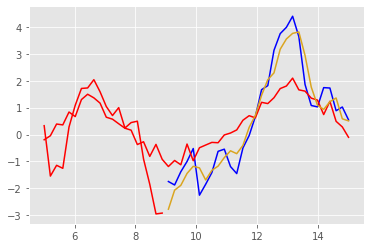

Epoch 251 batch 0 train Loss 0.1282 test Loss 0.1150 with training MSE metric 0.3120 and testing MSE metric 0.2933
learning rate is 0.0003000000142492354


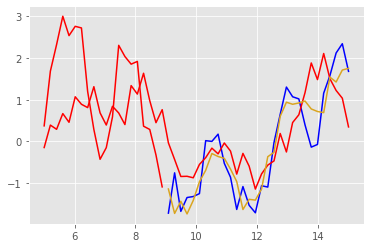

Epoch 251 batch 50 train Loss 0.0992 test Loss 0.1137 with training MSE metric 0.2786 and testing MSE metric 0.2938
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.261615991592407 secs



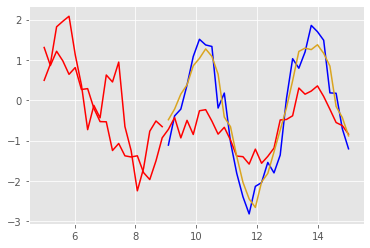

Epoch 252 batch 0 train Loss 0.1072 test Loss 0.1142 with training MSE metric 0.2851 and testing MSE metric 0.2931
learning rate is 0.0003000000142492354


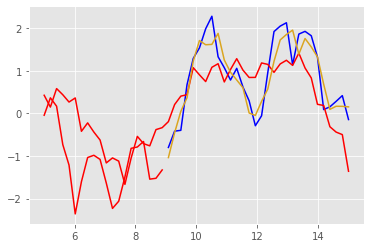

Epoch 252 batch 50 train Loss 0.1103 test Loss 0.1150 with training MSE metric 0.2882 and testing MSE metric 0.2954
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.364307880401611 secs



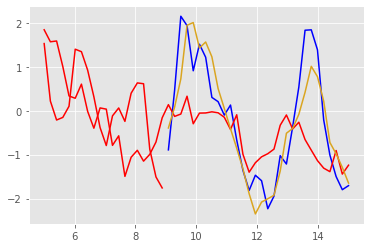

Epoch 253 batch 0 train Loss 0.1336 test Loss 0.1008 with training MSE metric 0.3176 and testing MSE metric 0.2737
learning rate is 0.0003000000142492354


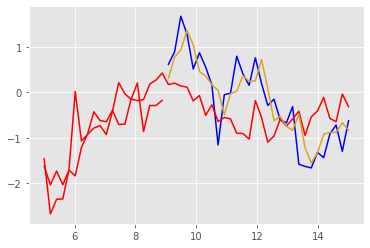

Epoch 253 batch 50 train Loss 0.1166 test Loss 0.1285 with training MSE metric 0.2977 and testing MSE metric 0.3124
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.349743843078613 secs



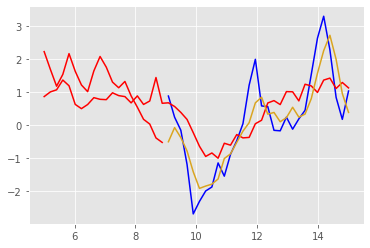

Epoch 254 batch 0 train Loss 0.1225 test Loss 0.1288 with training MSE metric 0.3031 and testing MSE metric 0.3087
learning rate is 0.0003000000142492354


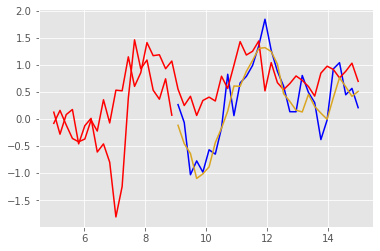

Epoch 254 batch 50 train Loss 0.1070 test Loss 0.1100 with training MSE metric 0.2864 and testing MSE metric 0.2911
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.287747144699097 secs



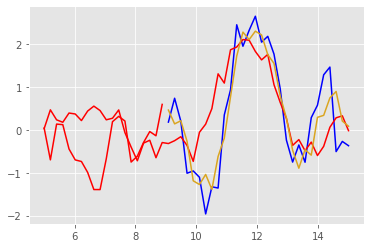

Epoch 255 batch 0 train Loss 0.1148 test Loss 0.1057 with training MSE metric 0.2942 and testing MSE metric 0.2811
learning rate is 0.0003000000142492354


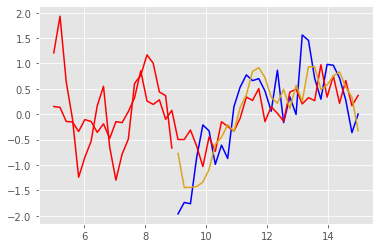

Epoch 255 batch 50 train Loss 0.1073 test Loss 0.0896 with training MSE metric 0.2847 and testing MSE metric 0.2647
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.358614921569824 secs



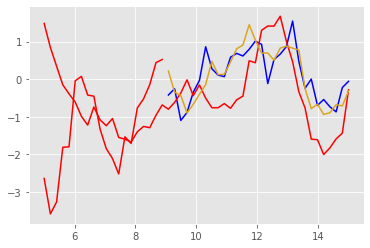

Epoch 256 batch 0 train Loss 0.1387 test Loss 0.1206 with training MSE metric 0.3230 and testing MSE metric 0.2991
learning rate is 0.0003000000142492354


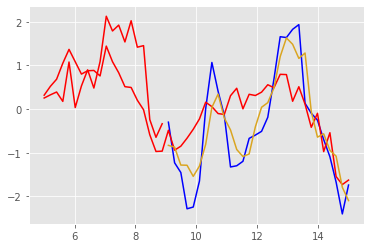

Epoch 256 batch 50 train Loss 0.1169 test Loss 0.1032 with training MSE metric 0.2937 and testing MSE metric 0.2785
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.309501886367798 secs



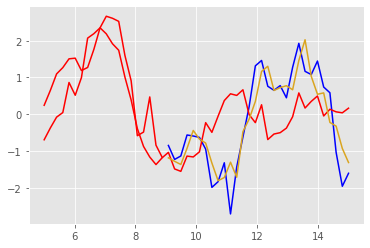

Epoch 257 batch 0 train Loss 0.1247 test Loss 0.1201 with training MSE metric 0.3031 and testing MSE metric 0.2992
learning rate is 0.0003000000142492354


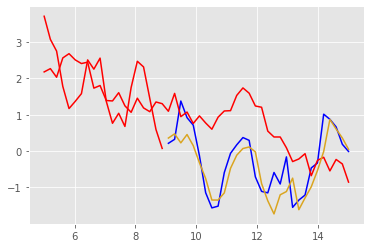

Epoch 257 batch 50 train Loss 0.1215 test Loss 0.1047 with training MSE metric 0.3020 and testing MSE metric 0.2787
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.438134908676147 secs



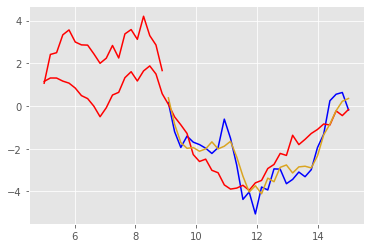

Epoch 258 batch 0 train Loss 0.1220 test Loss 0.1514 with training MSE metric 0.3012 and testing MSE metric 0.3348
learning rate is 0.0003000000142492354


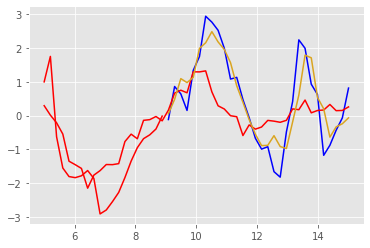

Epoch 258 batch 50 train Loss 0.1466 test Loss 0.1329 with training MSE metric 0.3357 and testing MSE metric 0.3125
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.343786001205444 secs



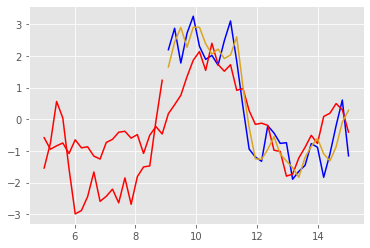

Epoch 259 batch 0 train Loss 0.1149 test Loss 0.1188 with training MSE metric 0.2947 and testing MSE metric 0.2983
learning rate is 0.0003000000142492354


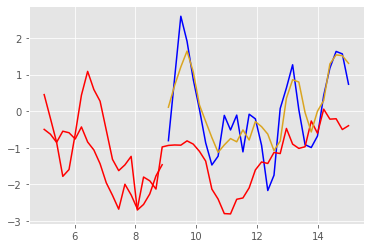

Epoch 259 batch 50 train Loss 0.1079 test Loss 0.1128 with training MSE metric 0.2851 and testing MSE metric 0.2934
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.315944194793701 secs



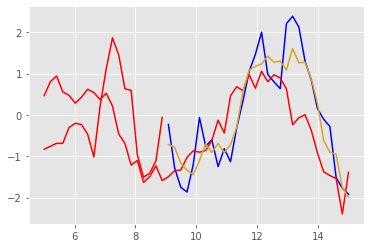

Epoch 260 batch 0 train Loss 0.1171 test Loss 0.1374 with training MSE metric 0.2972 and testing MSE metric 0.3195
learning rate is 0.0003000000142492354


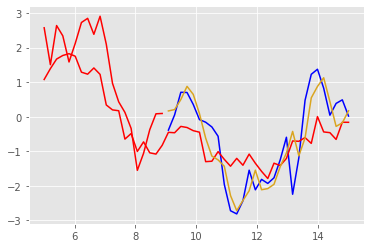

Epoch 260 batch 50 train Loss 0.1378 test Loss 0.1300 with training MSE metric 0.3196 and testing MSE metric 0.3108
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.35773491859436 secs



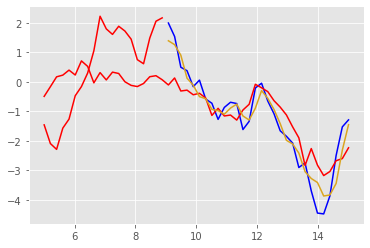

Epoch 261 batch 0 train Loss 0.1270 test Loss 0.1092 with training MSE metric 0.3087 and testing MSE metric 0.2875
learning rate is 0.0003000000142492354


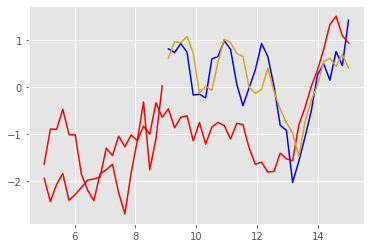

Epoch 261 batch 50 train Loss 0.1217 test Loss 0.1135 with training MSE metric 0.3016 and testing MSE metric 0.2919
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.436474084854126 secs



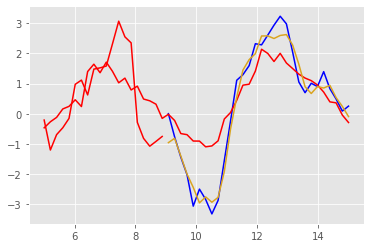

Epoch 262 batch 0 train Loss 0.1257 test Loss 0.0724 with training MSE metric 0.3065 and testing MSE metric 0.2415
learning rate is 0.0003000000142492354


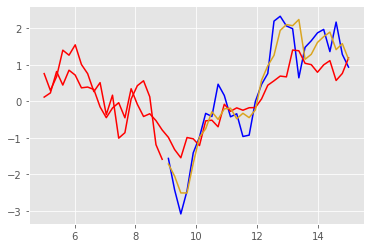

Epoch 262 batch 50 train Loss 0.1032 test Loss 0.1080 with training MSE metric 0.2830 and testing MSE metric 0.2854
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.264634847640991 secs



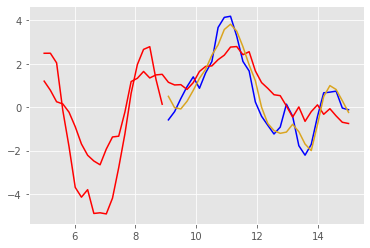

Epoch 263 batch 0 train Loss 0.1377 test Loss 0.1362 with training MSE metric 0.3219 and testing MSE metric 0.3188
learning rate is 0.0003000000142492354


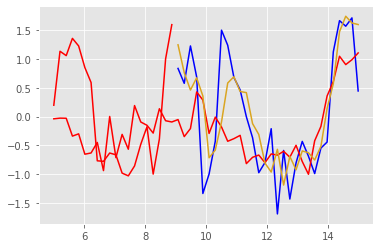

Epoch 263 batch 50 train Loss 0.1104 test Loss 0.1172 with training MSE metric 0.2878 and testing MSE metric 0.2966
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.309059858322144 secs



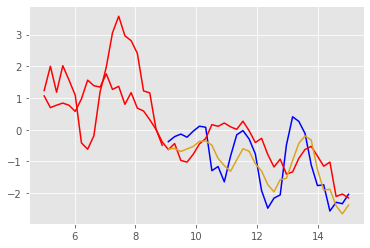

Epoch 264 batch 0 train Loss 0.1123 test Loss 0.1284 with training MSE metric 0.2890 and testing MSE metric 0.3092
learning rate is 0.0003000000142492354


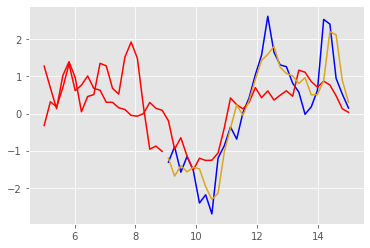

Epoch 264 batch 50 train Loss 0.1389 test Loss 0.1083 with training MSE metric 0.3231 and testing MSE metric 0.2859
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.307984113693237 secs



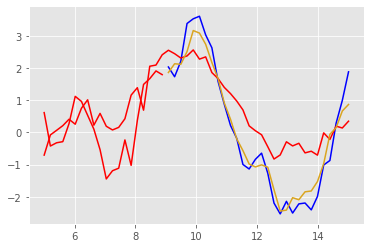

Epoch 265 batch 0 train Loss 0.1279 test Loss 0.1225 with training MSE metric 0.3065 and testing MSE metric 0.3014
learning rate is 0.0003000000142492354


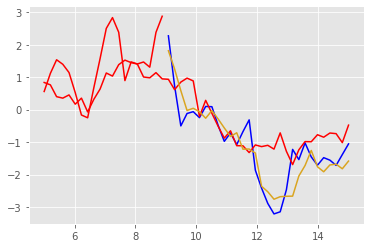

Epoch 265 batch 50 train Loss 0.1032 test Loss 0.1309 with training MSE metric 0.2816 and testing MSE metric 0.3130
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.350528955459595 secs



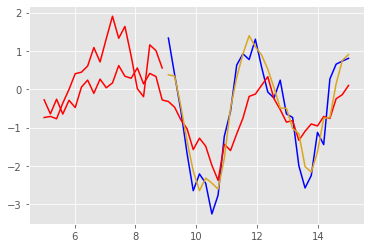

Epoch 266 batch 0 train Loss 0.1134 test Loss 0.1087 with training MSE metric 0.2889 and testing MSE metric 0.2858
learning rate is 0.0003000000142492354


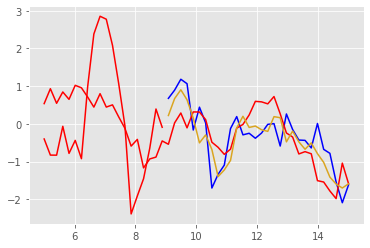

Epoch 266 batch 50 train Loss 0.1108 test Loss 0.1046 with training MSE metric 0.2868 and testing MSE metric 0.2803
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.324290037155151 secs



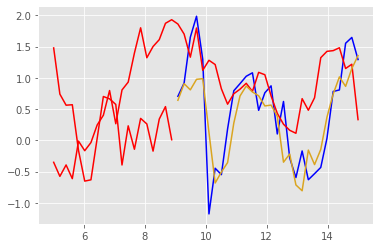

Epoch 267 batch 0 train Loss 0.1392 test Loss 0.1079 with training MSE metric 0.3209 and testing MSE metric 0.2857
learning rate is 0.0003000000142492354


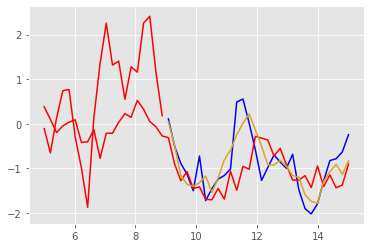

Epoch 267 batch 50 train Loss 0.1409 test Loss 0.1102 with training MSE metric 0.3277 and testing MSE metric 0.2878
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.34499192237854 secs



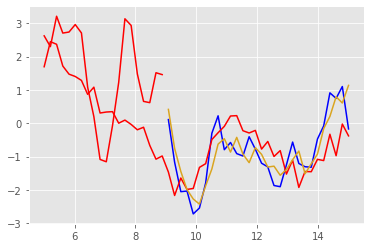

Epoch 268 batch 0 train Loss 0.1377 test Loss 0.1029 with training MSE metric 0.3278 and testing MSE metric 0.2778
learning rate is 0.0003000000142492354


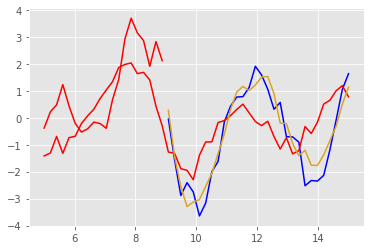

Epoch 268 batch 50 train Loss 0.1593 test Loss 0.0951 with training MSE metric 0.3497 and testing MSE metric 0.2711
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.391321182250977 secs



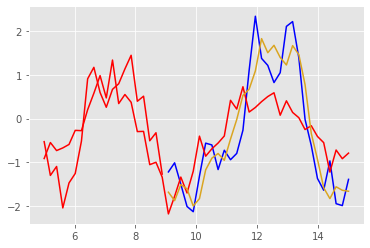

Epoch 269 batch 0 train Loss 0.1367 test Loss 0.1199 with training MSE metric 0.3198 and testing MSE metric 0.2963
learning rate is 0.0003000000142492354


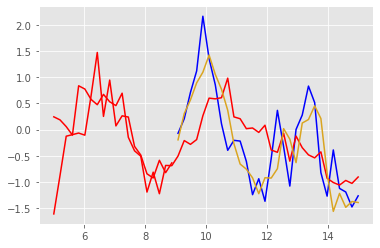

Epoch 269 batch 50 train Loss 0.1080 test Loss 0.1122 with training MSE metric 0.2869 and testing MSE metric 0.2895
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.187271118164062 secs



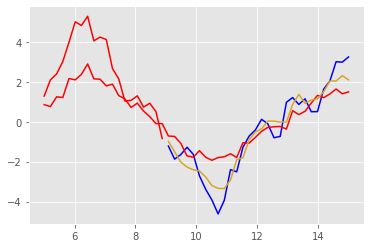

Epoch 270 batch 0 train Loss 0.1018 test Loss 0.1155 with training MSE metric 0.2770 and testing MSE metric 0.2925
learning rate is 0.0003000000142492354


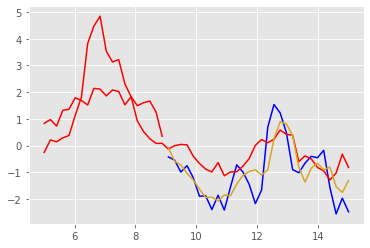

Epoch 270 batch 50 train Loss 0.1093 test Loss 0.1156 with training MSE metric 0.2866 and testing MSE metric 0.2934
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.973219871520996 secs



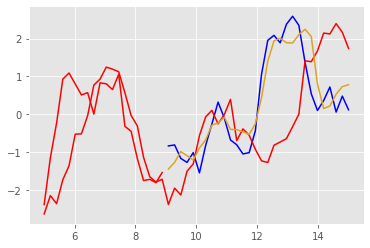

Epoch 271 batch 0 train Loss 0.1131 test Loss 0.1021 with training MSE metric 0.2906 and testing MSE metric 0.2759
learning rate is 0.0003000000142492354


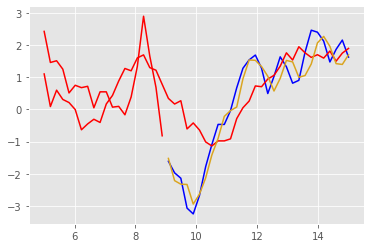

Epoch 271 batch 50 train Loss 0.1306 test Loss 0.1201 with training MSE metric 0.3159 and testing MSE metric 0.2972
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.959214925765991 secs



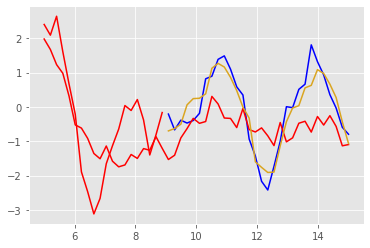

Epoch 272 batch 0 train Loss 0.1083 test Loss 0.1136 with training MSE metric 0.2873 and testing MSE metric 0.2912
learning rate is 0.0003000000142492354


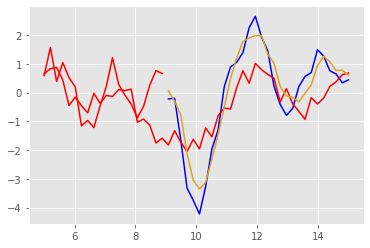

Epoch 272 batch 50 train Loss 0.1467 test Loss 0.1006 with training MSE metric 0.3288 and testing MSE metric 0.2765
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.200050115585327 secs



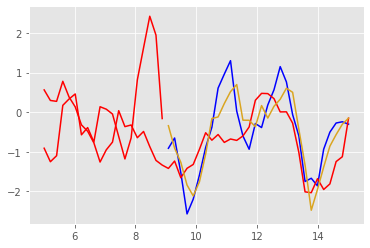

Epoch 273 batch 0 train Loss 0.1106 test Loss 0.0925 with training MSE metric 0.2884 and testing MSE metric 0.2649
learning rate is 0.0003000000142492354


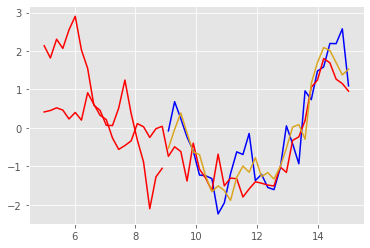

Epoch 273 batch 50 train Loss 0.1214 test Loss 0.1107 with training MSE metric 0.3049 and testing MSE metric 0.2892
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.33507490158081 secs



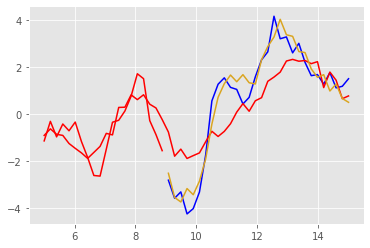

Epoch 274 batch 0 train Loss 0.1119 test Loss 0.0710 with training MSE metric 0.2917 and testing MSE metric 0.2414
learning rate is 0.0003000000142492354


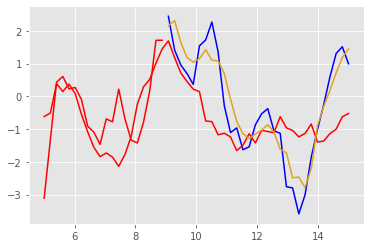

Epoch 274 batch 50 train Loss 0.1144 test Loss 0.0970 with training MSE metric 0.2922 and testing MSE metric 0.2710
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.386399030685425 secs



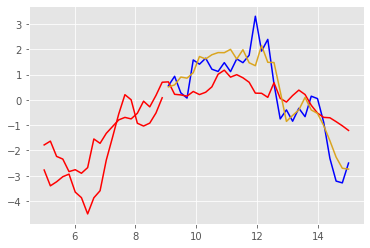

Epoch 275 batch 0 train Loss 0.1107 test Loss 0.1280 with training MSE metric 0.2898 and testing MSE metric 0.3072
learning rate is 0.0003000000142492354


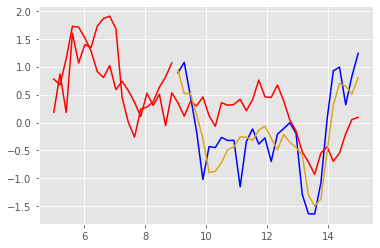

Epoch 275 batch 50 train Loss 0.1084 test Loss 0.1188 with training MSE metric 0.2862 and testing MSE metric 0.2975
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.409405946731567 secs



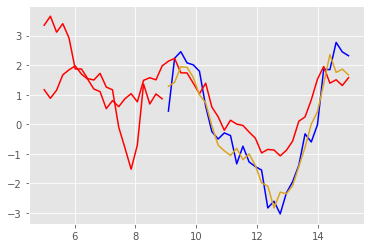

Epoch 276 batch 0 train Loss 0.1171 test Loss 0.1007 with training MSE metric 0.2976 and testing MSE metric 0.2790
learning rate is 0.0003000000142492354


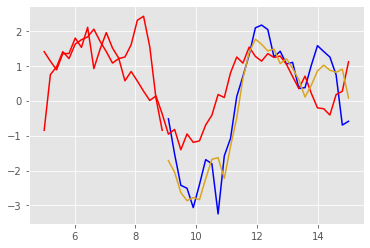

Epoch 276 batch 50 train Loss 0.1026 test Loss 0.1066 with training MSE metric 0.2792 and testing MSE metric 0.2848
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.360763788223267 secs



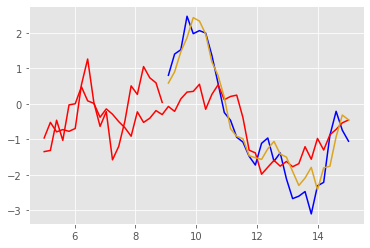

Epoch 277 batch 0 train Loss 0.1100 test Loss 0.0927 with training MSE metric 0.2880 and testing MSE metric 0.2646
learning rate is 0.0003000000142492354


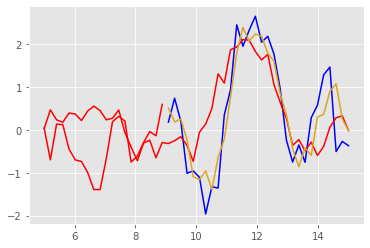

Epoch 277 batch 50 train Loss 0.1148 test Loss 0.0970 with training MSE metric 0.2940 and testing MSE metric 0.2717
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.343360900878906 secs



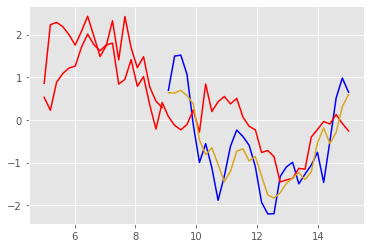

Epoch 278 batch 0 train Loss 0.1300 test Loss 0.1044 with training MSE metric 0.3134 and testing MSE metric 0.2832
learning rate is 0.0003000000142492354


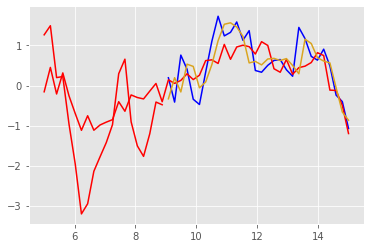

Epoch 278 batch 50 train Loss 0.1351 test Loss 0.1306 with training MSE metric 0.3168 and testing MSE metric 0.3130
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.499831676483154 secs



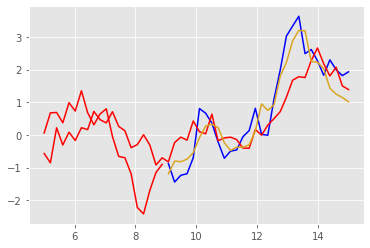

Epoch 279 batch 0 train Loss 0.1372 test Loss 0.1002 with training MSE metric 0.3231 and testing MSE metric 0.2769
learning rate is 0.0003000000142492354


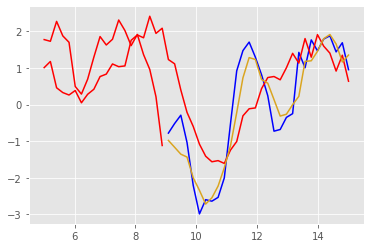

Epoch 279 batch 50 train Loss 0.1489 test Loss 0.1029 with training MSE metric 0.3367 and testing MSE metric 0.2795
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.299118757247925 secs



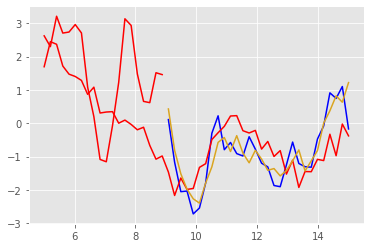

Epoch 280 batch 0 train Loss 0.1439 test Loss 0.1168 with training MSE metric 0.3315 and testing MSE metric 0.2918
learning rate is 0.0003000000142492354


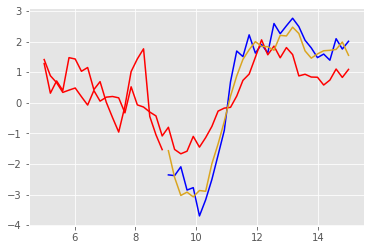

Epoch 280 batch 50 train Loss 0.1012 test Loss 0.1361 with training MSE metric 0.2771 and testing MSE metric 0.3176
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.44412112236023 secs



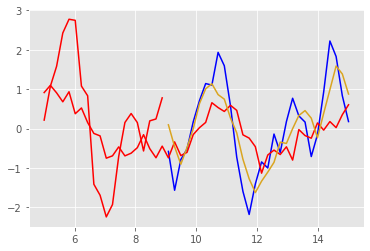

Epoch 281 batch 0 train Loss 0.1393 test Loss 0.0866 with training MSE metric 0.3236 and testing MSE metric 0.2588
learning rate is 0.0003000000142492354


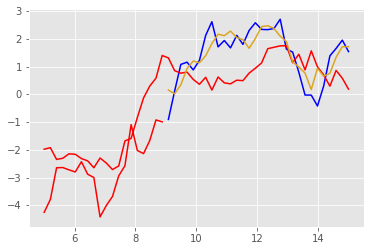

Epoch 281 batch 50 train Loss 0.1078 test Loss 0.1108 with training MSE metric 0.2854 and testing MSE metric 0.2845
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.356201171875 secs



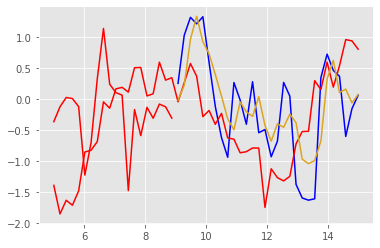

Epoch 282 batch 0 train Loss 0.1412 test Loss 0.0900 with training MSE metric 0.3283 and testing MSE metric 0.2639
learning rate is 0.0003000000142492354


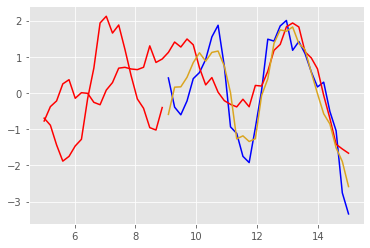

Epoch 282 batch 50 train Loss 0.1350 test Loss 0.1553 with training MSE metric 0.3159 and testing MSE metric 0.3400
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.306623220443726 secs



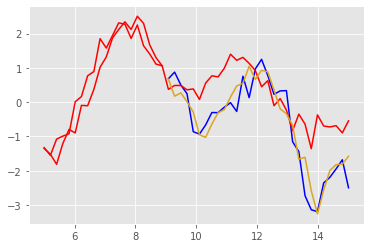

Epoch 283 batch 0 train Loss 0.1011 test Loss 0.1076 with training MSE metric 0.2747 and testing MSE metric 0.2834
learning rate is 0.0003000000142492354


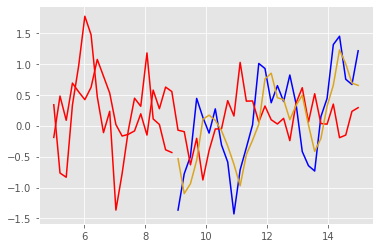

Epoch 283 batch 50 train Loss 0.1327 test Loss 0.1177 with training MSE metric 0.3174 and testing MSE metric 0.2947
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.267369985580444 secs



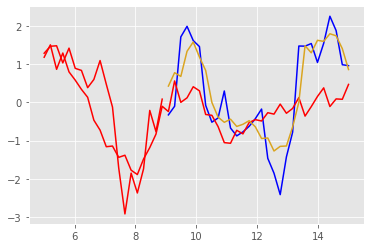

Epoch 284 batch 0 train Loss 0.1088 test Loss 0.1164 with training MSE metric 0.2847 and testing MSE metric 0.2954
learning rate is 0.0003000000142492354


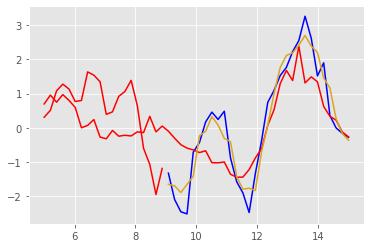

Epoch 284 batch 50 train Loss 0.1234 test Loss 0.1411 with training MSE metric 0.3039 and testing MSE metric 0.3226
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.081666231155396 secs



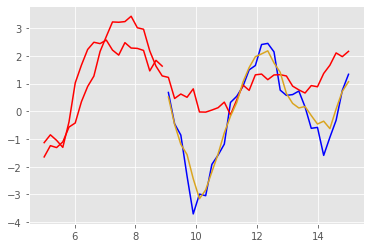

Epoch 285 batch 0 train Loss 0.1239 test Loss 0.1224 with training MSE metric 0.3039 and testing MSE metric 0.3006
learning rate is 0.0003000000142492354


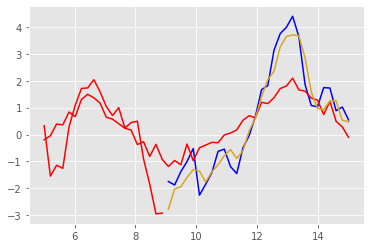

Epoch 285 batch 50 train Loss 0.1117 test Loss 0.1212 with training MSE metric 0.2914 and testing MSE metric 0.3012
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.025075912475586 secs



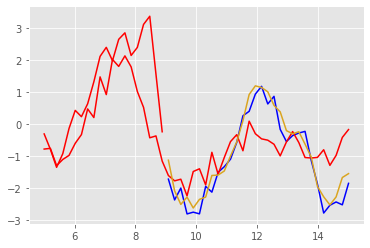

Epoch 286 batch 0 train Loss 0.1362 test Loss 0.1033 with training MSE metric 0.3215 and testing MSE metric 0.2802
learning rate is 0.0003000000142492354


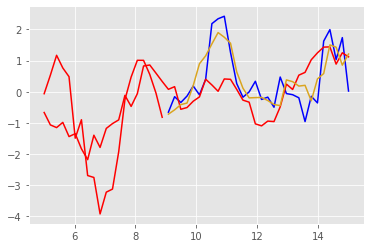

Epoch 286 batch 50 train Loss 0.1354 test Loss 0.1026 with training MSE metric 0.3151 and testing MSE metric 0.2787
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.977010250091553 secs



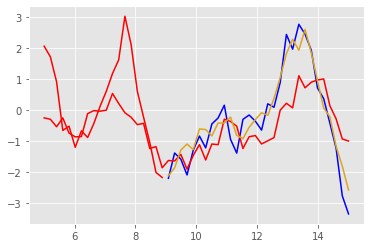

Epoch 287 batch 0 train Loss 0.1068 test Loss 0.1219 with training MSE metric 0.2852 and testing MSE metric 0.2998
learning rate is 0.0003000000142492354


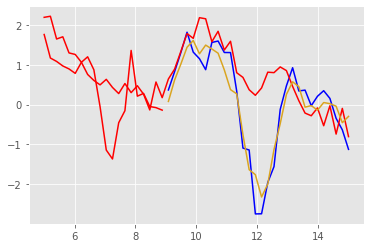

Epoch 287 batch 50 train Loss 0.1147 test Loss 0.0704 with training MSE metric 0.2920 and testing MSE metric 0.2410
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.988984823226929 secs



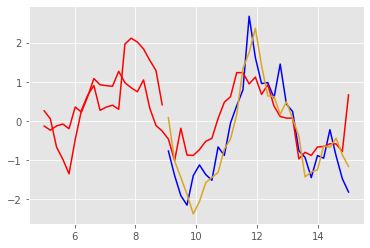

Epoch 288 batch 0 train Loss 0.1238 test Loss 0.1542 with training MSE metric 0.3053 and testing MSE metric 0.3374
learning rate is 0.0003000000142492354


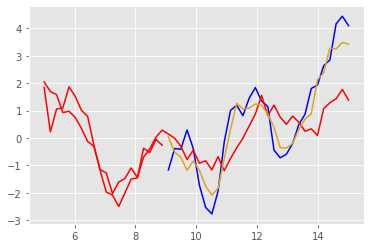

Epoch 288 batch 50 train Loss 0.1199 test Loss 0.1154 with training MSE metric 0.2991 and testing MSE metric 0.2947
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.329102993011475 secs



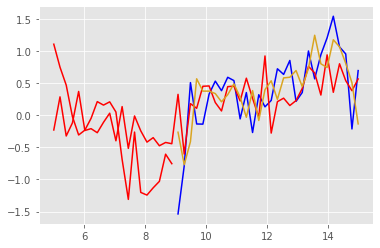

Epoch 289 batch 0 train Loss 0.1239 test Loss 0.1142 with training MSE metric 0.3038 and testing MSE metric 0.2926
learning rate is 0.0003000000142492354


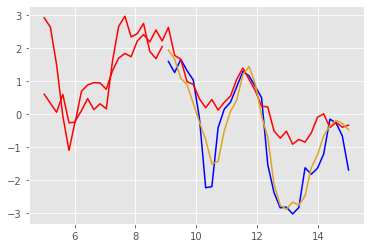

Epoch 289 batch 50 train Loss 0.0929 test Loss 0.1104 with training MSE metric 0.2654 and testing MSE metric 0.2888
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.380708932876587 secs



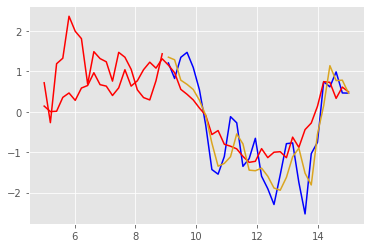

Epoch 290 batch 0 train Loss 0.1292 test Loss 0.0904 with training MSE metric 0.3114 and testing MSE metric 0.2613
learning rate is 0.0003000000142492354


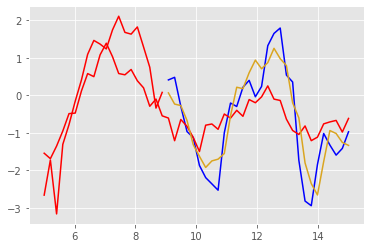

Epoch 290 batch 50 train Loss 0.0989 test Loss 0.1150 with training MSE metric 0.2727 and testing MSE metric 0.2918
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.348850011825562 secs



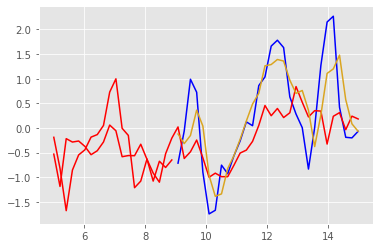

Epoch 291 batch 0 train Loss 0.1322 test Loss 0.0824 with training MSE metric 0.3158 and testing MSE metric 0.2532
learning rate is 0.0003000000142492354


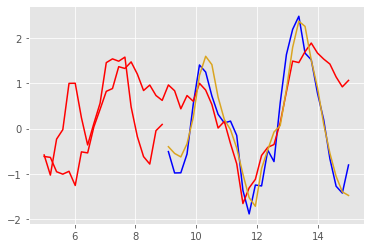

Epoch 291 batch 50 train Loss 0.1096 test Loss 0.1449 with training MSE metric 0.2907 and testing MSE metric 0.3273
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.369969129562378 secs



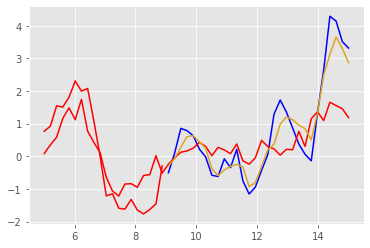

Epoch 292 batch 0 train Loss 0.1042 test Loss 0.1045 with training MSE metric 0.2839 and testing MSE metric 0.2822
learning rate is 0.0003000000142492354


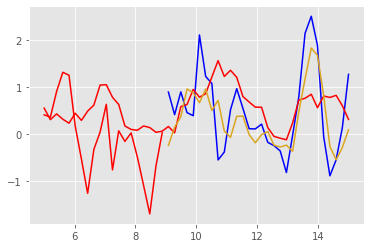

Epoch 292 batch 50 train Loss 0.1168 test Loss 0.1152 with training MSE metric 0.2956 and testing MSE metric 0.2912
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.301279067993164 secs



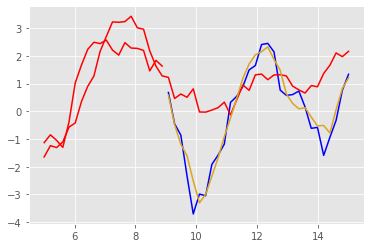

Epoch 293 batch 0 train Loss 0.1396 test Loss 0.0953 with training MSE metric 0.3252 and testing MSE metric 0.2702
learning rate is 0.0003000000142492354


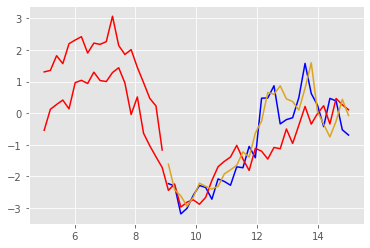

Epoch 293 batch 50 train Loss 0.1228 test Loss 0.1150 with training MSE metric 0.3039 and testing MSE metric 0.2925
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.29768419265747 secs



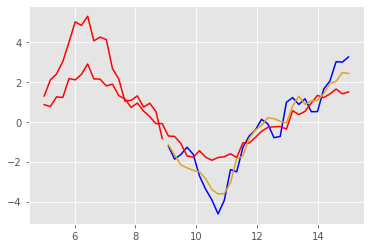

Epoch 294 batch 0 train Loss 0.1034 test Loss 0.1277 with training MSE metric 0.2810 and testing MSE metric 0.3102
learning rate is 0.0003000000142492354


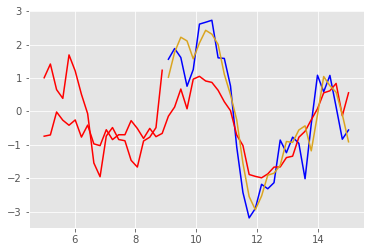

Epoch 294 batch 50 train Loss 0.1171 test Loss 0.1285 with training MSE metric 0.2985 and testing MSE metric 0.3111
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.403563976287842 secs



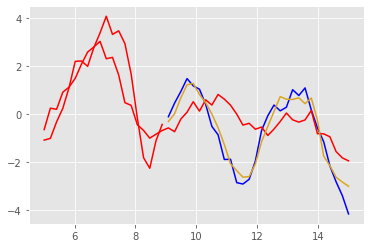

Epoch 295 batch 0 train Loss 0.1164 test Loss 0.1227 with training MSE metric 0.2983 and testing MSE metric 0.3033
learning rate is 0.0003000000142492354


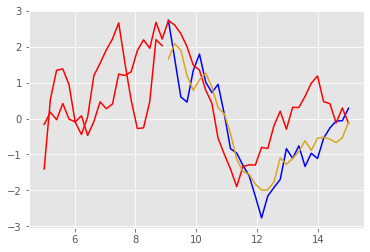

Epoch 295 batch 50 train Loss 0.1122 test Loss 0.0983 with training MSE metric 0.2903 and testing MSE metric 0.2710
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.495122194290161 secs



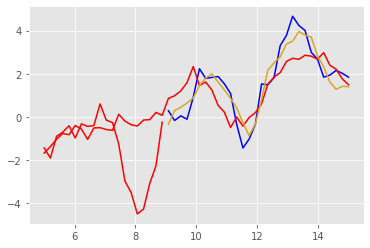

Epoch 296 batch 0 train Loss 0.1149 test Loss 0.1083 with training MSE metric 0.2964 and testing MSE metric 0.2846
learning rate is 0.0003000000142492354


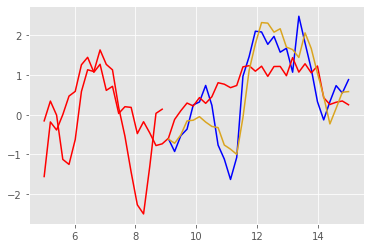

Epoch 296 batch 50 train Loss 0.1131 test Loss 0.1253 with training MSE metric 0.2897 and testing MSE metric 0.3072
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.833619117736816 secs



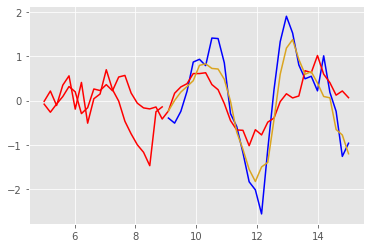

Epoch 297 batch 0 train Loss 0.1202 test Loss 0.1010 with training MSE metric 0.3004 and testing MSE metric 0.2795
learning rate is 0.0003000000142492354


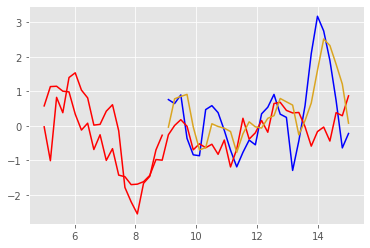

Epoch 297 batch 50 train Loss 0.1009 test Loss 0.1412 with training MSE metric 0.2791 and testing MSE metric 0.3234
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.06491994857788 secs



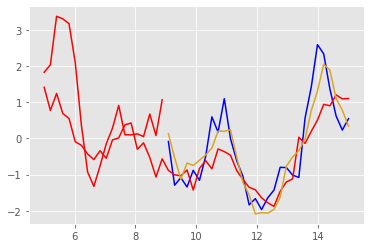

Epoch 298 batch 0 train Loss 0.1148 test Loss 0.1198 with training MSE metric 0.2922 and testing MSE metric 0.2945
learning rate is 0.0003000000142492354


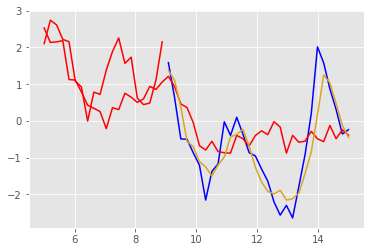

Epoch 298 batch 50 train Loss 0.1300 test Loss 0.0994 with training MSE metric 0.3117 and testing MSE metric 0.2741
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 15.68596887588501 secs



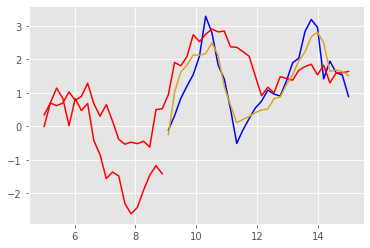

Epoch 299 batch 0 train Loss 0.1090 test Loss 0.1013 with training MSE metric 0.2855 and testing MSE metric 0.2787
learning rate is 0.0003000000142492354


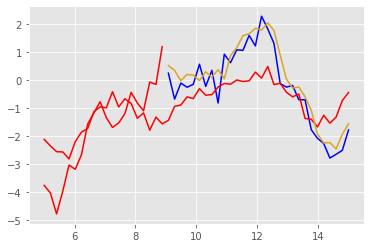

Epoch 299 batch 50 train Loss 0.1217 test Loss 0.1021 with training MSE metric 0.3019 and testing MSE metric 0.2793
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.519527912139893 secs



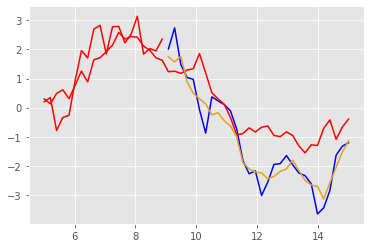

Epoch 300 batch 0 train Loss 0.1253 test Loss 0.1245 with training MSE metric 0.3094 and testing MSE metric 0.3035
learning rate is 0.0003000000142492354


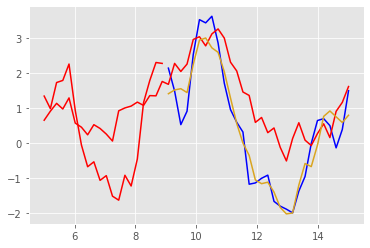

Epoch 300 batch 50 train Loss 0.0884 test Loss 0.1158 with training MSE metric 0.2631 and testing MSE metric 0.2944
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.418773889541626 secs



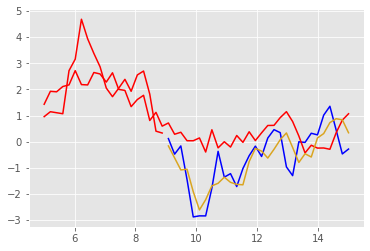

Epoch 301 batch 0 train Loss 0.1161 test Loss 0.1138 with training MSE metric 0.2951 and testing MSE metric 0.2942
learning rate is 0.0003000000142492354


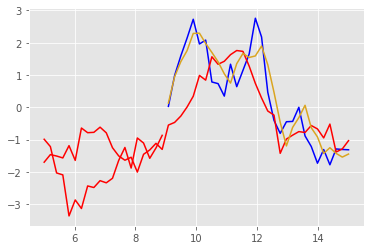

Epoch 301 batch 50 train Loss 0.1111 test Loss 0.1085 with training MSE metric 0.2898 and testing MSE metric 0.2862
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.405832052230835 secs



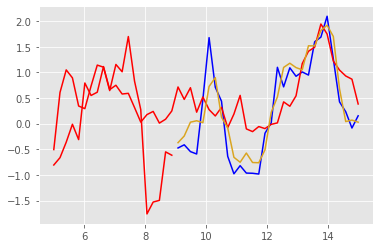

Epoch 302 batch 0 train Loss 0.1001 test Loss 0.0974 with training MSE metric 0.2792 and testing MSE metric 0.2721
learning rate is 0.0003000000142492354


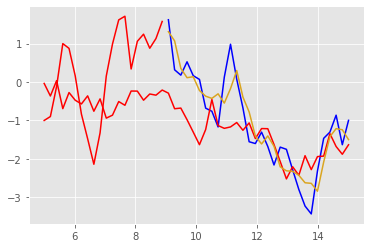

Epoch 302 batch 50 train Loss 0.1358 test Loss 0.1122 with training MSE metric 0.3163 and testing MSE metric 0.2929
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.10327672958374 secs



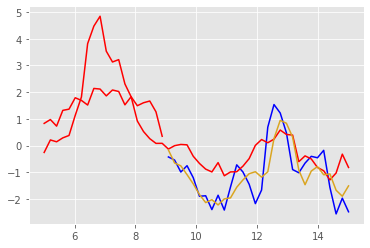

Epoch 303 batch 0 train Loss 0.1191 test Loss 0.1139 with training MSE metric 0.2969 and testing MSE metric 0.2927
learning rate is 0.0003000000142492354


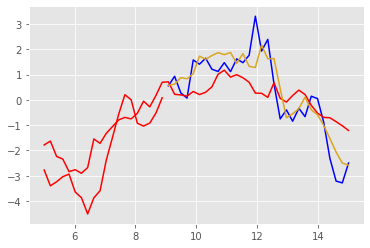

Epoch 303 batch 50 train Loss 0.1212 test Loss 0.1066 with training MSE metric 0.3064 and testing MSE metric 0.2836
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.943578004837036 secs



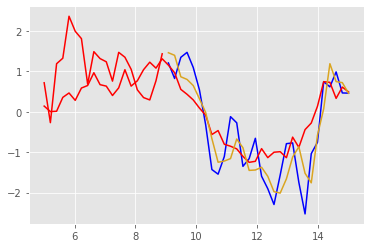

Epoch 304 batch 0 train Loss 0.1116 test Loss 0.1086 with training MSE metric 0.2893 and testing MSE metric 0.2865
learning rate is 0.0003000000142492354


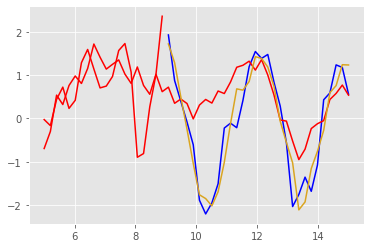

Epoch 304 batch 50 train Loss 0.1189 test Loss 0.1240 with training MSE metric 0.2977 and testing MSE metric 0.3054
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.575164318084717 secs



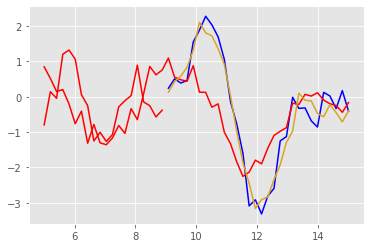

Epoch 305 batch 0 train Loss 0.1022 test Loss 0.1209 with training MSE metric 0.2774 and testing MSE metric 0.2979
learning rate is 0.0003000000142492354


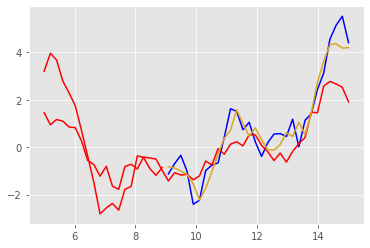

Epoch 305 batch 50 train Loss 0.1493 test Loss 0.1149 with training MSE metric 0.3347 and testing MSE metric 0.2929
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.216701030731201 secs



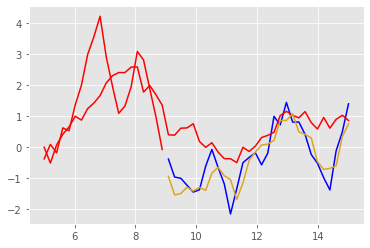

Epoch 306 batch 0 train Loss 0.1064 test Loss 0.1116 with training MSE metric 0.2843 and testing MSE metric 0.2905
learning rate is 0.0003000000142492354


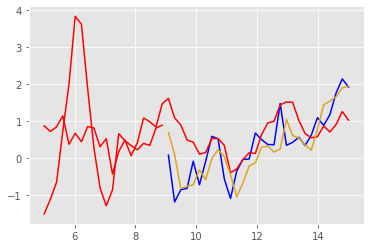

Epoch 306 batch 50 train Loss 0.1102 test Loss 0.1028 with training MSE metric 0.2893 and testing MSE metric 0.2774
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.993333101272583 secs



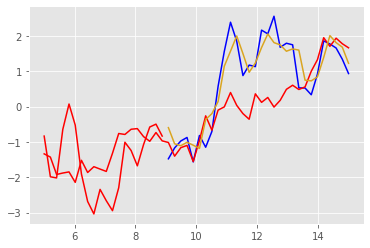

Epoch 307 batch 0 train Loss 0.1253 test Loss 0.1205 with training MSE metric 0.3074 and testing MSE metric 0.3007
learning rate is 0.0003000000142492354


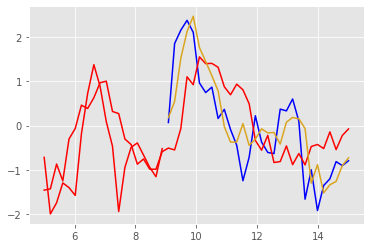

Epoch 307 batch 50 train Loss 0.0984 test Loss 0.1147 with training MSE metric 0.2765 and testing MSE metric 0.2930
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.169708967208862 secs



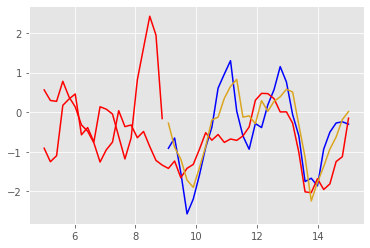

Epoch 308 batch 0 train Loss 0.1078 test Loss 0.1336 with training MSE metric 0.2884 and testing MSE metric 0.3138
learning rate is 0.0003000000142492354


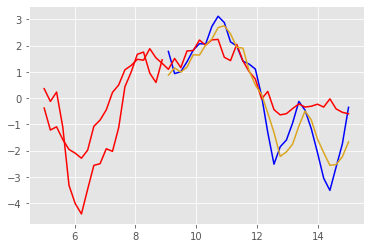

Epoch 308 batch 50 train Loss 0.1150 test Loss 0.1323 with training MSE metric 0.2947 and testing MSE metric 0.3121
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.575597047805786 secs



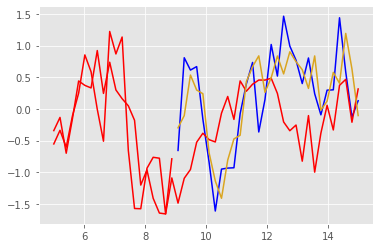

Epoch 309 batch 0 train Loss 0.1181 test Loss 0.1123 with training MSE metric 0.2980 and testing MSE metric 0.2872
learning rate is 0.0003000000142492354


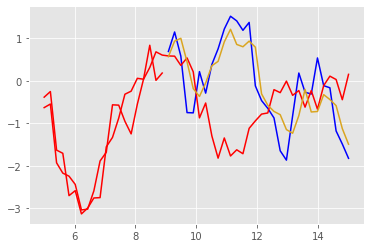

Epoch 309 batch 50 train Loss 0.1551 test Loss 0.1133 with training MSE metric 0.3413 and testing MSE metric 0.2907
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.076970100402832 secs



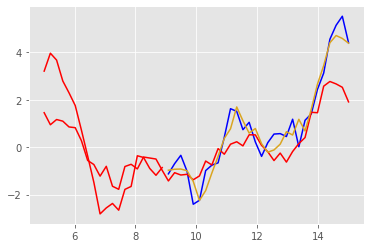

Epoch 310 batch 0 train Loss 0.1162 test Loss 0.1035 with training MSE metric 0.2941 and testing MSE metric 0.2789
learning rate is 0.0003000000142492354


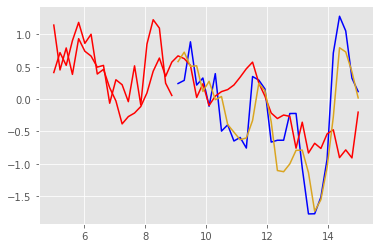

Epoch 310 batch 50 train Loss 0.1088 test Loss 0.1164 with training MSE metric 0.2861 and testing MSE metric 0.2925
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.365601062774658 secs



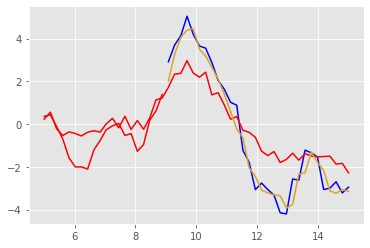

Epoch 311 batch 0 train Loss 0.1116 test Loss 0.1013 with training MSE metric 0.2896 and testing MSE metric 0.2767
learning rate is 0.0003000000142492354


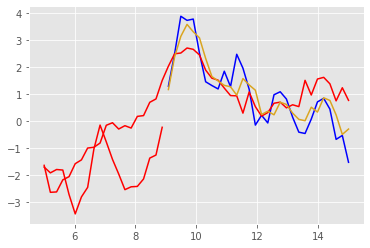

Epoch 311 batch 50 train Loss 0.1331 test Loss 0.1104 with training MSE metric 0.3186 and testing MSE metric 0.2849
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.421714067459106 secs



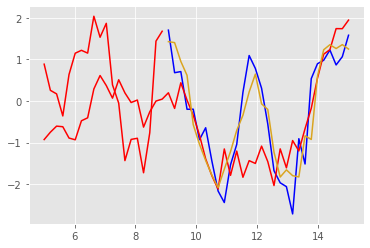

Epoch 312 batch 0 train Loss 0.1128 test Loss 0.1140 with training MSE metric 0.2915 and testing MSE metric 0.2940
learning rate is 0.0003000000142492354


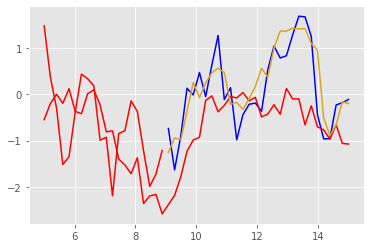

Epoch 312 batch 50 train Loss 0.1302 test Loss 0.1193 with training MSE metric 0.3115 and testing MSE metric 0.2975
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.296884059906006 secs



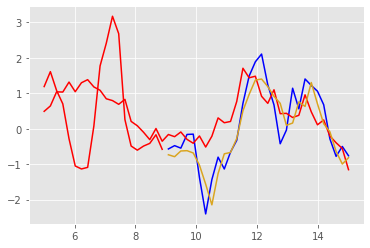

Epoch 313 batch 0 train Loss 0.1034 test Loss 0.1062 with training MSE metric 0.2799 and testing MSE metric 0.2849
learning rate is 0.0003000000142492354


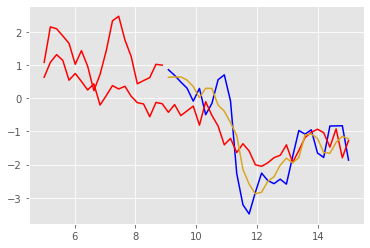

Epoch 313 batch 50 train Loss 0.1249 test Loss 0.1097 with training MSE metric 0.3094 and testing MSE metric 0.2857
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.92570972442627 secs



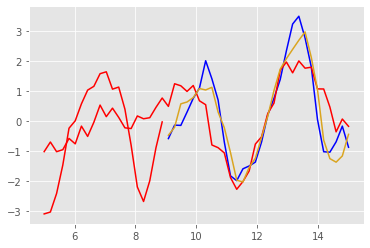

Epoch 314 batch 0 train Loss 0.1067 test Loss 0.0972 with training MSE metric 0.2823 and testing MSE metric 0.2746
learning rate is 0.0003000000142492354


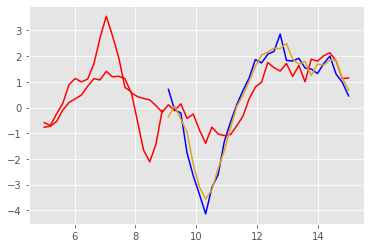

Epoch 314 batch 50 train Loss 0.1243 test Loss 0.1036 with training MSE metric 0.3043 and testing MSE metric 0.2772
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.530878067016602 secs



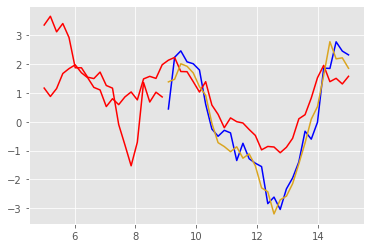

Epoch 315 batch 0 train Loss 0.1299 test Loss 0.0853 with training MSE metric 0.3123 and testing MSE metric 0.2559
learning rate is 0.0003000000142492354


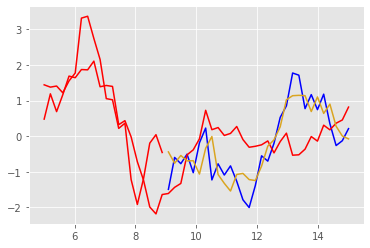

Epoch 315 batch 50 train Loss 0.1277 test Loss 0.1119 with training MSE metric 0.3105 and testing MSE metric 0.2866
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.272955894470215 secs



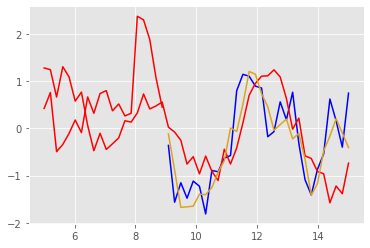

Epoch 316 batch 0 train Loss 0.1236 test Loss 0.1020 with training MSE metric 0.3064 and testing MSE metric 0.2779
learning rate is 0.0003000000142492354


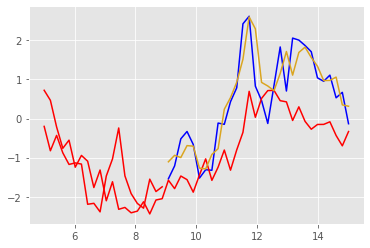

Epoch 316 batch 50 train Loss 0.0965 test Loss 0.1220 with training MSE metric 0.2745 and testing MSE metric 0.3005
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.298527956008911 secs



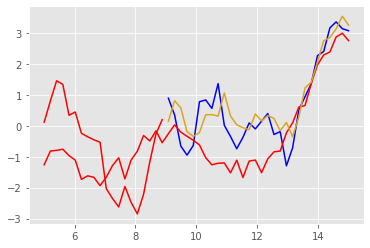

Epoch 317 batch 0 train Loss 0.1163 test Loss 0.1098 with training MSE metric 0.2944 and testing MSE metric 0.2867
learning rate is 0.0003000000142492354


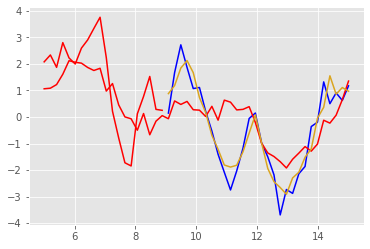

Epoch 317 batch 50 train Loss 0.1121 test Loss 0.1004 with training MSE metric 0.2913 and testing MSE metric 0.2739
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.738229036331177 secs



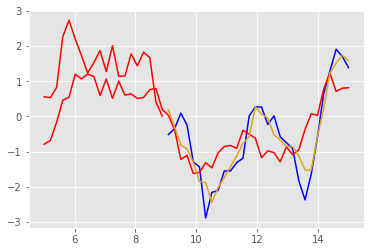

Epoch 318 batch 0 train Loss 0.1030 test Loss 0.1285 with training MSE metric 0.2782 and testing MSE metric 0.3045
learning rate is 0.0003000000142492354


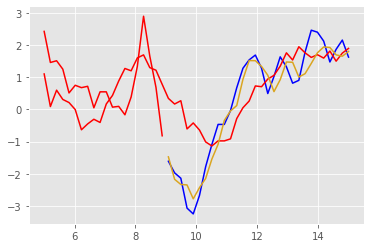

Epoch 318 batch 50 train Loss 0.1394 test Loss 0.1074 with training MSE metric 0.3256 and testing MSE metric 0.2885
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.980198860168457 secs



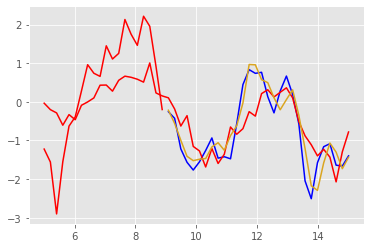

Epoch 319 batch 0 train Loss 0.1055 test Loss 0.1380 with training MSE metric 0.2809 and testing MSE metric 0.3199
learning rate is 0.0003000000142492354


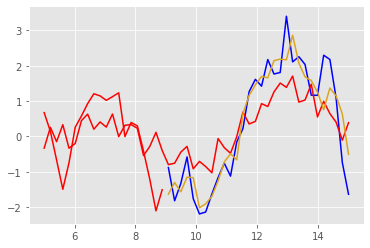

Epoch 319 batch 50 train Loss 0.1081 test Loss 0.1508 with training MSE metric 0.2837 and testing MSE metric 0.3391
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.31570291519165 secs



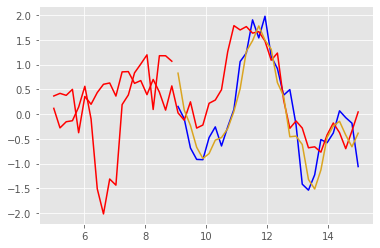

Epoch 320 batch 0 train Loss 0.1292 test Loss 0.0993 with training MSE metric 0.3095 and testing MSE metric 0.2757
learning rate is 0.0003000000142492354


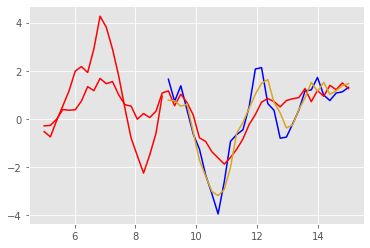

Epoch 320 batch 50 train Loss 0.0943 test Loss 0.1162 with training MSE metric 0.2702 and testing MSE metric 0.2925
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.418267965316772 secs



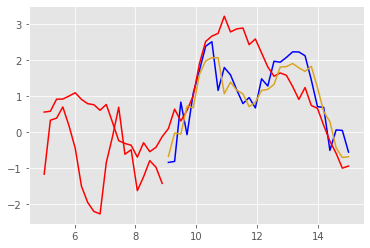

Epoch 321 batch 0 train Loss 0.1044 test Loss 0.1109 with training MSE metric 0.2813 and testing MSE metric 0.2859
learning rate is 0.0003000000142492354


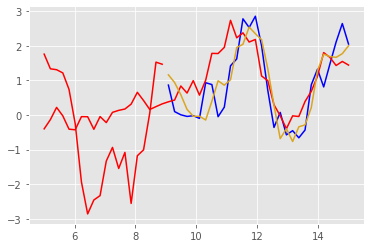

Epoch 321 batch 50 train Loss 0.1035 test Loss 0.1273 with training MSE metric 0.2788 and testing MSE metric 0.3109
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.465605020523071 secs



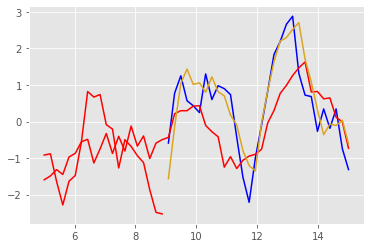

Epoch 322 batch 0 train Loss 0.1399 test Loss 0.1122 with training MSE metric 0.3233 and testing MSE metric 0.2891
learning rate is 0.0003000000142492354


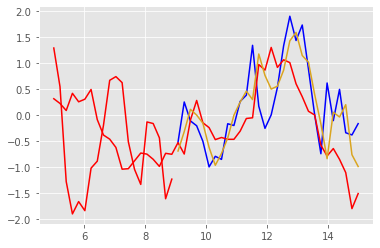

Epoch 322 batch 50 train Loss 0.1053 test Loss 0.1153 with training MSE metric 0.2797 and testing MSE metric 0.2946
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.431519985198975 secs



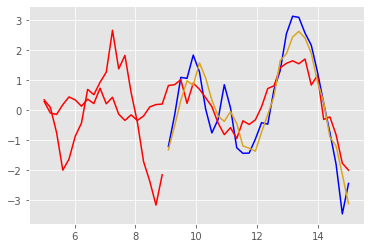

Epoch 323 batch 0 train Loss 0.1253 test Loss 0.1006 with training MSE metric 0.3058 and testing MSE metric 0.2738
learning rate is 0.0003000000142492354


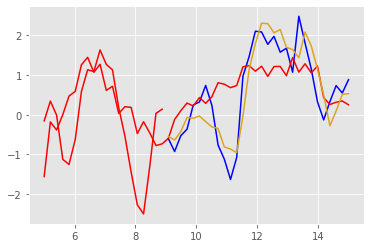

Epoch 323 batch 50 train Loss 0.1110 test Loss 0.0968 with training MSE metric 0.2896 and testing MSE metric 0.2719
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.558433055877686 secs



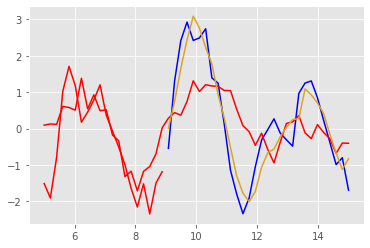

Epoch 324 batch 0 train Loss 0.1049 test Loss 0.1259 with training MSE metric 0.2828 and testing MSE metric 0.3079
learning rate is 0.0003000000142492354


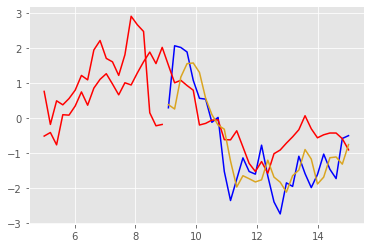

Epoch 324 batch 50 train Loss 0.0904 test Loss 0.1019 with training MSE metric 0.2653 and testing MSE metric 0.2794
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.454216003417969 secs



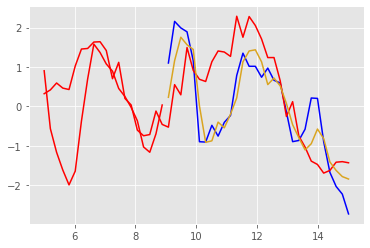

Epoch 325 batch 0 train Loss 0.1233 test Loss 0.1066 with training MSE metric 0.3040 and testing MSE metric 0.2809
learning rate is 0.0003000000142492354


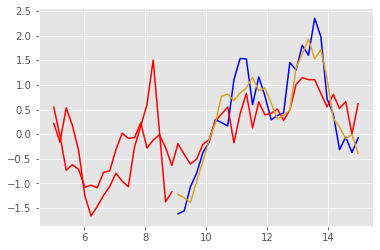

Epoch 325 batch 50 train Loss 0.1275 test Loss 0.0996 with training MSE metric 0.3084 and testing MSE metric 0.2747
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.23661994934082 secs



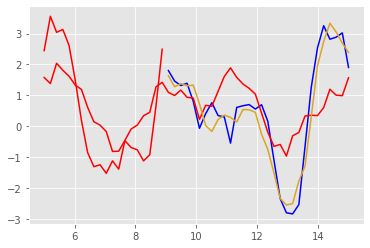

Epoch 326 batch 0 train Loss 0.1220 test Loss 0.0884 with training MSE metric 0.3051 and testing MSE metric 0.2596
learning rate is 0.0003000000142492354


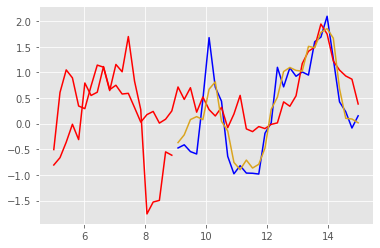

Epoch 326 batch 50 train Loss 0.1091 test Loss 0.0960 with training MSE metric 0.2882 and testing MSE metric 0.2696
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.313677072525024 secs



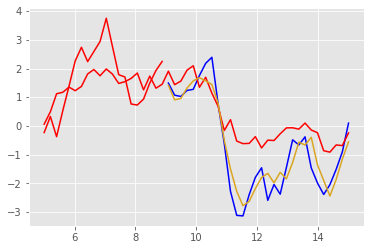

Epoch 327 batch 0 train Loss 0.1268 test Loss 0.0983 with training MSE metric 0.3120 and testing MSE metric 0.2732
learning rate is 0.0003000000142492354


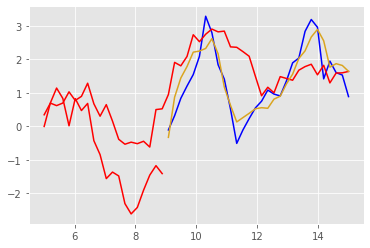

Epoch 327 batch 50 train Loss 0.1117 test Loss 0.1051 with training MSE metric 0.2903 and testing MSE metric 0.2835
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.662016153335571 secs



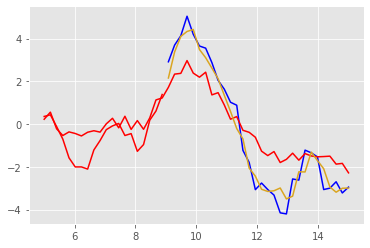

Epoch 328 batch 0 train Loss 0.1431 test Loss 0.1015 with training MSE metric 0.3281 and testing MSE metric 0.2763
learning rate is 0.0003000000142492354


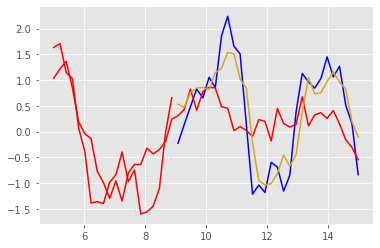

Epoch 328 batch 50 train Loss 0.1411 test Loss 0.1188 with training MSE metric 0.3246 and testing MSE metric 0.2969
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.71274995803833 secs



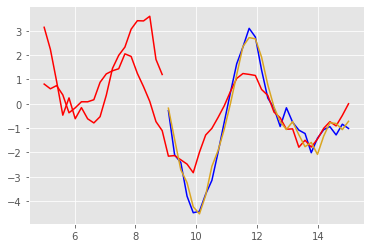

Epoch 329 batch 0 train Loss 0.1386 test Loss 0.1097 with training MSE metric 0.3253 and testing MSE metric 0.2911
learning rate is 0.0003000000142492354


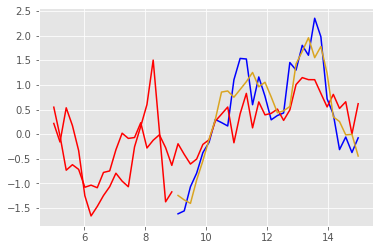

Epoch 329 batch 50 train Loss 0.1077 test Loss 0.0996 with training MSE metric 0.2873 and testing MSE metric 0.2753
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.483405113220215 secs



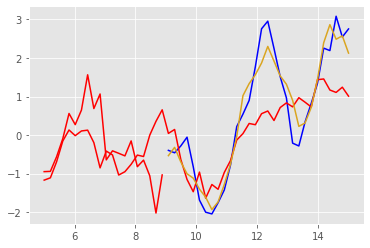

Epoch 330 batch 0 train Loss 0.1256 test Loss 0.0869 with training MSE metric 0.3063 and testing MSE metric 0.2599
learning rate is 0.0003000000142492354


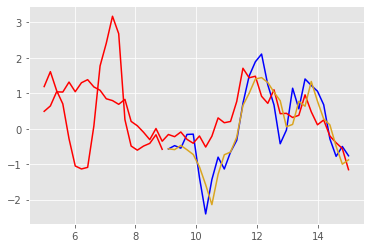

Epoch 330 batch 50 train Loss 0.1150 test Loss 0.1062 with training MSE metric 0.2938 and testing MSE metric 0.2826
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.319752931594849 secs



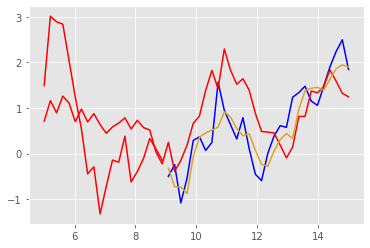

Epoch 331 batch 0 train Loss 0.1208 test Loss 0.1221 with training MSE metric 0.3016 and testing MSE metric 0.3013
learning rate is 0.0003000000142492354


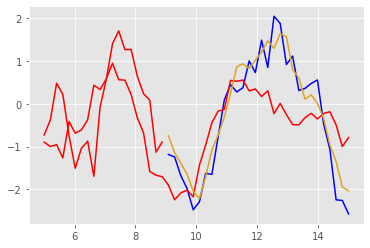

Epoch 331 batch 50 train Loss 0.1136 test Loss 0.1345 with training MSE metric 0.2945 and testing MSE metric 0.3158
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.091456890106201 secs



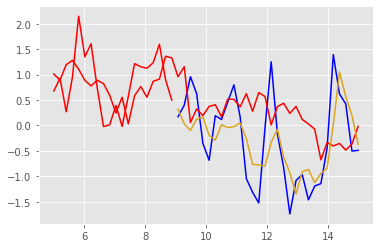

Epoch 332 batch 0 train Loss 0.1175 test Loss 0.1026 with training MSE metric 0.2965 and testing MSE metric 0.2768
learning rate is 0.0003000000142492354


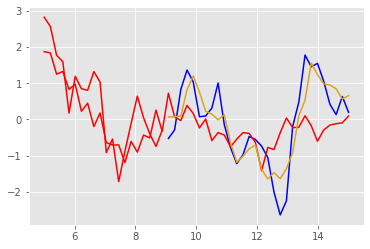

Epoch 332 batch 50 train Loss 0.1215 test Loss 0.1088 with training MSE metric 0.3007 and testing MSE metric 0.2898
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.243774890899658 secs



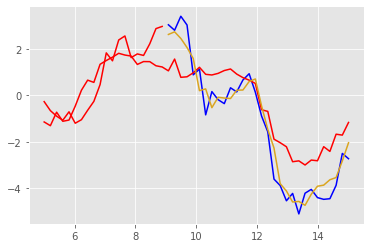

Epoch 333 batch 0 train Loss 0.0865 test Loss 0.1190 with training MSE metric 0.2554 and testing MSE metric 0.2936
learning rate is 0.0003000000142492354


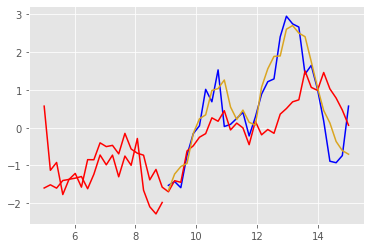

Epoch 333 batch 50 train Loss 0.1341 test Loss 0.1189 with training MSE metric 0.3167 and testing MSE metric 0.2997
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.212255001068115 secs



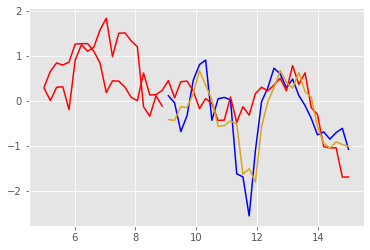

Epoch 334 batch 0 train Loss 0.1341 test Loss 0.1174 with training MSE metric 0.3149 and testing MSE metric 0.2946
learning rate is 0.0003000000142492354


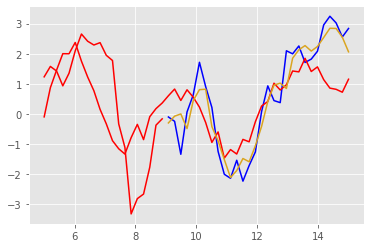

Epoch 334 batch 50 train Loss 0.1243 test Loss 0.1058 with training MSE metric 0.3066 and testing MSE metric 0.2815
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.198481798171997 secs



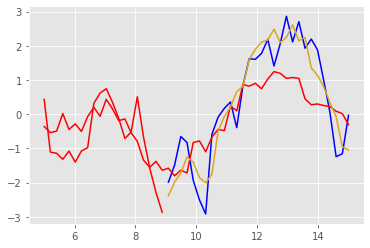

Epoch 335 batch 0 train Loss 0.1024 test Loss 0.1148 with training MSE metric 0.2802 and testing MSE metric 0.2929
learning rate is 0.0003000000142492354


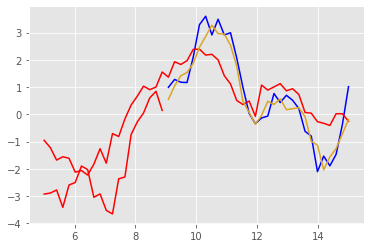

Epoch 335 batch 50 train Loss 0.1056 test Loss 0.1258 with training MSE metric 0.2825 and testing MSE metric 0.3058
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.395348072052002 secs



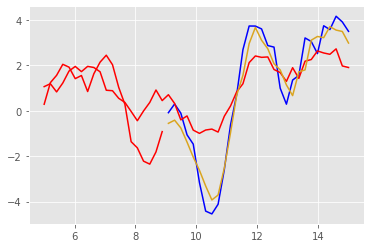

Epoch 336 batch 0 train Loss 0.1143 test Loss 0.0894 with training MSE metric 0.2924 and testing MSE metric 0.2626
learning rate is 0.0003000000142492354


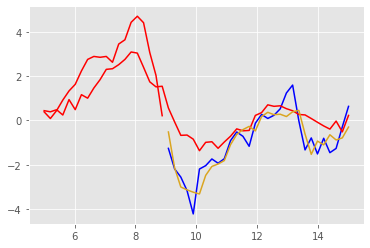

Epoch 336 batch 50 train Loss 0.1311 test Loss 0.1270 with training MSE metric 0.3144 and testing MSE metric 0.3078
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.261136054992676 secs



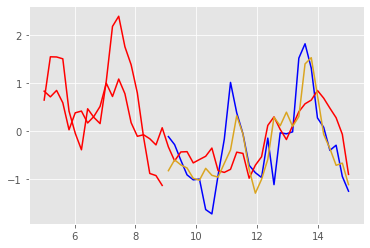

Epoch 337 batch 0 train Loss 0.1389 test Loss 0.1033 with training MSE metric 0.3240 and testing MSE metric 0.2795
learning rate is 0.0003000000142492354


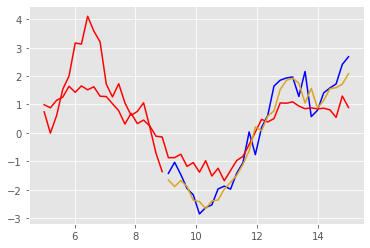

Epoch 337 batch 50 train Loss 0.1195 test Loss 0.0794 with training MSE metric 0.3010 and testing MSE metric 0.2520
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.07067584991455 secs



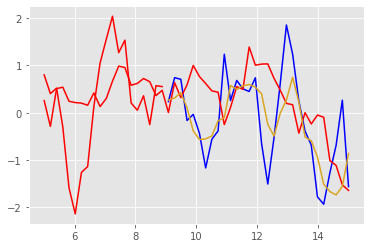

Epoch 338 batch 0 train Loss 0.1167 test Loss 0.1227 with training MSE metric 0.2979 and testing MSE metric 0.3023
learning rate is 0.0003000000142492354


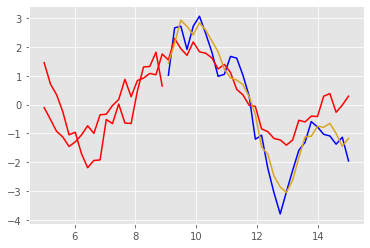

Epoch 338 batch 50 train Loss 0.1216 test Loss 0.1174 with training MSE metric 0.3044 and testing MSE metric 0.2988
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.010265827178955 secs



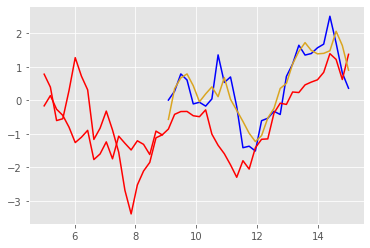

Epoch 339 batch 0 train Loss 0.1288 test Loss 0.1327 with training MSE metric 0.3100 and testing MSE metric 0.3145
learning rate is 0.0003000000142492354


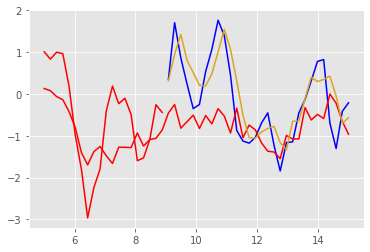

Epoch 339 batch 50 train Loss 0.1202 test Loss 0.1353 with training MSE metric 0.3010 and testing MSE metric 0.3173
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.992677688598633 secs



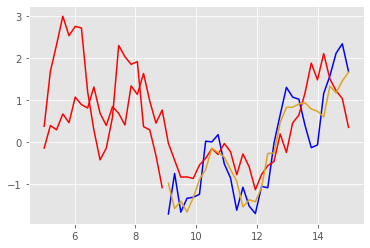

Epoch 340 batch 0 train Loss 0.1313 test Loss 0.1107 with training MSE metric 0.3129 and testing MSE metric 0.2896
learning rate is 0.0003000000142492354


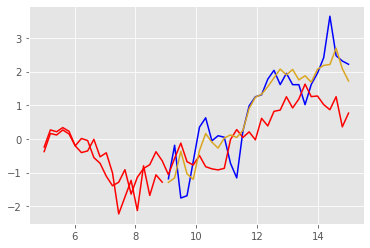

Epoch 340 batch 50 train Loss 0.1160 test Loss 0.0999 with training MSE metric 0.2947 and testing MSE metric 0.2736
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.500696182250977 secs



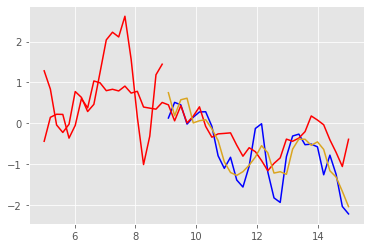

Epoch 341 batch 0 train Loss 0.1345 test Loss 0.1124 with training MSE metric 0.3145 and testing MSE metric 0.2898
learning rate is 0.0003000000142492354


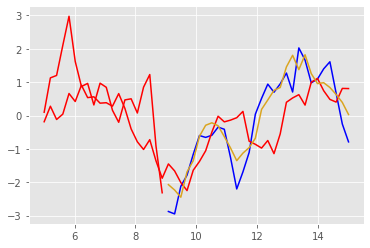

Epoch 341 batch 50 train Loss 0.1299 test Loss 0.1062 with training MSE metric 0.3130 and testing MSE metric 0.2837
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.146420001983643 secs



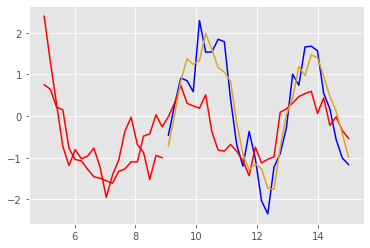

Epoch 342 batch 0 train Loss 0.1108 test Loss 0.0957 with training MSE metric 0.2891 and testing MSE metric 0.2729
learning rate is 0.0003000000142492354


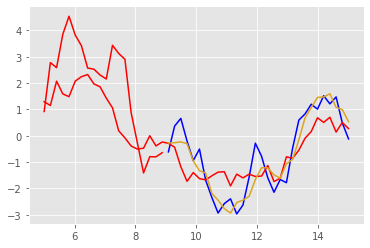

Epoch 342 batch 50 train Loss 0.1228 test Loss 0.1180 with training MSE metric 0.3025 and testing MSE metric 0.2963
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.116740226745605 secs



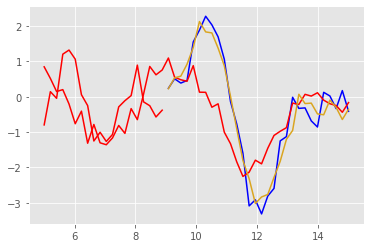

Epoch 343 batch 0 train Loss 0.1106 test Loss 0.1333 with training MSE metric 0.2897 and testing MSE metric 0.3140
learning rate is 0.0003000000142492354


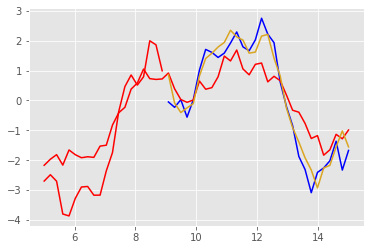

Epoch 343 batch 50 train Loss 0.1239 test Loss 0.0956 with training MSE metric 0.3051 and testing MSE metric 0.2693
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.091936111450195 secs



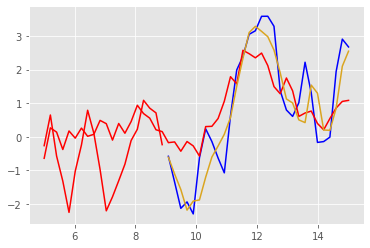

Epoch 344 batch 0 train Loss 0.1181 test Loss 0.1080 with training MSE metric 0.2967 and testing MSE metric 0.2849
learning rate is 0.0003000000142492354


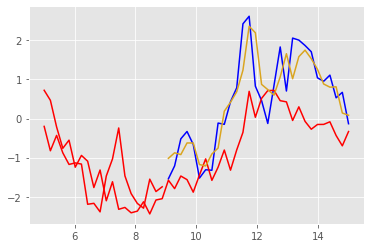

Epoch 344 batch 50 train Loss 0.1191 test Loss 0.0919 with training MSE metric 0.2984 and testing MSE metric 0.2655
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.207020044326782 secs



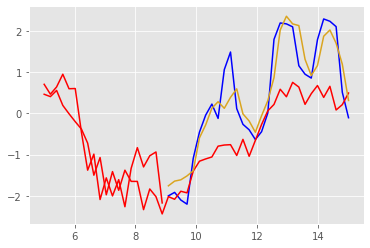

Epoch 345 batch 0 train Loss 0.1244 test Loss 0.1046 with training MSE metric 0.3041 and testing MSE metric 0.2794
learning rate is 0.0003000000142492354


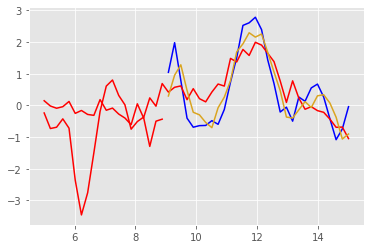

Epoch 345 batch 50 train Loss 0.1135 test Loss 0.0977 with training MSE metric 0.2898 and testing MSE metric 0.2711
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.525325059890747 secs



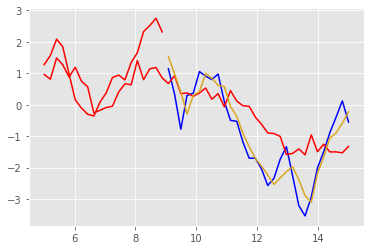

Epoch 346 batch 0 train Loss 0.1561 test Loss 0.1035 with training MSE metric 0.3406 and testing MSE metric 0.2811
learning rate is 0.0003000000142492354


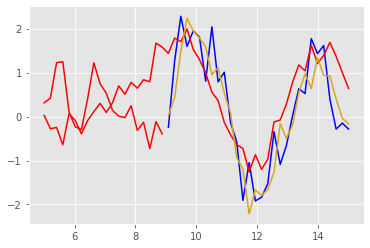

Epoch 346 batch 50 train Loss 0.1096 test Loss 0.1566 with training MSE metric 0.2856 and testing MSE metric 0.3398
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.667472839355469 secs



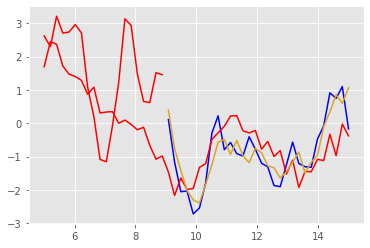

Epoch 347 batch 0 train Loss 0.1099 test Loss 0.0912 with training MSE metric 0.2903 and testing MSE metric 0.2654
learning rate is 0.0003000000142492354


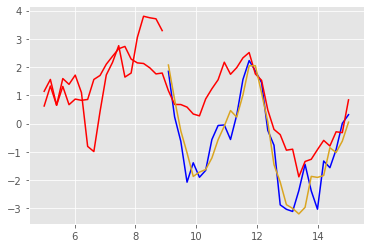

Epoch 347 batch 50 train Loss 0.1122 test Loss 0.1284 with training MSE metric 0.2900 and testing MSE metric 0.3085
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.51258397102356 secs



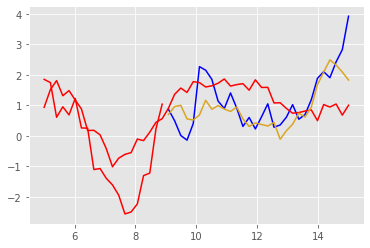

Epoch 348 batch 0 train Loss 0.1126 test Loss 0.0994 with training MSE metric 0.2899 and testing MSE metric 0.2778
learning rate is 0.0003000000142492354


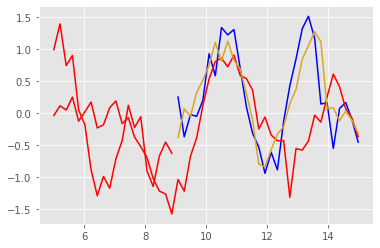

Epoch 348 batch 50 train Loss 0.1185 test Loss 0.0918 with training MSE metric 0.2993 and testing MSE metric 0.2670
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.54921293258667 secs



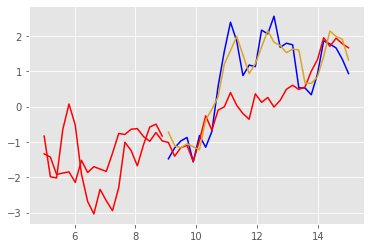

Epoch 349 batch 0 train Loss 0.1256 test Loss 0.1023 with training MSE metric 0.3055 and testing MSE metric 0.2777
learning rate is 0.0003000000142492354


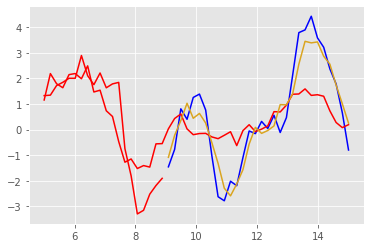

Epoch 349 batch 50 train Loss 0.1182 test Loss 0.1303 with training MSE metric 0.2966 and testing MSE metric 0.3112
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.534857034683228 secs



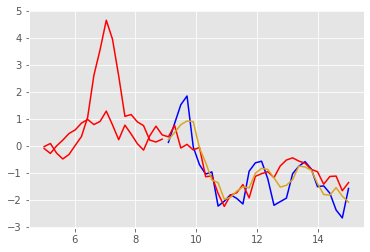

Epoch 350 batch 0 train Loss 0.1296 test Loss 0.1141 with training MSE metric 0.3124 and testing MSE metric 0.2917
learning rate is 0.0003000000142492354


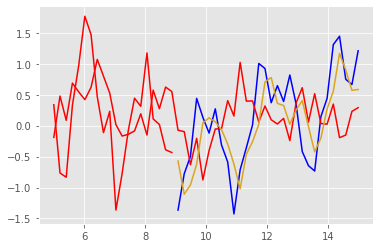

Epoch 350 batch 50 train Loss 0.1008 test Loss 0.0992 with training MSE metric 0.2775 and testing MSE metric 0.2771
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.569538116455078 secs



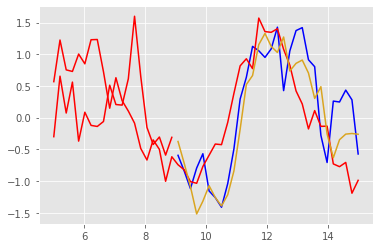

Epoch 351 batch 0 train Loss 0.1046 test Loss 0.0990 with training MSE metric 0.2785 and testing MSE metric 0.2733
learning rate is 0.0003000000142492354


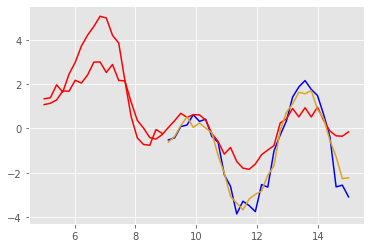

Epoch 351 batch 50 train Loss 0.1166 test Loss 0.1102 with training MSE metric 0.2974 and testing MSE metric 0.2871
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.498272895812988 secs



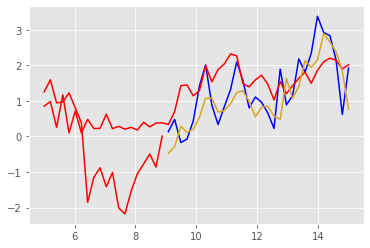

Epoch 352 batch 0 train Loss 0.1035 test Loss 0.1136 with training MSE metric 0.2839 and testing MSE metric 0.2923
learning rate is 0.0003000000142492354


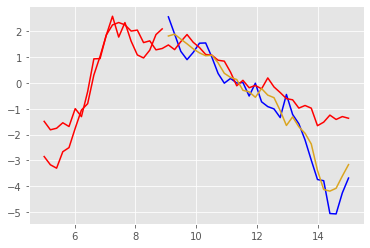

Epoch 352 batch 50 train Loss 0.1185 test Loss 0.1010 with training MSE metric 0.2986 and testing MSE metric 0.2793
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.483829021453857 secs



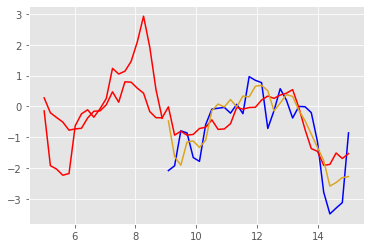

Epoch 353 batch 0 train Loss 0.0969 test Loss 0.1227 with training MSE metric 0.2743 and testing MSE metric 0.3022
learning rate is 0.0003000000142492354


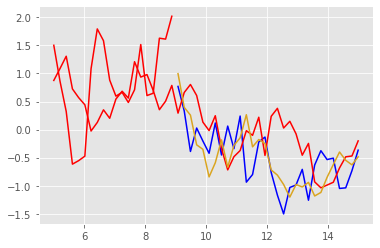

Epoch 353 batch 50 train Loss 0.1149 test Loss 0.0951 with training MSE metric 0.2953 and testing MSE metric 0.2692
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.528976917266846 secs



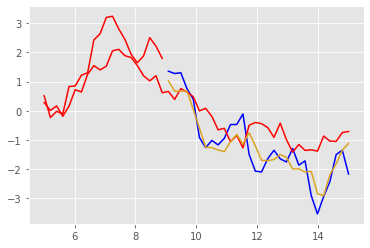

Epoch 354 batch 0 train Loss 0.0928 test Loss 0.1535 with training MSE metric 0.2666 and testing MSE metric 0.3376
learning rate is 0.0003000000142492354


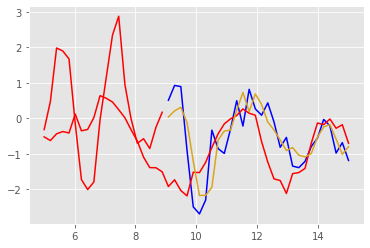

Epoch 354 batch 50 train Loss 0.1230 test Loss 0.1107 with training MSE metric 0.3018 and testing MSE metric 0.2898
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.348038911819458 secs



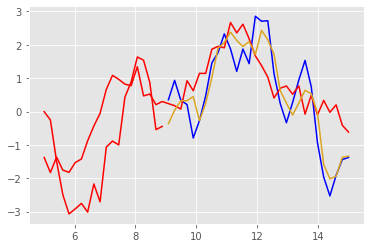

Epoch 355 batch 0 train Loss 0.1233 test Loss 0.1147 with training MSE metric 0.3041 and testing MSE metric 0.2907
learning rate is 0.0003000000142492354


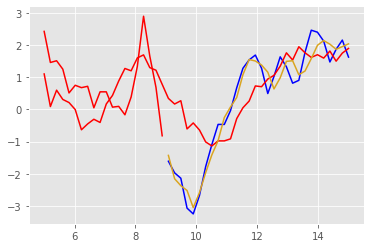

Epoch 355 batch 50 train Loss 0.1391 test Loss 0.1111 with training MSE metric 0.3244 and testing MSE metric 0.2900
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.358197212219238 secs



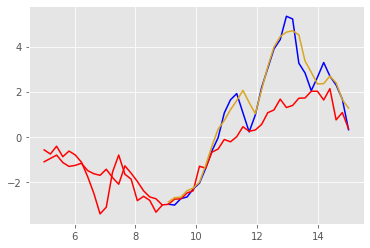

Epoch 356 batch 0 train Loss 0.1117 test Loss 0.1254 with training MSE metric 0.2903 and testing MSE metric 0.3087
learning rate is 0.0003000000142492354


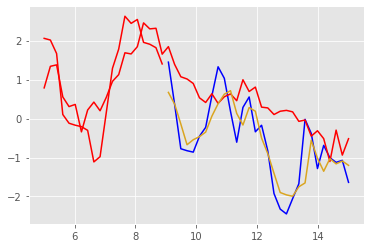

Epoch 356 batch 50 train Loss 0.1013 test Loss 0.0999 with training MSE metric 0.2790 and testing MSE metric 0.2784
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.608988046646118 secs



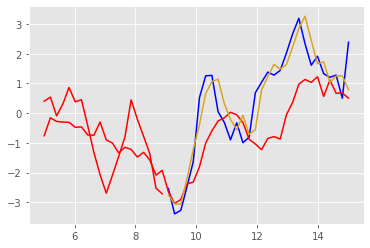

Epoch 357 batch 0 train Loss 0.1021 test Loss 0.1312 with training MSE metric 0.2788 and testing MSE metric 0.3132
learning rate is 0.0003000000142492354


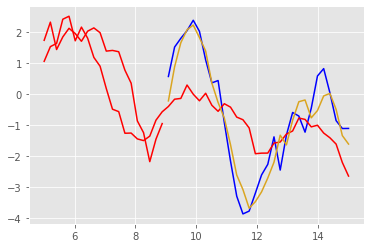

Epoch 357 batch 50 train Loss 0.1114 test Loss 0.1055 with training MSE metric 0.2891 and testing MSE metric 0.2815
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.571920156478882 secs



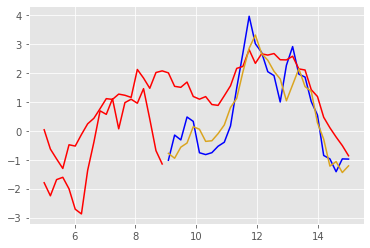

Epoch 358 batch 0 train Loss 0.1062 test Loss 0.1129 with training MSE metric 0.2853 and testing MSE metric 0.2928
learning rate is 0.0003000000142492354


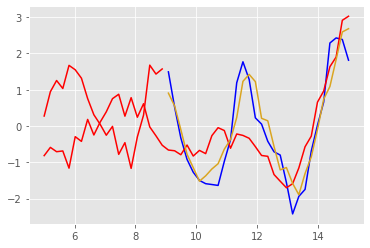

Epoch 358 batch 50 train Loss 0.1009 test Loss 0.1391 with training MSE metric 0.2800 and testing MSE metric 0.3205
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.555515050888062 secs



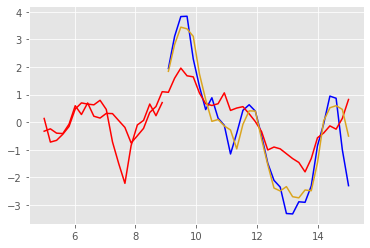

Epoch 359 batch 0 train Loss 0.1156 test Loss 0.1126 with training MSE metric 0.2982 and testing MSE metric 0.2938
learning rate is 0.0003000000142492354


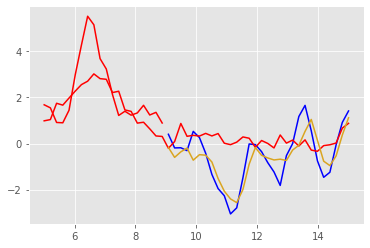

Epoch 359 batch 50 train Loss 0.1057 test Loss 0.1225 with training MSE metric 0.2839 and testing MSE metric 0.2998
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.22851824760437 secs



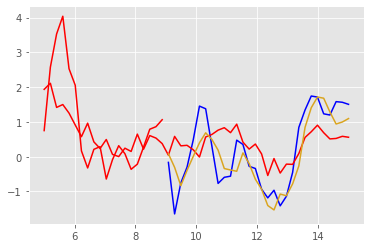

Epoch 360 batch 0 train Loss 0.1057 test Loss 0.1403 with training MSE metric 0.2874 and testing MSE metric 0.3213
learning rate is 0.0003000000142492354


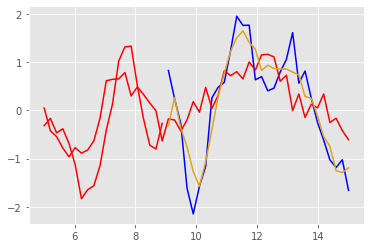

Epoch 360 batch 50 train Loss 0.1358 test Loss 0.1189 with training MSE metric 0.3209 and testing MSE metric 0.2971
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.140461921691895 secs



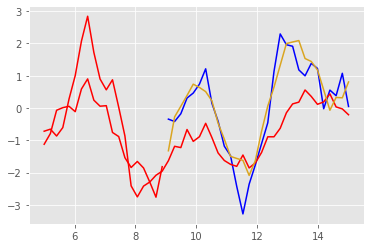

Epoch 361 batch 0 train Loss 0.1180 test Loss 0.1062 with training MSE metric 0.2985 and testing MSE metric 0.2835
learning rate is 0.0003000000142492354


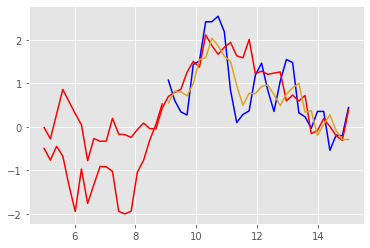

Epoch 361 batch 50 train Loss 0.1246 test Loss 0.1102 with training MSE metric 0.3061 and testing MSE metric 0.2858
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.147698163986206 secs



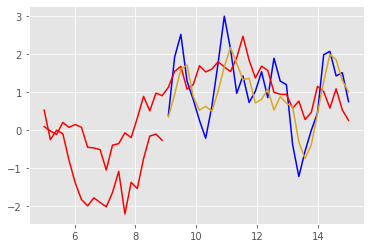

Epoch 362 batch 0 train Loss 0.1117 test Loss 0.1153 with training MSE metric 0.2913 and testing MSE metric 0.2910
learning rate is 0.0003000000142492354


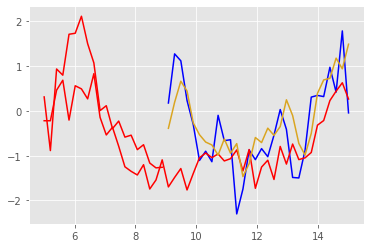

Epoch 362 batch 50 train Loss 0.1233 test Loss 0.0915 with training MSE metric 0.3074 and testing MSE metric 0.2663
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.074400186538696 secs



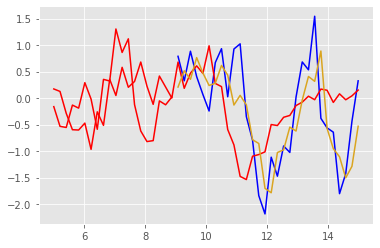

Epoch 363 batch 0 train Loss 0.1148 test Loss 0.1135 with training MSE metric 0.2922 and testing MSE metric 0.2915
learning rate is 0.0003000000142492354


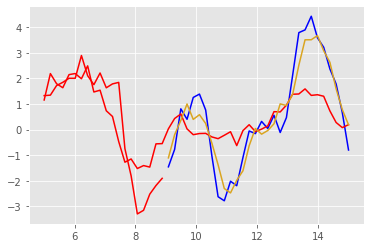

Epoch 363 batch 50 train Loss 0.1214 test Loss 0.1173 with training MSE metric 0.3031 and testing MSE metric 0.2964
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.933380126953125 secs



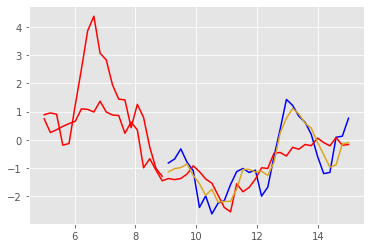

Epoch 364 batch 0 train Loss 0.1125 test Loss 0.1150 with training MSE metric 0.2888 and testing MSE metric 0.2974
learning rate is 0.0003000000142492354


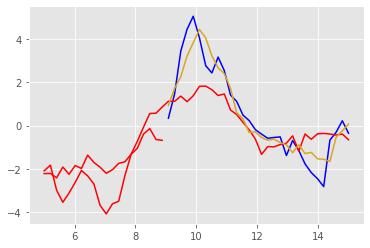

Epoch 364 batch 50 train Loss 0.1210 test Loss 0.1188 with training MSE metric 0.3036 and testing MSE metric 0.2955
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.678412199020386 secs



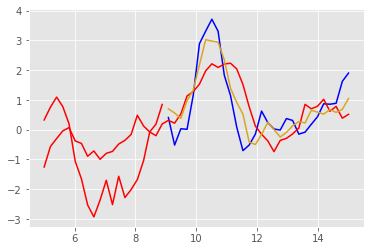

Epoch 365 batch 0 train Loss 0.1268 test Loss 0.0858 with training MSE metric 0.3097 and testing MSE metric 0.2603
learning rate is 0.0003000000142492354


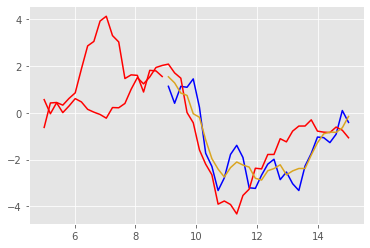

Epoch 365 batch 50 train Loss 0.0989 test Loss 0.1104 with training MSE metric 0.2716 and testing MSE metric 0.2886
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.726546049118042 secs



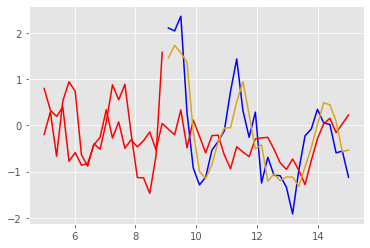

Epoch 366 batch 0 train Loss 0.1130 test Loss 0.1170 with training MSE metric 0.2916 and testing MSE metric 0.2969
learning rate is 0.0003000000142492354


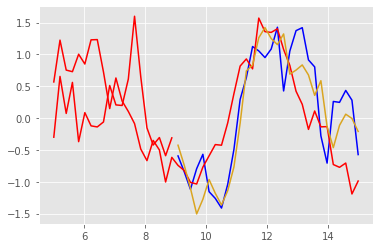

Epoch 366 batch 50 train Loss 0.1310 test Loss 0.1090 with training MSE metric 0.3110 and testing MSE metric 0.2853
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.073292970657349 secs



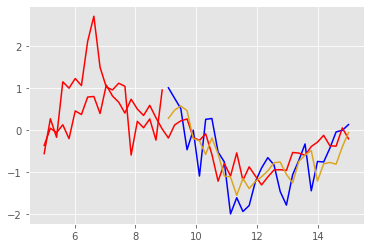

Epoch 367 batch 0 train Loss 0.0930 test Loss 0.1234 with training MSE metric 0.2709 and testing MSE metric 0.3058
learning rate is 0.0003000000142492354


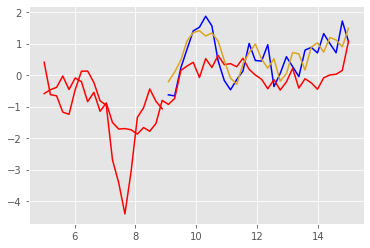

Epoch 367 batch 50 train Loss 0.1146 test Loss 0.1125 with training MSE metric 0.2929 and testing MSE metric 0.2875
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.069391012191772 secs



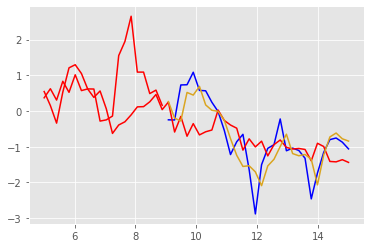

Epoch 368 batch 0 train Loss 0.1083 test Loss 0.1165 with training MSE metric 0.2870 and testing MSE metric 0.2953
learning rate is 0.0003000000142492354


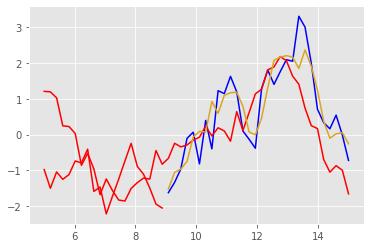

Epoch 368 batch 50 train Loss 0.1217 test Loss 0.1087 with training MSE metric 0.3071 and testing MSE metric 0.2882
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.105077981948853 secs



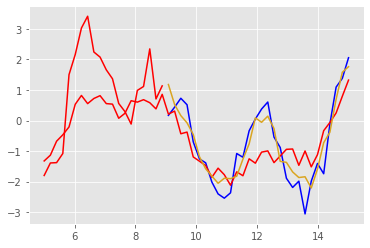

Epoch 369 batch 0 train Loss 0.1231 test Loss 0.0800 with training MSE metric 0.3047 and testing MSE metric 0.2541
learning rate is 0.0003000000142492354


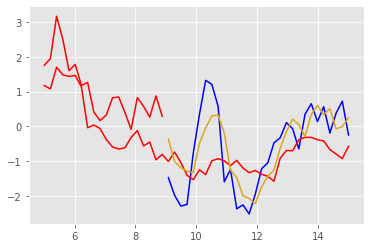

Epoch 369 batch 50 train Loss 0.1184 test Loss 0.0951 with training MSE metric 0.2991 and testing MSE metric 0.2731
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.178745985031128 secs



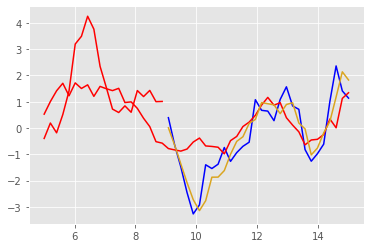

Epoch 370 batch 0 train Loss 0.1207 test Loss 0.0963 with training MSE metric 0.3020 and testing MSE metric 0.2708
learning rate is 0.0003000000142492354


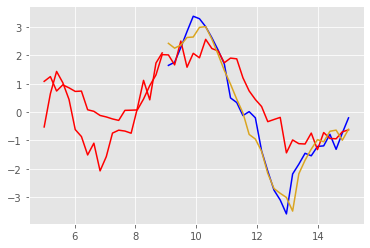

Epoch 370 batch 50 train Loss 0.1193 test Loss 0.1210 with training MSE metric 0.2991 and testing MSE metric 0.3003
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.094064950942993 secs



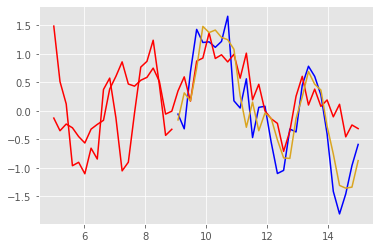

Epoch 371 batch 0 train Loss 0.1281 test Loss 0.1170 with training MSE metric 0.3087 and testing MSE metric 0.2970
learning rate is 0.0003000000142492354


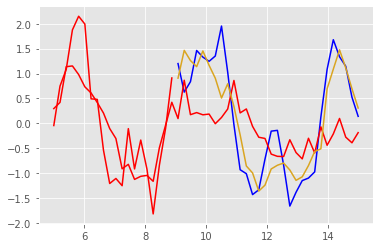

Epoch 371 batch 50 train Loss 0.1317 test Loss 0.0945 with training MSE metric 0.3100 and testing MSE metric 0.2695
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.102603912353516 secs



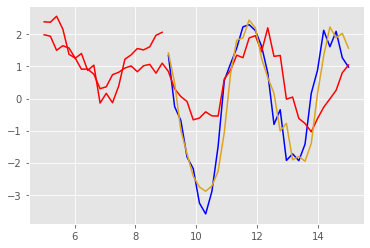

Epoch 372 batch 0 train Loss 0.0782 test Loss 0.1346 with training MSE metric 0.2524 and testing MSE metric 0.3157
learning rate is 0.0003000000142492354


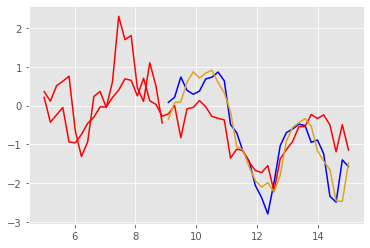

Epoch 372 batch 50 train Loss 0.0995 test Loss 0.1141 with training MSE metric 0.2737 and testing MSE metric 0.2949
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.145188093185425 secs



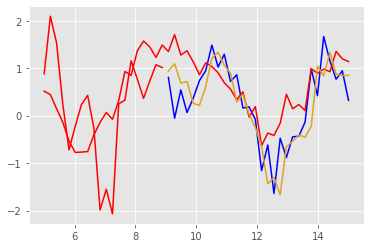

Epoch 373 batch 0 train Loss 0.1157 test Loss 0.1157 with training MSE metric 0.2971 and testing MSE metric 0.2952
learning rate is 0.0003000000142492354


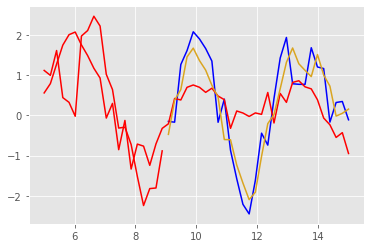

Epoch 373 batch 50 train Loss 0.0973 test Loss 0.1105 with training MSE metric 0.2728 and testing MSE metric 0.2895
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.151349067687988 secs



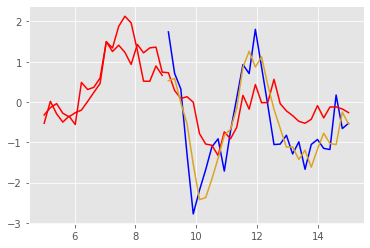

Epoch 374 batch 0 train Loss 0.1038 test Loss 0.1182 with training MSE metric 0.2790 and testing MSE metric 0.2946
learning rate is 0.0003000000142492354


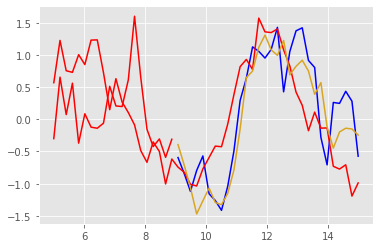

Epoch 374 batch 50 train Loss 0.1161 test Loss 0.0937 with training MSE metric 0.2977 and testing MSE metric 0.2715
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.111146211624146 secs



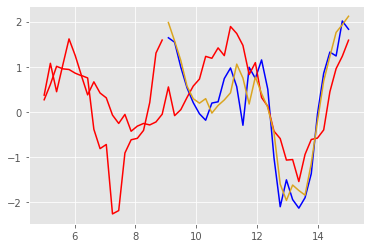

Epoch 375 batch 0 train Loss 0.1193 test Loss 0.1074 with training MSE metric 0.2986 and testing MSE metric 0.2835
learning rate is 0.0003000000142492354


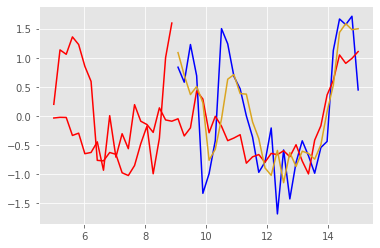

Epoch 375 batch 50 train Loss 0.1425 test Loss 0.1027 with training MSE metric 0.3280 and testing MSE metric 0.2777
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.122514963150024 secs



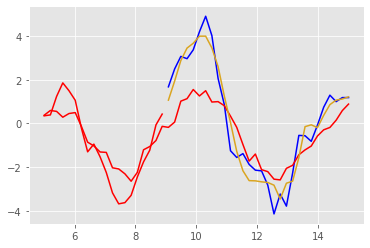

Epoch 376 batch 0 train Loss 0.1270 test Loss 0.1197 with training MSE metric 0.3102 and testing MSE metric 0.2979
learning rate is 0.0003000000142492354


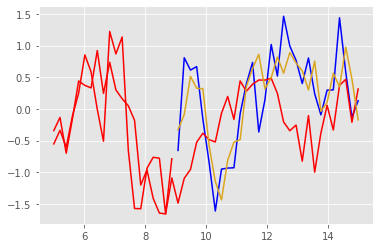

Epoch 376 batch 50 train Loss 0.1136 test Loss 0.1024 with training MSE metric 0.2939 and testing MSE metric 0.2775
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.100757360458374 secs



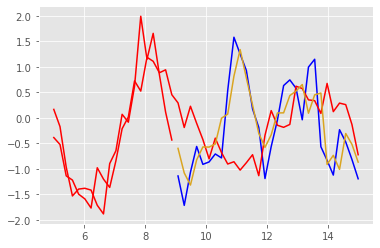

Epoch 377 batch 0 train Loss 0.1168 test Loss 0.1040 with training MSE metric 0.2951 and testing MSE metric 0.2844
learning rate is 0.0003000000142492354


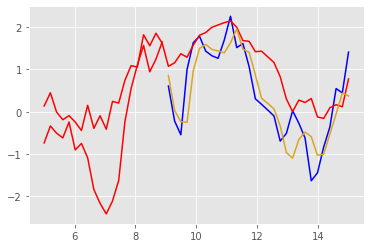

Epoch 377 batch 50 train Loss 0.1122 test Loss 0.1191 with training MSE metric 0.2891 and testing MSE metric 0.2978
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.107100009918213 secs



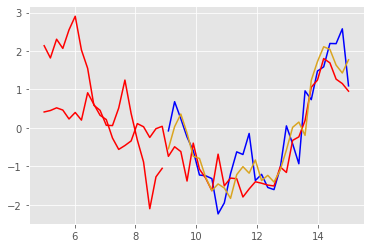

Epoch 378 batch 0 train Loss 0.1099 test Loss 0.1117 with training MSE metric 0.2873 and testing MSE metric 0.2894
learning rate is 0.0003000000142492354


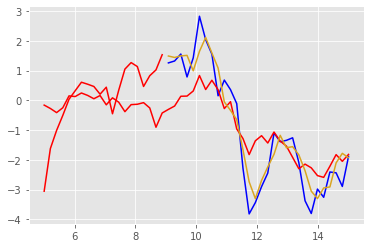

Epoch 378 batch 50 train Loss 0.1044 test Loss 0.0987 with training MSE metric 0.2848 and testing MSE metric 0.2734
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.154159784317017 secs



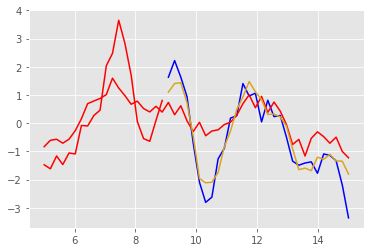

Epoch 379 batch 0 train Loss 0.1323 test Loss 0.1263 with training MSE metric 0.3166 and testing MSE metric 0.3069
learning rate is 0.0003000000142492354


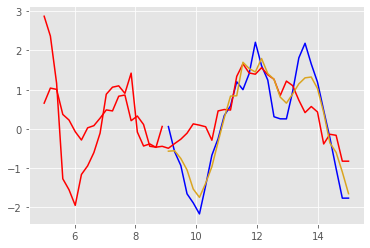

Epoch 379 batch 50 train Loss 0.1046 test Loss 0.1033 with training MSE metric 0.2809 and testing MSE metric 0.2805
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.142307996749878 secs



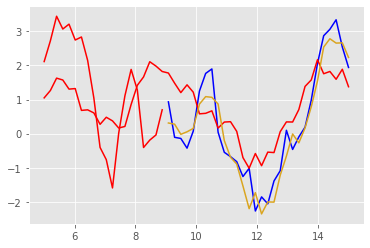

Epoch 380 batch 0 train Loss 0.1008 test Loss 0.1107 with training MSE metric 0.2774 and testing MSE metric 0.2881
learning rate is 0.0003000000142492354


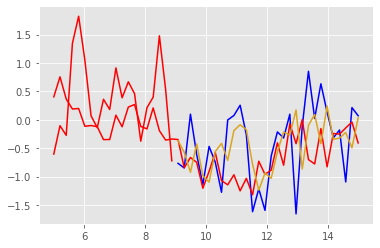

Epoch 380 batch 50 train Loss 0.1015 test Loss 0.1075 with training MSE metric 0.2749 and testing MSE metric 0.2845
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.247383117675781 secs



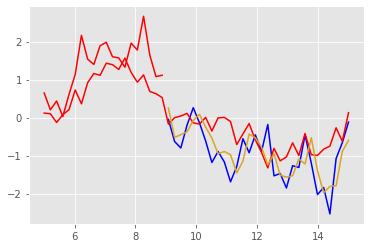

Epoch 381 batch 0 train Loss 0.1082 test Loss 0.1196 with training MSE metric 0.2866 and testing MSE metric 0.2994
learning rate is 0.0003000000142492354


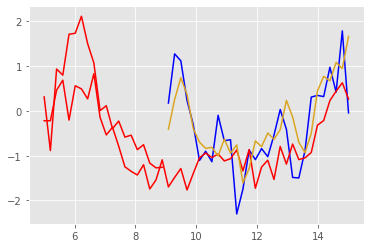

Epoch 381 batch 50 train Loss 0.1236 test Loss 0.1183 with training MSE metric 0.3035 and testing MSE metric 0.2981
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.038216829299927 secs



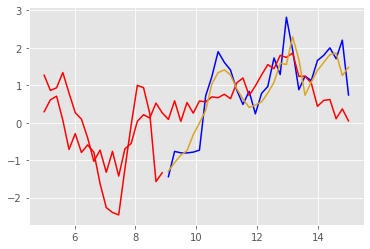

Epoch 382 batch 0 train Loss 0.1173 test Loss 0.1086 with training MSE metric 0.2998 and testing MSE metric 0.2876
learning rate is 0.0003000000142492354


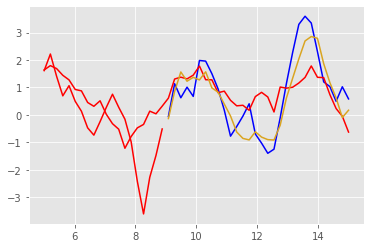

Epoch 382 batch 50 train Loss 0.1246 test Loss 0.1024 with training MSE metric 0.3054 and testing MSE metric 0.2767
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.058777093887329 secs



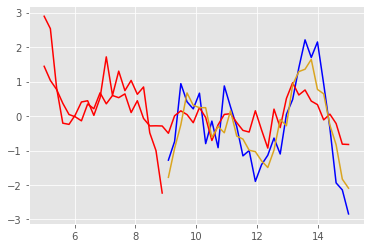

Epoch 383 batch 0 train Loss 0.1246 test Loss 0.1315 with training MSE metric 0.3076 and testing MSE metric 0.3157
learning rate is 0.0003000000142492354


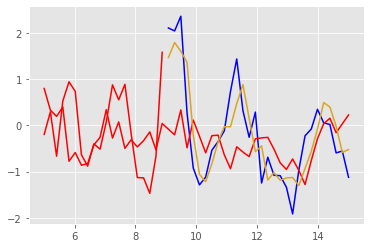

Epoch 383 batch 50 train Loss 0.0973 test Loss 0.1354 with training MSE metric 0.2741 and testing MSE metric 0.3143
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.166237831115723 secs



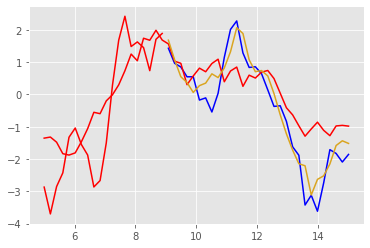

Epoch 384 batch 0 train Loss 0.1237 test Loss 0.0991 with training MSE metric 0.3062 and testing MSE metric 0.2761
learning rate is 0.0003000000142492354


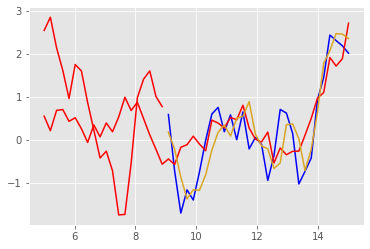

Epoch 384 batch 50 train Loss 0.1173 test Loss 0.1119 with training MSE metric 0.2950 and testing MSE metric 0.2881
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.102089166641235 secs



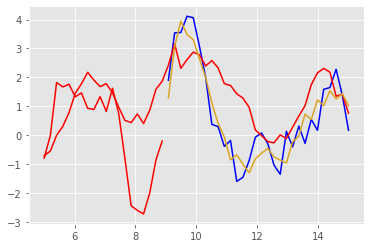

Epoch 385 batch 0 train Loss 0.1105 test Loss 0.1463 with training MSE metric 0.2874 and testing MSE metric 0.3287
learning rate is 0.0003000000142492354


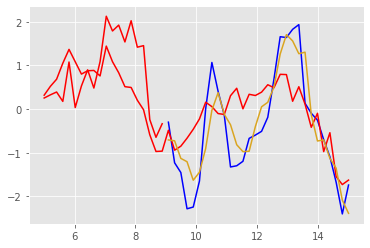

Epoch 385 batch 50 train Loss 0.1061 test Loss 0.1043 with training MSE metric 0.2833 and testing MSE metric 0.2812
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.140804290771484 secs



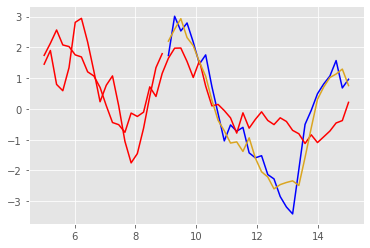

Epoch 386 batch 0 train Loss 0.1146 test Loss 0.0837 with training MSE metric 0.2926 and testing MSE metric 0.2553
learning rate is 0.0003000000142492354


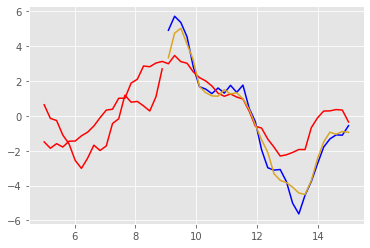

Epoch 386 batch 50 train Loss 0.1198 test Loss 0.0960 with training MSE metric 0.2991 and testing MSE metric 0.2697
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.074488162994385 secs



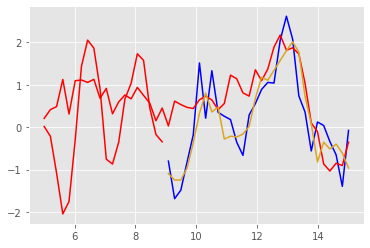

Epoch 387 batch 0 train Loss 0.1425 test Loss 0.1271 with training MSE metric 0.3276 and testing MSE metric 0.3060
learning rate is 0.0003000000142492354


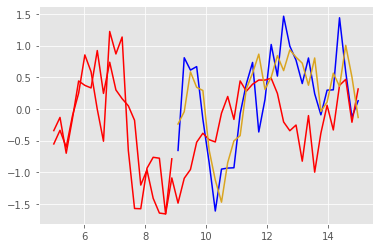

Epoch 387 batch 50 train Loss 0.1223 test Loss 0.1088 with training MSE metric 0.3034 and testing MSE metric 0.2864
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.170156955718994 secs



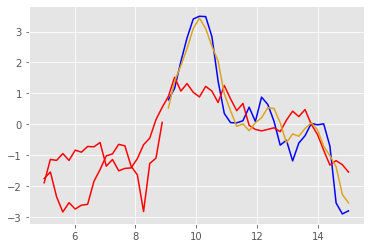

Epoch 388 batch 0 train Loss 0.1223 test Loss 0.1177 with training MSE metric 0.3044 and testing MSE metric 0.2978
learning rate is 0.0003000000142492354


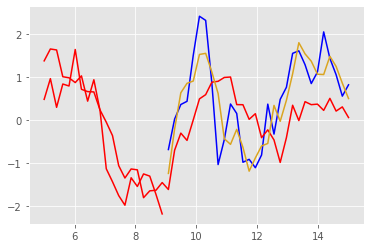

Epoch 388 batch 50 train Loss 0.1106 test Loss 0.1280 with training MSE metric 0.2894 and testing MSE metric 0.3107
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.130892038345337 secs



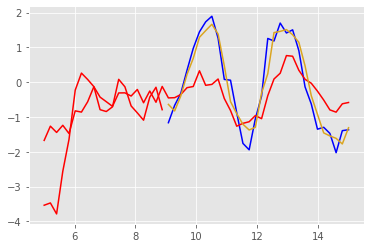

Epoch 389 batch 0 train Loss 0.1418 test Loss 0.1006 with training MSE metric 0.3263 and testing MSE metric 0.2755
learning rate is 0.0003000000142492354


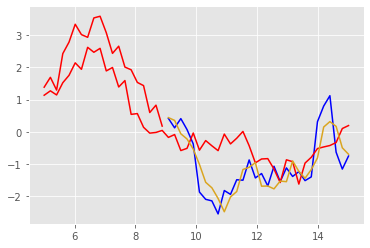

Epoch 389 batch 50 train Loss 0.1237 test Loss 0.1058 with training MSE metric 0.3066 and testing MSE metric 0.2807
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.08220386505127 secs



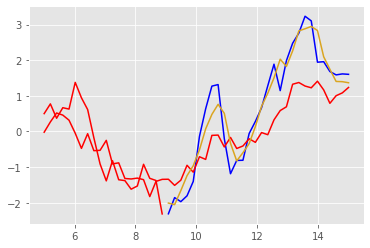

Epoch 390 batch 0 train Loss 0.1374 test Loss 0.0934 with training MSE metric 0.3193 and testing MSE metric 0.2653
learning rate is 0.0003000000142492354


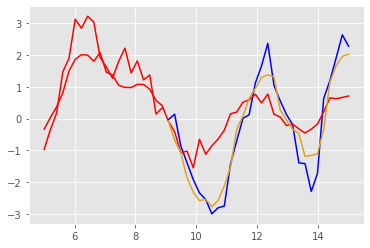

Epoch 390 batch 50 train Loss 0.0991 test Loss 0.1146 with training MSE metric 0.2750 and testing MSE metric 0.2940
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.107553958892822 secs



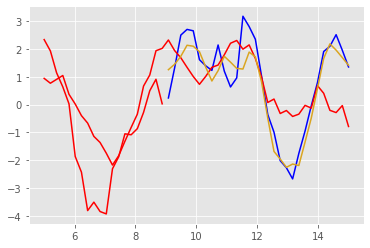

Epoch 391 batch 0 train Loss 0.1048 test Loss 0.1036 with training MSE metric 0.2865 and testing MSE metric 0.2796
learning rate is 0.0003000000142492354


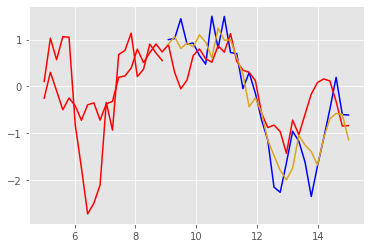

Epoch 391 batch 50 train Loss 0.1117 test Loss 0.0992 with training MSE metric 0.2912 and testing MSE metric 0.2749
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.102108240127563 secs



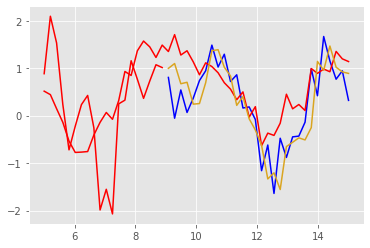

Epoch 392 batch 0 train Loss 0.1110 test Loss 0.1404 with training MSE metric 0.2915 and testing MSE metric 0.3238
learning rate is 0.0003000000142492354


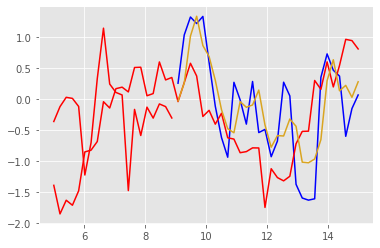

Epoch 392 batch 50 train Loss 0.1343 test Loss 0.0996 with training MSE metric 0.3144 and testing MSE metric 0.2750
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.073099136352539 secs



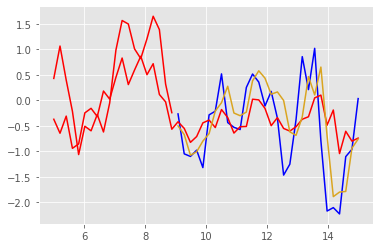

Epoch 393 batch 0 train Loss 0.1198 test Loss 0.1323 with training MSE metric 0.2999 and testing MSE metric 0.3154
learning rate is 0.0003000000142492354


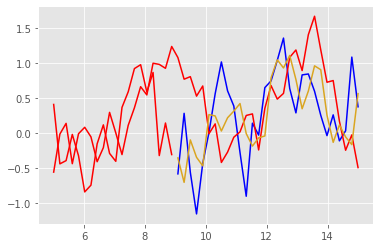

Epoch 393 batch 50 train Loss 0.1388 test Loss 0.1221 with training MSE metric 0.3198 and testing MSE metric 0.3033
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.116941928863525 secs



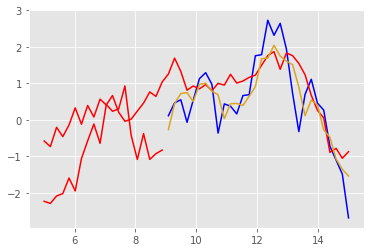

Epoch 394 batch 0 train Loss 0.1209 test Loss 0.1096 with training MSE metric 0.3002 and testing MSE metric 0.2900
learning rate is 0.0003000000142492354


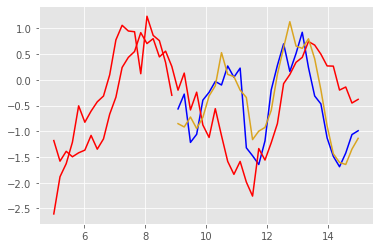

Epoch 394 batch 50 train Loss 0.1177 test Loss 0.0873 with training MSE metric 0.2962 and testing MSE metric 0.2620
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.058351993560791 secs



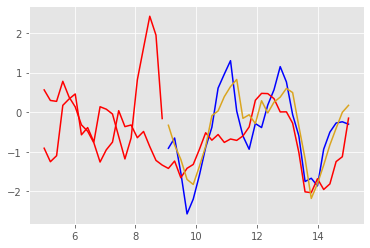

Epoch 395 batch 0 train Loss 0.1136 test Loss 0.1177 with training MSE metric 0.2904 and testing MSE metric 0.2958
learning rate is 0.0003000000142492354


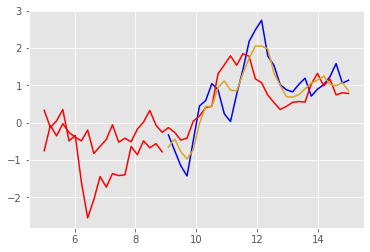

Epoch 395 batch 50 train Loss 0.1288 test Loss 0.0978 with training MSE metric 0.3110 and testing MSE metric 0.2730
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.080090999603271 secs



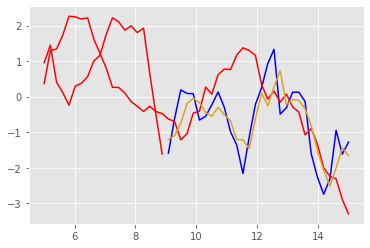

Epoch 396 batch 0 train Loss 0.1142 test Loss 0.1089 with training MSE metric 0.2944 and testing MSE metric 0.2859
learning rate is 0.0003000000142492354


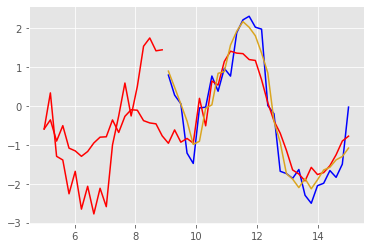

Epoch 396 batch 50 train Loss 0.1093 test Loss 0.1127 with training MSE metric 0.2874 and testing MSE metric 0.2904
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.884450197219849 secs



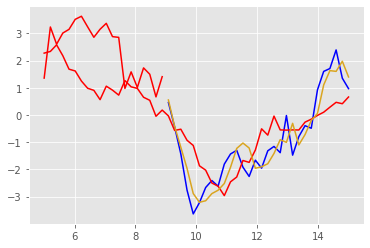

Epoch 397 batch 0 train Loss 0.1215 test Loss 0.1051 with training MSE metric 0.3025 and testing MSE metric 0.2852
learning rate is 0.0003000000142492354


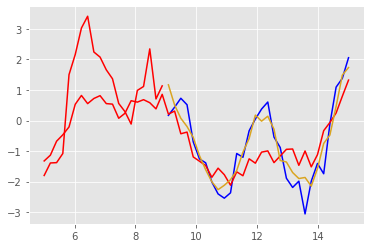

Epoch 397 batch 50 train Loss 0.0965 test Loss 0.0909 with training MSE metric 0.2729 and testing MSE metric 0.2638
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.854055166244507 secs



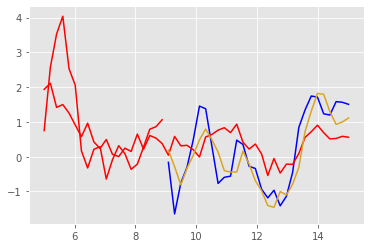

Epoch 398 batch 0 train Loss 0.1229 test Loss 0.1226 with training MSE metric 0.3014 and testing MSE metric 0.2999
learning rate is 0.0003000000142492354


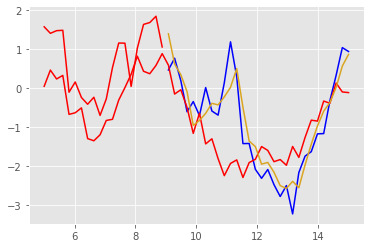

Epoch 398 batch 50 train Loss 0.1246 test Loss 0.1098 with training MSE metric 0.3038 and testing MSE metric 0.2845
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.677073240280151 secs



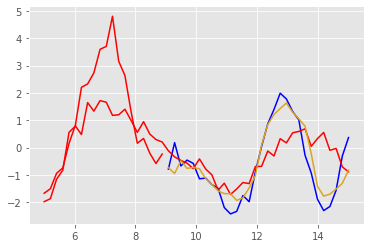

Epoch 399 batch 0 train Loss 0.1122 test Loss 0.1185 with training MSE metric 0.2866 and testing MSE metric 0.2996
learning rate is 0.0003000000142492354


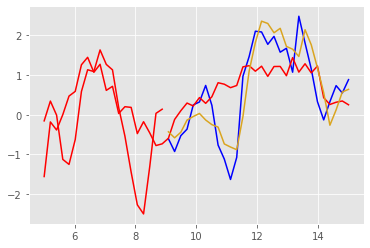

Epoch 399 batch 50 train Loss 0.1079 test Loss 0.1045 with training MSE metric 0.2865 and testing MSE metric 0.2817
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.744930028915405 secs



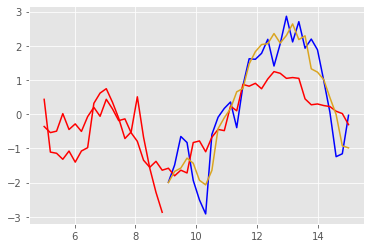

Epoch 400 batch 0 train Loss 0.1400 test Loss 0.1030 with training MSE metric 0.3213 and testing MSE metric 0.2804
learning rate is 0.0003000000142492354


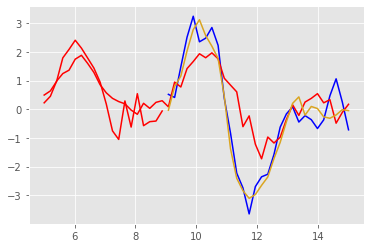

Epoch 400 batch 50 train Loss 0.1044 test Loss 0.1255 with training MSE metric 0.2810 and testing MSE metric 0.3064
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.074542045593262 secs



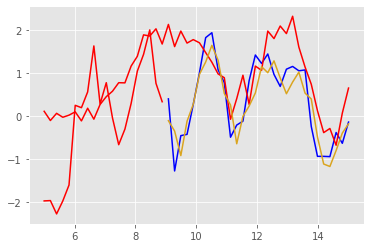

Epoch 401 batch 0 train Loss 0.1161 test Loss 0.1108 with training MSE metric 0.2939 and testing MSE metric 0.2879
learning rate is 0.0003000000142492354


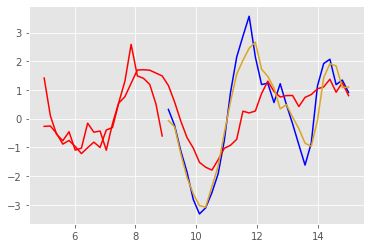

Epoch 401 batch 50 train Loss 0.1203 test Loss 0.1256 with training MSE metric 0.3010 and testing MSE metric 0.3085
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.103413105010986 secs



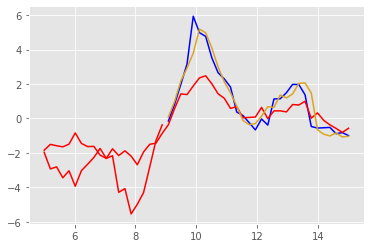

Epoch 402 batch 0 train Loss 0.1176 test Loss 0.0958 with training MSE metric 0.2973 and testing MSE metric 0.2699
learning rate is 0.0003000000142492354


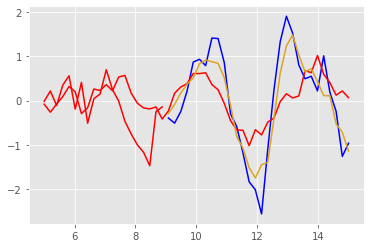

Epoch 402 batch 50 train Loss 0.0940 test Loss 0.1007 with training MSE metric 0.2699 and testing MSE metric 0.2760
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.09291386604309 secs



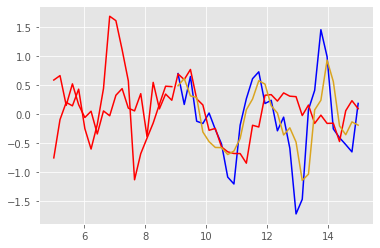

Epoch 403 batch 0 train Loss 0.1177 test Loss 0.1073 with training MSE metric 0.2959 and testing MSE metric 0.2857
learning rate is 0.0003000000142492354


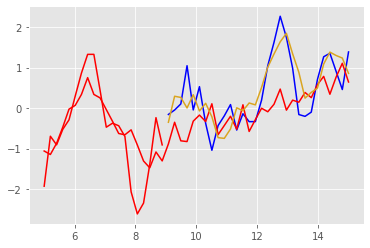

Epoch 403 batch 50 train Loss 0.1021 test Loss 0.1161 with training MSE metric 0.2799 and testing MSE metric 0.2938
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.07325792312622 secs



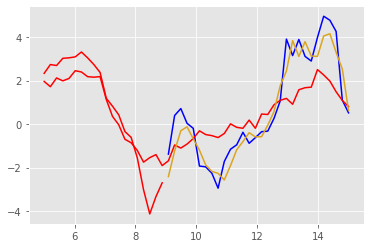

Epoch 404 batch 0 train Loss 0.1147 test Loss 0.1167 with training MSE metric 0.2924 and testing MSE metric 0.2942
learning rate is 0.0003000000142492354


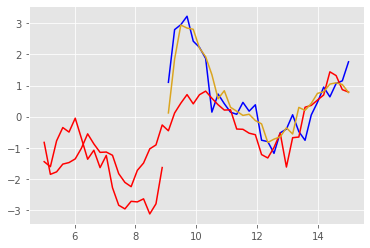

Epoch 404 batch 50 train Loss 0.1122 test Loss 0.1083 with training MSE metric 0.2936 and testing MSE metric 0.2867
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.168892860412598 secs



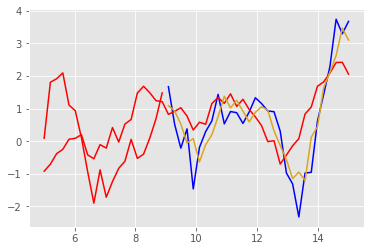

Epoch 405 batch 0 train Loss 0.0853 test Loss 0.1108 with training MSE metric 0.2591 and testing MSE metric 0.2909
learning rate is 0.0003000000142492354


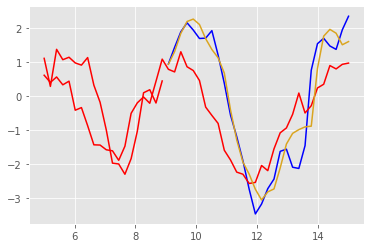

Epoch 405 batch 50 train Loss 0.1259 test Loss 0.1103 with training MSE metric 0.3083 and testing MSE metric 0.2894
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.090858936309814 secs



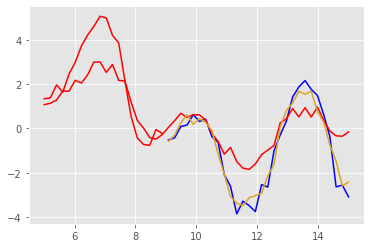

Epoch 406 batch 0 train Loss 0.1050 test Loss 0.0836 with training MSE metric 0.2824 and testing MSE metric 0.2582
learning rate is 0.0003000000142492354


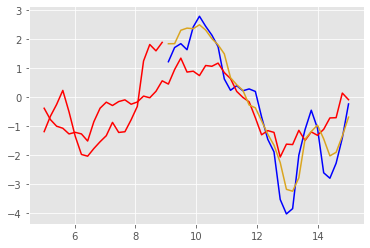

Epoch 406 batch 50 train Loss 0.1100 test Loss 0.1109 with training MSE metric 0.2903 and testing MSE metric 0.2888
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.076260805130005 secs



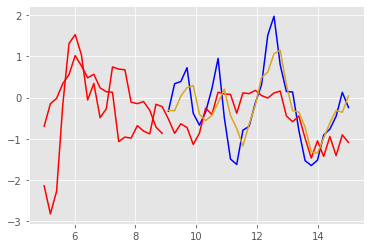

Epoch 407 batch 0 train Loss 0.1030 test Loss 0.0998 with training MSE metric 0.2813 and testing MSE metric 0.2776
learning rate is 0.0003000000142492354


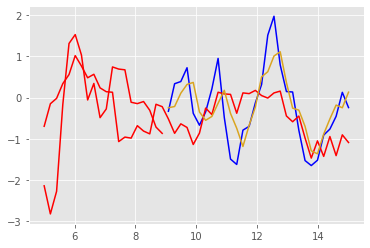

Epoch 407 batch 50 train Loss 0.0974 test Loss 0.1106 with training MSE metric 0.2705 and testing MSE metric 0.2893
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.108675003051758 secs



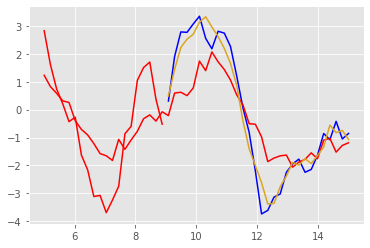

Epoch 408 batch 0 train Loss 0.1226 test Loss 0.1359 with training MSE metric 0.3042 and testing MSE metric 0.3140
learning rate is 0.0003000000142492354


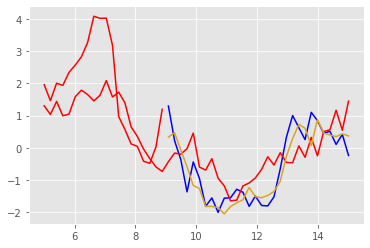

Epoch 408 batch 50 train Loss 0.1133 test Loss 0.0865 with training MSE metric 0.2951 and testing MSE metric 0.2582
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.100675106048584 secs



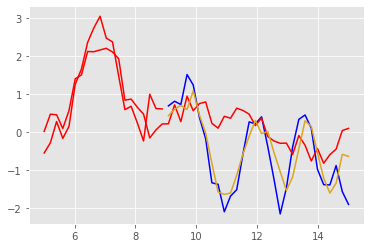

Epoch 409 batch 0 train Loss 0.1053 test Loss 0.0850 with training MSE metric 0.2816 and testing MSE metric 0.2579
learning rate is 0.0003000000142492354


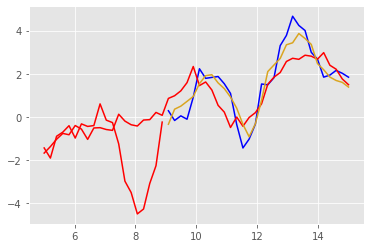

Epoch 409 batch 50 train Loss 0.1268 test Loss 0.0992 with training MSE metric 0.3094 and testing MSE metric 0.2718
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.038141012191772 secs



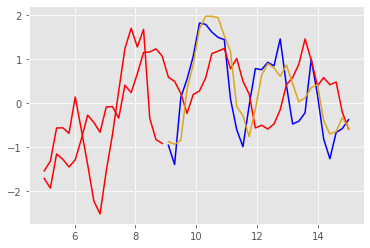

Epoch 410 batch 0 train Loss 0.1164 test Loss 0.1082 with training MSE metric 0.2940 and testing MSE metric 0.2817
learning rate is 0.0003000000142492354


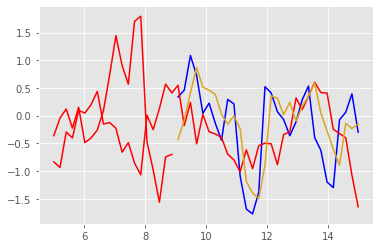

Epoch 410 batch 50 train Loss 0.0945 test Loss 0.1094 with training MSE metric 0.2700 and testing MSE metric 0.2870
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.897124767303467 secs



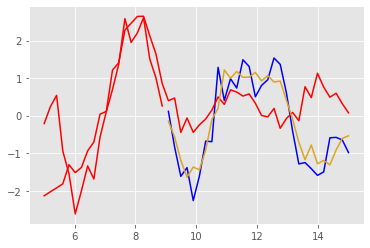

Epoch 411 batch 0 train Loss 0.1189 test Loss 0.1198 with training MSE metric 0.2993 and testing MSE metric 0.2991
learning rate is 0.0003000000142492354


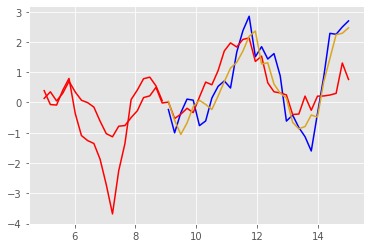

Epoch 411 batch 50 train Loss 0.1060 test Loss 0.1105 with training MSE metric 0.2825 and testing MSE metric 0.2896
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.664510250091553 secs



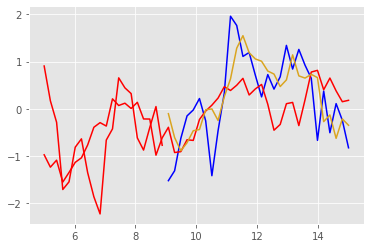

Epoch 412 batch 0 train Loss 0.1222 test Loss 0.1111 with training MSE metric 0.3024 and testing MSE metric 0.2880
learning rate is 0.0003000000142492354


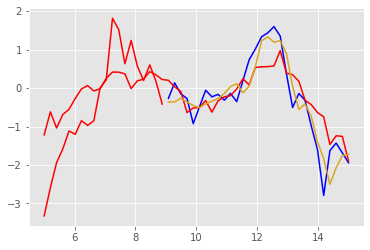

Epoch 412 batch 50 train Loss 0.1343 test Loss 0.1081 with training MSE metric 0.3184 and testing MSE metric 0.2871
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.701323986053467 secs



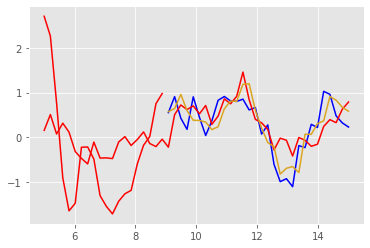

Epoch 413 batch 0 train Loss 0.1041 test Loss 0.0932 with training MSE metric 0.2814 and testing MSE metric 0.2687
learning rate is 0.0003000000142492354


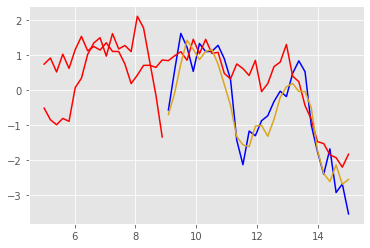

Epoch 413 batch 50 train Loss 0.1297 test Loss 0.1183 with training MSE metric 0.3099 and testing MSE metric 0.2997
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.320733785629272 secs



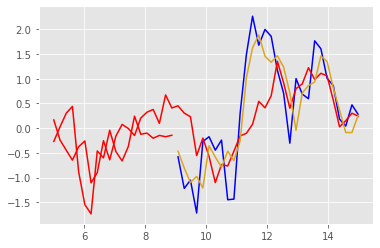

Epoch 414 batch 0 train Loss 0.1384 test Loss 0.1083 with training MSE metric 0.3228 and testing MSE metric 0.2835
learning rate is 0.0003000000142492354


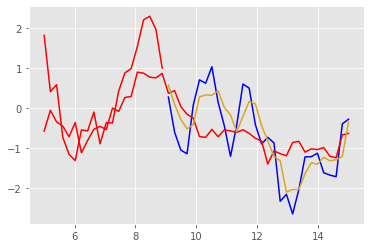

Epoch 414 batch 50 train Loss 0.1107 test Loss 0.1346 with training MSE metric 0.2916 and testing MSE metric 0.3206
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.293208837509155 secs



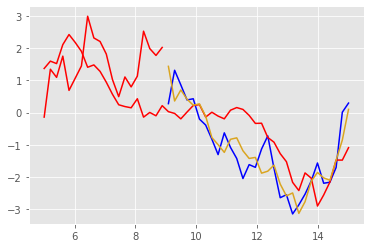

Epoch 415 batch 0 train Loss 0.0825 test Loss 0.1018 with training MSE metric 0.2572 and testing MSE metric 0.2787
learning rate is 0.0003000000142492354


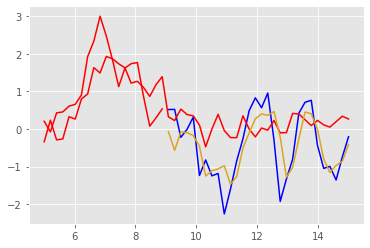

Epoch 415 batch 50 train Loss 0.1022 test Loss 0.1078 with training MSE metric 0.2815 and testing MSE metric 0.2865
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.0782630443573 secs



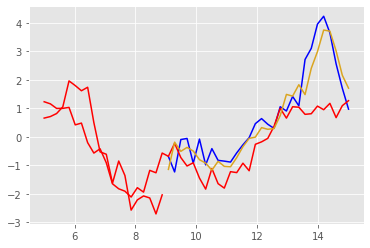

Epoch 416 batch 0 train Loss 0.1183 test Loss 0.1017 with training MSE metric 0.2977 and testing MSE metric 0.2792
learning rate is 0.0003000000142492354


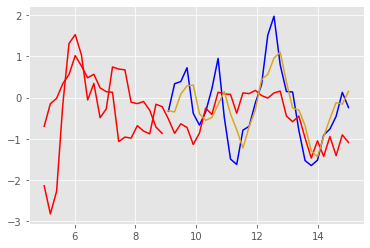

Epoch 416 batch 50 train Loss 0.1423 test Loss 0.1192 with training MSE metric 0.3257 and testing MSE metric 0.2972
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.023684024810791 secs



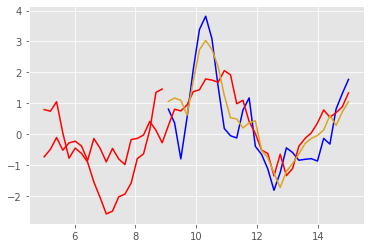

Epoch 417 batch 0 train Loss 0.1159 test Loss 0.1220 with training MSE metric 0.2985 and testing MSE metric 0.3025
learning rate is 0.0003000000142492354


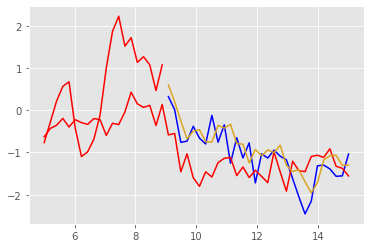

Epoch 417 batch 50 train Loss 0.1053 test Loss 0.0798 with training MSE metric 0.2828 and testing MSE metric 0.2512
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.103242635726929 secs



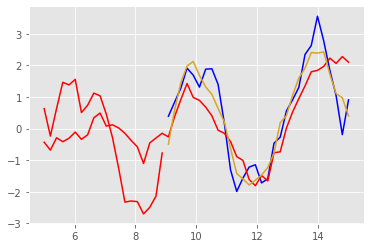

Epoch 418 batch 0 train Loss 0.1030 test Loss 0.1207 with training MSE metric 0.2800 and testing MSE metric 0.2990
learning rate is 0.0003000000142492354


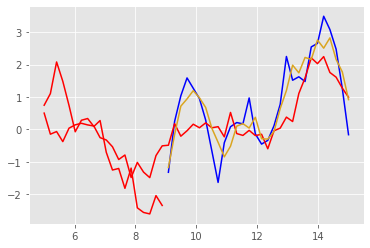

Epoch 418 batch 50 train Loss 0.1014 test Loss 0.1054 with training MSE metric 0.2749 and testing MSE metric 0.2827
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.07108211517334 secs



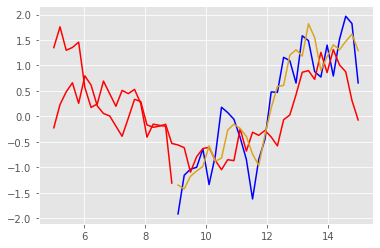

Epoch 419 batch 0 train Loss 0.1145 test Loss 0.0997 with training MSE metric 0.2959 and testing MSE metric 0.2774
learning rate is 0.0003000000142492354


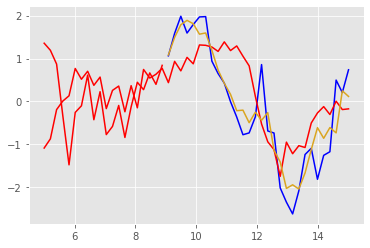

Epoch 419 batch 50 train Loss 0.1421 test Loss 0.0814 with training MSE metric 0.3246 and testing MSE metric 0.2551
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.043606042861938 secs



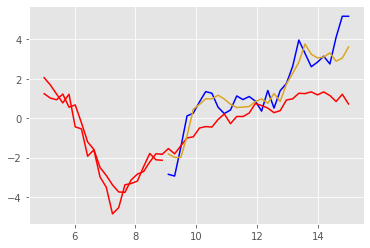

Epoch 420 batch 0 train Loss 0.0958 test Loss 0.1340 with training MSE metric 0.2712 and testing MSE metric 0.3153
learning rate is 0.0003000000142492354


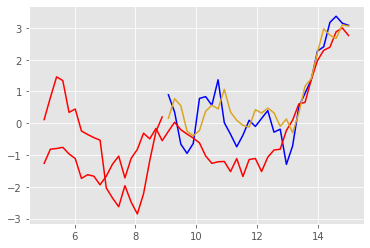

Epoch 420 batch 50 train Loss 0.1166 test Loss 0.1280 with training MSE metric 0.2956 and testing MSE metric 0.3076
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.112501621246338 secs



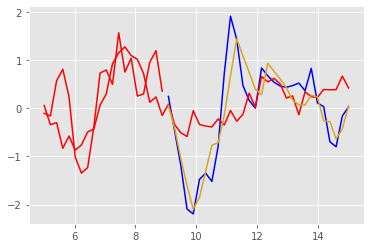

Epoch 421 batch 0 train Loss 0.0877 test Loss 0.1331 with training MSE metric 0.2625 and testing MSE metric 0.3113
learning rate is 0.0003000000142492354


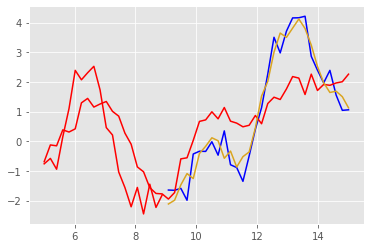

Epoch 421 batch 50 train Loss 0.0825 test Loss 0.1070 with training MSE metric 0.2547 and testing MSE metric 0.2833
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.111678838729858 secs



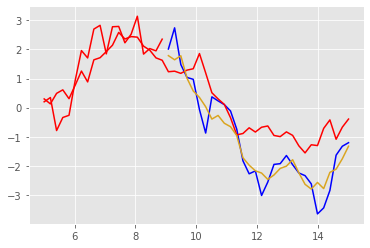

Epoch 422 batch 0 train Loss 0.1218 test Loss 0.1012 with training MSE metric 0.2990 and testing MSE metric 0.2782
learning rate is 0.0003000000142492354


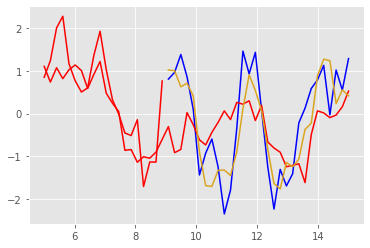

Epoch 422 batch 50 train Loss 0.1261 test Loss 0.1221 with training MSE metric 0.3052 and testing MSE metric 0.2987
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.08072805404663 secs



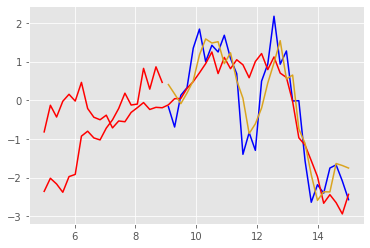

Epoch 423 batch 0 train Loss 0.1047 test Loss 0.1127 with training MSE metric 0.2855 and testing MSE metric 0.2928
learning rate is 0.0003000000142492354


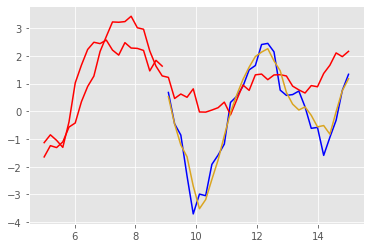

Epoch 423 batch 50 train Loss 0.1081 test Loss 0.1153 with training MSE metric 0.2848 and testing MSE metric 0.2915
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.12567400932312 secs



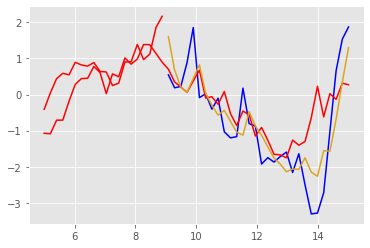

Epoch 424 batch 0 train Loss 0.1067 test Loss 0.1256 with training MSE metric 0.2865 and testing MSE metric 0.3081
learning rate is 0.0003000000142492354


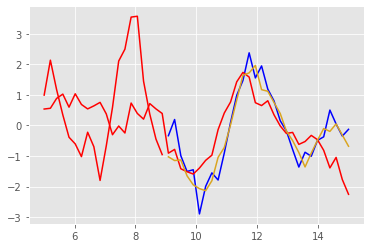

Epoch 424 batch 50 train Loss 0.1190 test Loss 0.1068 with training MSE metric 0.2960 and testing MSE metric 0.2871
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.21624207496643 secs



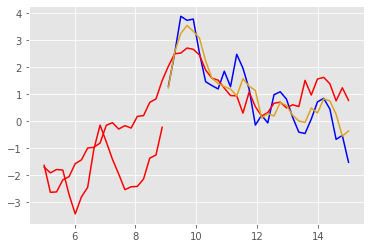

Epoch 425 batch 0 train Loss 0.1251 test Loss 0.1150 with training MSE metric 0.3072 and testing MSE metric 0.2919
learning rate is 0.0003000000142492354


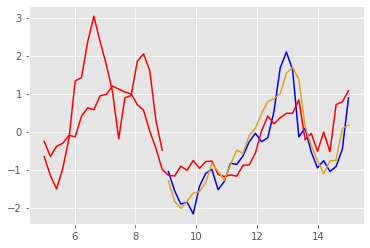

Epoch 425 batch 50 train Loss 0.1208 test Loss 0.1133 with training MSE metric 0.3007 and testing MSE metric 0.2917
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.063467025756836 secs



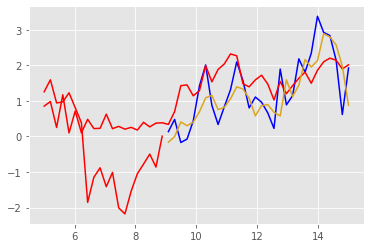

Epoch 426 batch 0 train Loss 0.1305 test Loss 0.1149 with training MSE metric 0.3134 and testing MSE metric 0.2936
learning rate is 0.0003000000142492354


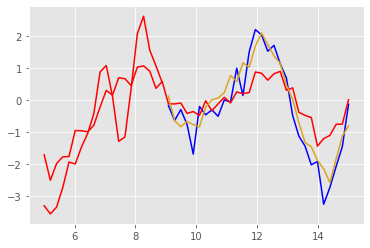

Epoch 426 batch 50 train Loss 0.0990 test Loss 0.1156 with training MSE metric 0.2731 and testing MSE metric 0.2948
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.124735116958618 secs



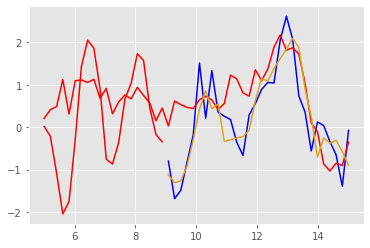

Epoch 427 batch 0 train Loss 0.1162 test Loss 0.1230 with training MSE metric 0.2950 and testing MSE metric 0.3042
learning rate is 0.0003000000142492354


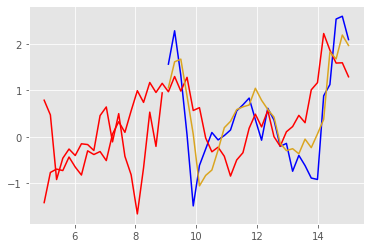

Epoch 427 batch 50 train Loss 0.1266 test Loss 0.1280 with training MSE metric 0.3060 and testing MSE metric 0.3109
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.525007724761963 secs



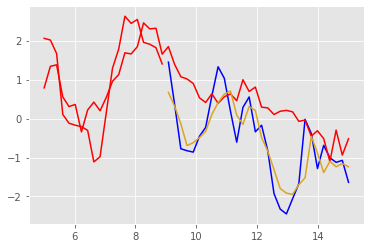

Epoch 428 batch 0 train Loss 0.1176 test Loss 0.1089 with training MSE metric 0.2945 and testing MSE metric 0.2877
learning rate is 0.0003000000142492354


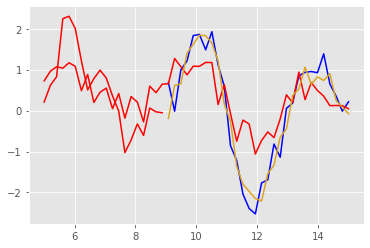

Epoch 428 batch 50 train Loss 0.0806 test Loss 0.0944 with training MSE metric 0.2526 and testing MSE metric 0.2680
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.892301797866821 secs



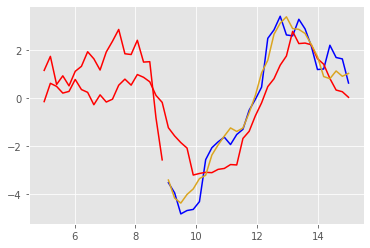

Epoch 429 batch 0 train Loss 0.1093 test Loss 0.1294 with training MSE metric 0.2861 and testing MSE metric 0.3088
learning rate is 0.0003000000142492354


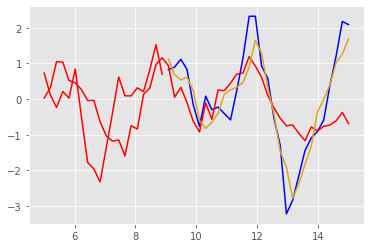

Epoch 429 batch 50 train Loss 0.1350 test Loss 0.1148 with training MSE metric 0.3135 and testing MSE metric 0.2943
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.99479603767395 secs



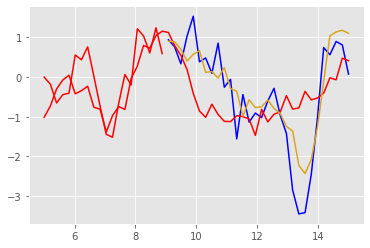

Epoch 430 batch 0 train Loss 0.0904 test Loss 0.0886 with training MSE metric 0.2643 and testing MSE metric 0.2611
learning rate is 0.0003000000142492354


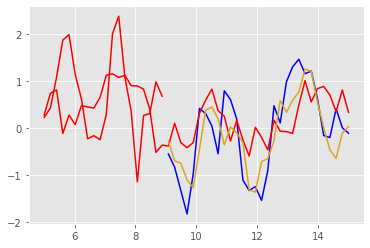

Epoch 430 batch 50 train Loss 0.1147 test Loss 0.0992 with training MSE metric 0.2938 and testing MSE metric 0.2745
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.470608234405518 secs



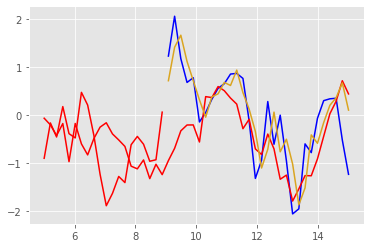

Epoch 431 batch 0 train Loss 0.0965 test Loss 0.1224 with training MSE metric 0.2742 and testing MSE metric 0.3031
learning rate is 0.0003000000142492354


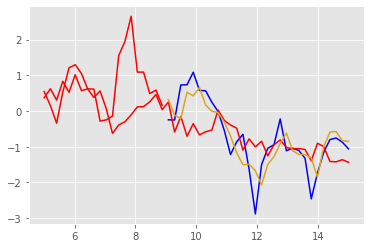

Epoch 431 batch 50 train Loss 0.0923 test Loss 0.1175 with training MSE metric 0.2661 and testing MSE metric 0.2968
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.857627153396606 secs



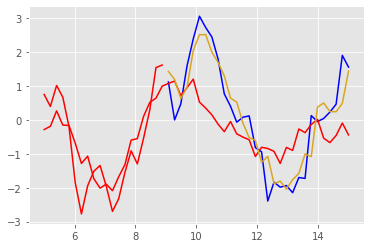

Epoch 432 batch 0 train Loss 0.0980 test Loss 0.1392 with training MSE metric 0.2751 and testing MSE metric 0.3204
learning rate is 0.0003000000142492354


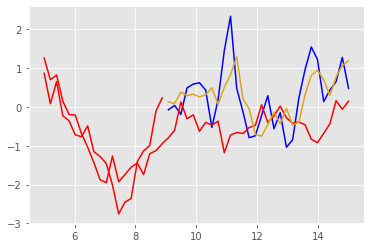

Epoch 432 batch 50 train Loss 0.1312 test Loss 0.1024 with training MSE metric 0.3117 and testing MSE metric 0.2783
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.417704105377197 secs



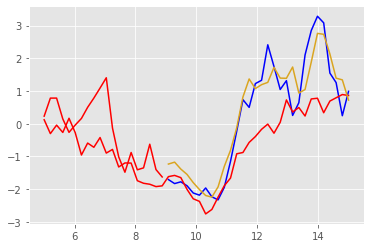

Epoch 433 batch 0 train Loss 0.1162 test Loss 0.0982 with training MSE metric 0.2916 and testing MSE metric 0.2741
learning rate is 0.0003000000142492354


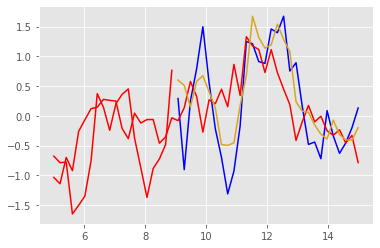

Epoch 433 batch 50 train Loss 0.1301 test Loss 0.0974 with training MSE metric 0.3095 and testing MSE metric 0.2734
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.832183122634888 secs



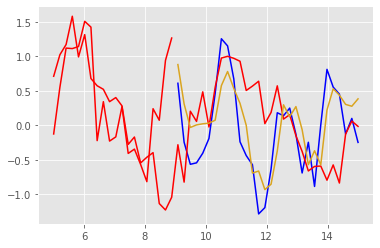

Epoch 434 batch 0 train Loss 0.1131 test Loss 0.1211 with training MSE metric 0.2931 and testing MSE metric 0.3004
learning rate is 0.0003000000142492354


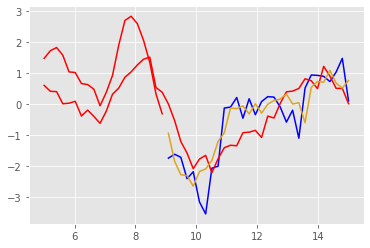

Epoch 434 batch 50 train Loss 0.1051 test Loss 0.1026 with training MSE metric 0.2835 and testing MSE metric 0.2788
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.14701509475708 secs



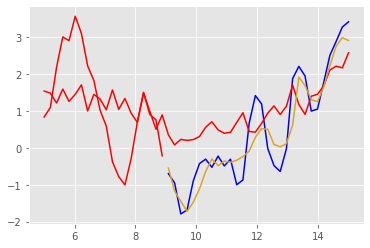

Epoch 435 batch 0 train Loss 0.1149 test Loss 0.1227 with training MSE metric 0.2946 and testing MSE metric 0.3021
learning rate is 0.0003000000142492354


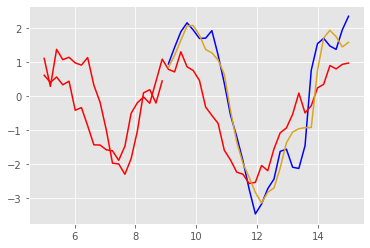

Epoch 435 batch 50 train Loss 0.1145 test Loss 0.1191 with training MSE metric 0.2914 and testing MSE metric 0.3020
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.062716722488403 secs



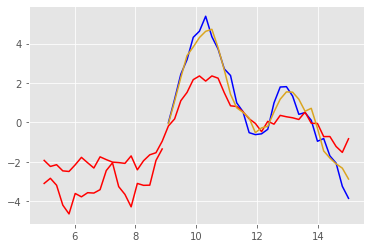

Epoch 436 batch 0 train Loss 0.1179 test Loss 0.1236 with training MSE metric 0.2983 and testing MSE metric 0.3017
learning rate is 0.0003000000142492354


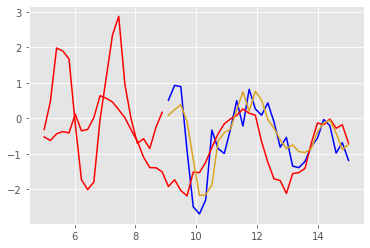

Epoch 436 batch 50 train Loss 0.1079 test Loss 0.1236 with training MSE metric 0.2852 and testing MSE metric 0.3017
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.530938148498535 secs



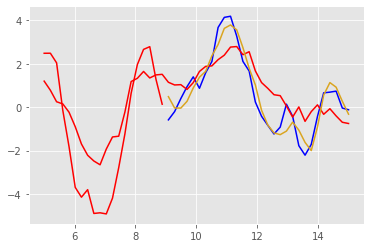

Epoch 437 batch 0 train Loss 0.1214 test Loss 0.0984 with training MSE metric 0.2998 and testing MSE metric 0.2733
learning rate is 0.0003000000142492354


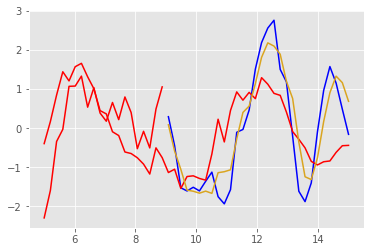

Epoch 437 batch 50 train Loss 0.1191 test Loss 0.1134 with training MSE metric 0.2994 and testing MSE metric 0.2916
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.931447982788086 secs



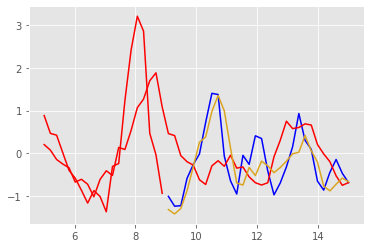

Epoch 438 batch 0 train Loss 0.1011 test Loss 0.1240 with training MSE metric 0.2776 and testing MSE metric 0.3023
learning rate is 0.0003000000142492354


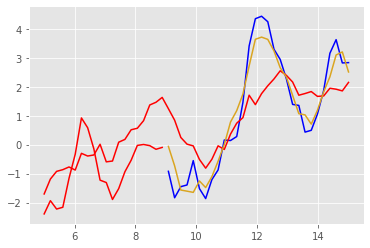

Epoch 438 batch 50 train Loss 0.1084 test Loss 0.0898 with training MSE metric 0.2851 and testing MSE metric 0.2610
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.649631023406982 secs



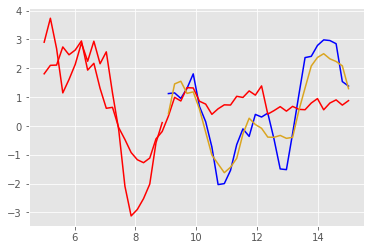

Epoch 439 batch 0 train Loss 0.1108 test Loss 0.1365 with training MSE metric 0.2872 and testing MSE metric 0.3189
learning rate is 0.0003000000142492354


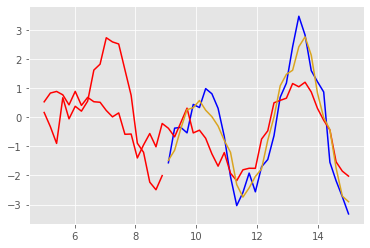

Epoch 439 batch 50 train Loss 0.1186 test Loss 0.1047 with training MSE metric 0.2988 and testing MSE metric 0.2773
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.3197922706604 secs



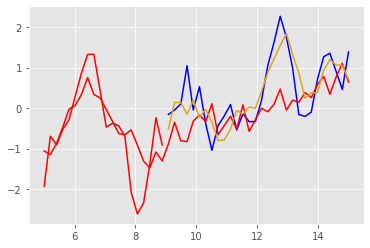

Epoch 440 batch 0 train Loss 0.1136 test Loss 0.1152 with training MSE metric 0.2912 and testing MSE metric 0.2917
learning rate is 0.0003000000142492354


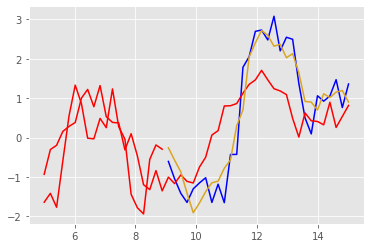

Epoch 440 batch 50 train Loss 0.1243 test Loss 0.1398 with training MSE metric 0.3047 and testing MSE metric 0.3258
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.235866069793701 secs



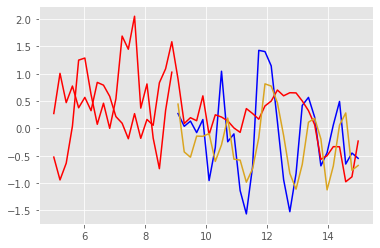

Epoch 441 batch 0 train Loss 0.1039 test Loss 0.1471 with training MSE metric 0.2845 and testing MSE metric 0.3328
learning rate is 0.0003000000142492354


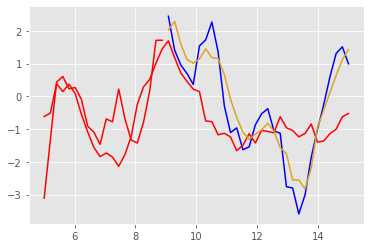

Epoch 441 batch 50 train Loss 0.1088 test Loss 0.1042 with training MSE metric 0.2902 and testing MSE metric 0.2812
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.977160215377808 secs



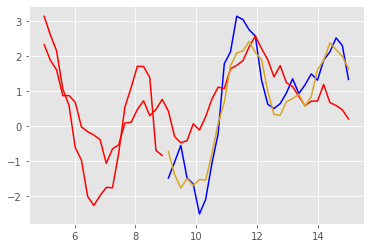

Epoch 442 batch 0 train Loss 0.1105 test Loss 0.1061 with training MSE metric 0.2877 and testing MSE metric 0.2803
learning rate is 0.0003000000142492354


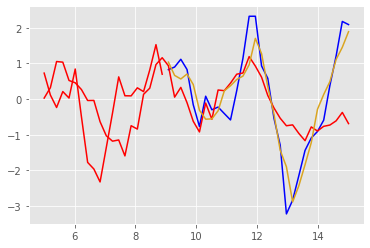

Epoch 442 batch 50 train Loss 0.0972 test Loss 0.1124 with training MSE metric 0.2761 and testing MSE metric 0.2884
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.971060991287231 secs



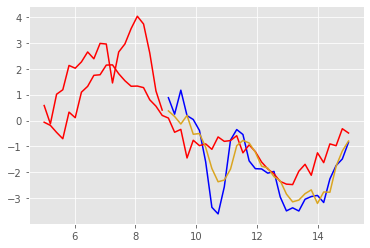

Epoch 443 batch 0 train Loss 0.1267 test Loss 0.0997 with training MSE metric 0.3053 and testing MSE metric 0.2735
learning rate is 0.0003000000142492354


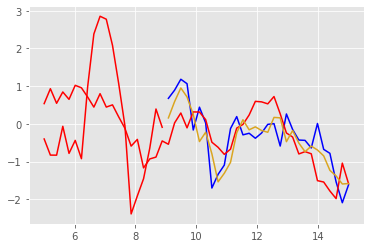

Epoch 443 batch 50 train Loss 0.1055 test Loss 0.1272 with training MSE metric 0.2862 and testing MSE metric 0.3093
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.097322940826416 secs



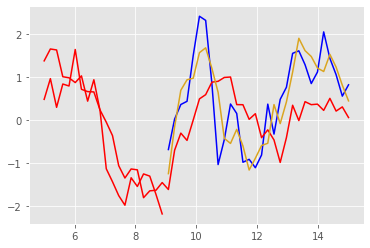

Epoch 444 batch 0 train Loss 0.1051 test Loss 0.1284 with training MSE metric 0.2780 and testing MSE metric 0.3046
learning rate is 0.0003000000142492354


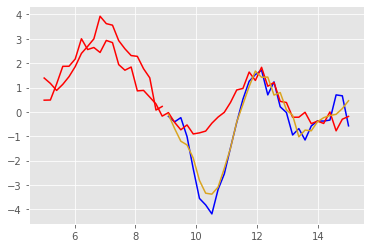

Epoch 444 batch 50 train Loss 0.1304 test Loss 0.1069 with training MSE metric 0.3138 and testing MSE metric 0.2881
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.246646881103516 secs



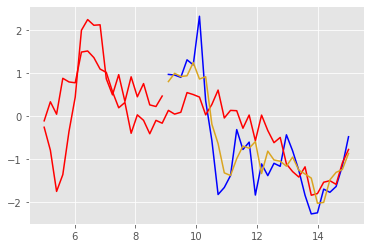

Epoch 445 batch 0 train Loss 0.1091 test Loss 0.1373 with training MSE metric 0.2865 and testing MSE metric 0.3194
learning rate is 0.0003000000142492354


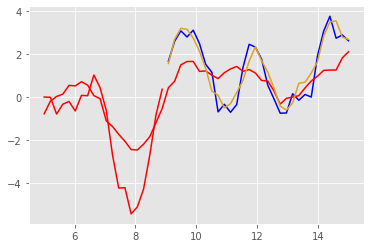

Epoch 445 batch 50 train Loss 0.1457 test Loss 0.0987 with training MSE metric 0.3303 and testing MSE metric 0.2754
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.987712144851685 secs



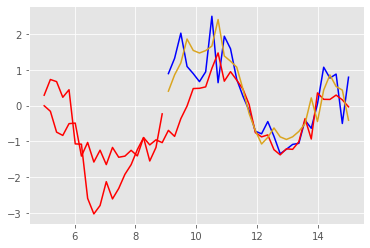

Epoch 446 batch 0 train Loss 0.1131 test Loss 0.1023 with training MSE metric 0.2923 and testing MSE metric 0.2773
learning rate is 0.0003000000142492354


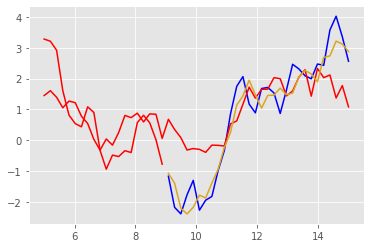

Epoch 446 batch 50 train Loss 0.0924 test Loss 0.1427 with training MSE metric 0.2650 and testing MSE metric 0.3292
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.747291088104248 secs



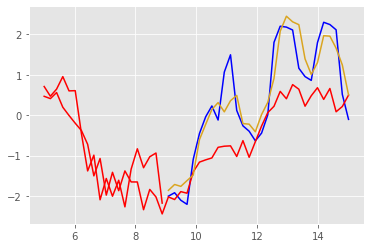

Epoch 447 batch 0 train Loss 0.1368 test Loss 0.1154 with training MSE metric 0.3223 and testing MSE metric 0.2954
learning rate is 0.0003000000142492354


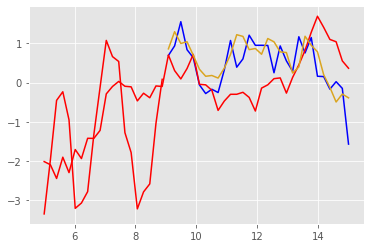

Epoch 447 batch 50 train Loss 0.0864 test Loss 0.1034 with training MSE metric 0.2589 and testing MSE metric 0.2772
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.05971884727478 secs



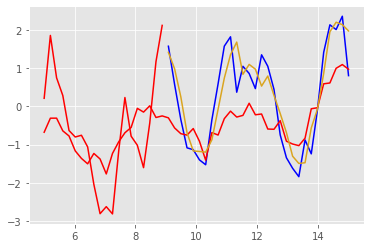

Epoch 448 batch 0 train Loss 0.1181 test Loss 0.1234 with training MSE metric 0.2950 and testing MSE metric 0.3033
learning rate is 0.0003000000142492354


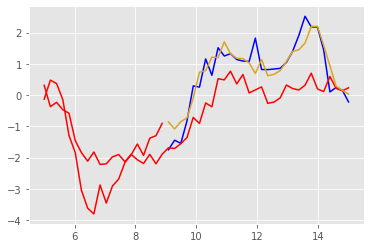

Epoch 448 batch 50 train Loss 0.1155 test Loss 0.1215 with training MSE metric 0.2943 and testing MSE metric 0.3004
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.006482124328613 secs



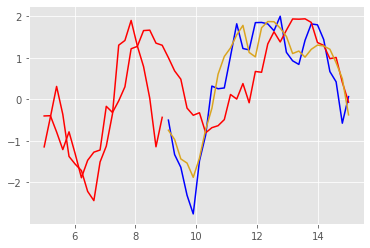

Epoch 449 batch 0 train Loss 0.1114 test Loss 0.1043 with training MSE metric 0.2876 and testing MSE metric 0.2838
learning rate is 0.0003000000142492354


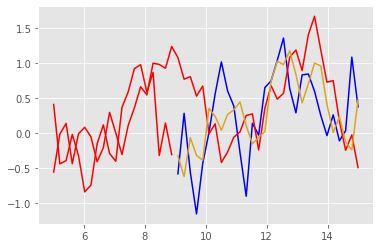

Epoch 449 batch 50 train Loss 0.1232 test Loss 0.1197 with training MSE metric 0.3076 and testing MSE metric 0.2999
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.719956874847412 secs



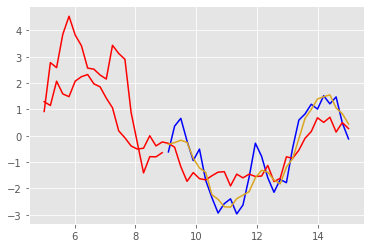

Epoch 450 batch 0 train Loss 0.1407 test Loss 0.0943 with training MSE metric 0.3250 and testing MSE metric 0.2686
learning rate is 0.0003000000142492354


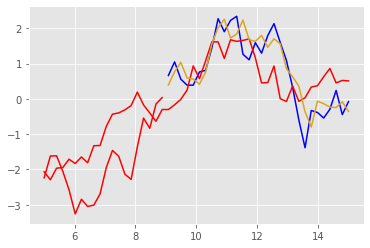

Epoch 450 batch 50 train Loss 0.1288 test Loss 0.0990 with training MSE metric 0.3114 and testing MSE metric 0.2778
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.008780002593994 secs



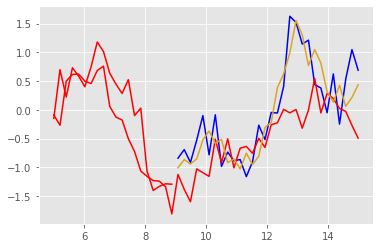

Epoch 451 batch 0 train Loss 0.1001 test Loss 0.1230 with training MSE metric 0.2768 and testing MSE metric 0.3019
learning rate is 0.0003000000142492354


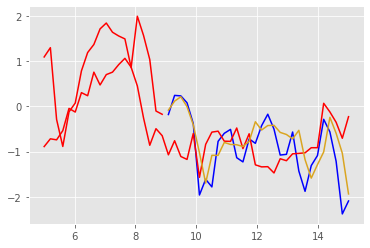

Epoch 451 batch 50 train Loss 0.1328 test Loss 0.1097 with training MSE metric 0.3154 and testing MSE metric 0.2854
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.203449726104736 secs



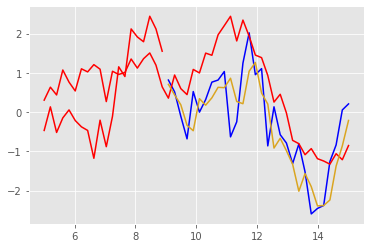

Epoch 452 batch 0 train Loss 0.1223 test Loss 0.1315 with training MSE metric 0.3037 and testing MSE metric 0.3099
learning rate is 0.0003000000142492354


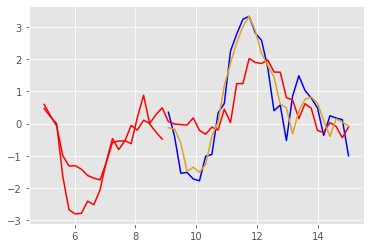

Epoch 452 batch 50 train Loss 0.1150 test Loss 0.0942 with training MSE metric 0.2937 and testing MSE metric 0.2700
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.064454317092896 secs



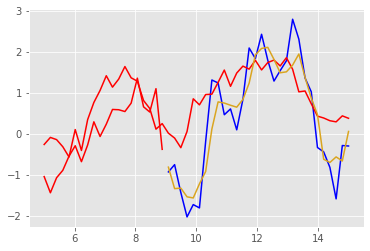

Epoch 453 batch 0 train Loss 0.1287 test Loss 0.1109 with training MSE metric 0.3113 and testing MSE metric 0.2890
learning rate is 0.0003000000142492354


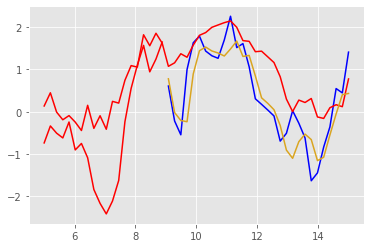

Epoch 453 batch 50 train Loss 0.1181 test Loss 0.1215 with training MSE metric 0.2951 and testing MSE metric 0.3004
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.515012741088867 secs



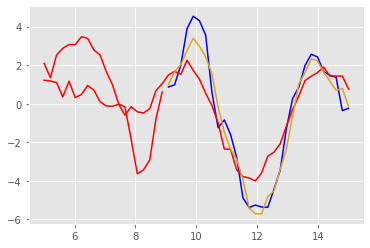

Epoch 454 batch 0 train Loss 0.1237 test Loss 0.1189 with training MSE metric 0.3023 and testing MSE metric 0.2990
learning rate is 0.0003000000142492354


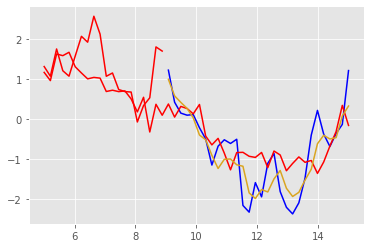

Epoch 454 batch 50 train Loss 0.1182 test Loss 0.1102 with training MSE metric 0.2981 and testing MSE metric 0.2887
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.959094047546387 secs



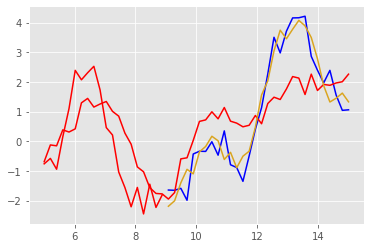

Epoch 455 batch 0 train Loss 0.0934 test Loss 0.1028 with training MSE metric 0.2674 and testing MSE metric 0.2781
learning rate is 0.0003000000142492354


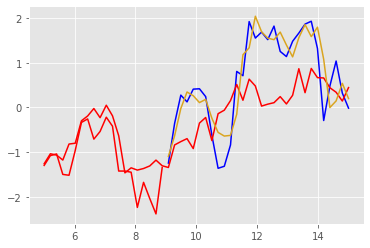

Epoch 455 batch 50 train Loss 0.1156 test Loss 0.1086 with training MSE metric 0.2951 and testing MSE metric 0.2849
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.976025104522705 secs



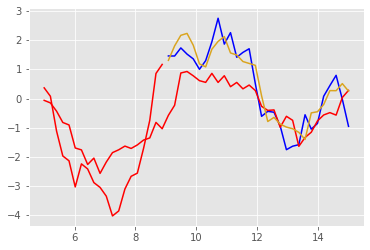

Epoch 456 batch 0 train Loss 0.1024 test Loss 0.1257 with training MSE metric 0.2788 and testing MSE metric 0.3064
learning rate is 0.0003000000142492354


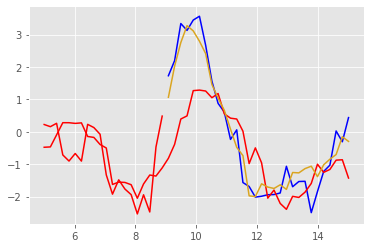

Epoch 456 batch 50 train Loss 0.0962 test Loss 0.0956 with training MSE metric 0.2715 and testing MSE metric 0.2719
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.627567291259766 secs



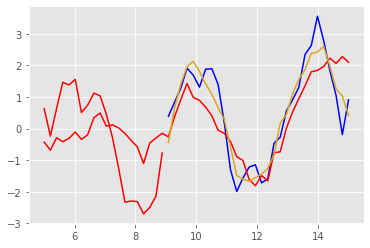

Epoch 457 batch 0 train Loss 0.1148 test Loss 0.1516 with training MSE metric 0.2926 and testing MSE metric 0.3350
learning rate is 0.0003000000142492354


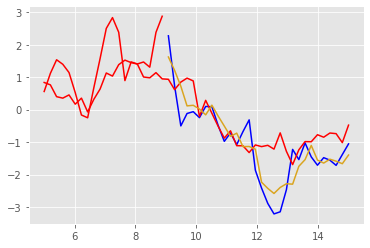

Epoch 457 batch 50 train Loss 0.0864 test Loss 0.0987 with training MSE metric 0.2584 and testing MSE metric 0.2724
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.577624797821045 secs



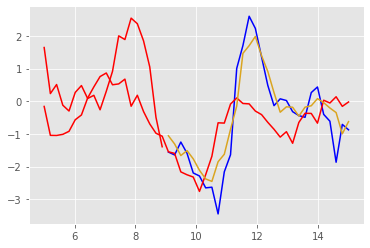

Epoch 458 batch 0 train Loss 0.1294 test Loss 0.1129 with training MSE metric 0.3086 and testing MSE metric 0.2900
learning rate is 0.0003000000142492354


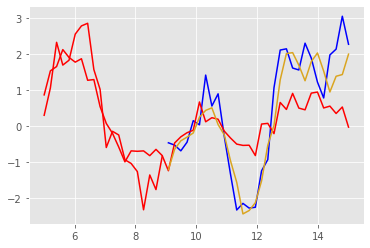

Epoch 458 batch 50 train Loss 0.1376 test Loss 0.1051 with training MSE metric 0.3236 and testing MSE metric 0.2812
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.060564994812012 secs



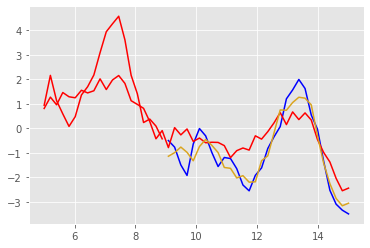

Epoch 459 batch 0 train Loss 0.1343 test Loss 0.1231 with training MSE metric 0.3164 and testing MSE metric 0.3045
learning rate is 0.0003000000142492354


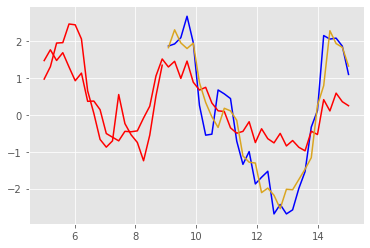

Epoch 459 batch 50 train Loss 0.1182 test Loss 0.1043 with training MSE metric 0.2970 and testing MSE metric 0.2804
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.866577863693237 secs



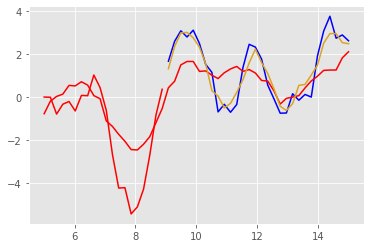

Epoch 460 batch 0 train Loss 0.1060 test Loss 0.1053 with training MSE metric 0.2838 and testing MSE metric 0.2820
learning rate is 0.0003000000142492354


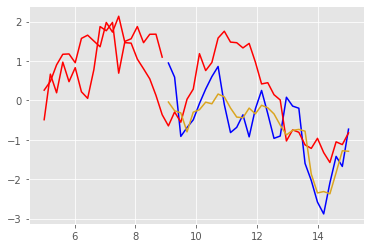

Epoch 460 batch 50 train Loss 0.1195 test Loss 0.1102 with training MSE metric 0.2989 and testing MSE metric 0.2866
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.034508228302002 secs



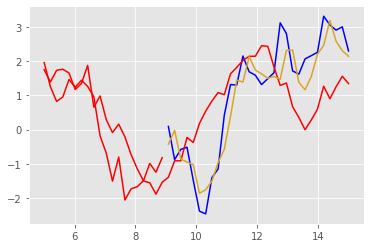

Epoch 461 batch 0 train Loss 0.1333 test Loss 0.1028 with training MSE metric 0.3155 and testing MSE metric 0.2778
learning rate is 0.0003000000142492354


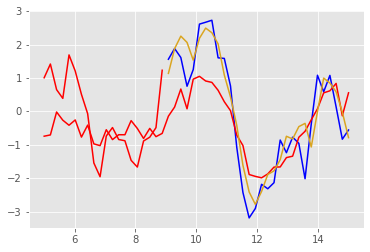

Epoch 461 batch 50 train Loss 0.1342 test Loss 0.1103 with training MSE metric 0.3178 and testing MSE metric 0.2887
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.619610071182251 secs



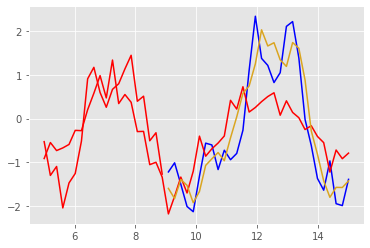

Epoch 462 batch 0 train Loss 0.1001 test Loss 0.0900 with training MSE metric 0.2788 and testing MSE metric 0.2678
learning rate is 0.0003000000142492354


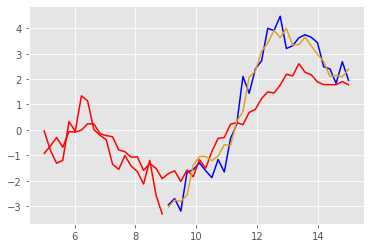

Epoch 462 batch 50 train Loss 0.1165 test Loss 0.1317 with training MSE metric 0.2960 and testing MSE metric 0.3125
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.736289024353027 secs



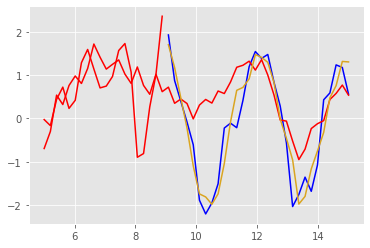

Epoch 463 batch 0 train Loss 0.1496 test Loss 0.1061 with training MSE metric 0.3341 and testing MSE metric 0.2831
learning rate is 0.0003000000142492354


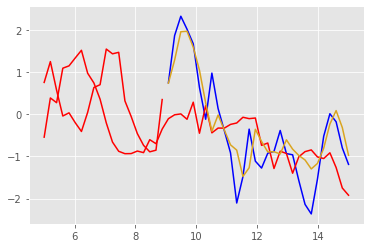

Epoch 463 batch 50 train Loss 0.1141 test Loss 0.1213 with training MSE metric 0.2942 and testing MSE metric 0.3033
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.402313947677612 secs



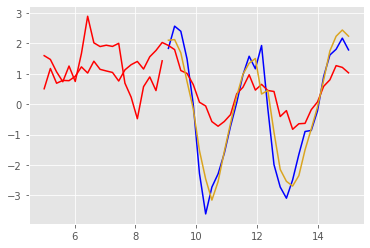

Epoch 464 batch 0 train Loss 0.1087 test Loss 0.1153 with training MSE metric 0.2868 and testing MSE metric 0.2933
learning rate is 0.0003000000142492354


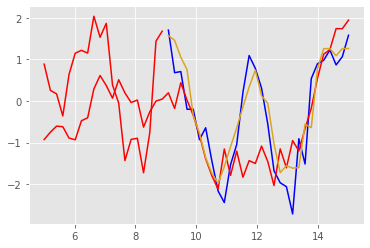

Epoch 464 batch 50 train Loss 0.0775 test Loss 0.1066 with training MSE metric 0.2503 and testing MSE metric 0.2866
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.201480865478516 secs



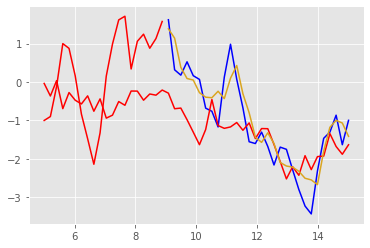

Epoch 465 batch 0 train Loss 0.1135 test Loss 0.0934 with training MSE metric 0.2920 and testing MSE metric 0.2680
learning rate is 0.0003000000142492354


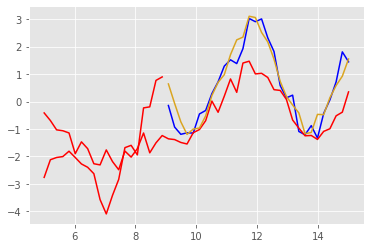

Epoch 465 batch 50 train Loss 0.1091 test Loss 0.1073 with training MSE metric 0.2850 and testing MSE metric 0.2834
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.54323673248291 secs



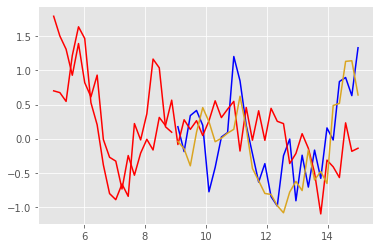

Epoch 466 batch 0 train Loss 0.0921 test Loss 0.0854 with training MSE metric 0.2674 and testing MSE metric 0.2599
learning rate is 0.0003000000142492354


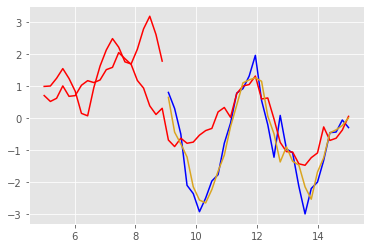

Epoch 466 batch 50 train Loss 0.1218 test Loss 0.1118 with training MSE metric 0.3022 and testing MSE metric 0.2891
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.799600839614868 secs



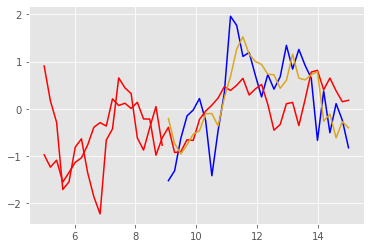

Epoch 467 batch 0 train Loss 0.1251 test Loss 0.1119 with training MSE metric 0.3064 and testing MSE metric 0.2909
learning rate is 0.0003000000142492354


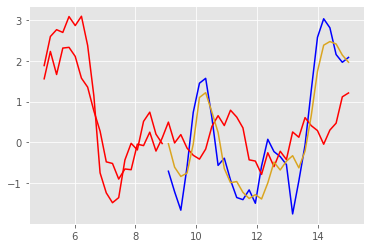

Epoch 467 batch 50 train Loss 0.1154 test Loss 0.1191 with training MSE metric 0.2944 and testing MSE metric 0.2981
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.673361778259277 secs



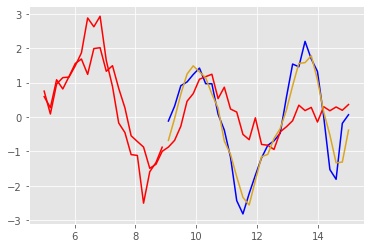

Epoch 468 batch 0 train Loss 0.1130 test Loss 0.1137 with training MSE metric 0.2924 and testing MSE metric 0.2916
learning rate is 0.0003000000142492354


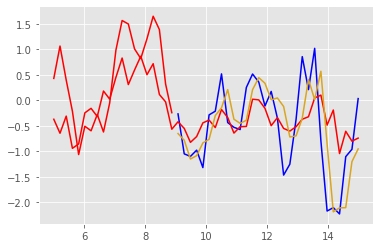

Epoch 468 batch 50 train Loss 0.1144 test Loss 0.0911 with training MSE metric 0.2918 and testing MSE metric 0.2664
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 15.412495136260986 secs



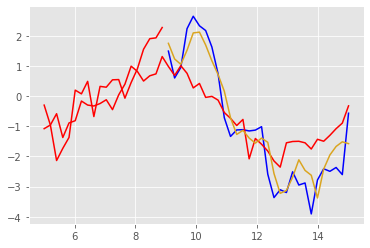

Epoch 469 batch 0 train Loss 0.1031 test Loss 0.1239 with training MSE metric 0.2778 and testing MSE metric 0.3031
learning rate is 0.0003000000142492354


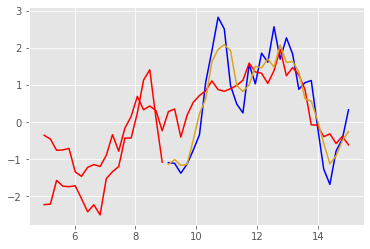

Epoch 469 batch 50 train Loss 0.1161 test Loss 0.1033 with training MSE metric 0.2955 and testing MSE metric 0.2811
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 16.70199728012085 secs



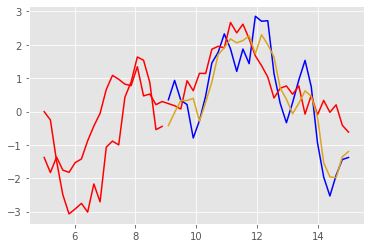

Epoch 470 batch 0 train Loss 0.1353 test Loss 0.1059 with training MSE metric 0.3178 and testing MSE metric 0.2880
learning rate is 0.0003000000142492354


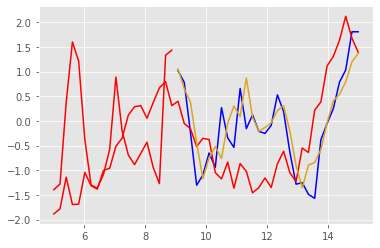

Epoch 470 batch 50 train Loss 0.1172 test Loss 0.1390 with training MSE metric 0.2945 and testing MSE metric 0.3198
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 17.619366884231567 secs



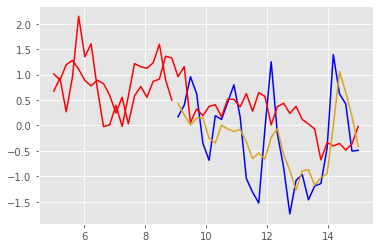

Epoch 471 batch 0 train Loss 0.1233 test Loss 0.1227 with training MSE metric 0.3055 and testing MSE metric 0.3014
learning rate is 0.0003000000142492354


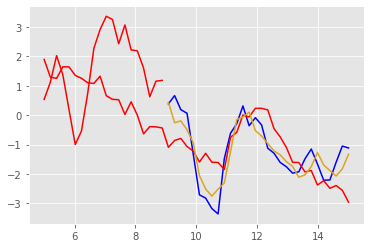

Epoch 471 batch 50 train Loss 0.1094 test Loss 0.1124 with training MSE metric 0.2878 and testing MSE metric 0.2918
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 17.92310118675232 secs



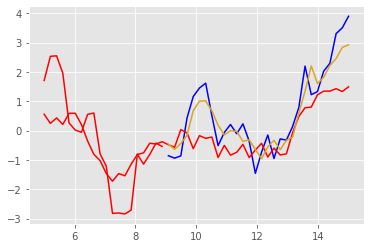

Epoch 472 batch 0 train Loss 0.1214 test Loss 0.1345 with training MSE metric 0.3027 and testing MSE metric 0.3201
learning rate is 0.0003000000142492354


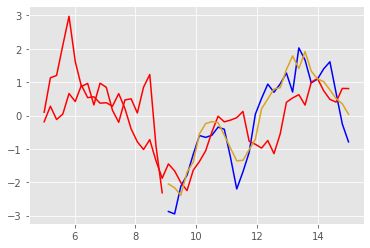

Epoch 472 batch 50 train Loss 0.0928 test Loss 0.1098 with training MSE metric 0.2672 and testing MSE metric 0.2884
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 15.944952011108398 secs



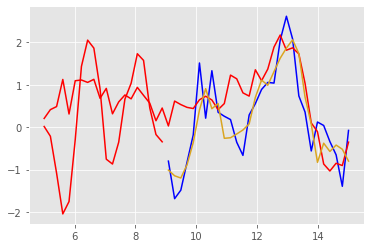

Epoch 473 batch 0 train Loss 0.1092 test Loss 0.1403 with training MSE metric 0.2844 and testing MSE metric 0.3252
learning rate is 0.0003000000142492354


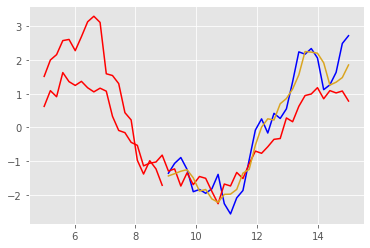

Epoch 473 batch 50 train Loss 0.1285 test Loss 0.0992 with training MSE metric 0.3096 and testing MSE metric 0.2778
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.708571910858154 secs



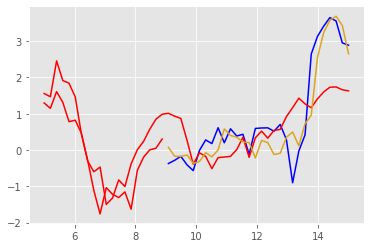

Epoch 474 batch 0 train Loss 0.0975 test Loss 0.1203 with training MSE metric 0.2747 and testing MSE metric 0.3031
learning rate is 0.0003000000142492354


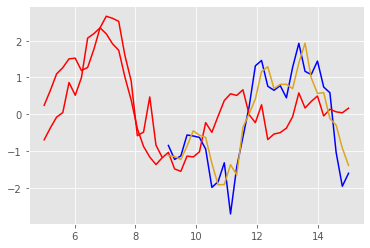

Epoch 474 batch 50 train Loss 0.1153 test Loss 0.1158 with training MSE metric 0.2962 and testing MSE metric 0.2945
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.61002779006958 secs



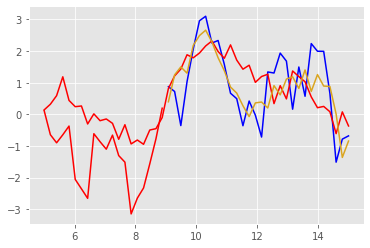

Epoch 475 batch 0 train Loss 0.1236 test Loss 0.1119 with training MSE metric 0.3037 and testing MSE metric 0.2898
learning rate is 0.0003000000142492354


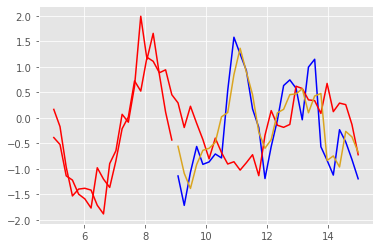

Epoch 475 batch 50 train Loss 0.1070 test Loss 0.1014 with training MSE metric 0.2855 and testing MSE metric 0.2791
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.909340143203735 secs



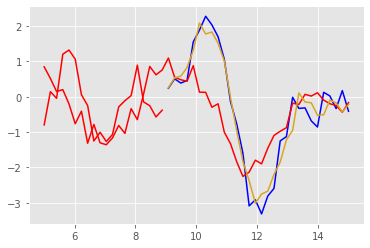

Epoch 476 batch 0 train Loss 0.1038 test Loss 0.1034 with training MSE metric 0.2805 and testing MSE metric 0.2816
learning rate is 0.0003000000142492354


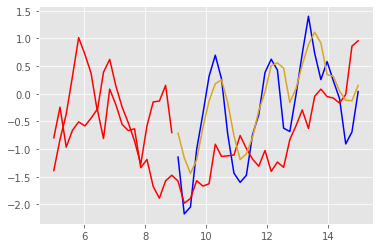

Epoch 476 batch 50 train Loss 0.1001 test Loss 0.1136 with training MSE metric 0.2746 and testing MSE metric 0.2932
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.338679075241089 secs



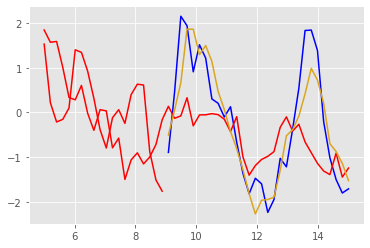

Epoch 477 batch 0 train Loss 0.1249 test Loss 0.1040 with training MSE metric 0.3050 and testing MSE metric 0.2793
learning rate is 0.0003000000142492354


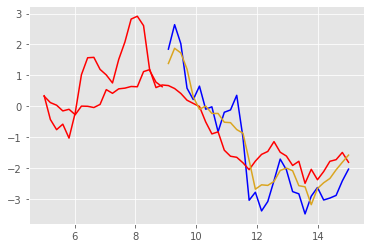

Epoch 477 batch 50 train Loss 0.1216 test Loss 0.1214 with training MSE metric 0.3024 and testing MSE metric 0.2984
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.401655197143555 secs



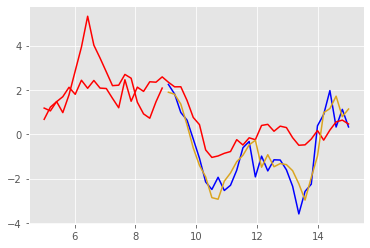

Epoch 478 batch 0 train Loss 0.1274 test Loss 0.1010 with training MSE metric 0.3089 and testing MSE metric 0.2784
learning rate is 0.0003000000142492354


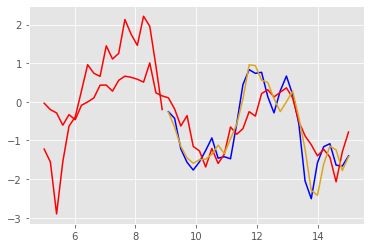

Epoch 478 batch 50 train Loss 0.0926 test Loss 0.1195 with training MSE metric 0.2712 and testing MSE metric 0.2996
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.321125030517578 secs



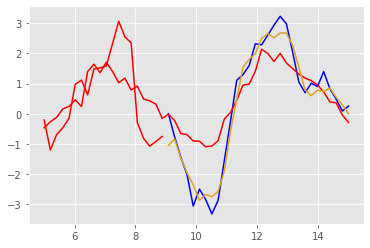

Epoch 479 batch 0 train Loss 0.1405 test Loss 0.1003 with training MSE metric 0.3252 and testing MSE metric 0.2765
learning rate is 0.0003000000142492354


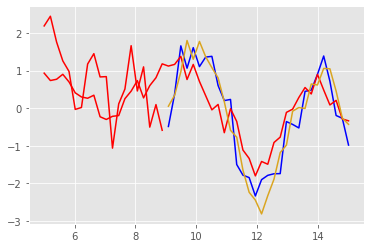

Epoch 479 batch 50 train Loss 0.1169 test Loss 0.1132 with training MSE metric 0.2940 and testing MSE metric 0.2906
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.8595130443573 secs



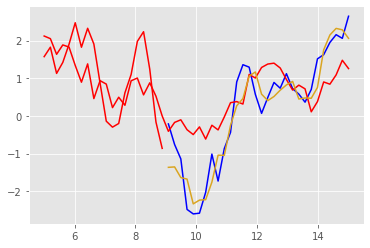

Epoch 480 batch 0 train Loss 0.1025 test Loss 0.1117 with training MSE metric 0.2791 and testing MSE metric 0.2903
learning rate is 0.0003000000142492354


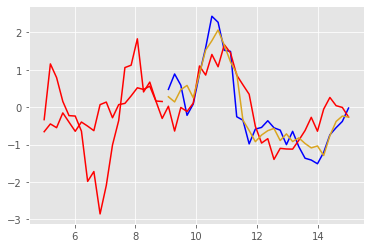

Epoch 480 batch 50 train Loss 0.1156 test Loss 0.1112 with training MSE metric 0.2930 and testing MSE metric 0.2879
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.841076135635376 secs



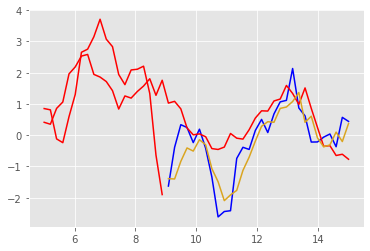

Epoch 481 batch 0 train Loss 0.1141 test Loss 0.1029 with training MSE metric 0.2927 and testing MSE metric 0.2799
learning rate is 0.0003000000142492354


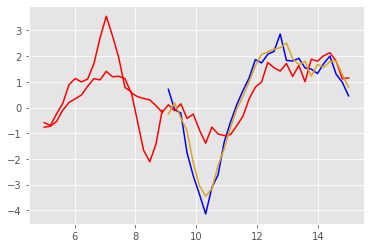

Epoch 481 batch 50 train Loss 0.1266 test Loss 0.0934 with training MSE metric 0.3041 and testing MSE metric 0.2673
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.221199989318848 secs



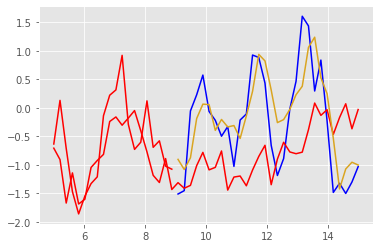

Epoch 482 batch 0 train Loss 0.1271 test Loss 0.0973 with training MSE metric 0.3073 and testing MSE metric 0.2712
learning rate is 0.0003000000142492354


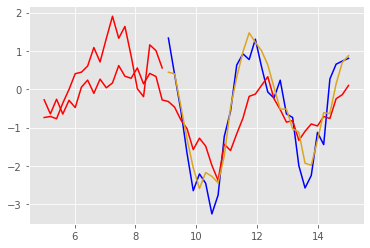

Epoch 482 batch 50 train Loss 0.1079 test Loss 0.1086 with training MSE metric 0.2874 and testing MSE metric 0.2859
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.62530779838562 secs



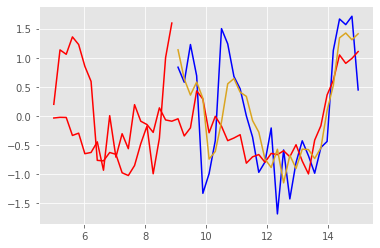

Epoch 483 batch 0 train Loss 0.1089 test Loss 0.1136 with training MSE metric 0.2866 and testing MSE metric 0.2931
learning rate is 0.0003000000142492354


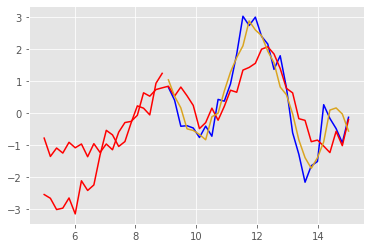

Epoch 483 batch 50 train Loss 0.1217 test Loss 0.1005 with training MSE metric 0.3033 and testing MSE metric 0.2752
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.540721893310547 secs



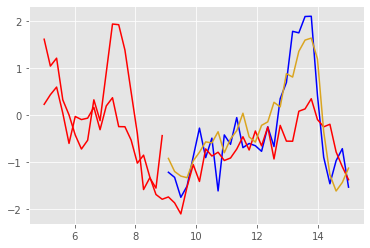

Epoch 484 batch 0 train Loss 0.1219 test Loss 0.1275 with training MSE metric 0.3057 and testing MSE metric 0.3069
learning rate is 0.0003000000142492354


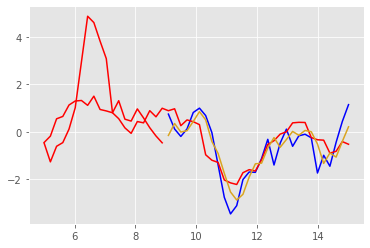

Epoch 484 batch 50 train Loss 0.1060 test Loss 0.1311 with training MSE metric 0.2852 and testing MSE metric 0.3142
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.09822392463684 secs



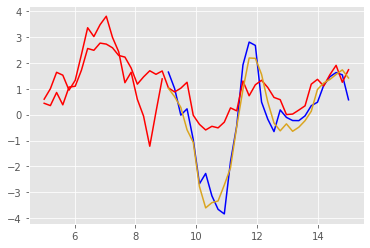

Epoch 485 batch 0 train Loss 0.1135 test Loss 0.1118 with training MSE metric 0.2914 and testing MSE metric 0.2888
learning rate is 0.0003000000142492354


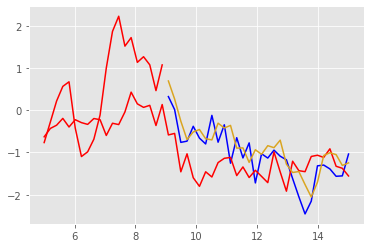

Epoch 485 batch 50 train Loss 0.1066 test Loss 0.1129 with training MSE metric 0.2847 and testing MSE metric 0.2889
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.60388994216919 secs



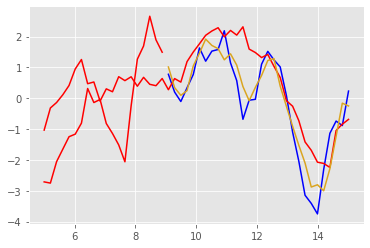

Epoch 486 batch 0 train Loss 0.1272 test Loss 0.0975 with training MSE metric 0.3067 and testing MSE metric 0.2725
learning rate is 0.0003000000142492354


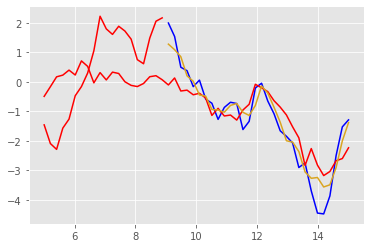

Epoch 486 batch 50 train Loss 0.1167 test Loss 0.0944 with training MSE metric 0.2938 and testing MSE metric 0.2713
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.699153900146484 secs



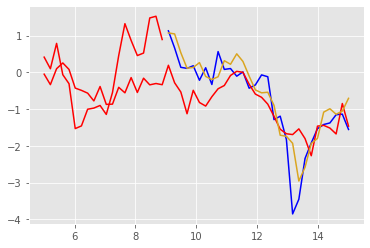

Epoch 487 batch 0 train Loss 0.1162 test Loss 0.1208 with training MSE metric 0.2938 and testing MSE metric 0.2960
learning rate is 0.0003000000142492354


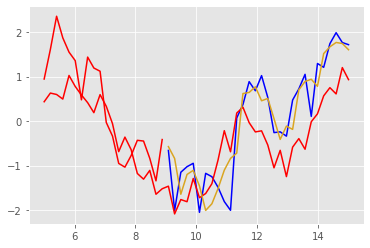

Epoch 487 batch 50 train Loss 0.1351 test Loss 0.1100 with training MSE metric 0.3154 and testing MSE metric 0.2879
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.736902952194214 secs



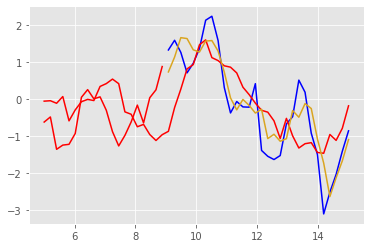

Epoch 488 batch 0 train Loss 0.1332 test Loss 0.1194 with training MSE metric 0.3116 and testing MSE metric 0.2971
learning rate is 0.0003000000142492354


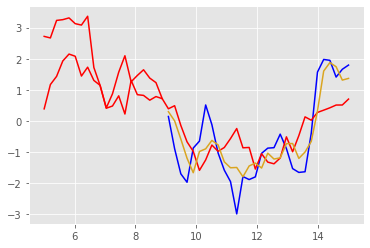

Epoch 488 batch 50 train Loss 0.1193 test Loss 0.1360 with training MSE metric 0.2978 and testing MSE metric 0.3169
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.77864670753479 secs



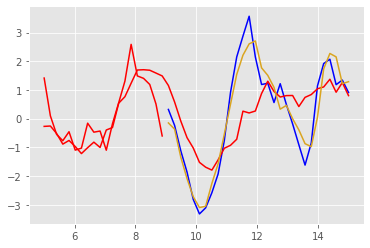

Epoch 489 batch 0 train Loss 0.0841 test Loss 0.1109 with training MSE metric 0.2566 and testing MSE metric 0.2906
learning rate is 0.0003000000142492354


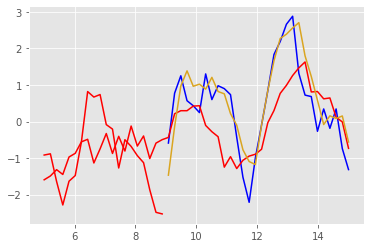

Epoch 489 batch 50 train Loss 0.1465 test Loss 0.1039 with training MSE metric 0.3319 and testing MSE metric 0.2827
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.587060928344727 secs



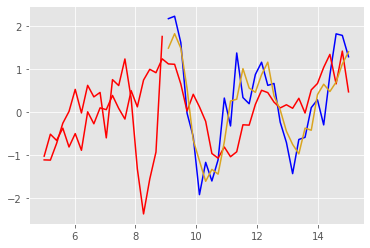

Epoch 490 batch 0 train Loss 0.1138 test Loss 0.1445 with training MSE metric 0.2939 and testing MSE metric 0.3320
learning rate is 0.0003000000142492354


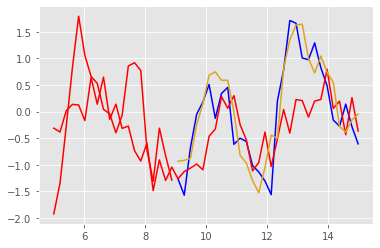

Epoch 490 batch 50 train Loss 0.1119 test Loss 0.1121 with training MSE metric 0.2889 and testing MSE metric 0.2915
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.80561113357544 secs



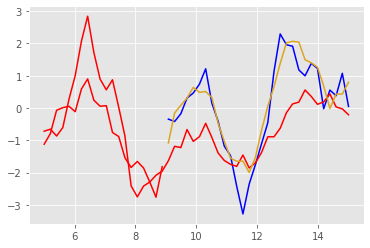

Epoch 491 batch 0 train Loss 0.1355 test Loss 0.1151 with training MSE metric 0.3207 and testing MSE metric 0.2949
learning rate is 0.0003000000142492354


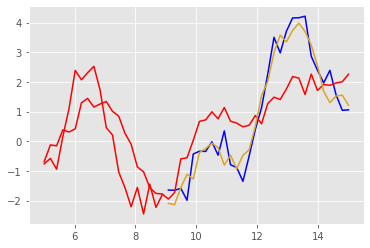

Epoch 491 batch 50 train Loss 0.1322 test Loss 0.0964 with training MSE metric 0.3140 and testing MSE metric 0.2724
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.655049085617065 secs



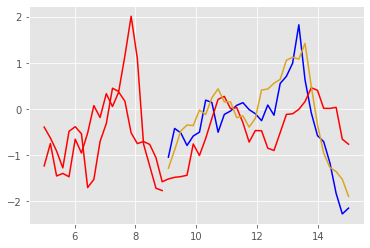

Epoch 492 batch 0 train Loss 0.1264 test Loss 0.1076 with training MSE metric 0.3046 and testing MSE metric 0.2830
learning rate is 0.0003000000142492354


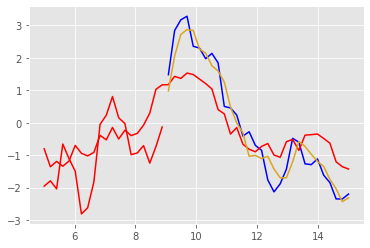

Epoch 492 batch 50 train Loss 0.0995 test Loss 0.1175 with training MSE metric 0.2794 and testing MSE metric 0.2944
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.156607866287231 secs



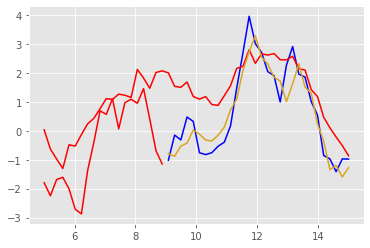

Epoch 493 batch 0 train Loss 0.1150 test Loss 0.1057 with training MSE metric 0.2934 and testing MSE metric 0.2833
learning rate is 0.0003000000142492354


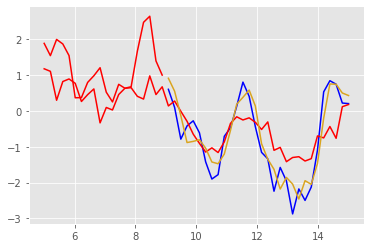

Epoch 493 batch 50 train Loss 0.1139 test Loss 0.1137 with training MSE metric 0.2935 and testing MSE metric 0.2934
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.506517171859741 secs



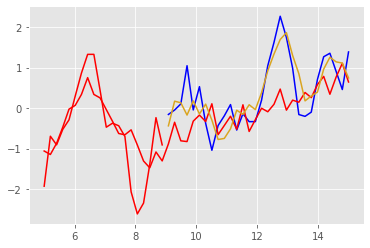

Epoch 494 batch 0 train Loss 0.0938 test Loss 0.1110 with training MSE metric 0.2670 and testing MSE metric 0.2885
learning rate is 0.0003000000142492354


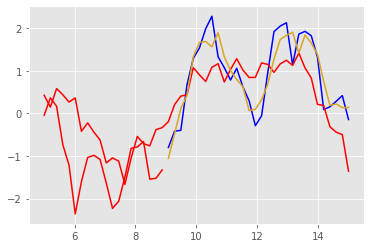

Epoch 494 batch 50 train Loss 0.1220 test Loss 0.1166 with training MSE metric 0.2999 and testing MSE metric 0.2956
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.147942304611206 secs



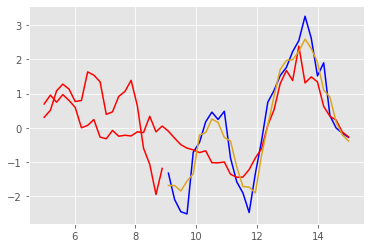

Epoch 495 batch 0 train Loss 0.1103 test Loss 0.1030 with training MSE metric 0.2893 and testing MSE metric 0.2764
learning rate is 0.0003000000142492354


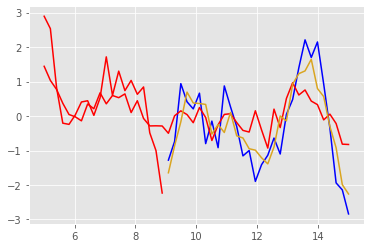

Epoch 495 batch 50 train Loss 0.1325 test Loss 0.1043 with training MSE metric 0.3176 and testing MSE metric 0.2815
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.294628858566284 secs



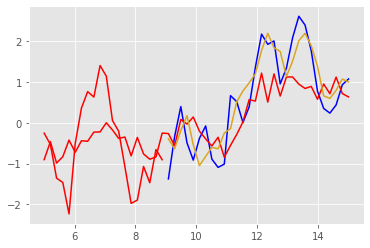

Epoch 496 batch 0 train Loss 0.1068 test Loss 0.1193 with training MSE metric 0.2868 and testing MSE metric 0.2990
learning rate is 0.0003000000142492354


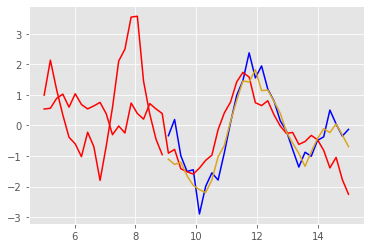

Epoch 496 batch 50 train Loss 0.1062 test Loss 0.1166 with training MSE metric 0.2861 and testing MSE metric 0.2962
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.24002981185913 secs



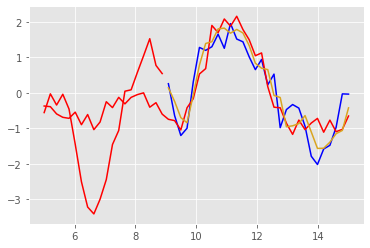

Epoch 497 batch 0 train Loss 0.1095 test Loss 0.1127 with training MSE metric 0.2875 and testing MSE metric 0.2895
learning rate is 0.0003000000142492354


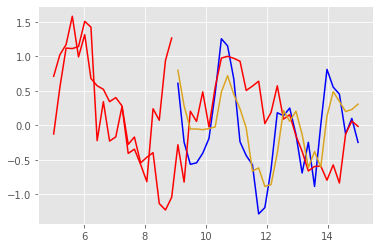

Epoch 497 batch 50 train Loss 0.1058 test Loss 0.0985 with training MSE metric 0.2811 and testing MSE metric 0.2763
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.280326128005981 secs



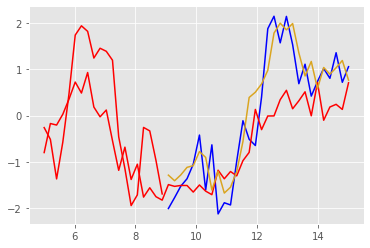

Epoch 498 batch 0 train Loss 0.1254 test Loss 0.1183 with training MSE metric 0.3060 and testing MSE metric 0.2934
learning rate is 0.0003000000142492354


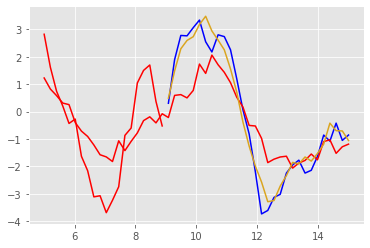

Epoch 498 batch 50 train Loss 0.1228 test Loss 0.1177 with training MSE metric 0.3073 and testing MSE metric 0.2948
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.592105865478516 secs



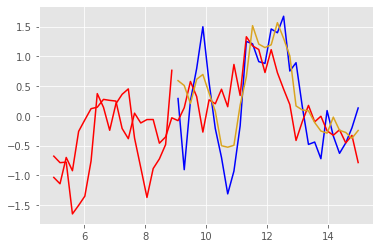

Epoch 499 batch 0 train Loss 0.0915 test Loss 0.0824 with training MSE metric 0.2669 and testing MSE metric 0.2573
learning rate is 0.0003000000142492354


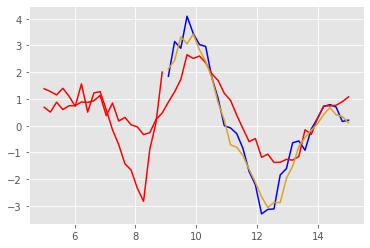

Epoch 499 batch 50 train Loss 0.1063 test Loss 0.1146 with training MSE metric 0.2845 and testing MSE metric 0.2943
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.401606321334839 secs



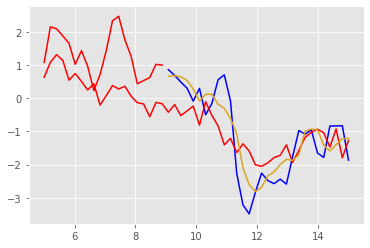

Epoch 500 batch 0 train Loss 0.1262 test Loss 0.1082 with training MSE metric 0.3096 and testing MSE metric 0.2847
learning rate is 0.0003000000142492354


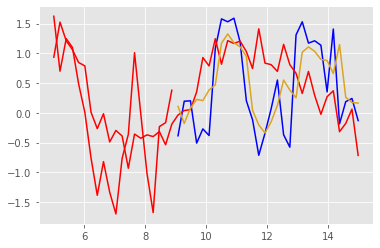

Epoch 500 batch 50 train Loss 0.1409 test Loss 0.0987 with training MSE metric 0.3271 and testing MSE metric 0.2746
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.03444790840149 secs



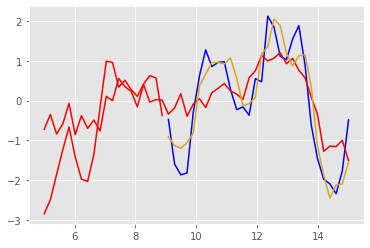

Epoch 501 batch 0 train Loss 0.1119 test Loss 0.0984 with training MSE metric 0.2882 and testing MSE metric 0.2738
learning rate is 0.0003000000142492354


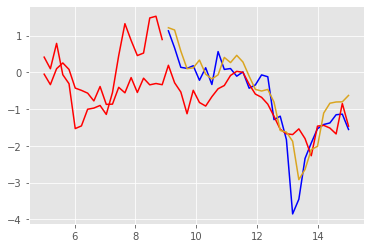

Epoch 501 batch 50 train Loss 0.1473 test Loss 0.1131 with training MSE metric 0.3317 and testing MSE metric 0.2914
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.542577743530273 secs



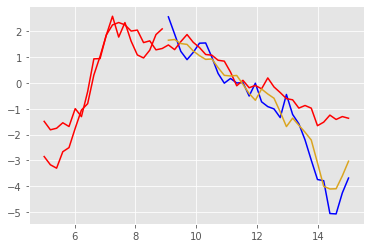

Epoch 502 batch 0 train Loss 0.1141 test Loss 0.1141 with training MSE metric 0.2958 and testing MSE metric 0.2932
learning rate is 0.0003000000142492354


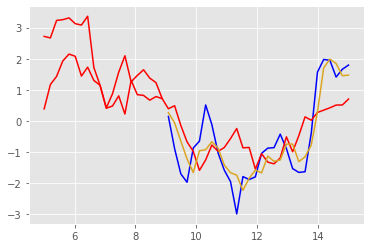

Epoch 502 batch 50 train Loss 0.1166 test Loss 0.1175 with training MSE metric 0.2960 and testing MSE metric 0.2956
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.967309951782227 secs



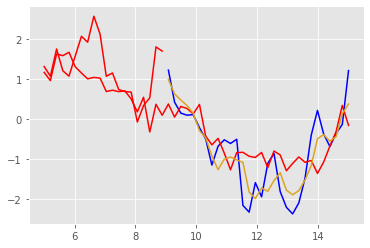

Epoch 503 batch 0 train Loss 0.1192 test Loss 0.0953 with training MSE metric 0.2967 and testing MSE metric 0.2728
learning rate is 0.0003000000142492354


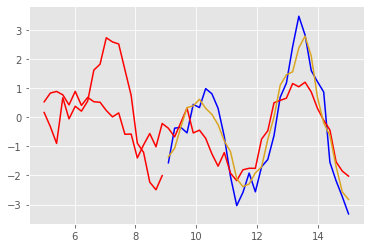

Epoch 503 batch 50 train Loss 0.1071 test Loss 0.1088 with training MSE metric 0.2850 and testing MSE metric 0.2850
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.424552202224731 secs



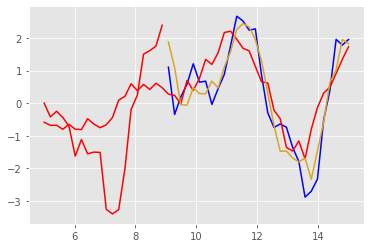

Epoch 504 batch 0 train Loss 0.0998 test Loss 0.1239 with training MSE metric 0.2777 and testing MSE metric 0.3014
learning rate is 0.0003000000142492354


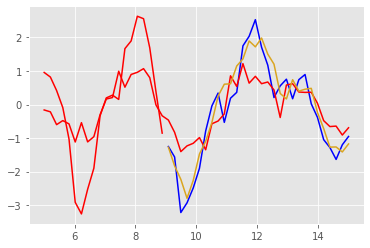

Epoch 504 batch 50 train Loss 0.1035 test Loss 0.1080 with training MSE metric 0.2807 and testing MSE metric 0.2836
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.390360116958618 secs



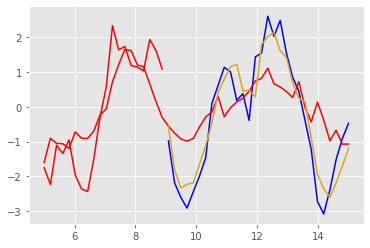

Epoch 505 batch 0 train Loss 0.0923 test Loss 0.1084 with training MSE metric 0.2696 and testing MSE metric 0.2853
learning rate is 0.0003000000142492354


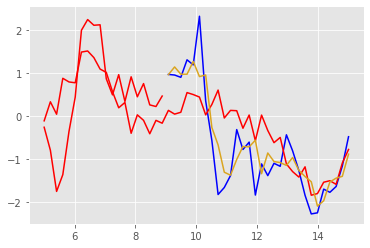

Epoch 505 batch 50 train Loss 0.1112 test Loss 0.1140 with training MSE metric 0.2898 and testing MSE metric 0.2914
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.172259092330933 secs



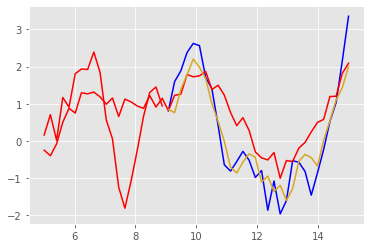

Epoch 506 batch 0 train Loss 0.1189 test Loss 0.1241 with training MSE metric 0.3019 and testing MSE metric 0.3080
learning rate is 0.0003000000142492354


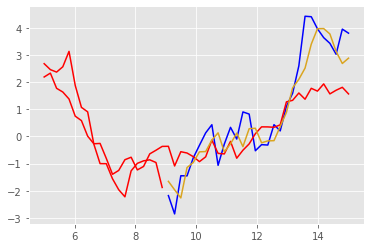

Epoch 506 batch 50 train Loss 0.0927 test Loss 0.0980 with training MSE metric 0.2688 and testing MSE metric 0.2768
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.556648969650269 secs



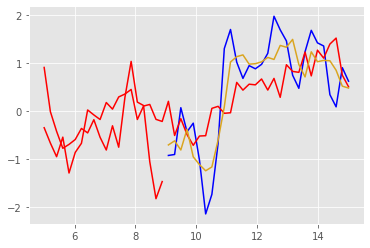

Epoch 507 batch 0 train Loss 0.1312 test Loss 0.1128 with training MSE metric 0.3106 and testing MSE metric 0.2916
learning rate is 0.0003000000142492354


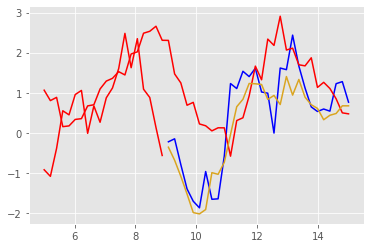

Epoch 507 batch 50 train Loss 0.1260 test Loss 0.1102 with training MSE metric 0.3049 and testing MSE metric 0.2905
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.504264116287231 secs



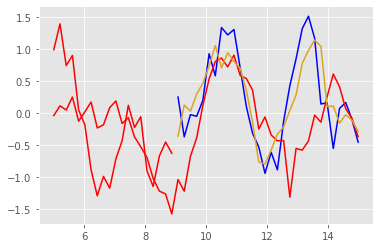

Epoch 508 batch 0 train Loss 0.1027 test Loss 0.1053 with training MSE metric 0.2831 and testing MSE metric 0.2821
learning rate is 0.0003000000142492354


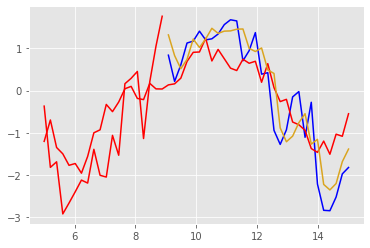

Epoch 508 batch 50 train Loss 0.1297 test Loss 0.1088 with training MSE metric 0.3097 and testing MSE metric 0.2869
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.2245512008667 secs



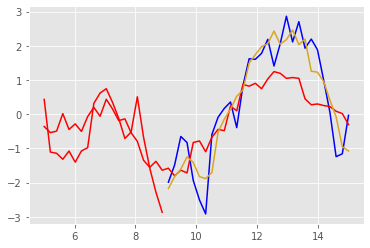

Epoch 509 batch 0 train Loss 0.1398 test Loss 0.1155 with training MSE metric 0.3274 and testing MSE metric 0.2954
learning rate is 0.0003000000142492354


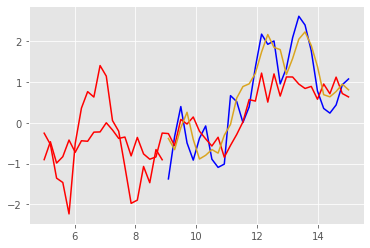

Epoch 509 batch 50 train Loss 0.1115 test Loss 0.1180 with training MSE metric 0.2913 and testing MSE metric 0.2982
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.39540410041809 secs



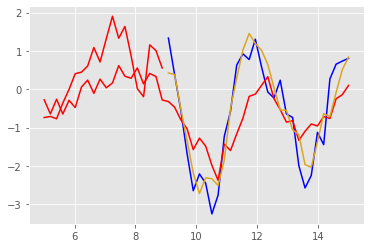

Epoch 510 batch 0 train Loss 0.0824 test Loss 0.1132 with training MSE metric 0.2523 and testing MSE metric 0.2908
learning rate is 0.0003000000142492354


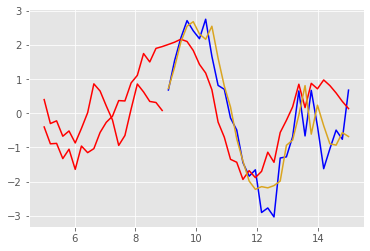

Epoch 510 batch 50 train Loss 0.0916 test Loss 0.1130 with training MSE metric 0.2672 and testing MSE metric 0.2925
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.679296970367432 secs



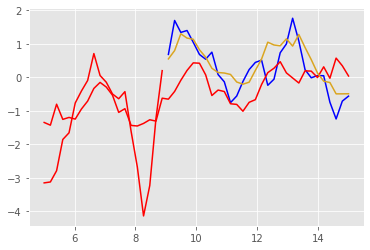

Epoch 511 batch 0 train Loss 0.1125 test Loss 0.0954 with training MSE metric 0.2904 and testing MSE metric 0.2675
learning rate is 0.0003000000142492354


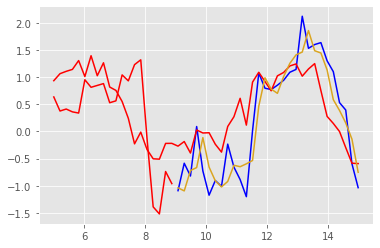

Epoch 511 batch 50 train Loss 0.1089 test Loss 0.0800 with training MSE metric 0.2866 and testing MSE metric 0.2538
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.151449203491211 secs



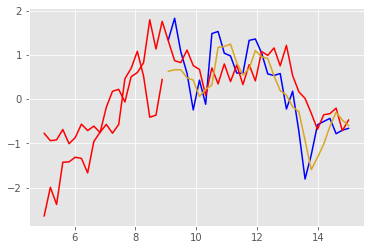

Epoch 512 batch 0 train Loss 0.0990 test Loss 0.0870 with training MSE metric 0.2761 and testing MSE metric 0.2600
learning rate is 0.0003000000142492354


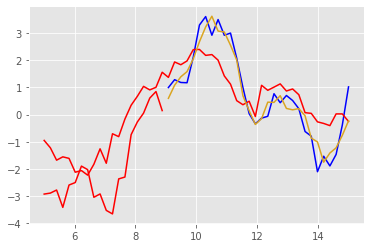

Epoch 512 batch 50 train Loss 0.1219 test Loss 0.1215 with training MSE metric 0.3034 and testing MSE metric 0.2995
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.529398918151855 secs



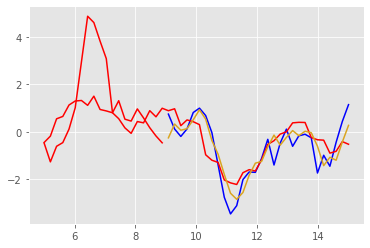

Epoch 513 batch 0 train Loss 0.1402 test Loss 0.0841 with training MSE metric 0.3263 and testing MSE metric 0.2605
learning rate is 0.0003000000142492354


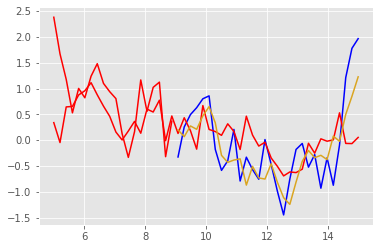

Epoch 513 batch 50 train Loss 0.0986 test Loss 0.1087 with training MSE metric 0.2750 and testing MSE metric 0.2879
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 15.703800201416016 secs



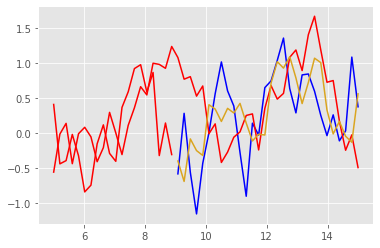

Epoch 514 batch 0 train Loss 0.0815 test Loss 0.1252 with training MSE metric 0.2520 and testing MSE metric 0.3031
learning rate is 0.0003000000142492354


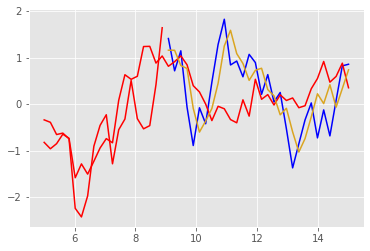

Epoch 514 batch 50 train Loss 0.1362 test Loss 0.0907 with training MSE metric 0.3207 and testing MSE metric 0.2673
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 16.989442110061646 secs



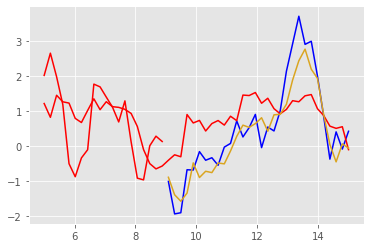

Epoch 515 batch 0 train Loss 0.0993 test Loss 0.1364 with training MSE metric 0.2776 and testing MSE metric 0.3181
learning rate is 0.0003000000142492354


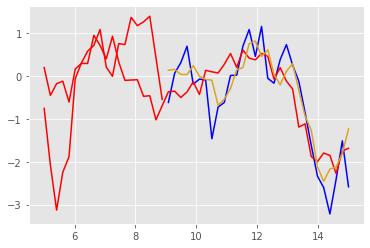

Epoch 515 batch 50 train Loss 0.1420 test Loss 0.1092 with training MSE metric 0.3283 and testing MSE metric 0.2883
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 16.134455919265747 secs



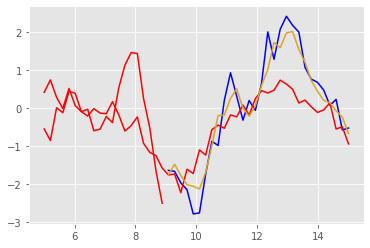

Epoch 516 batch 0 train Loss 0.1155 test Loss 0.1142 with training MSE metric 0.2940 and testing MSE metric 0.2924
learning rate is 0.0003000000142492354


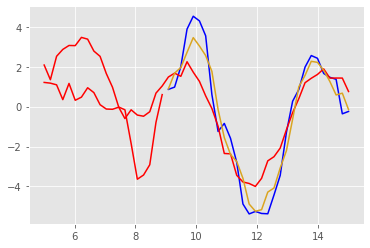

Epoch 516 batch 50 train Loss 0.1180 test Loss 0.1269 with training MSE metric 0.3033 and testing MSE metric 0.3067
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 16.947328090667725 secs



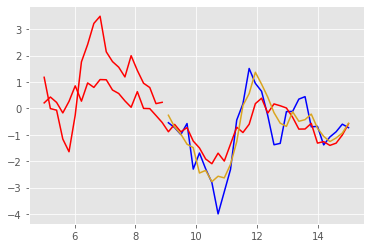

Epoch 517 batch 0 train Loss 0.1003 test Loss 0.0937 with training MSE metric 0.2707 and testing MSE metric 0.2660
learning rate is 0.0003000000142492354


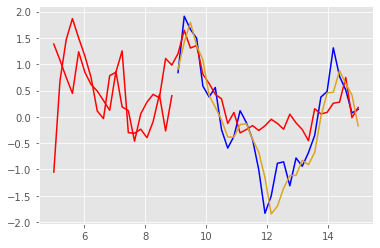

Epoch 517 batch 50 train Loss 0.0986 test Loss 0.0967 with training MSE metric 0.2765 and testing MSE metric 0.2747
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 15.962923049926758 secs



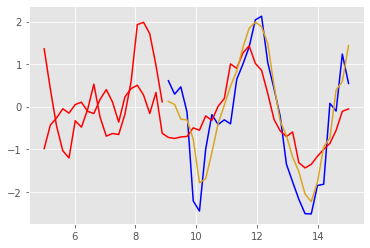

Epoch 518 batch 0 train Loss 0.1182 test Loss 0.1229 with training MSE metric 0.2965 and testing MSE metric 0.3022
learning rate is 0.0003000000142492354


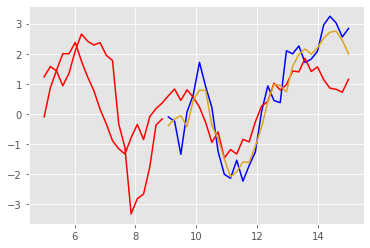

Epoch 518 batch 50 train Loss 0.1407 test Loss 0.1122 with training MSE metric 0.3259 and testing MSE metric 0.2938
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 16.6840980052948 secs



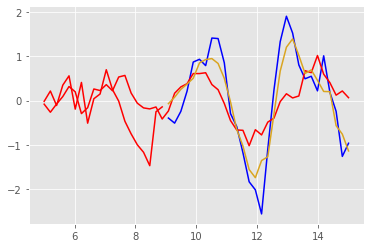

Epoch 519 batch 0 train Loss 0.1468 test Loss 0.0994 with training MSE metric 0.3269 and testing MSE metric 0.2747
learning rate is 0.0003000000142492354


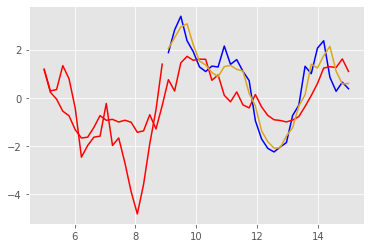

Epoch 519 batch 50 train Loss 0.1090 test Loss 0.1395 with training MSE metric 0.2892 and testing MSE metric 0.3208
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 21.755682945251465 secs



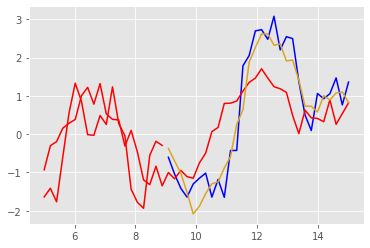

Epoch 520 batch 0 train Loss 0.1131 test Loss 0.1130 with training MSE metric 0.2929 and testing MSE metric 0.2904
learning rate is 0.0003000000142492354


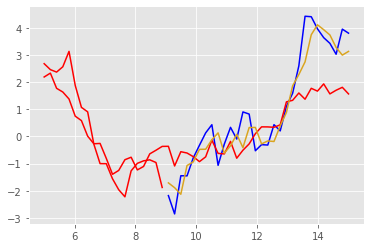

Epoch 520 batch 50 train Loss 0.1129 test Loss 0.1210 with training MSE metric 0.2928 and testing MSE metric 0.2998
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 20.083831071853638 secs



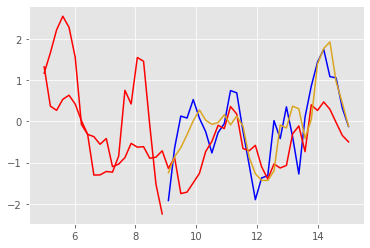

Epoch 521 batch 0 train Loss 0.1184 test Loss 0.1221 with training MSE metric 0.2969 and testing MSE metric 0.3024
learning rate is 0.0003000000142492354


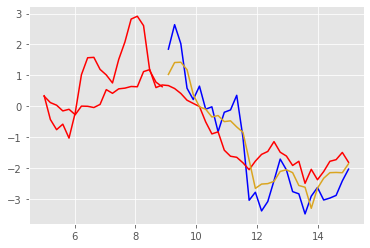

Epoch 521 batch 50 train Loss 0.1157 test Loss 0.1313 with training MSE metric 0.2949 and testing MSE metric 0.3126
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 19.16910696029663 secs



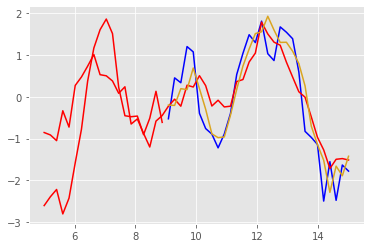

Epoch 522 batch 0 train Loss 0.1140 test Loss 0.0952 with training MSE metric 0.2953 and testing MSE metric 0.2695
learning rate is 0.0003000000142492354


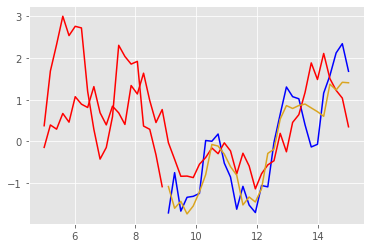

Epoch 522 batch 50 train Loss 0.1112 test Loss 0.0978 with training MSE metric 0.2911 and testing MSE metric 0.2727
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 17.71755814552307 secs



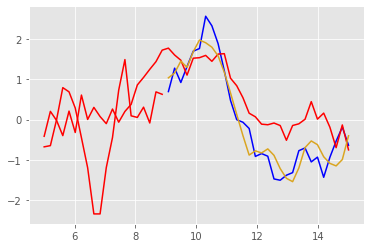

Epoch 523 batch 0 train Loss 0.1096 test Loss 0.0949 with training MSE metric 0.2855 and testing MSE metric 0.2704
learning rate is 0.0003000000142492354


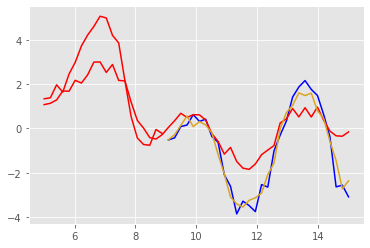

Epoch 523 batch 50 train Loss 0.1333 test Loss 0.1116 with training MSE metric 0.3155 and testing MSE metric 0.2917
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 17.195651054382324 secs



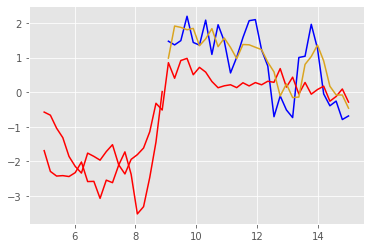

Epoch 524 batch 0 train Loss 0.1263 test Loss 0.1105 with training MSE metric 0.3033 and testing MSE metric 0.2883
learning rate is 0.0003000000142492354


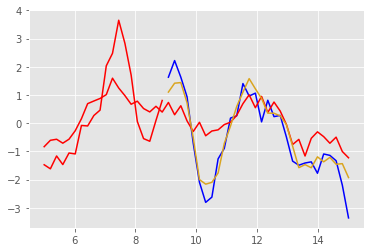

Epoch 524 batch 50 train Loss 0.0762 test Loss 0.1309 with training MSE metric 0.2504 and testing MSE metric 0.3128
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 16.071366786956787 secs



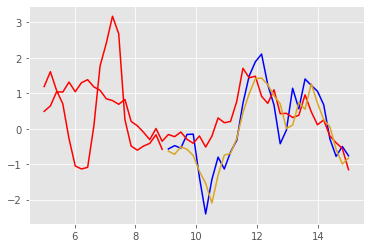

Epoch 525 batch 0 train Loss 0.1196 test Loss 0.0939 with training MSE metric 0.3011 and testing MSE metric 0.2715
learning rate is 0.0003000000142492354


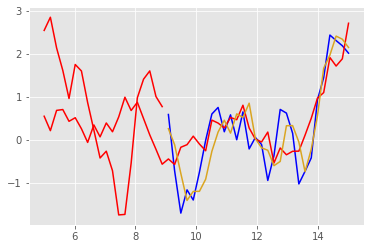

Epoch 525 batch 50 train Loss 0.0796 test Loss 0.1116 with training MSE metric 0.2522 and testing MSE metric 0.2889
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.98531985282898 secs



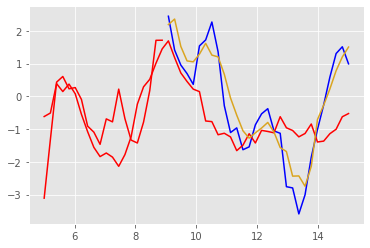

Epoch 526 batch 0 train Loss 0.1232 test Loss 0.1177 with training MSE metric 0.3043 and testing MSE metric 0.2970
learning rate is 0.0003000000142492354


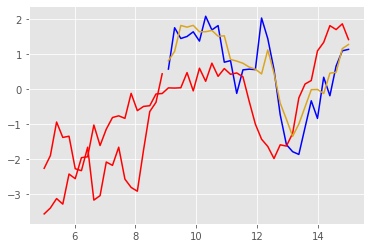

Epoch 526 batch 50 train Loss 0.1197 test Loss 0.0867 with training MSE metric 0.3000 and testing MSE metric 0.2592
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.382871866226196 secs



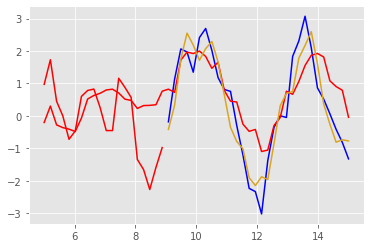

Epoch 527 batch 0 train Loss 0.1126 test Loss 0.1093 with training MSE metric 0.2921 and testing MSE metric 0.2865
learning rate is 0.0003000000142492354


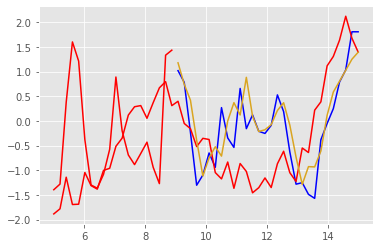

Epoch 527 batch 50 train Loss 0.1185 test Loss 0.1103 with training MSE metric 0.2946 and testing MSE metric 0.2881
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.018496990203857 secs



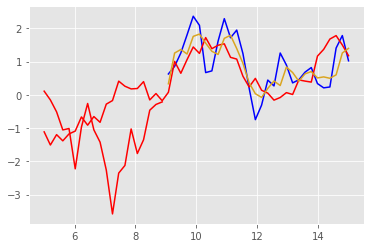

Epoch 528 batch 0 train Loss 0.1214 test Loss 0.1118 with training MSE metric 0.3016 and testing MSE metric 0.2914
learning rate is 0.0003000000142492354


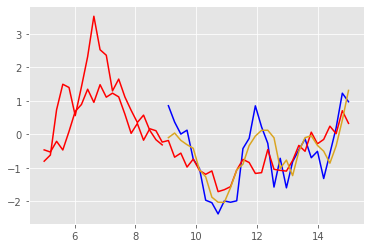

Epoch 528 batch 50 train Loss 0.1109 test Loss 0.1126 with training MSE metric 0.2889 and testing MSE metric 0.2909
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.342631101608276 secs



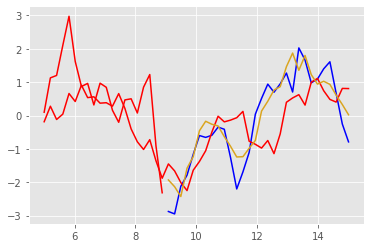

Epoch 529 batch 0 train Loss 0.0873 test Loss 0.0947 with training MSE metric 0.2601 and testing MSE metric 0.2714
learning rate is 0.0003000000142492354


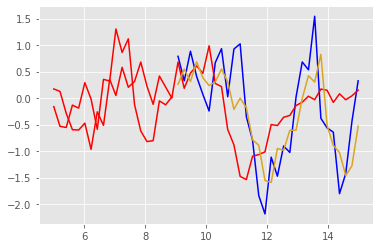

Epoch 529 batch 50 train Loss 0.1150 test Loss 0.1206 with training MSE metric 0.2934 and testing MSE metric 0.3011
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.045956134796143 secs



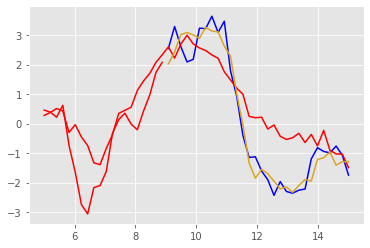

Epoch 530 batch 0 train Loss 0.1043 test Loss 0.1250 with training MSE metric 0.2855 and testing MSE metric 0.3013
learning rate is 0.0003000000142492354


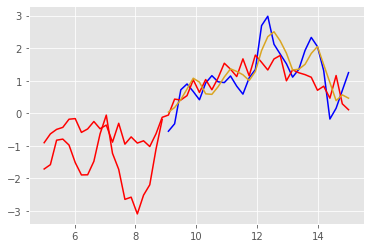

Epoch 530 batch 50 train Loss 0.1163 test Loss 0.1097 with training MSE metric 0.2944 and testing MSE metric 0.2851
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.126843929290771 secs



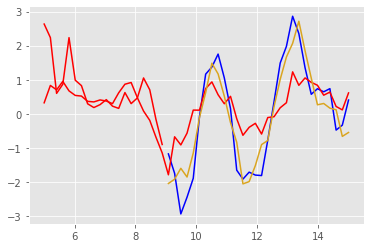

Epoch 531 batch 0 train Loss 0.1182 test Loss 0.1059 with training MSE metric 0.3034 and testing MSE metric 0.2824
learning rate is 0.0003000000142492354


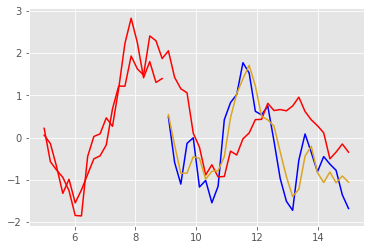

Epoch 531 batch 50 train Loss 0.1009 test Loss 0.0952 with training MSE metric 0.2770 and testing MSE metric 0.2702
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.589312076568604 secs



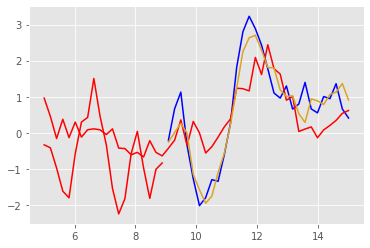

Epoch 532 batch 0 train Loss 0.0948 test Loss 0.0891 with training MSE metric 0.2698 and testing MSE metric 0.2621
learning rate is 0.0003000000142492354


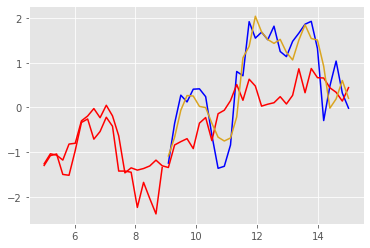

Epoch 532 batch 50 train Loss 0.1072 test Loss 0.1142 with training MSE metric 0.2841 and testing MSE metric 0.2916
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.523844957351685 secs



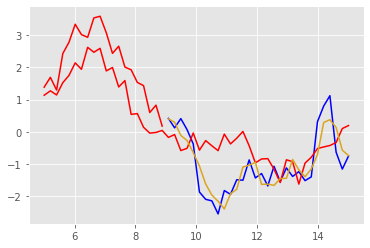

Epoch 533 batch 0 train Loss 0.0973 test Loss 0.1052 with training MSE metric 0.2705 and testing MSE metric 0.2808
learning rate is 0.0003000000142492354


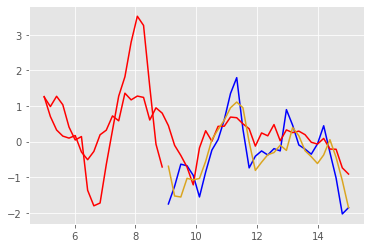

Epoch 533 batch 50 train Loss 0.1187 test Loss 0.1241 with training MSE metric 0.2975 and testing MSE metric 0.3079
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.813650846481323 secs



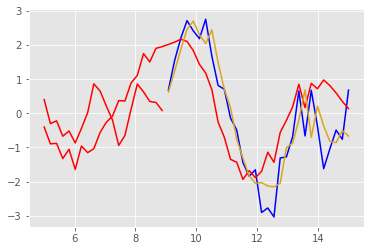

Epoch 534 batch 0 train Loss 0.1068 test Loss 0.1211 with training MSE metric 0.2832 and testing MSE metric 0.3015
learning rate is 0.0003000000142492354


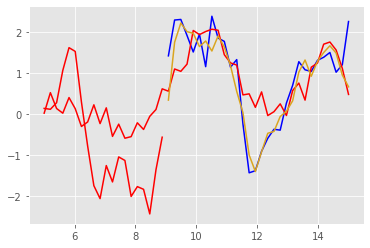

Epoch 534 batch 50 train Loss 0.1083 test Loss 0.1257 with training MSE metric 0.2894 and testing MSE metric 0.3074
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 14.629248142242432 secs



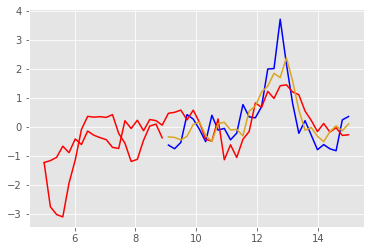

Epoch 535 batch 0 train Loss 0.1277 test Loss 0.1038 with training MSE metric 0.3071 and testing MSE metric 0.2833
learning rate is 0.0003000000142492354


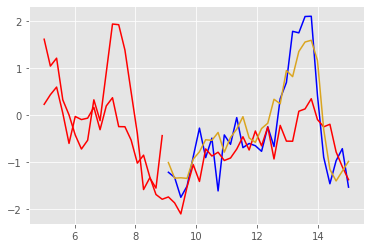

Epoch 535 batch 50 train Loss 0.1252 test Loss 0.0896 with training MSE metric 0.3085 and testing MSE metric 0.2653
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 15.815396070480347 secs



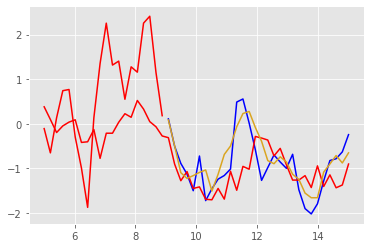

Epoch 536 batch 0 train Loss 0.1271 test Loss 0.1168 with training MSE metric 0.3101 and testing MSE metric 0.2951
learning rate is 0.0003000000142492354


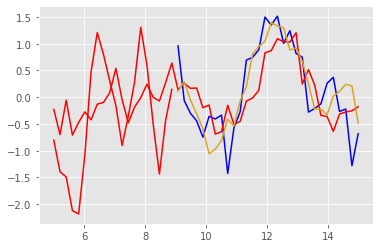

Epoch 536 batch 50 train Loss 0.1217 test Loss 0.1147 with training MSE metric 0.3007 and testing MSE metric 0.2924
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 17.27584171295166 secs



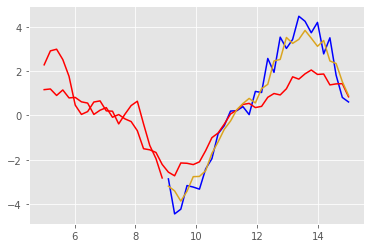

Epoch 537 batch 0 train Loss 0.1340 test Loss 0.1051 with training MSE metric 0.3179 and testing MSE metric 0.2837
learning rate is 0.0003000000142492354


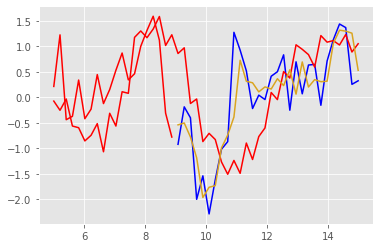

Epoch 537 batch 50 train Loss 0.1393 test Loss 0.1303 with training MSE metric 0.3176 and testing MSE metric 0.3099
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 20.150086879730225 secs



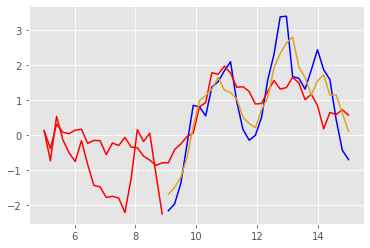

Epoch 538 batch 0 train Loss 0.1030 test Loss 0.1055 with training MSE metric 0.2800 and testing MSE metric 0.2823
learning rate is 0.0003000000142492354


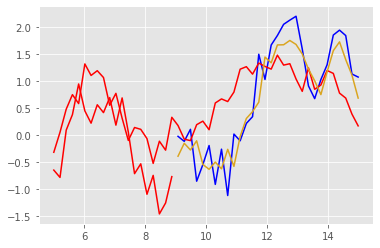

Epoch 538 batch 50 train Loss 0.1192 test Loss 0.1218 with training MSE metric 0.3012 and testing MSE metric 0.3049
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 16.957803964614868 secs



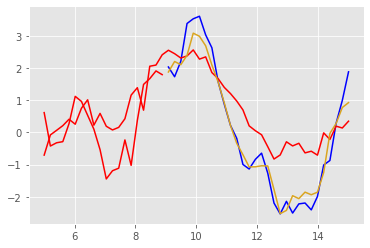

Epoch 539 batch 0 train Loss 0.1212 test Loss 0.1065 with training MSE metric 0.3015 and testing MSE metric 0.2854
learning rate is 0.0003000000142492354


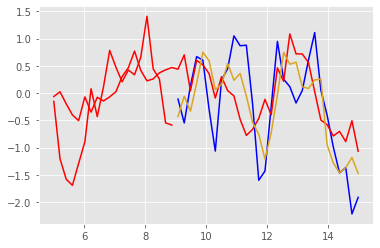

Epoch 539 batch 50 train Loss 0.1112 test Loss 0.1184 with training MSE metric 0.2893 and testing MSE metric 0.2986
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 13.969892024993896 secs



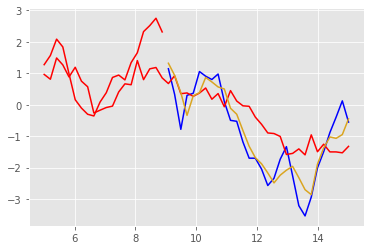

Epoch 540 batch 0 train Loss 0.1402 test Loss 0.1330 with training MSE metric 0.3176 and testing MSE metric 0.3127
learning rate is 0.0003000000142492354


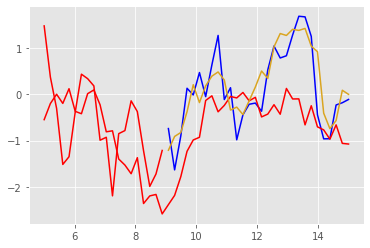

Epoch 540 batch 50 train Loss 0.1094 test Loss 0.1168 with training MSE metric 0.2873 and testing MSE metric 0.2938
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 12.315433979034424 secs



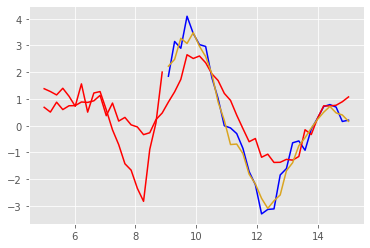

Epoch 541 batch 0 train Loss 0.1172 test Loss 0.1046 with training MSE metric 0.2977 and testing MSE metric 0.2831
learning rate is 0.0003000000142492354


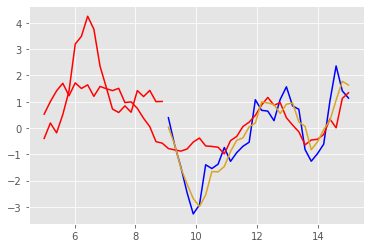

Epoch 541 batch 50 train Loss 0.1226 test Loss 0.1167 with training MSE metric 0.3028 and testing MSE metric 0.2970
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.266933917999268 secs



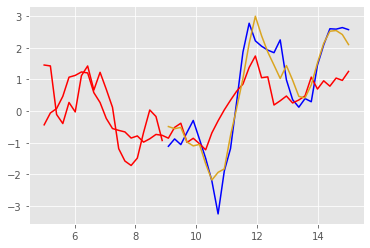

Epoch 542 batch 0 train Loss 0.1200 test Loss 0.1225 with training MSE metric 0.2958 and testing MSE metric 0.2999
learning rate is 0.0003000000142492354


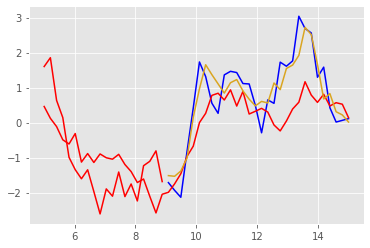

Epoch 542 batch 50 train Loss 0.1253 test Loss 0.1339 with training MSE metric 0.3052 and testing MSE metric 0.3160
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.535264015197754 secs



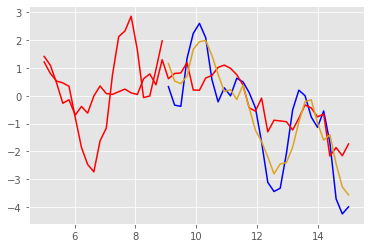

Epoch 543 batch 0 train Loss 0.1190 test Loss 0.1357 with training MSE metric 0.2986 and testing MSE metric 0.3181
learning rate is 0.0003000000142492354


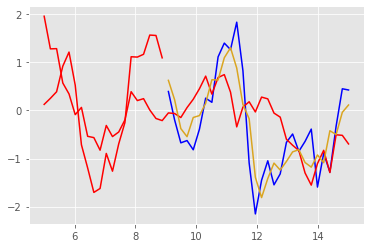

Epoch 543 batch 50 train Loss 0.1316 test Loss 0.1121 with training MSE metric 0.3139 and testing MSE metric 0.2909
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.104099750518799 secs



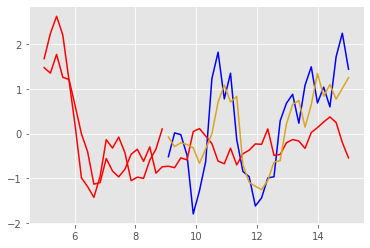

Epoch 544 batch 0 train Loss 0.0919 test Loss 0.1170 with training MSE metric 0.2707 and testing MSE metric 0.2958
learning rate is 0.0003000000142492354


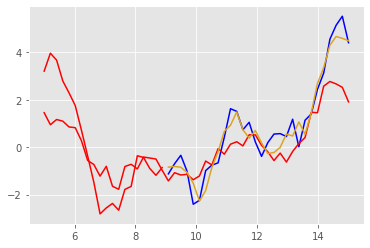

Epoch 544 batch 50 train Loss 0.1239 test Loss 0.0992 with training MSE metric 0.3026 and testing MSE metric 0.2750
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.150362014770508 secs



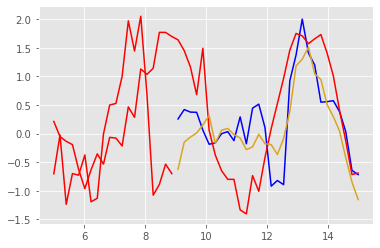

Epoch 545 batch 0 train Loss 0.1031 test Loss 0.1271 with training MSE metric 0.2821 and testing MSE metric 0.3073
learning rate is 0.0003000000142492354


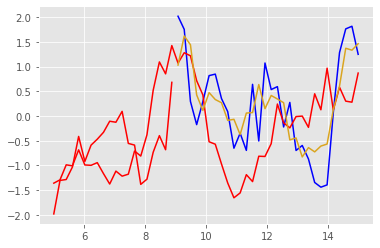

Epoch 545 batch 50 train Loss 0.1313 test Loss 0.1399 with training MSE metric 0.3138 and testing MSE metric 0.3230
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.217285871505737 secs



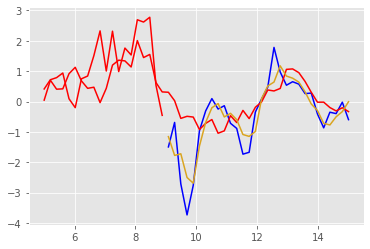

Epoch 546 batch 0 train Loss 0.1266 test Loss 0.1003 with training MSE metric 0.3122 and testing MSE metric 0.2783
learning rate is 0.0003000000142492354


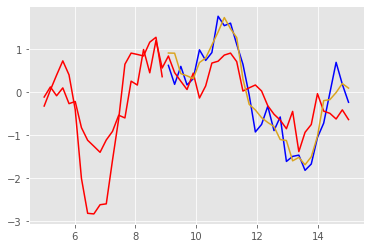

Epoch 546 batch 50 train Loss 0.1111 test Loss 0.0908 with training MSE metric 0.2908 and testing MSE metric 0.2658
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.346043348312378 secs



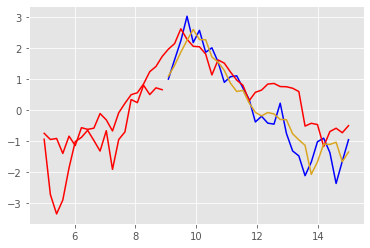

Epoch 547 batch 0 train Loss 0.1034 test Loss 0.0934 with training MSE metric 0.2785 and testing MSE metric 0.2679
learning rate is 0.0003000000142492354


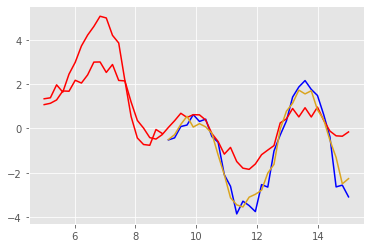

Epoch 547 batch 50 train Loss 0.1145 test Loss 0.1283 with training MSE metric 0.2939 and testing MSE metric 0.3097
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.669116973876953 secs



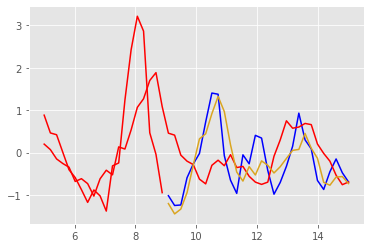

Epoch 548 batch 0 train Loss 0.1009 test Loss 0.1028 with training MSE metric 0.2768 and testing MSE metric 0.2808
learning rate is 0.0003000000142492354


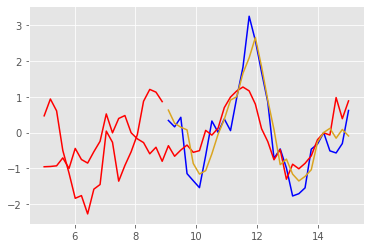

Epoch 548 batch 50 train Loss 0.1122 test Loss 0.0889 with training MSE metric 0.2917 and testing MSE metric 0.2626
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.861079216003418 secs



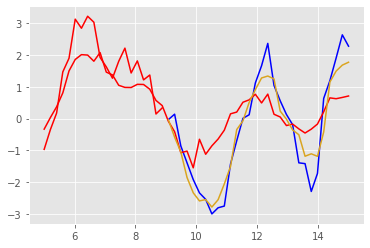

Epoch 549 batch 0 train Loss 0.1064 test Loss 0.1109 with training MSE metric 0.2845 and testing MSE metric 0.2906
learning rate is 0.0003000000142492354


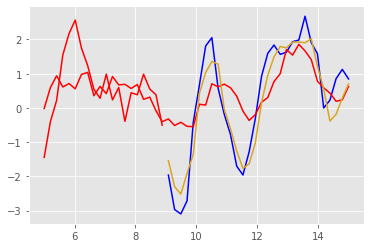

Epoch 549 batch 50 train Loss 0.1636 test Loss 0.1087 with training MSE metric 0.3536 and testing MSE metric 0.2883
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.521071910858154 secs



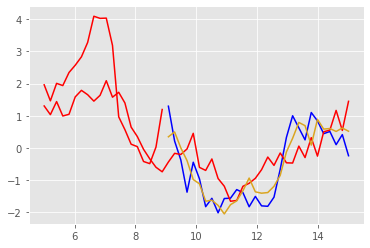

Epoch 550 batch 0 train Loss 0.1294 test Loss 0.1222 with training MSE metric 0.3108 and testing MSE metric 0.3023
learning rate is 0.0003000000142492354


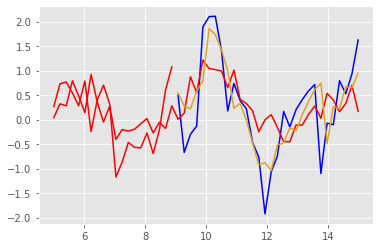

Epoch 550 batch 50 train Loss 0.1268 test Loss 0.1186 with training MSE metric 0.3119 and testing MSE metric 0.2938
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.955462217330933 secs



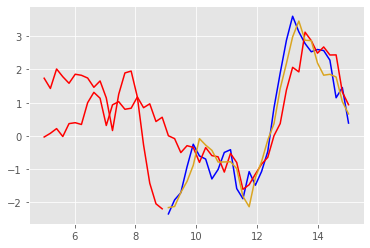

Epoch 551 batch 0 train Loss 0.1104 test Loss 0.1326 with training MSE metric 0.2847 and testing MSE metric 0.3106
learning rate is 0.0003000000142492354


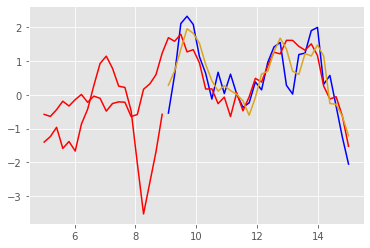

Epoch 551 batch 50 train Loss 0.1033 test Loss 0.1250 with training MSE metric 0.2816 and testing MSE metric 0.3086
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 11.364950180053711 secs



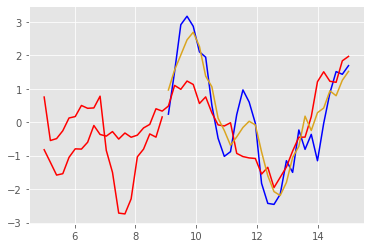

Epoch 552 batch 0 train Loss 0.1286 test Loss 0.1113 with training MSE metric 0.3126 and testing MSE metric 0.2913
learning rate is 0.0003000000142492354


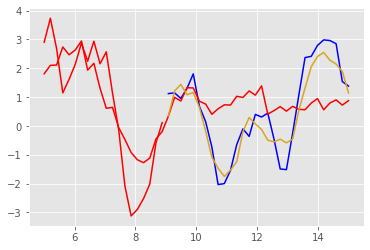

Epoch 552 batch 50 train Loss 0.1023 test Loss 0.1076 with training MSE metric 0.2808 and testing MSE metric 0.2859
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.898455142974854 secs



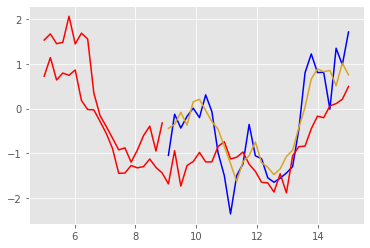

Epoch 553 batch 0 train Loss 0.1265 test Loss 0.1279 with training MSE metric 0.3103 and testing MSE metric 0.3140
learning rate is 0.0003000000142492354


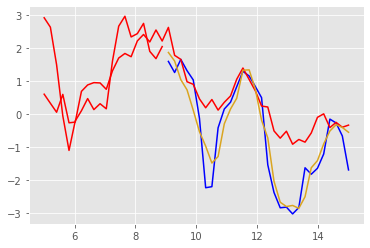

Epoch 553 batch 50 train Loss 0.1031 test Loss 0.1040 with training MSE metric 0.2805 and testing MSE metric 0.2786
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.88914704322815 secs



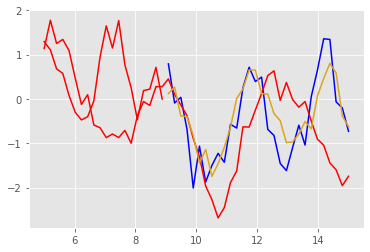

Epoch 554 batch 0 train Loss 0.1140 test Loss 0.1056 with training MSE metric 0.2954 and testing MSE metric 0.2830
learning rate is 0.0003000000142492354


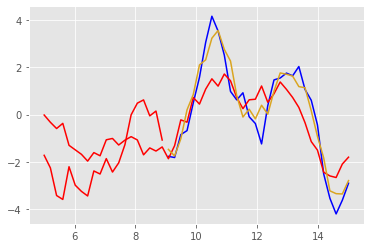

Epoch 554 batch 50 train Loss 0.1270 test Loss 0.1239 with training MSE metric 0.3087 and testing MSE metric 0.3028
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.739951848983765 secs



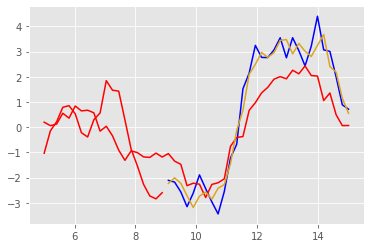

Epoch 555 batch 0 train Loss 0.1297 test Loss 0.1082 with training MSE metric 0.3125 and testing MSE metric 0.2855
learning rate is 0.0003000000142492354


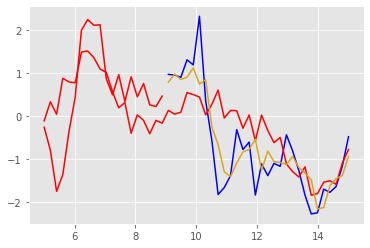

Epoch 555 batch 50 train Loss 0.1204 test Loss 0.0945 with training MSE metric 0.3019 and testing MSE metric 0.2688
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.706353187561035 secs



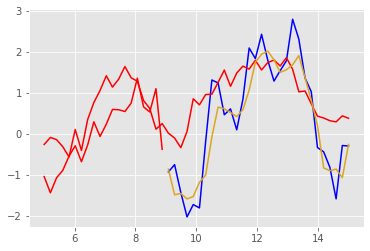

Epoch 556 batch 0 train Loss 0.1007 test Loss 0.1205 with training MSE metric 0.2735 and testing MSE metric 0.2998
learning rate is 0.0003000000142492354


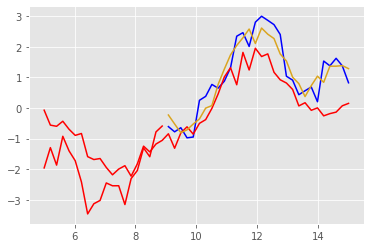

Epoch 556 batch 50 train Loss 0.1164 test Loss 0.1035 with training MSE metric 0.2931 and testing MSE metric 0.2813
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.603307962417603 secs



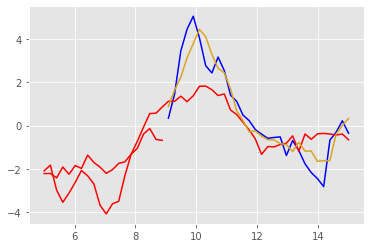

Epoch 557 batch 0 train Loss 0.1012 test Loss 0.1169 with training MSE metric 0.2781 and testing MSE metric 0.2924
learning rate is 0.0003000000142492354


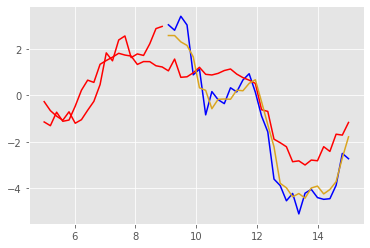

Epoch 557 batch 50 train Loss 0.1111 test Loss 0.1116 with training MSE metric 0.2876 and testing MSE metric 0.2877
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.274657011032104 secs



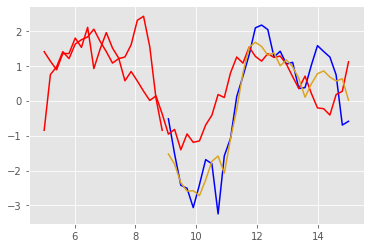

Epoch 558 batch 0 train Loss 0.1214 test Loss 0.1231 with training MSE metric 0.3008 and testing MSE metric 0.3052
learning rate is 0.0003000000142492354


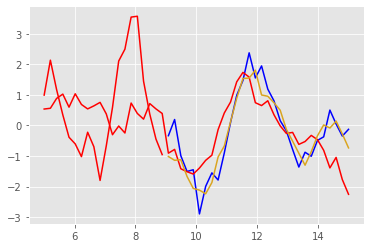

Epoch 558 batch 50 train Loss 0.1302 test Loss 0.0904 with training MSE metric 0.3117 and testing MSE metric 0.2669
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.150707006454468 secs



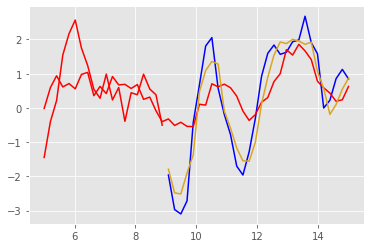

Epoch 559 batch 0 train Loss 0.1248 test Loss 0.1327 with training MSE metric 0.3057 and testing MSE metric 0.3097
learning rate is 0.0003000000142492354


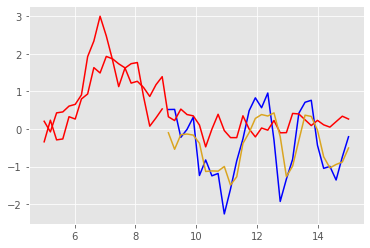

Epoch 559 batch 50 train Loss 0.1502 test Loss 0.1112 with training MSE metric 0.3379 and testing MSE metric 0.2906
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.262171983718872 secs



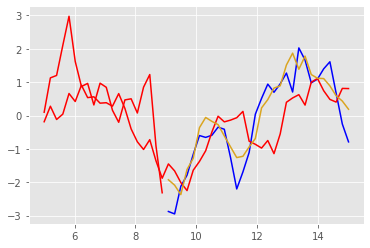

Epoch 560 batch 0 train Loss 0.1198 test Loss 0.1162 with training MSE metric 0.3032 and testing MSE metric 0.2930
learning rate is 0.0003000000142492354


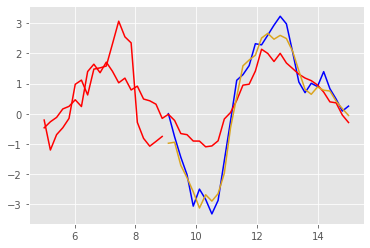

Epoch 560 batch 50 train Loss 0.0983 test Loss 0.1208 with training MSE metric 0.2761 and testing MSE metric 0.2993
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.757751226425171 secs



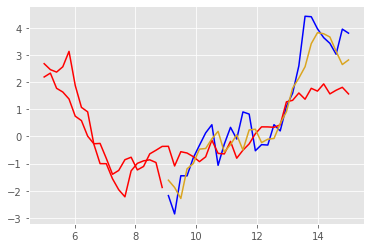

Epoch 561 batch 0 train Loss 0.0836 test Loss 0.1128 with training MSE metric 0.2564 and testing MSE metric 0.2909
learning rate is 0.0003000000142492354


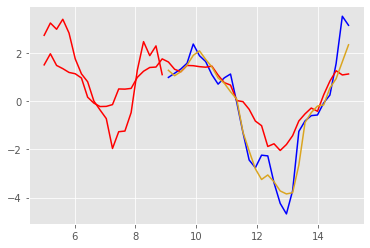

Epoch 561 batch 50 train Loss 0.0933 test Loss 0.1049 with training MSE metric 0.2691 and testing MSE metric 0.2851
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.97276782989502 secs



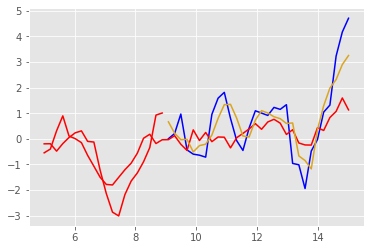

Epoch 562 batch 0 train Loss 0.1110 test Loss 0.1096 with training MSE metric 0.2900 and testing MSE metric 0.2902
learning rate is 0.0003000000142492354


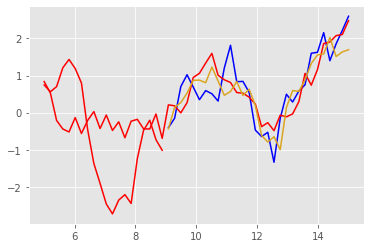

Epoch 562 batch 50 train Loss 0.0808 test Loss 0.1081 with training MSE metric 0.2510 and testing MSE metric 0.2872
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.955241918563843 secs



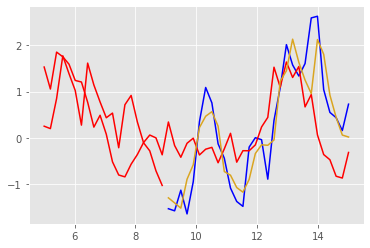

Epoch 563 batch 0 train Loss 0.0902 test Loss 0.1136 with training MSE metric 0.2673 and testing MSE metric 0.2923
learning rate is 0.0003000000142492354


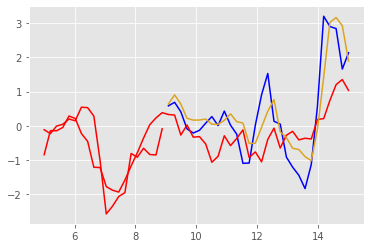

Epoch 563 batch 50 train Loss 0.1094 test Loss 0.1165 with training MSE metric 0.2909 and testing MSE metric 0.2950
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.05967903137207 secs



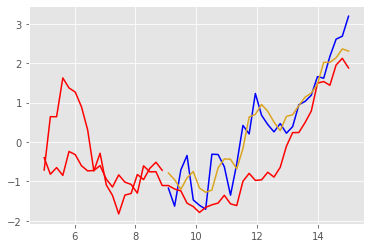

Epoch 564 batch 0 train Loss 0.1076 test Loss 0.1167 with training MSE metric 0.2852 and testing MSE metric 0.2984
learning rate is 0.0003000000142492354


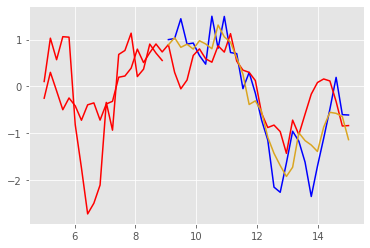

Epoch 564 batch 50 train Loss 0.1065 test Loss 0.1161 with training MSE metric 0.2821 and testing MSE metric 0.2918
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.393326759338379 secs



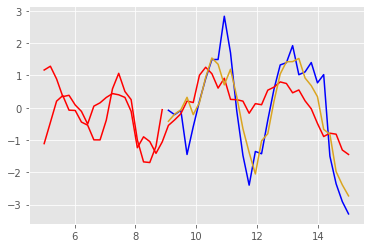

Epoch 565 batch 0 train Loss 0.1084 test Loss 0.1114 with training MSE metric 0.2864 and testing MSE metric 0.2875
learning rate is 0.0003000000142492354


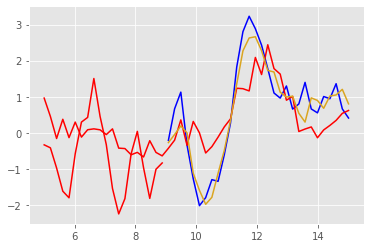

Epoch 565 batch 50 train Loss 0.0901 test Loss 0.0960 with training MSE metric 0.2655 and testing MSE metric 0.2729
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.307297229766846 secs



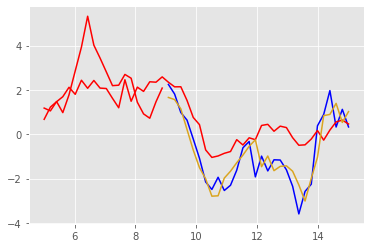

Epoch 566 batch 0 train Loss 0.0958 test Loss 0.1070 with training MSE metric 0.2743 and testing MSE metric 0.2858
learning rate is 0.0003000000142492354


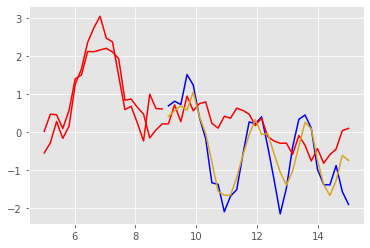

Epoch 566 batch 50 train Loss 0.1227 test Loss 0.1214 with training MSE metric 0.3012 and testing MSE metric 0.2986
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.565546035766602 secs



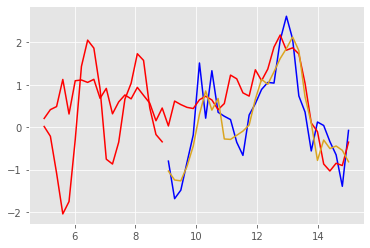

Epoch 567 batch 0 train Loss 0.1174 test Loss 0.1228 with training MSE metric 0.2951 and testing MSE metric 0.2993
learning rate is 0.0003000000142492354


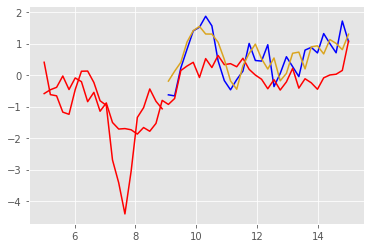

Epoch 567 batch 50 train Loss 0.0988 test Loss 0.1312 with training MSE metric 0.2754 and testing MSE metric 0.3073
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.905550956726074 secs



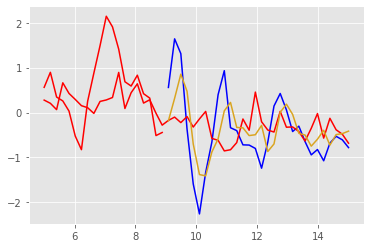

Epoch 568 batch 0 train Loss 0.1023 test Loss 0.1229 with training MSE metric 0.2794 and testing MSE metric 0.2986
learning rate is 0.0003000000142492354


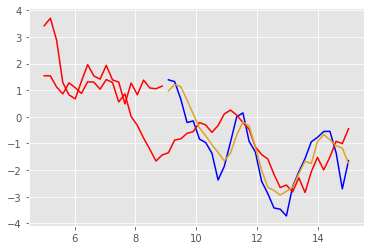

Epoch 568 batch 50 train Loss 0.1101 test Loss 0.1201 with training MSE metric 0.2883 and testing MSE metric 0.2985
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.441559076309204 secs



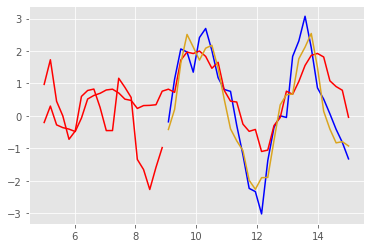

Epoch 569 batch 0 train Loss 0.0932 test Loss 0.1237 with training MSE metric 0.2678 and testing MSE metric 0.3028
learning rate is 0.0003000000142492354


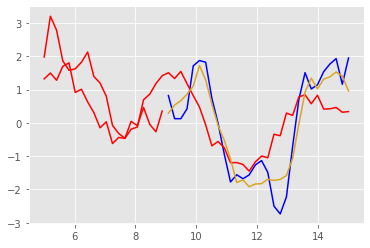

Epoch 569 batch 50 train Loss 0.0897 test Loss 0.0912 with training MSE metric 0.2642 and testing MSE metric 0.2674
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.283448219299316 secs



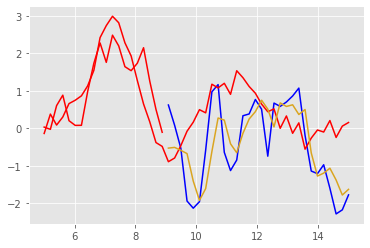

Epoch 570 batch 0 train Loss 0.1222 test Loss 0.1364 with training MSE metric 0.3024 and testing MSE metric 0.3176
learning rate is 0.0003000000142492354


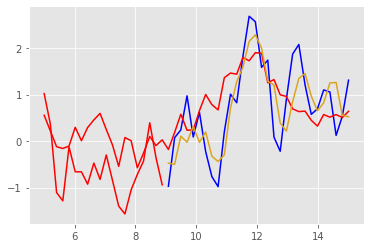

Epoch 570 batch 50 train Loss 0.1251 test Loss 0.1283 with training MSE metric 0.3059 and testing MSE metric 0.3064
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 9.94982099533081 secs



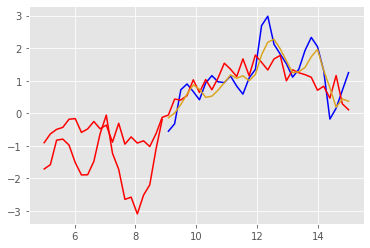

Epoch 571 batch 0 train Loss 0.0917 test Loss 0.1315 with training MSE metric 0.2664 and testing MSE metric 0.3106
learning rate is 0.0003000000142492354


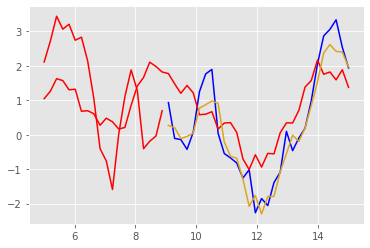

Epoch 571 batch 50 train Loss 0.1151 test Loss 0.0961 with training MSE metric 0.2980 and testing MSE metric 0.2744
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.092906951904297 secs



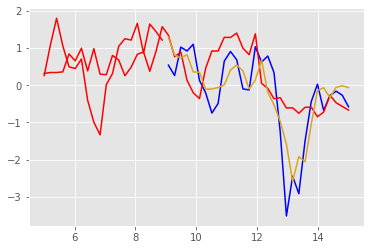

Epoch 572 batch 0 train Loss 0.1331 test Loss 0.1235 with training MSE metric 0.3177 and testing MSE metric 0.3031
learning rate is 0.0003000000142492354


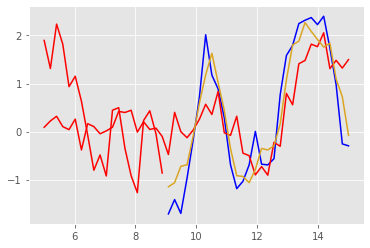

Epoch 572 batch 50 train Loss 0.1257 test Loss 0.1034 with training MSE metric 0.3039 and testing MSE metric 0.2809
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.016345739364624 secs



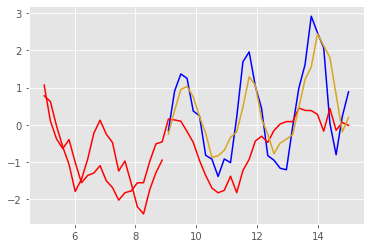

Epoch 573 batch 0 train Loss 0.1069 test Loss 0.1402 with training MSE metric 0.2863 and testing MSE metric 0.3235
learning rate is 0.0003000000142492354


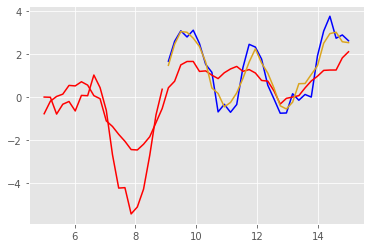

Epoch 573 batch 50 train Loss 0.1138 test Loss 0.1198 with training MSE metric 0.2919 and testing MSE metric 0.2978
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.1121187210083 secs



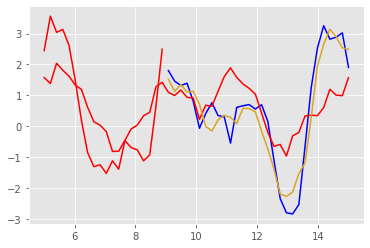

Epoch 574 batch 0 train Loss 0.1028 test Loss 0.0895 with training MSE metric 0.2841 and testing MSE metric 0.2636
learning rate is 0.0003000000142492354


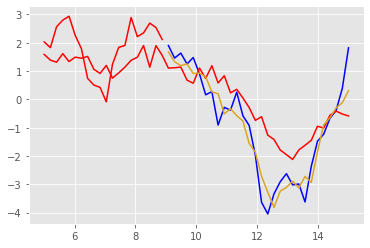

Epoch 574 batch 50 train Loss 0.0991 test Loss 0.1196 with training MSE metric 0.2784 and testing MSE metric 0.2968
learning rate is 0.0003000000142492354
Time taken for 1 epoch: 10.424329996109009 secs



In [69]:
if __name__ == '__main__':
    step = 0
    # change to run 9 if you want to overfit
    EPOCHS = 575; batch_s  = 32; run = 7; tr_regime ='shuffle'
    l= [96, 64, 32]; heads = 12; e = 96; context = 70; c=70
    decoder, optimizer_c, ckpt, manager, num_batches, writer, folder = helpers.pre_trained_loader(data[3], save_dir, e, l, d=d, batch_s=64, context=context, heads=1, run=run)
    with writer.as_default():
        for epoch in range(EPOCHS):
            start = time.time()
            for batch_n in range(100):
                m_tr.reset_states(); train_loss.reset_states()
                if d:
                    idxs = np.random.choice(np.arange(9000), 32)
                    permute_idx = np.arange(100)
                    y_tr = y[idxs, :][:, permute_idx] 
                    x_tr = batch_x
                    to_gather = helpers.gather_idx(c,  l=100, b=32)
                    temp = np.zeros((32, 100))
                    temp[to_gather[:, 0], to_gather[:, 1]] = 1
                    pred, pred_log, weights, names, shapes, y_real, g = train_step(decoder, optimizer_c, train_loss, m_tr, x_tr, y_tr, d = True, to_gather=temp)
                else:
#                     b_data = batch_creator.create_batch(em_x = data[1], x = data[3], y = data[-1], batch_s=64, d=d)
                    to_gather = helpers.gather_idx(context, l=200, b=2)
                    temp = np.zeros((b_data[0].shape[0], b_data[0].shape[1]))
                    temp[to_gather[:, 0], to_gather[:, 1]] = 1
                    pred, pred_log, weights, names, shapes, y_real, g = train_step(decoder, optimizer_c, train_loss, m_tr, x = b_data[2], y = b_data[0], y2=b_data[3], to_gather = temp)
                if (epoch == 0) & (batch_n == 0): helpers.write_speci(folder, names, shapes, context, heads)
                if batch_n % 50 == 0:
                    m_te.reset_states(); test_loss.reset_states()
                    if d:
                        idxs_te = np.random.choice(np.arange(9000, 10000), 32)
                        permute_idx_te = np.arange(100)
                        to_gather_te = helpers.gather_idx(c, l=100, b=32)
                        temp_te = np.zeros((32, 100))
                        temp_te[to_gather_te[:, 0], to_gather_te[:, 1]] = 1
                        y_te = y[idxs_te, :][:, permute_idx_te] 
                        x_te = batch_x
                        pred_te, pred_log_te = test_step(decoder, test_loss, m_te, x_te = x_te, y_te = y_te, to_gather=temp_te, d=True)
                        fig,ax = plt.subplots()
                        
                        ax.plot(t[70:], y_te[1][70:], c='blue')
                        ax.plot(t[:50], y_te[1][:50], c='red')
                        ax.plot(t[50:70], y_te[1][50:70], c='red')
                        ax.plot(t[70:], pred_te[1, 69:], c='goldenrod') 
                        plt.show()
                        
                        
                        
#                         b_data_te, c_te = batch_creator.batch_regime_2d(x = data[-4], y = data[-2], em = data[0] , em_2 =  data[1], batch_s=64, context_p=context, kind=tr_regime)
#                         to_gather_te = helpers.gather_idx(c_te)
#                         temp_te = np.zeros((b_data_te[0].shape[0], b_data_te[0].shape[1]))
#                         temp_te[to_gather_te[:, 0], to_gather_te[:, 1]] = 1
#                         pred_te, pred_log_te = test_step(decoder, test_loss, m_te, x_te = b_data_te[2], y_te = b_data_te[0], x2_te = b_data_te[3], to_gather=temp_te, d=True)
#                         ## Plotting progress by looking at a random test case. Erase _te from the six lines below if you rather observe training

#                         if to_gather_te is not None:
#                             # change 64 to 20 if you are overfitting
#                             idd = np.random.choice(np.arange(0, 64))
#                             seq_l = to_gather_te[to_gather_te[:, 0] == idd][0, 1]
#                             plt.scatter(b_data_te[1][idd, :seq_l], b_data_te[0][idd, :seq_l] , c = 'blue', label = 'context')
#                             plt.scatter(b_data_te[1][idd, seq_l:], b_data_te[0][idd, seq_l:], c = 'black', label = 'observed func.', alpha=0.5)
#                             plt.scatter(b_data_te[1][idd, seq_l:], pred_te[idd][(seq_l - 1):], label = 'predicted func.')
#                             plt.legend()
#                             plt.show()
#                         else:
#                             plotter.follow_training_plot2d(x_tr = b_data[1], y_tr = b_data[0], em_2_tr = b_data[3] , pred = pred, x_te = b_data_te[2], y_te = b_data_te[0], em_2_te = b_data_te[3] ,pred_te = pred_te, num_context = context)
                    else:
                        pred_te, pred_log_te = test_step(decoder, test_loss, m_te, x_te = b_data_te[2], y_te = b_data_te[0], y2_te=b_data_te[3], to_gather = temp)
                        plotter.follow_training_plot(x_tr = b_data[1], y_tr = b_data[0], pred = pred, x_te = b_data_te[2], y_te = b_data_te[0], pred_te = pred_te, num_context = context)
                    helpers.print_progress(epoch, batch_n, train_loss.result(), test_loss.result(), m_tr.result(), m_te.result())
                    helpers.tf_summaries(run, step, train_loss.result(), test_loss.result(), m_tr.result(), m_te.result(), weights, names)
                    print('learning rate is {}'.format(optimizer_c._decayed_lr('float32').numpy()))
#                     if d:
#                         m0, m1 = metrics.r_sq_2d(b_data[0][:, 1:], pred.numpy(), b_data[3][:, 1:], context_p = context)
#                         m0_te, m1_te = metrics.r_sq_2d(b_data_te[0][:, 1:], pred_te.numpy(), b_data_te[3][:, 1:], context_p = context)
#                         print('r squared training, series 0: {}, series 1: {}'.format(m0, m1))
#                         print('r squared testing, series 0: {}, series 1: {}'.format(m0_te, m1_te))
                    manager.save()
                step += 1
                ckpt.step.assign_add(1)
            print ('Time taken for 1 epoch: {} secs\n'.format(time.time() - start))

In [61]:
from helpers import masks

IndexError: index 8030 is out of bounds for axis 0 with size 100

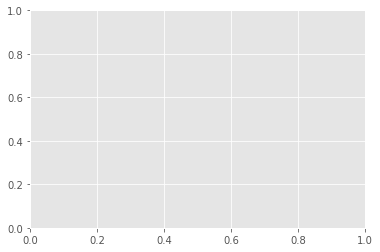

In [36]:
# step = 0
# # change to run 9 if you want to overfit
# EPOCHS = 575; batch_s  = 1; run = 11; tr_regime ='shuffle'
# l= [96, 64, 32]; heads = 32; e = 96; context = 50; c=50
# name_comp = 'run_' + str(run)
# logdir = save_dir + '/logs/' + name_comp
# writer = tf.summary.create_file_writer(logdir)
# folder = save_dir + '/ckpt/check_' + name_comp
# optimizer_c = tf.keras.optimizers.Adam(3e-4)
# helpers.mkdir(folder)
# decoder = experimental_model.Decoder(e, l[0], l[1], l[2], num_heads=heads)
# ckpt = tf.train.Checkpoint(step=tf.Variable(1), optimizer=optimizer_c, net=decoder)
# manager = tf.train.CheckpointManager(ckpt, folder, max_to_keep=3)
# ckpt.restore(manager.latest_checkpoint)
# if manager.latest_checkpoint:
#     print("Restored from {}".format(manager.latest_checkpoint))
# else:
#     print("Initializing from scratch.")







idd = 30
fig,ax = plt.subplots()
for j in range(100):
    x = batch_x[0, :][None, :, :]
    y_s = y[8000 + idd, :50] 
    y_s = y_s[:-1][None, :]
    for i in range(149):
        x_s = x[:, :(50 + i), :]
        _, _, sample_y = evaluate(decoder, x_s, y_s, d=d, sample=True)
        y_s = tf.concat((y_s, tf.reshape(sample_y, [1, 1])), axis=1)
        

    ax.scatter(t, y[8000+idd], cmap=cmap)
    ax.scatter(t[:50], y[8000+idd][:50], c='red')
    ax.scatter(t[50:-1], (y_s.numpy()[:, 49:]), c='lightblue') 

x = batch_x[0, :][None, :, :]
y_s = y[8000 + idd, :50] 
y_s = y_s[:-1][None, :]
for i in range(149):
    x_s = x[:, :(50 + i), :]
    _, _, sample_y = evaluate(decoder, x_s, y_s, d=d, sample=False)
#     print((t[:(301 + i)][-1], sample_y))
    y_s = tf.concat((y_s, tf.reshape(sample_y, [1, 1])), axis=1)
ax.scatter(t, y[8000+idd], cmap=cmap)
ax.scatter(t[:50], y[8000+idd][:50], c='red')
ax.scatter(t[50:-1], (y_s.numpy()[:, 49:]), c='goldenrod') 

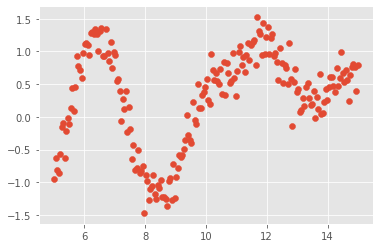

In [68]:
plt.scatter(t, y[8000+31], cmap=cmap)

In [156]:
x[:, :99, :].shape

(1, 99, 80)

In [161]:
y_s.numpy()

array([[-0.8383658 , -0.6227807 , -1.1252137 , -0.7462958 , -0.4878531 ,
        -0.661256  , -0.8845227 , -0.58334965, -0.67272997, -0.9614765 ,
        -1.05763   , -1.207521  , -0.9587398 , -0.90073526, -0.9497277 ,
        -0.60751134, -0.97908336, -0.95478165, -1.3323395 , -0.9433719 ,
        -0.5966298 , -0.74621814, -1.3341026 , -0.42232022, -0.800609  ,
        -1.4460624 , -1.0498679 , -0.9903614 , -0.9897834 , -0.38197884,
        -0.4651513 , -0.77497715, -0.45981643, -0.49297252, -0.39442134,
        -0.44021064, -0.5837369 , -0.24118242, -0.38061407,  0.11325204,
         0.38787743, -0.10958096,  0.26768184,  0.09883021,  0.60849315,
         0.32071134,  0.61996984,  0.4277914 ,  0.66737634,  0.65756434,
         0.77830726,  0.58163524,  0.97329557,  0.8547472 ,  0.39792678,
         0.47246534,  0.56132054,  0.7538089 ,  0.86992955,  0.7706112 ,
         0.23906313,  0.30827406,  0.34237644,  0.14827892,  0.7130859 ,
        -0.26457757,  0.07647462, -0.7049664 , -0.3

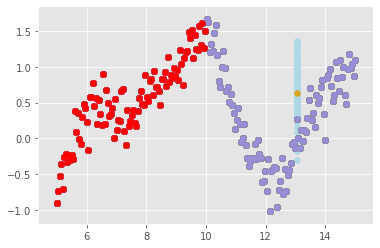

In [166]:
# get epistemic uncertainty 

idd = np.random.choice(np.arange(1000))
fig,ax = plt.subplots()
df = np.zeros((100, 2))
for j in range(100):
    x = batch_x[0, :][None, :, :]
    y_s = y[8000 + idd, :100] 
    y_s = y_s[:-1][None, :]
    x_s = np.concatenate((x[:, :99, :], x[:, 160, :].reshape(1, 1, -1)), axis =1)
    for i in range(2):
        _, _, sample_y = evaluate(decoder, x_s, y_s, d=d, sample=True)
        y_s = tf.concat((y_s, tf.reshape(sample_y, [1, 1])), axis=1)
        df[j, i] = sample_y
        x_s = np.concatenate((x_s, x[:, 160, :].reshape(1, 1, -1)), axis =1)
        
    ax.scatter(t, y[8000+idd], cmap=cmap)
    ax.scatter(t[:100], y[8000+idd][:100], c='red')
    ax.scatter(t[160], (y_s.numpy()[:, -2]), c='lightblue') 

y_s = y[8000 + idd, :100] 
y_s = y_s[:-1][None, :]
x_s = np.concatenate((x[:, :99, :], x[:, 160, :].reshape(1, 1, -1)), axis =1)
for i in range(2):
    _, _, sample_y = evaluate(decoder, x_s, y_s, d=d, sample=False)
    y_s = tf.concat((y_s, tf.reshape(sample_y, [1, 1])), axis=1)
    x_s = np.concatenate((x_s, x[:, 160, :].reshape(1, 1, -1)), axis =1)
ax.scatter(t, y[8000+idd], cmap=cmap)
ax.scatter(t[:100], y[8000+idd][:100], c='red')
ax.scatter(t[160], (y_s.numpy()[:, -2]), c='goldenrod') 

In [177]:
cov_y12 = sum((df[:, 0] - np.mean(df[:, 0])) * (df[:, 1] - np.mean(df[:, 1]))) / 100

In [178]:
var_y1 = sum((df[:, 0] - np.mean(df[:, 0]))**2) / 100

In [179]:
cov_y12 / (var_y1)

0.8414868587767466

In [182]:
t[160:163]

array([13.04020101, 13.09045226, 13.14070352])

In [184]:
t[162:159:-1]

array([13.14070352, 13.09045226, 13.04020101])

In [186]:
x[:, 162:159:-1, :].shape

(1, 3, 80)

In [196]:
x[:, 159:219:20, :].shape

(1, 3, 80)

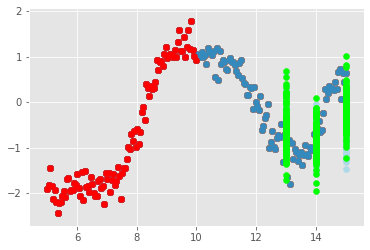

In [198]:
### FDD

idd = np.random.choice(np.arange(1000))
fig,ax = plt.subplots()
df = np.zeros((100, 2))
for j in range(100):
    x = batch_x[0, :][None, :, :]
    y_s = y[8000 + idd, :100] 
    y_s = y_s[:-1][None, :]
    x_1 = np.concatenate((x[:, :99, :], x[:, 159:219:20, :].reshape(1, 3, -1)), axis =1)
    t_1 = np.concatenate((t[:99], t[159:219:20]), axis =0)
    for i in range(3):
        x_s = x_1[:, :(100+i), :]
        _, _, sample_y = evaluate(decoder, x_s, y_s, d=d, sample=True)
        y_s = tf.concat((y_s, tf.reshape(sample_y, [1, 1])), axis=1)
#         df[j, i] = sample_y
        
    ax.scatter(t, y[8000+idd], cmap=cmap)
    ax.scatter(t[:100], y[8000+idd][:100], c='red')
    ax.scatter(t_1[-3:], (y_s.numpy()[:, -3:]), c='lightblue') 
    
    
for j in range(100):
    x = batch_x[0, :][None, :, :]
    y_s = y[8000 + idd, :100] 
    y_s = y_s[:-1][None, :]
    x_1 = np.concatenate((x[:, :99, :], x[:, 199:139:-20, :].reshape(1, 3, -1)), axis =1)
    t_1 = np.concatenate((t[:99], t[159:219:20]), axis =0)
    for i in range(3):
        x_s = x_1[:, :(100+i), :]
        _, _, sample_y = evaluate(decoder, x_s, y_s, d=d, sample=True)
        y_s = tf.concat((y_s, tf.reshape(sample_y, [1, 1])), axis=1)
#         df[j, i] = sample_y

    ax.scatter(t_1[-3:], (y_s.numpy()[:, -3:]), c='lime') 

# y_s = y[8000 + idd, :100] 
# y_s = y_s[:-1][None, :]
# x_s = np.concatenate((x[:, :99, :], x[:, 160, :].reshape(1, 1, -1)), axis =1)
# for i in range(2):
#     _, _, sample_y = evaluate(decoder, x_s, y_s, d=d, sample=False)
#     y_s = tf.concat((y_s, tf.reshape(sample_y, [1, 1])), axis=1)
#     x_s = np.concatenate((x_s, x[:, 160, :].reshape(1, 1, -1)), axis =1)
# ax.scatter(t, y[8000+idd], cmap=cmap)
# ax.scatter(t[:100], y[8000+idd][:100], c='red')
# ax.scatter(t[160], (y_s.numpy()[:, -2]), c='goldenrod') 

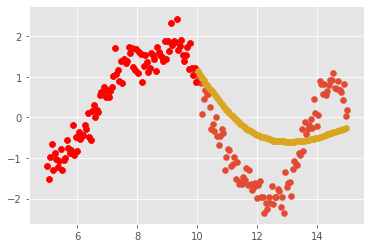

In [141]:

plt.show()

In [35]:
def evaluate(model, x, y, sample=True, d=False):

    combined_mask_x = masks.create_masks(x[:, :, 0])
    pred = model(x, y, False, combined_mask_x[:, :-1, :-1])
    if sample:
        sample_y = np.random.normal(pred[-1, 0], np.exp(pred[-1, 1]))
    else:
        sample_y = pred[-1, 0]

    return pred[:, 0], pred[:, 1], sample_y

In [36]:
batch_x.shape

(12800, 1, 80)

In [18]:
decoder.embedding_y.weights

[<tf.Variable 'decoder_2/embedding_y/embeddings:0' shape=(720, 512) dtype=float64, numpy=
 array([[-0.03918333,  0.002555  , -0.04375133, ..., -0.00895372,
          0.01428103, -0.04062321],
        [ 0.04875097,  0.00332681,  0.02075737, ..., -0.00281248,
         -0.0422142 , -0.0279823 ],
        [-0.01159028, -0.01968206, -0.00533449, ..., -0.04627387,
          0.0472882 ,  0.01146601],
        ...,
        [ 0.0485401 ,  0.0070847 ,  0.01357337, ..., -0.04143491,
         -0.02743685,  0.02866772],
        [-0.01393959, -0.03927393, -0.03441395, ..., -0.03966967,
         -0.00072969,  0.00185381],
        [ 0.01771626, -0.00915341,  0.04119668, ..., -0.04464048,
          0.04295359,  0.04671597]])>]

In [43]:
decoder.mha2.wk

In [44]:
decoder.mha.wk

### Embeddings in tensorboard

In [ ]:
helpers.tensorboard_embeddings(decoder, layer_num = 0, meta_data = np.concatenate(([0, 1], np.unique(b_data[2]))))

### Inference

att:  (1, 32, 250, 250)
unique:  tf.Tensor(
[ 41 245  40 242 243  66  65  73  67  68  71  72  83  84 174 248  45  46
  50  52  47 249  48  49  51  53  42 246 247  59  60 233  27 223   8  19
 211 212   9  38 239 240 241  35  54  55  57  58  63  56  61  62  28  29
 228 235 244  36  37  80  81  79  75  76 204  20  21  15  16  43  44 162
 163 164 159 165   6   7 201 202  17  39  33  34 234  64], shape=(86,), dtype=int32)
count:  tf.Tensor(
[2 2 4 2 2 4 2 1 2 1 2 1 1 1 1 4 4 4 7 6 2 2 7 5 6 6 5 3 3 2 2 1 2 1 1 1 1
 1 1 2 2 1 1 2 2 2 2 2 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1], shape=(86,), dtype=int32)
att:  (1, 32, 251, 251)
unique:  tf.Tensor(
[ 41 245  40 242 243  66  65  73  67  68  71  72  83  84 174  45  46 248
  50  52 249  47 250  48  51  49  53  42 246 247  59  60 233  27 223   8
  19 211 212   9  38 239 240 241  35  54  55  57  58  63  56  61  62  28
  29 228 235 244  36  37  80  81  79  75  76 204  20  21  15  16  43  44
 162 163 164 159 165 

att:  (1, 32, 264, 264)
unique:  tf.Tensor(
[173 172 168 170 171  66  68  69  70  65  23 219 220 221  13  45  46 248
  50 254  47 249  48  52 256  51 263  59  60  58  53  64  67 255 257  43
 169 174 165 166 167  74 152 153 154 155 156  54  55 258  57 260 261 262
 236 237 238  39 235  63  61  62  73  75  35  36  37  33  79  80  81  41
 245  40  42 246 162 163 164 159   0   1 200   6   7 250 251  44], shape=(88,), dtype=int32)
count:  tf.Tensor(
[1 1 1 1 1 3 2 2 2 4 1 1 1 1 1 3 3 3 5 5 1 1 1 3 3 4 3 4 4 5 2 3 2 3 4 2 1
 1 2 1 1 2 1 1 1 1 1 2 2 2 4 3 3 2 1 1 1 2 1 3 3 2 1 2 1 1 1 1 1 1 1 1 1 1
 2 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(88,), dtype=int32)
att:  (1, 32, 265, 265)
unique:  tf.Tensor(
[173 172 168 170 171  66  68  69  70  74  10  11  12 205  23  45  46 248
 263 264  50 254  47 249  48  52 256  51  59  60  58  64  67  65 255  53
 257  43 169 174 165 166 152 153 154 155 156  54  55 258  57 260 261 262
 236 237 238 235  35  63  61  73  39  36  37  79  80  81  75 150  41 245
  40  42 

att:  (1, 32, 276, 276)
unique:  tf.Tensor(
[173 172 168 170 171 270 271 273 274 275  10  11  12 205  15  82  97  98
  99  88  45  46 248  50 254  52 256  51  89  96  93  64 269 265  59  60
  53 255 257  43 169 165 166 167 174  67  68  69  70  74  66  54  55 258
  48  61  62 267  83  84  77  73  78  63  58 111 112 113 105 106  75  76
  65 272  90  91  92  94 100 107 108  85 162 163 164 159 263 264  13  14
  80  81  79  41 245 242 243 244], shape=(98,), dtype=int32)
count:  tf.Tensor(
[1 1 1 1 1 3 3 3 3 2 2 2 2 1 1 3 4 4 4 4 1 1 1 2 2 1 1 2 3 3 3 2 2 2 2 2 1
 1 2 1 1 3 1 1 1 2 1 1 1 3 2 1 1 1 1 3 3 1 2 2 2 2 1 3 2 1 1 1 2 2 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 2 2 1 1 1 1 1 1 1 1 1 1], shape=(98,), dtype=int32)
att:  (1, 32, 277, 277)
unique:  tf.Tensor(
[173 172 168 170 171 276 270 271 273 274  10  11  12 205  15  82  97  98
  99  88  45  46 248  50 254  52 256  51  89  96  93  64 269 265  59  60
  53 255 257  43 169 165 166 167 174  67  68  69  70  74  66  54  55 258
  48  61  62 267  83 

att:  (1, 32, 288, 288)
unique:  tf.Tensor(
[173 172 168 170 171 276 277 278 270 271  10  11  12 205  20  97  98  99
  88  82  89 100  93  94  95  52 256  50 254  51  53  79  75  76  80  81
 255 257  56 169 174 165 166  67 280 281 282  74  66  48  49 252 253  45
  61  62 267  83  84  77  78  73 286 287  96  64 273 111 112 113 110 105
 279 274  65 272  90  91  92 106 107 108  85 162 163 164 159  63 263 264
 265  58  57 260 250 251  40  43  44  87  41 245 242 243], shape=(104,), dtype=int32)
count:  tf.Tensor(
[2 1 1 1 1 2 2 2 3 3 1 1 1 1 1 4 4 3 4 2 4 2 3 2 1 2 2 1 1 2 2 2 2 2 3 3 1
 1 1 1 1 2 1 2 1 1 2 2 2 1 1 1 1 1 2 2 1 2 2 2 1 2 2 2 2 1 2 1 1 1 1 2 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1], shape=(104,), dtype=int32)
att:  (1, 32, 289, 289)
unique:  tf.Tensor(
[173 172 168 170 171 276 277 278 270 271  10  11  12 205  15  97  98  99
  88  83  89 101 102 103 104  52 256  50 254  51  53 257  79  75  76  80
  81 255  56 169 165 166 167 174  67 280 281 288 282  66

att:  (1, 32, 300, 300)
unique:  tf.Tensor(
[173 172 168 170 171 276 277 278 270 271  10  11  12 205  22  97  98  99
  87  82  89 100 101 102 103  52 256  50 254  58  88  53 257  79 297  80
  81 298  56 259  51 169 174 165 166 167  67 280 281 288  68  75  76 289
 290 291 104 269  74  83  84  77  78  73 286  96  93  66 287 273 111 112
 113 110 105 279  65 272  90  91  92  94 106 107 108 159 162 163 164 263
  63  85  86 265  59  60 266 146  54 299  41 245 242 243 244], shape=(105,), dtype=int32)
count:  tf.Tensor(
[1 1 1 1 1 2 1 1 2 2 1 1 1 1 1 5 5 5 3 2 5 3 2 2 2 2 2 2 1 1 3 2 2 1 1 2 2
 2 1 1 1 1 1 1 1 1 2 2 2 3 1 1 1 1 1 1 1 1 4 1 1 1 1 2 2 2 3 1 1 1 1 1 1 1
 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 2 2 2 1 1 1 1 1 1 1 1], shape=(105,), dtype=int32)
att:  (1, 32, 301, 301)
unique:  tf.Tensor(
[173 172 168 170 171 276 277 278 270 271  10  11  12 205  22  97  98  99
  87  82  89 100 101 102 103  52 256  50 254  58  88  53 257  79 297  80
  81 298  56 259  51 169 174 165 166 167  67 280 2

att:  (1, 32, 313, 313)
unique:  tf.Tensor(
[ 41 245  40 242 243 177 110 111 112 113  10  11  12 205  20  87 310 305
  97  98 312  89  93  94  95 197 191 193 194 195  88 311  53  33  34 234
 304  83  84 306 198 192 188 189  45  46 248  48  49  67 280 281 282 288
 114 115 116 119 120 100 109 101 102  90  91  92  82 302 303 307 308  85
  86  96  99  66  73 286 287 273 199 186 279 276 277 278  74  75 105 106
 107 108 159 162 163 164 165 265  63  59  60 266  54 274 270 271], shape=(106,), dtype=int32)
count:  tf.Tensor(
[2 1 1 1 1 1 2 1 1 1 1 1 1 1 1 2 2 3 4 4 1 4 6 3 2 3 2 1 1 1 4 4 1 1 1 1 2
 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 2 2 2 2 2 2 2 1 1 1 2 1 1 1 2
 2 1 1 1 1 2 1 1 2 2 2 2 1 1 1 1 1 1 1 1 1 1 1 2 1 2 2 2 1 1 1 1], shape=(106,), dtype=int32)
att:  (1, 32, 314, 314)
unique:  tf.Tensor(
[ 41 245  40 242 243 177 110 111 112 113  10  11  12 205  20  87 310 305
  97  98 312 313  89  93  94 197 191 193 194 195  88 311  53  33  34 234
 304  83  84 306 198 192 188 189  45  46 248

att:  (1, 32, 325, 325)
unique:  tf.Tensor(
[ 41 245  40 242 243 123 124 120 125 126  10  11  12 205  19  87 310  97
  98  99  89 312 313 314 315 197 191 193 194 195 117 118 114  22 216  17
  18 210 110 321 322 109 198 192 188 189 223 224 233  27 225 115 116 119
 199 187 105 106 107 108 319  82 302 303 307 308 111 112 113 323 324  96
  93 121 122 159 160 161 294 295 296 304  75  90  91  92 101 102 279  71
  72 284 285 320  39  64  59  60 266 265  88 311 173 179], shape=(104,), dtype=int32)
count:  tf.Tensor(
[1 1 1 1 1 2 2 3 1 1 1 1 1 1 1 2 2 4 4 4 2 2 2 2 2 3 3 2 1 1 5 2 4 1 1 1 1
 1 2 2 2 2 3 2 1 1 1 1 1 1 1 3 3 2 2 1 3 3 1 1 1 1 1 1 2 1 1 1 1 1 1 3 2 2
 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(104,), dtype=int32)
att:  (1, 32, 326, 326)
unique:  tf.Tensor(
[ 41 245  40 242 243 123 124 120 125 126  19 211 212  10  11  87 310  97
  98  99  89 312 313 314 315 197 191 193 194 195 110 321 322 117  22 216
  17  18 210 118 198 192 188 189 223 224 233 225 226 114

att:  (1, 32, 337, 337)
unique:  tf.Tensor(
[173 168 172 170 171 127 131 334 332 132  73 286 287  74 294 151 152 153
 160 161 143 144 140 141 142  45  46 248  50 254 135 138 139 145 333 125
 335 136  42 246 247  40  41  24 217 218 223 224 123 119 114 115 116 154
 155 156  63  58  57 260 261 133 146 134 137 121 122 124 118 331 250 251
 159 162 163 164 157 158 336 148 149 147 150  71  72 284 285 100 317 198
 109 105  87 310 304 305  82 128 129 130 169 165 166 167], shape=(104,), dtype=int32)
count:  tf.Tensor(
[2 1 1 1 1 2 3 3 4 4 1 1 1 1 2 1 2 2 2 1 1 1 4 3 2 1 1 1 1 1 7 4 4 4 1 1 2
 4 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 1 1 1 1 1 2 3 2 3 2 2 1 1 1 1 1 1 1
 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(104,), dtype=int32)
att:  (1, 32, 338, 338)
unique:  tf.Tensor(
[173 172 168 170 171 127 131 334 132 336  73 286 287 282  74 151 152 153
 160 161 143 144 140 141 142  45  46 248  50 254 135 332 145 333 124 138
 337 136 335  40  42 246 247  41 217 218  24  20  21 123

att:  (1, 32, 349, 349)
unique:  tf.Tensor(
[173 172 168 170 171 131 334 127 132 336  22 216  23 219 220 160 161 151
 152 153 143 144 140 141 142  45  46 248  52 256 174 175 159 154 155 156
 157  51 255  42 246 247 169 165 166 167  57 260 261 262  54 150 147 146
 136 340 341 137 342 135 138 139 343 344 145 346 347 348 134 339 335 332
 333 162 163 164 133 338 337 148 149  61  62 267 268 263 193 194 195 196
 198 125], shape=(92,), dtype=int32)
count:  tf.Tensor(
[5 4 4 3 2 2 2 1 2 1 1 1 1 1 1 6 4 3 2 2 1 1 2 2 2 1 1 1 1 1 2 2 3 6 4 3 2
 1 1 1 1 1 1 3 3 2 1 1 1 1 1 2 4 3 1 1 1 2 1 2 1 1 1 1 2 2 2 2 2 2 1 1 1 2
 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(92,), dtype=int32)
att:  (1, 32, 350, 350)
unique:  tf.Tensor(
[173 172 168 170 171 131 334 127 132 336  23 219 220 221  20 160 161 152
 153 151 143 144 140 141 142  45  46 248  52 256 135 145 346 347 348 159
 154 155  42 246 247  40  51 169 174 165 166 175 167  57 260 261 262  54
 150 147 146 136 340 341 137 138 139 343 134 339 333 335 

att:  (1, 32, 361, 361)
unique:  tf.Tensor(
[173 172 168 170 171 174 177 169 162 163  22 216 217 218  20 160 161 152
 153 357 143 144 140 141 142  45  46 248  52 256 355 356 360 198 175 332
 159 154 155  42 246 247  51 255 165 166 167  57 260 261 262 257 150 350
 351 352 137 342 136 340 341 145 346 347 348 135 134 339 335 333 125 345
 147 156 157 146 133 338 337 148 149 349 164 199 197 193 194 126 132 336], shape=(90,), dtype=int32)
count:  tf.Tensor(
[6 5 4 2 2 2 1 4 2 2 1 1 1 1 1 5 4 1 1 1 1 1 3 3 3 2 2 2 2 2 3 2 2 2 3 1 4
 3 2 1 1 1 1 1 3 3 2 1 1 1 1 1 2 2 2 2 1 1 1 1 1 3 2 2 2 1 1 1 1 2 2 1 3 1
 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(90,), dtype=int32)
att:  (1, 32, 362, 362)
unique:  tf.Tensor(
[173 172 168 170 171 174 169 177  20  21  22 216  23 152 153 357 358 160
 143 144 140 141 142  45  46 248  52 256 161 151 353 354 145 346 347 348
 138 159 361 154  42 246 247  40  41 165 175 166 167 360  54  55 258  57
 260 150 350 351 352 355 137 342 136 340 341 179 135 134 339 335 132 3

att:  (1, 32, 374, 374)
unique:  tf.Tensor(
[173 369 370 371 172 177 174 169 175  22 216  20  21  19 182 179 183 191
 188 193 194 195 196 192 197 199 145 346 347 348 127 366 160 161 362 190
 198 168 367 170 171 368 165 166 167 363 189 150 350 351 352 355 146 159
 361 181 184 152 153 357 154 155 156 157 158 187 185  66 279  71  72 284
 162 163 164 365 178 180 176 124 125 126 333 128], shape=(84,), dtype=int32)
count:  tf.Tensor(
[5 5 5 4 3 2 2 3 1 1 1 1 1 1 3 4 2 5 6 4 3 1 1 3 4 5 2 2 1 1 1 1 3 3 3 2 4
 1 1 1 1 1 1 1 1 1 5 1 1 1 1 1 1 5 4 2 2 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1], shape=(84,), dtype=int32)
att:  (1, 32, 375, 375)
unique:  tf.Tensor(
[173 369 370 371 172 177 374 174 175  20  21  22 216  10 179 182 183 181
 193 194 195 196 192 197 191 145 346 347 348 138 366 160 161 362 190 199
 198 169 168 367 170 171 368 165 166 167 363 188 189 150 350 351 352 154
 146 184 159 361 155 187 185  71  72 284 285 279 162 163 164 365 178 180
 124 125 126 333 131], shape=(77,

att:  (1, 32, 387, 387)
unique:  tf.Tensor(
[173 369 370 371 172 177 374 376 377  19 211 212  22 216 182 183 381 188
 189 193 194 195 196 192 197 191 179 379 333 125 126 127 332 199 198 190
 169 366 170 171 368 168 367 184 185 382 386 152 153 357 358 159 154 155
 156 157 158 384 385 187  71  72 284 285  75 160 161 362 361 150 350 351
 352 378 383 178 375 180 124], shape=(79,), dtype=int32)
count:  tf.Tensor(
[4 3 3 2 2 1 1 1 1 1 1 1 1 1 3 2 2 8 5 4 4 3 1 5 9 6 2 1 2 2 2 1 1 7 6 3 1
 2 1 1 1 1 1 2 2 2 2 2 2 2 2 2 1 1 1 1 1 2 2 2 1 1 1 1 1 2 1 1 1 1 1 1 1 1
 2 1 1 1 1], shape=(79,), dtype=int32)
att:  (1, 32, 388, 388)
unique:  tf.Tensor(
[173 369 370 371 172 376 377 177 374 183  19 211 212  22 216 188 189 197
 191 182 193 194 195 196 192 179 379 333 125 126 127 199 387 198 169 366
 170 171 368 168 367 184 185 382 190 386 159 361 152 153 381 162 163 164
 365 154 155 156 157 158 384 187 385  71  72 284 285  75 160 161 362 378
 383 178 375 180 124  15  16], shape=(79,), dtype=int32)
count:

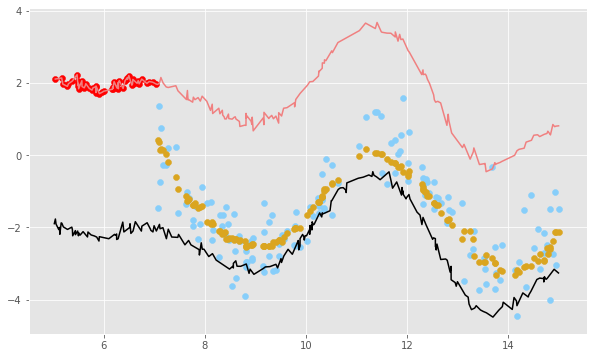

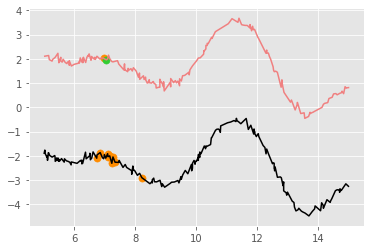

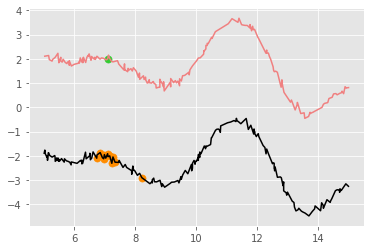

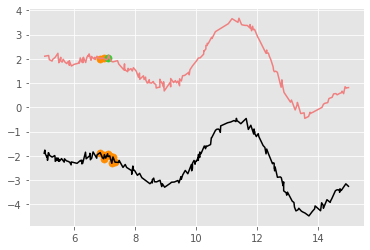

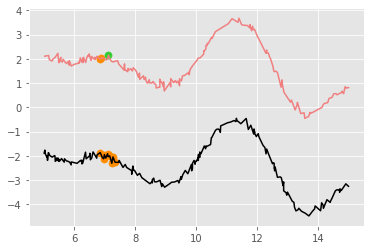

...

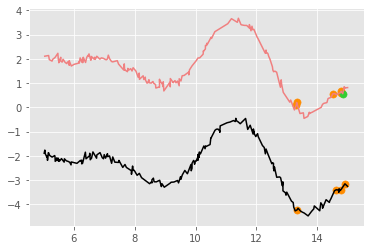

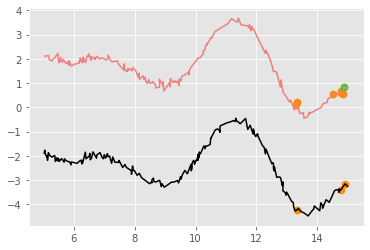

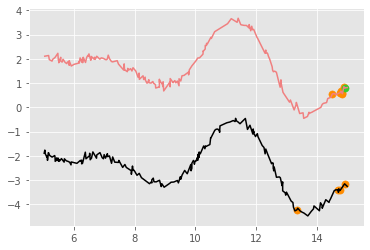

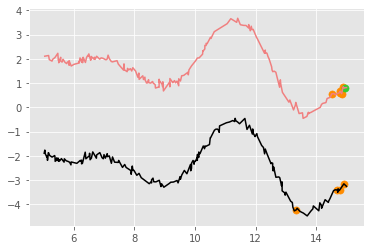

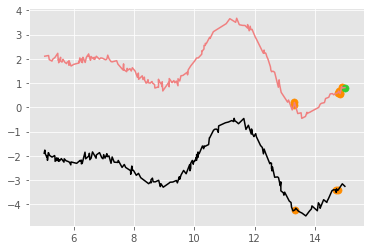

In [26]:
run = 7; l= [256, 64, 32]; e = 512; context = 50
decoder, optimizer_c, ckpt, manager, num_batches, writer, folder = helpers.pre_trained_loader(data[1], save_dir, e, l, d=True, batch_s=64, context=context, heads=1, run=run)
idx = int(np.random.choice(np.arange(0, 30000, 1), 1));
_ = plotter.infer_plot2D(decoder, data[-4][idx, :], data[-2][idx, :], data[0][idx, :], data[1][idx, :], samples = 1, num_steps = 999, consec = True, order = True, context_p = 50)

In [12]:
import pandas as pd

In [13]:
run = 6
name_comp = 'run_' + str(run)
folder = save_dir + '/ckpt/check_' + name_comp

In [15]:
df = pd.read_csv(folder + '_context_' + str(35) + '_speci.csv', header=None)

In [6]:
run =5; l= [256, 64, 32]; e = 512; context = 35
decoder, optimizer_c, ckpt, manager, num_batches, writer, folder = helpers.pre_trained_loader(data[3], save_dir, e, l, d=d, batch_s=64, context=context, heads=1, run=run)

Already exists
Restored from /Users/omernivron/Downloads/GPT_rbf/ckpt/check_run_5/ckpt-33


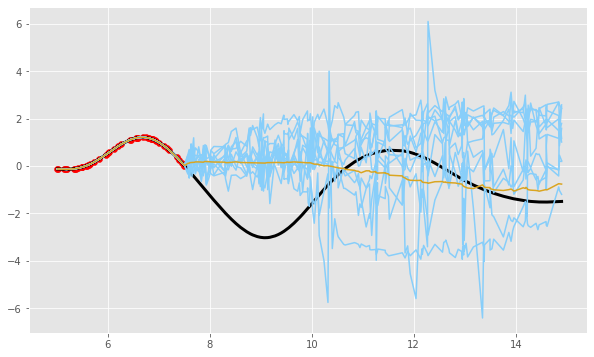

In [19]:
idx = int(np.random.choice(np.arange(0, 1000, 1), 1));
plotter.infer_plot(decoder, em = data[0][idx, :], em_y = data[2][idx, :], x = data[4][idx, :], y= data[6][idx, :], samples = 10, num_steps = 999, consec = True, order = True, context_p = 50)

In [ ]:
## Reading epistemic uncertainty
# 1. given context points predict y*(x*)
# 2. predict y**(x*) given y*(x*)
# 3. Repeat (1-->2) N times
# 4. Calculate var(y*) by 1/N *((y_i* - mean(y*))**2)
# 5. Calculate cov(y*, y**) by 1/N * ((y_i* - mean(y*)(y_i** - mean(y**))) 
# 6. Epistemic uncertainty of y* is given by 5
# 7. Aleatoric uncertainty of y* is given by (4 - 5)